### Mount the google drive

In [ ]:
# libraries
#%matplotlib notebook
import os
import pandas as pd
import numpy as np
import json

import matplotlib
import seaborn
import matplotlib.dates as md
from matplotlib import pyplot as plt
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Insert NAB datasets with all their anomalies

In [ ]:
data = {}
path = '/content/drive/My Drive/NAB/data'

def addFolderAndReadAll(f_name):
    data[f_name] = {}
    csvs = os.listdir(path + '/' + f_name)
    csvs_num = 0
    for csv in csvs:
        data[f_name][csv] = pd.read_csv(path + '/' + f_name + '/' + csv)
        csvs_num += 1
    return csvs_num

csvs_num = sum([addFolderAndReadAll(f_name) for f_name in os.listdir(path)])

with open('/content/drive//My Drive/NAB/labels/combined_windows.json', 'r') as file:
    labels = json.load(file)

for key1 in data:
    for key2 in data[key1]:
        one_csv_labels = labels[key1+'/'+key2]
        data[key1][key2]['interval'] = np.array(0)
        num = 0
        for interval in one_csv_labels:
            #print(key2, interval, num)
            index1 = list(data[key1][key2]['timestamp']).index(interval[0][:19])
            index2 = list(data[key1][key2]['timestamp']).index(interval[1][:19])
            data[key1][key2]['interval'][num] = slice(index1, index2)
            num += 1

<ipython-input-4-fda37f68bd8c>:10: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  data[key1][key2]['interval'][num] = slice(index1, index2)
<ipython-input-4-fda37f68bd8c>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a

### KPSS stationarity test


In [ ]:
from statsmodels.tsa.stattools import kpss

def kpss_test(data, **kw):
    statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')
    # Format Output
    print(f'KPSS Statistic: {statistic}')
    print(f'p-value: {p_value}')
   # print(f'num lags: {n_lags}')
    print('Critial Values:')

    for key, value in critical_values.items():
        print(f'   {key} : {value}')
    if p_value < 0.05:
        print("\u001b[32mStationary\u001b[0m")
    else:
        print("\x1b[31mNon-stationary\x1b[0m")

### Augmented Dickey-Fuller stationarity test


In [ ]:
from statsmodels.tsa.stattools import adfuller


def check_stationarity(series):
    # Copied from https://machinelearningmastery.com/time-series-data-stationary-python/

    result = adfuller(series.values)

    print('ADF Statistic: %f' % result[0])
    print('p-value: %f' % result[1])
    print('Critical Values:')
    for key, value in result[4].items():
        print('\t%s: %.3f' % (key, value))

    if (result[1] <= 0.05) & (result[4]['5%'] > result[0]):
        print("\u001b[32mStationary\u001b[0m")
    else:
        print("\x1b[31mNon-stationary\x1b[0m")

When to Choose ADF or KPSS Test?
There could be a lot of confusion on when one should use the ADF test or KPSS test and which test would give a correct result. A better solution is to apply/run both tests and makes sure that the series is truly stationary.

The following are the possible outcomes of applying both tests.

Case 1: Both tests conclude that the given series is stationary – The series is stationary
Case 2: Both tests conclude that the given series is non-stationary – The series is non-stationary
Case 3: ADF concludes non-stationary, and KPSS concludes stationary – The series is trend stationary. To make the series strictly stationary, the trend needs to be removed in this case. Then the detrended series is checked for stationarity.
Case 4: ADF concludes stationary, and KPSS concludes non-stationary – The series is difference stationary. Differencing is to be used to make series stationary. Then the differenced series is checked for stationarity.

### Periodogram based on Power Spectral Density (PSD)

In [ ]:
from scipy.signal import periodogram
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

period_array = []
seasonal_period = []
seasonal_period_datasets = []
other_datasets = []

for i in range(1, 68):
  normal_data = dfsA1[i]
  values = normal_data[f"value_{i}"]
  start_date = "2020-01-01"  # Adjust this to the desired starting date
  date_range = pd.date_range(start=start_date, periods=len(values), freq="D")

  # Add the Date column to your DataFrame and set it as the index
  normal_data["Date"] = date_range
  values_with_date_index = values.copy()
  values_with_date_index.index = normal_data["Date"]
  freq, power = periodogram(values_with_date_index)
  period = 1/freq[np.argmax(power)]
  period_array.append(period)
  if period < 100:
    seasonal_period_datasets.append(i)
    seasonal_period.append(period)
  else:
    other_datasets.append(i)
avg_period = np.mean(period_array)
print(period_array)
print(avg_period)

### NAB Datasets with their respective stationarities (by ADF and KPSS), their ACF, PACF plots and also their most frequent periodicity

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 1.2516209049184186
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -11.723452
p-value: 0.000000
Critical Values:
	1%: -3.433
	5%: -2.863
	10%: -2.567
Stationary
The most frequent period is  540.5


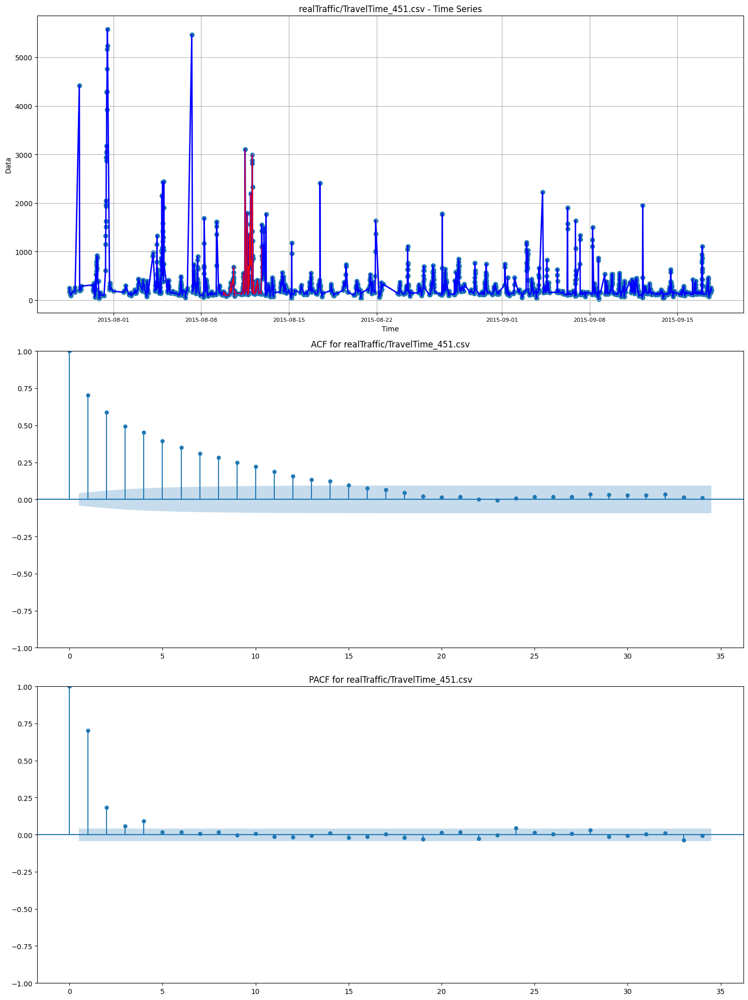

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.32976835558103446
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -11.721642
p-value: 0.000000
Critical Values:
	1%: -3.433
	5%: -2.863
	10%: -2.567
Stationary
The most frequent period is  500.0


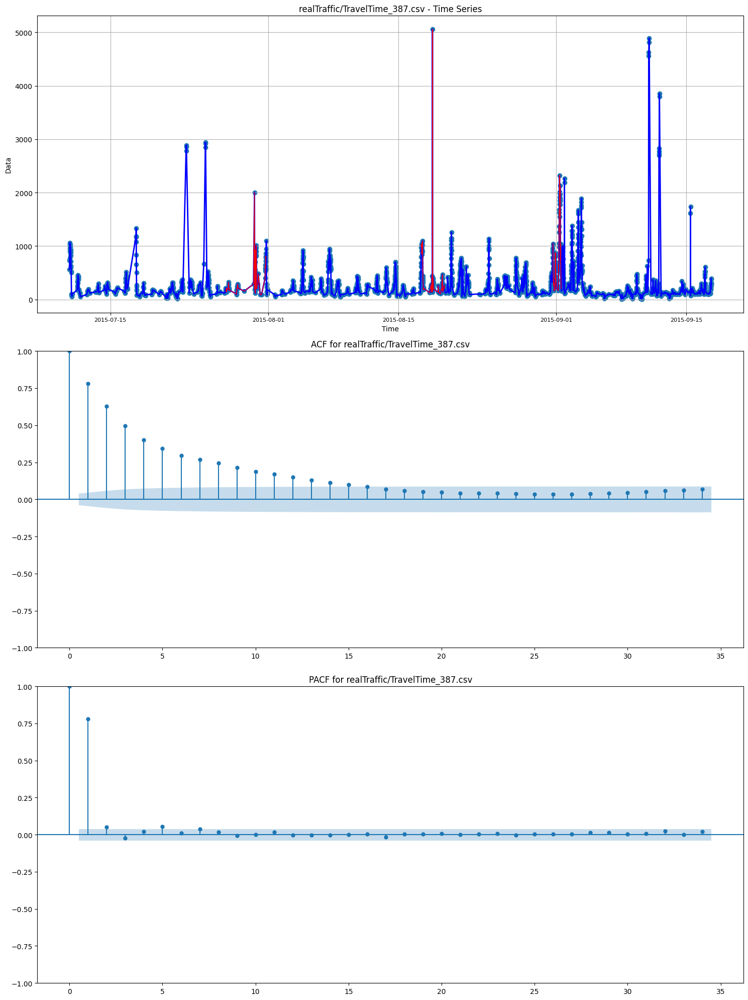

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.16911202912684775
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -8.194670
p-value: 0.000000
Critical Values:
	1%: -3.433
	5%: -2.863
	10%: -2.567
Stationary
The most frequent period is  118.99999999999999


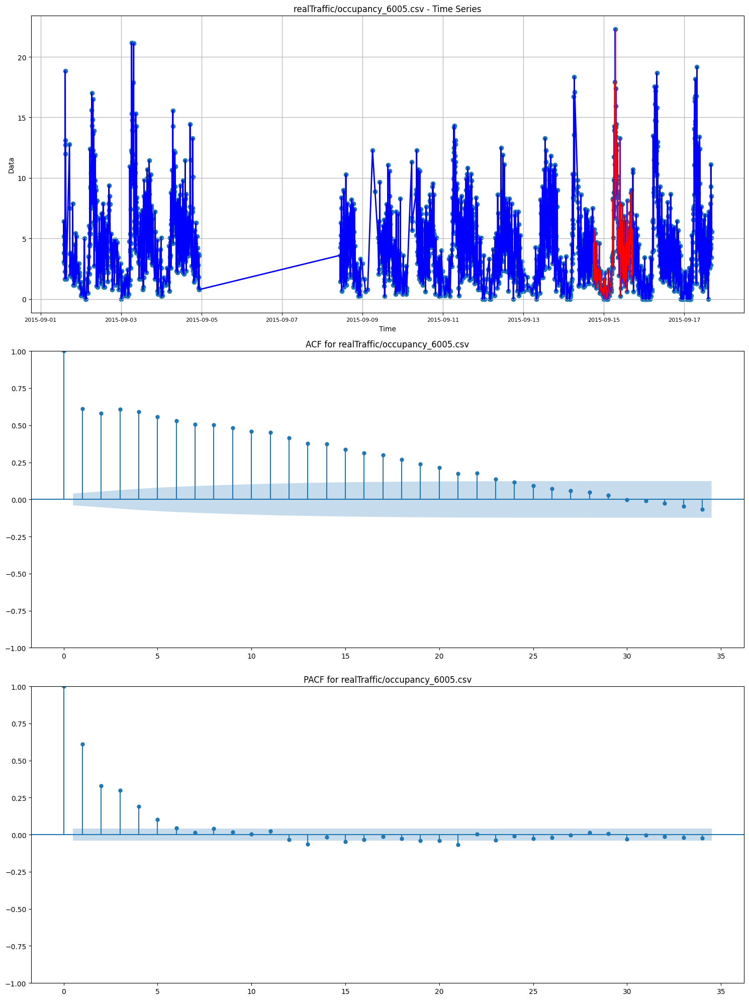

KPSS Statistic: 0.4285860966722039
p-value: 0.06483357902060179
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -6.020454
p-value: 0.000000
Critical Values:
	1%: -3.433
	5%: -2.863
	10%: -2.567
Stationary
The most frequent period is  192.3076923076923


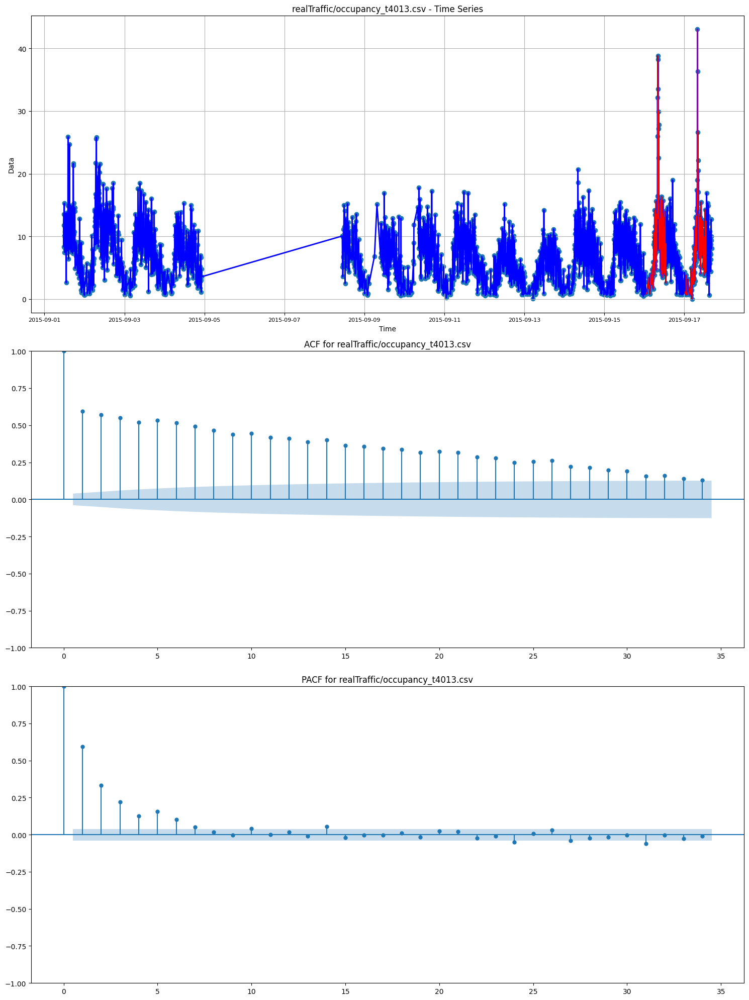

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 1.4217975681104325
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -7.218916
p-value: 0.000000
Critical Values:
	1%: -3.436
	5%: -2.864
	10%: -2.568
Stationary
The most frequent period is  1127.0


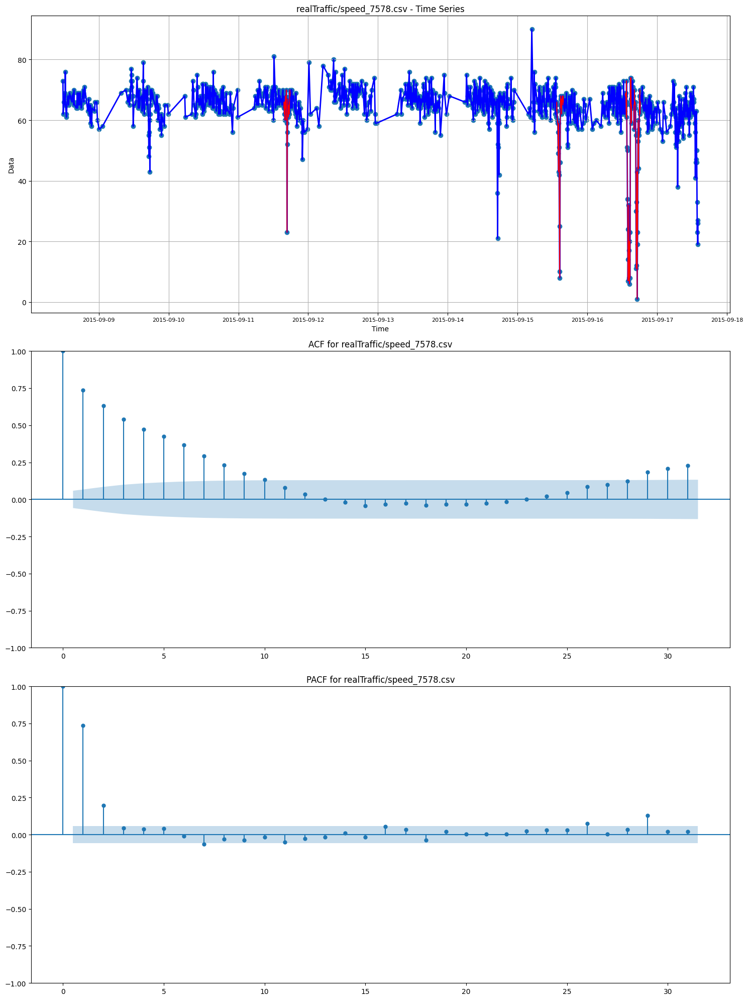

KPSS Statistic: 0.5697201505363606
p-value: 0.025963930059378235
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -14.297330
p-value: 0.000000
Critical Values:
	1%: -3.433
	5%: -2.863
	10%: -2.567
Stationary
The most frequent period is  113.63636363636363


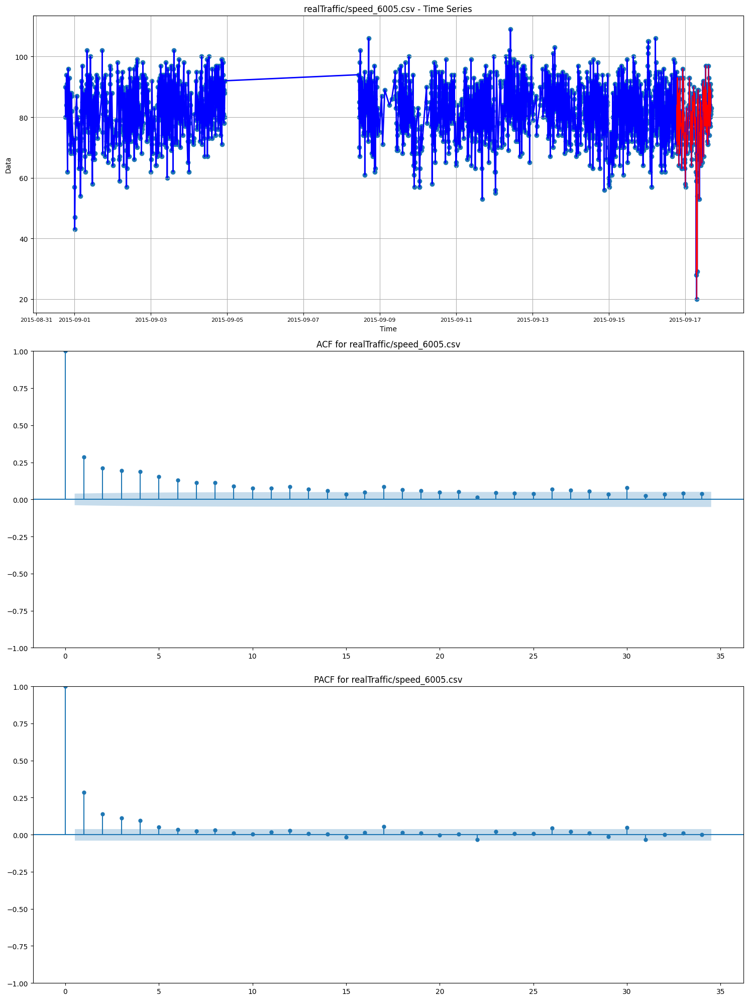

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.7532584609475237
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -11.443915
p-value: 0.000000
Critical Values:
	1%: -3.433
	5%: -2.863
	10%: -2.567
Stationary
The most frequent period is  2495.0


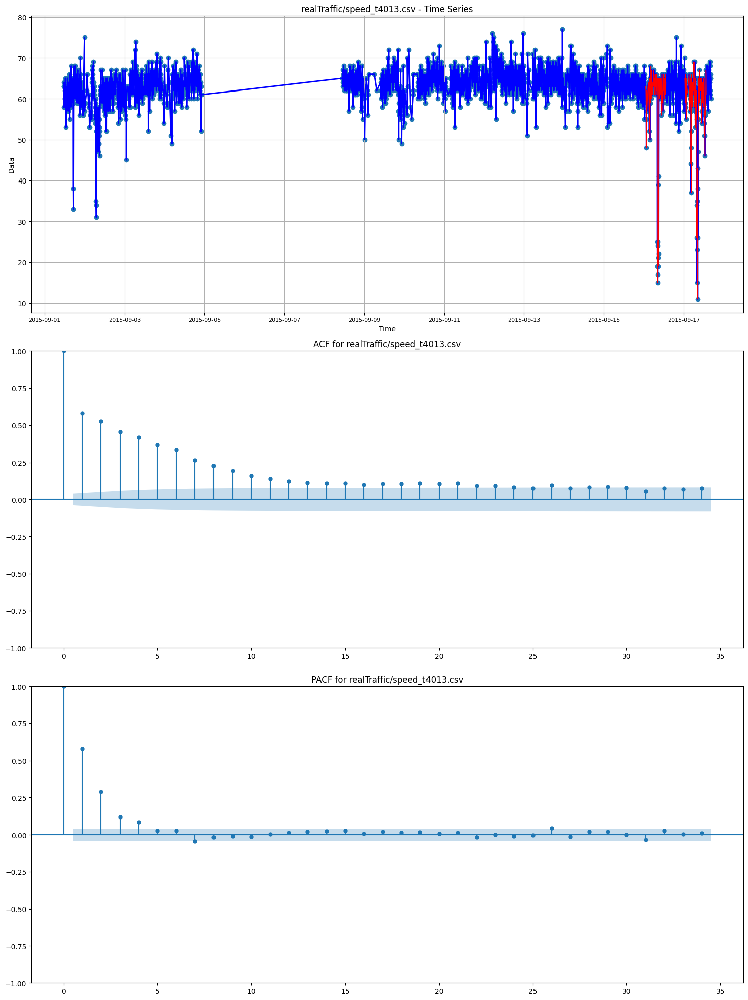

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 1.0535635227522098
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -8.892913
p-value: 0.000000
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  295.625


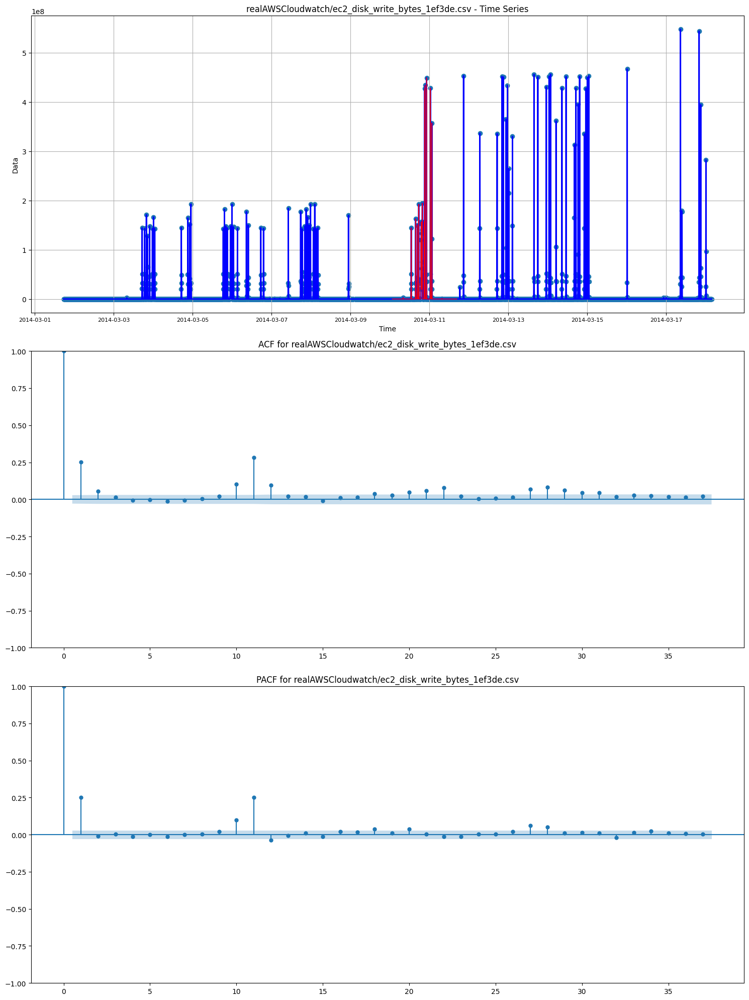

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 6.0522877080203585
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -0.632022
p-value: 0.863581
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Non-stationary
The most frequent period is  4032.0


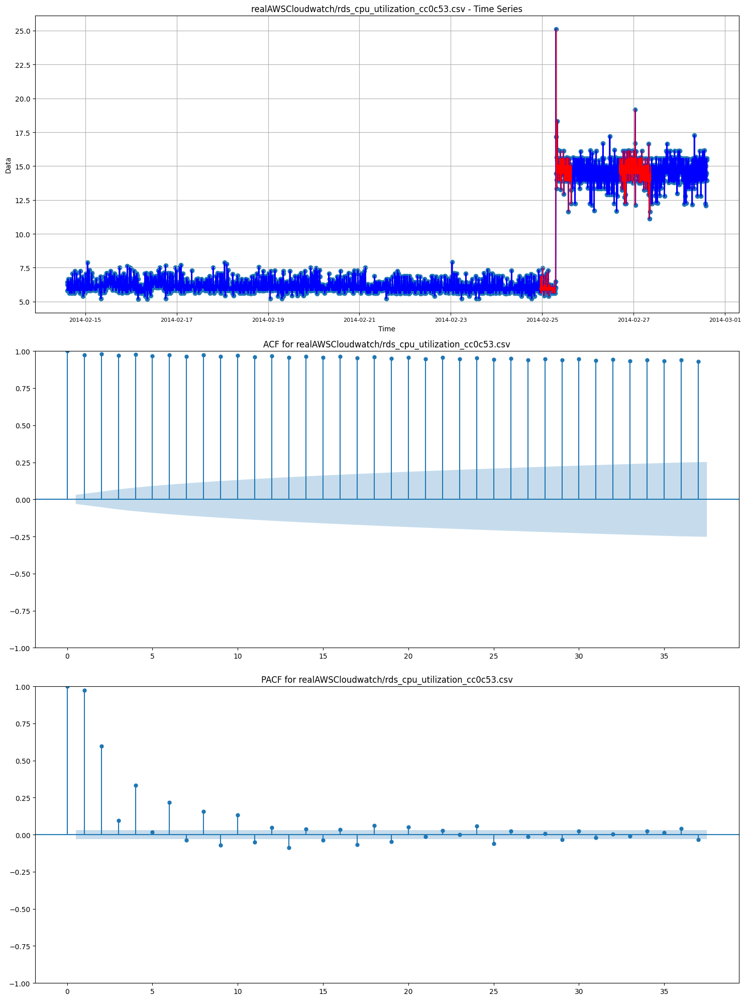

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 1.2274485308458882
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -9.841902
p-value: 0.000000
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  6.0


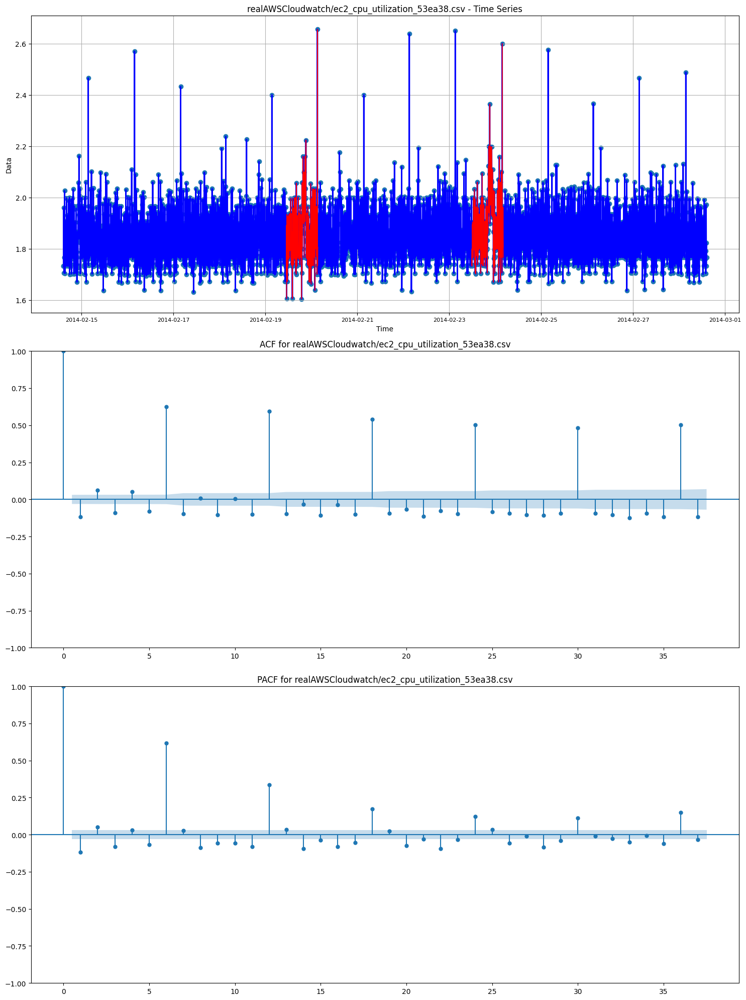

KPSS Statistic: 0.35778396738063994
p-value: 0.09535173819800002
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -6.620162
p-value: 0.000000
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  288.0


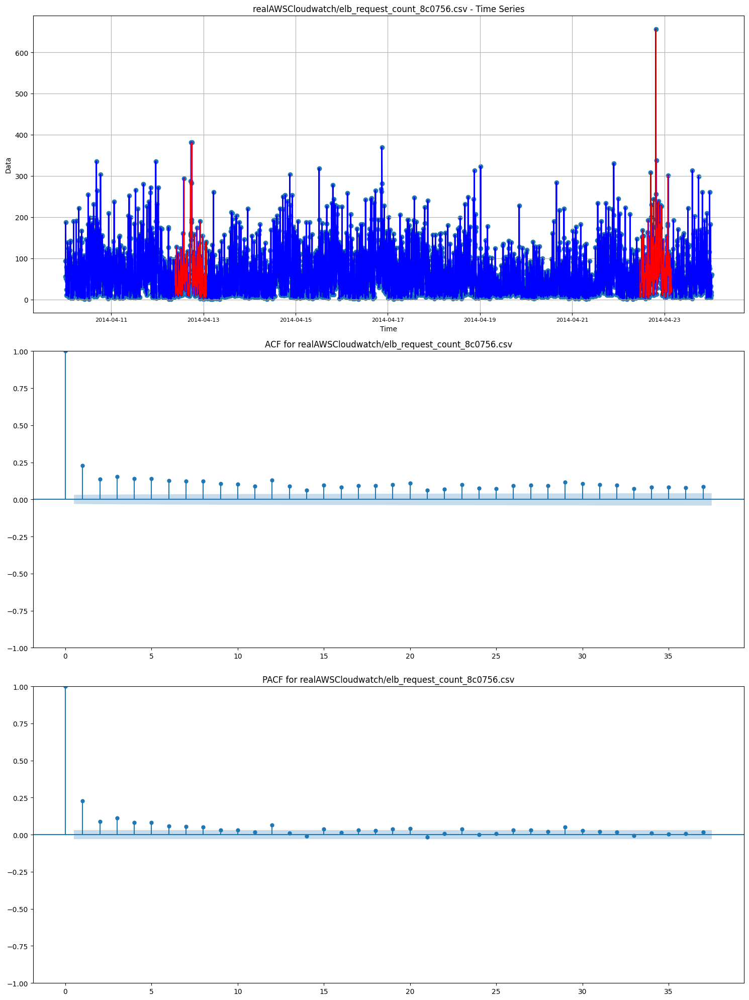

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.2084950631443226
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -46.922836
p-value: 0.000000
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  72.0


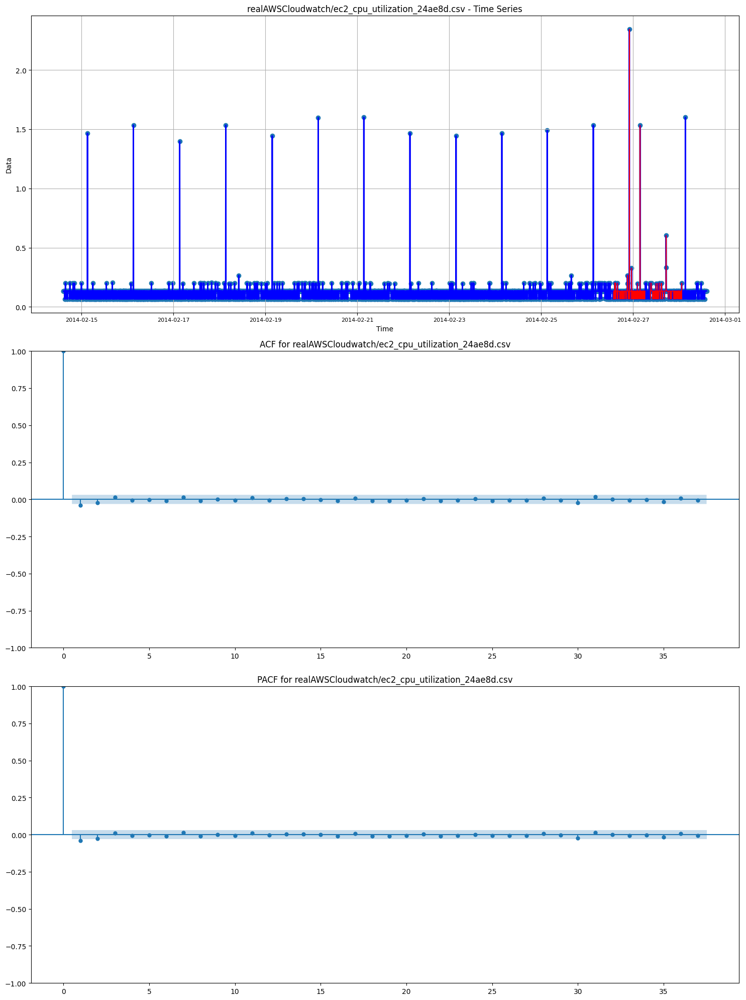

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 3.41373581772213
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -0.853645
p-value: 0.802854
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Non-stationary
The most frequent period is  2016.0


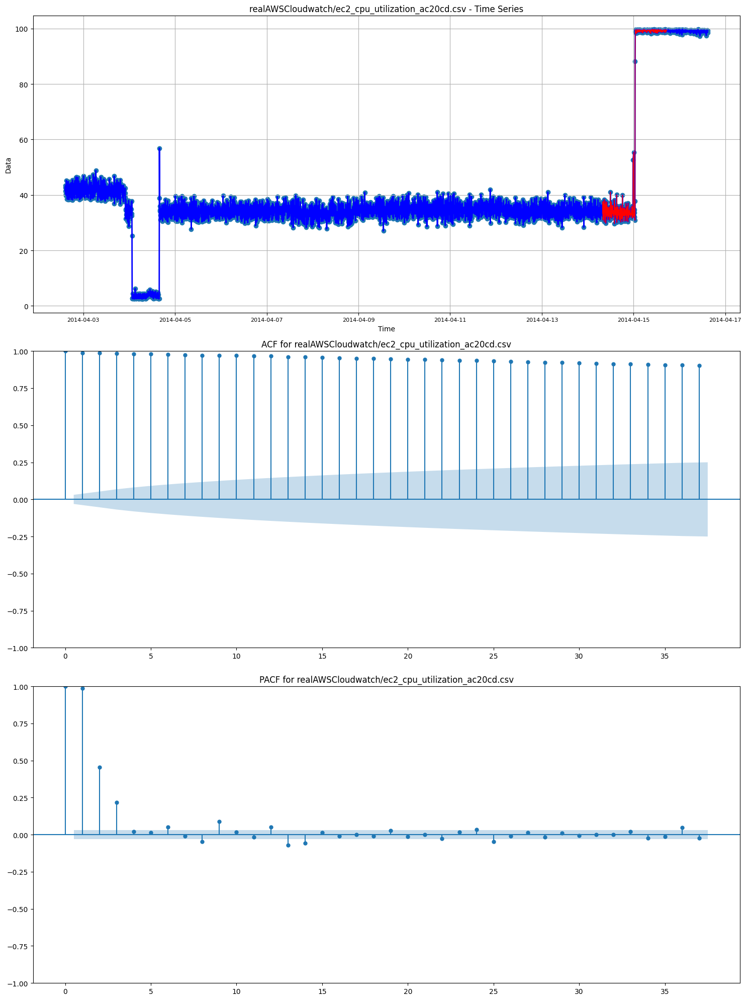

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.31893512560113896
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -11.024359
p-value: 0.000000
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  2016.0


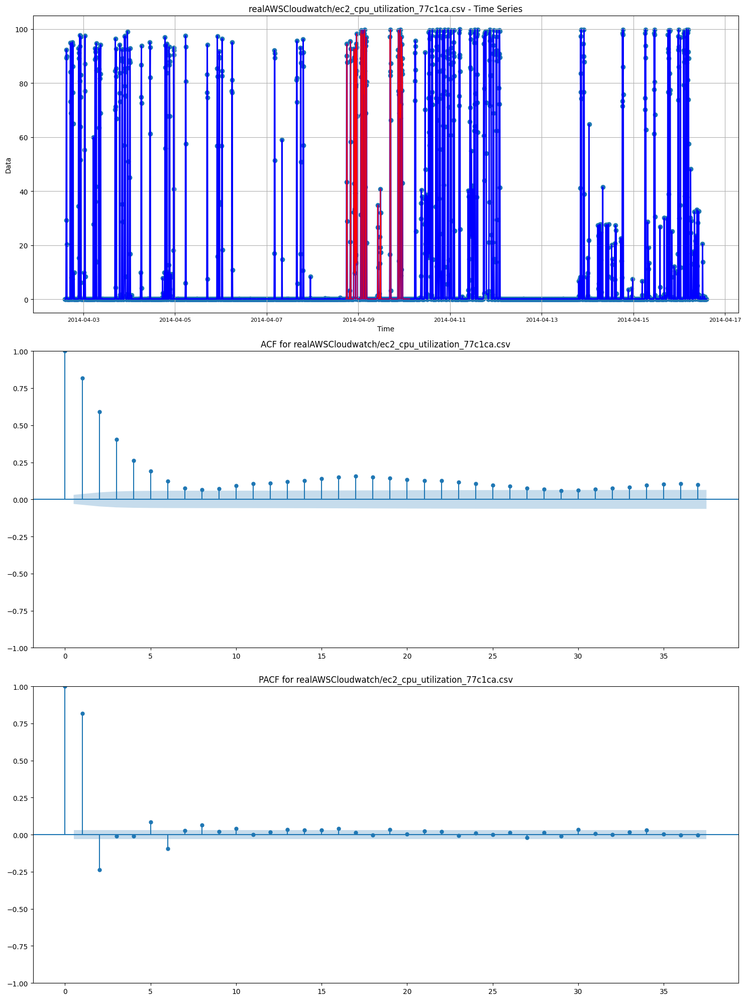

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 5.63499151910609
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -1.638642
p-value: 0.462970
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Non-stationary
The most frequent period is  4032.0


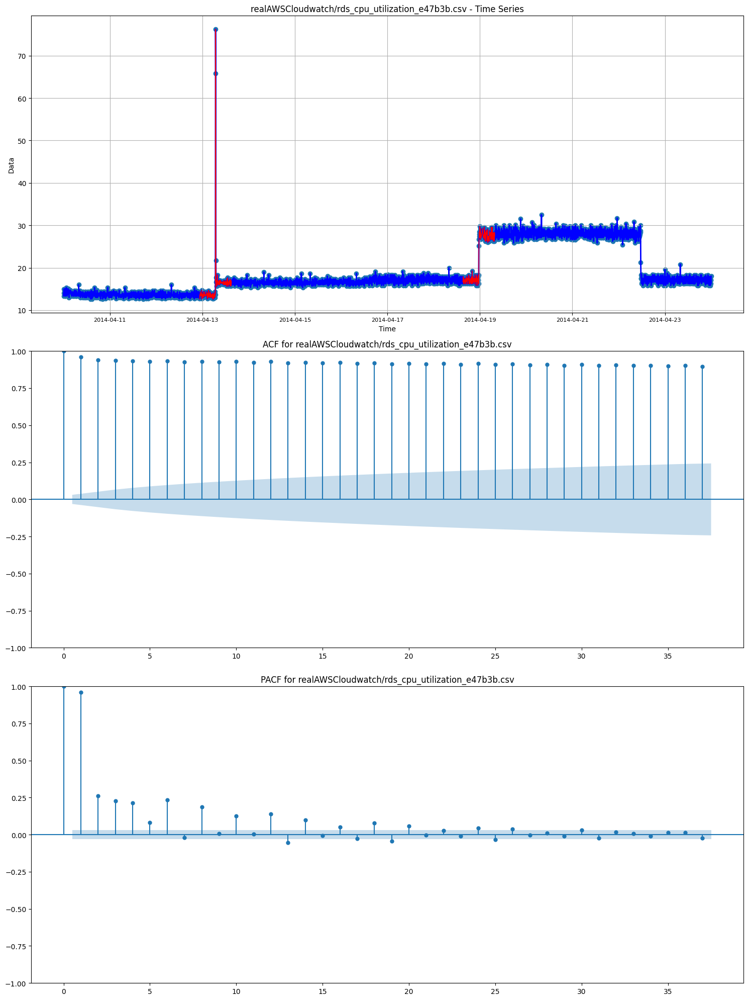

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.12912957348607954
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -10.604610
p-value: 0.000000
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  288.0


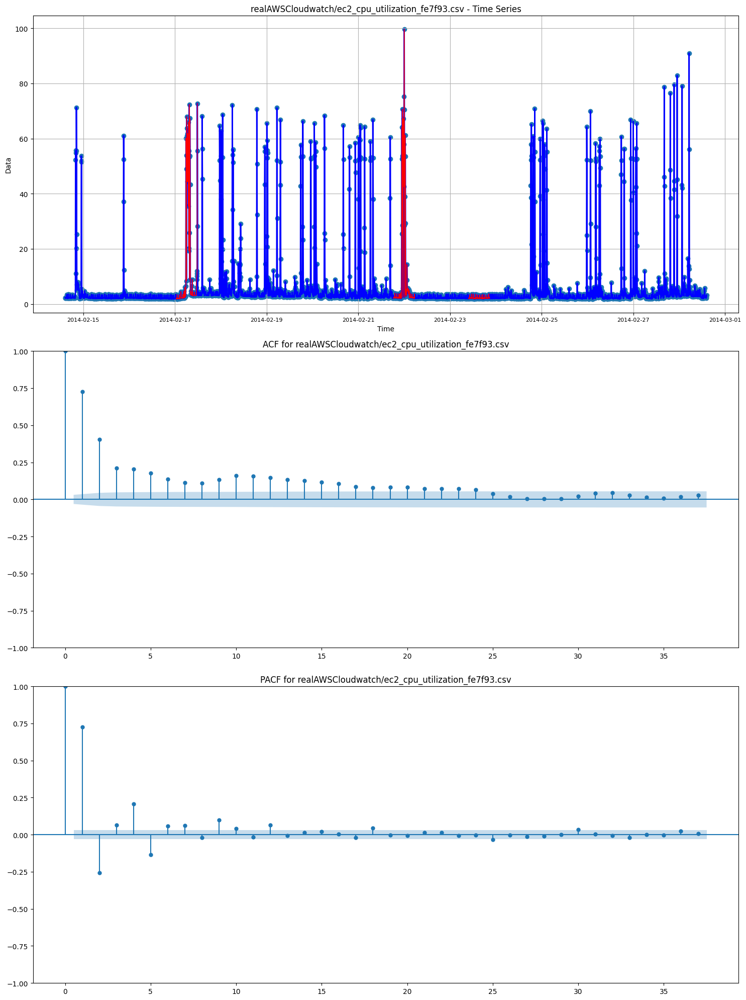

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 5.5067491541692055
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -0.687231
p-value: 0.850029
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Non-stationary
The most frequent period is  4621.0


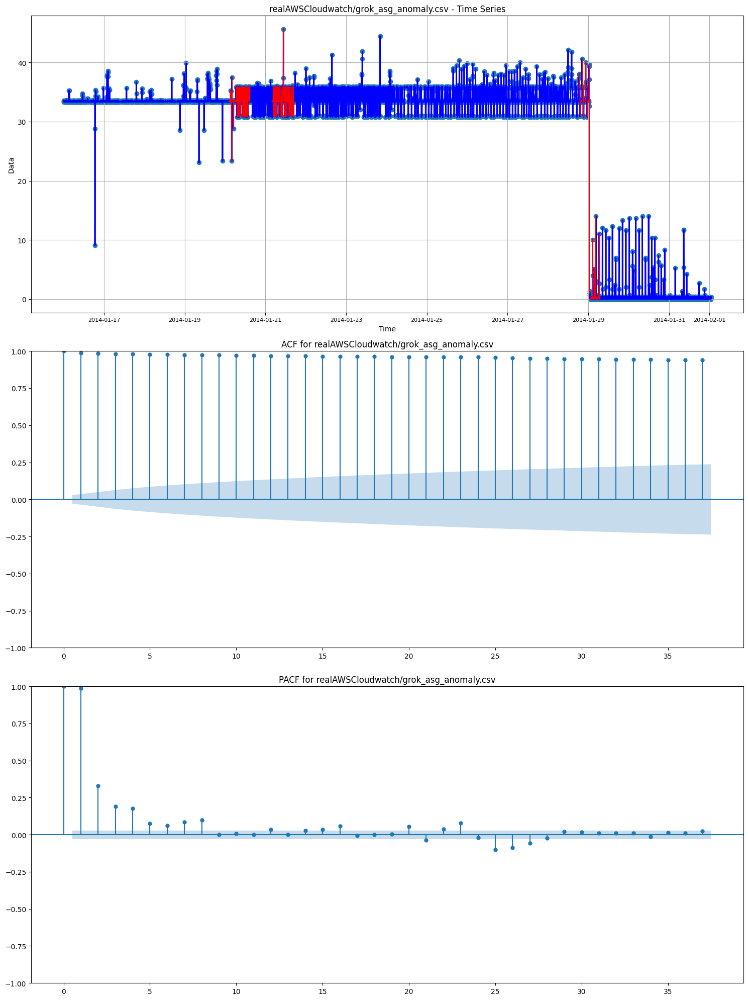

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 8.888223982962968
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -0.733508
p-value: 0.837878
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Non-stationary
The most frequent period is  4032.0


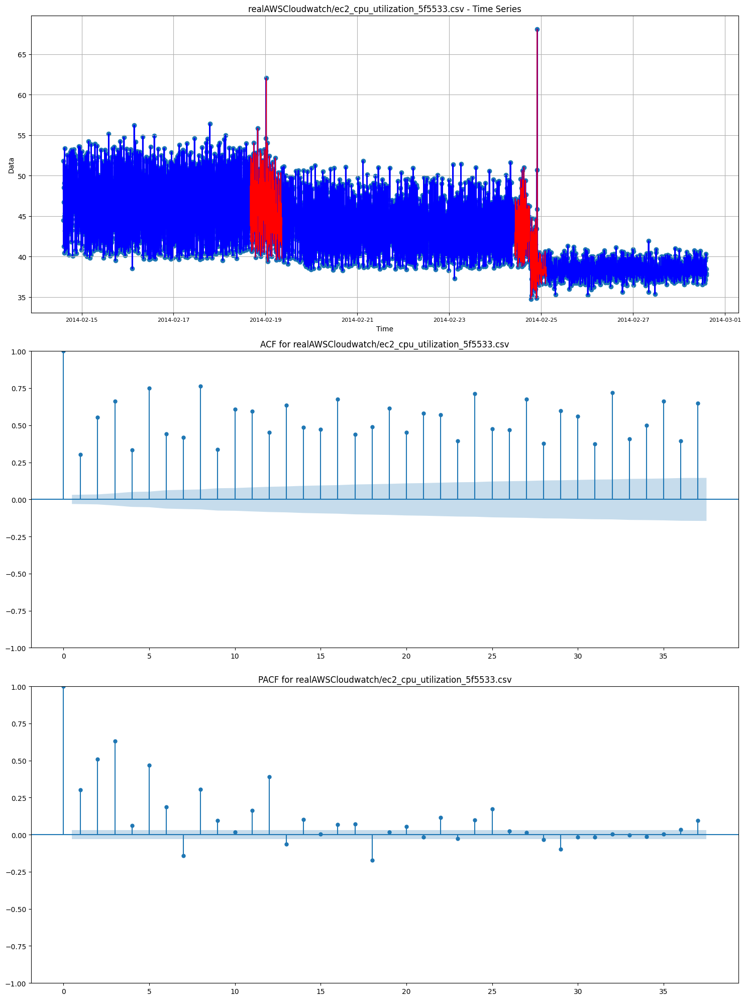

KPSS Statistic: 0.43375065031916715
p-value: 0.06260747831070382
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -4.234295
p-value: 0.000576
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  4032.0


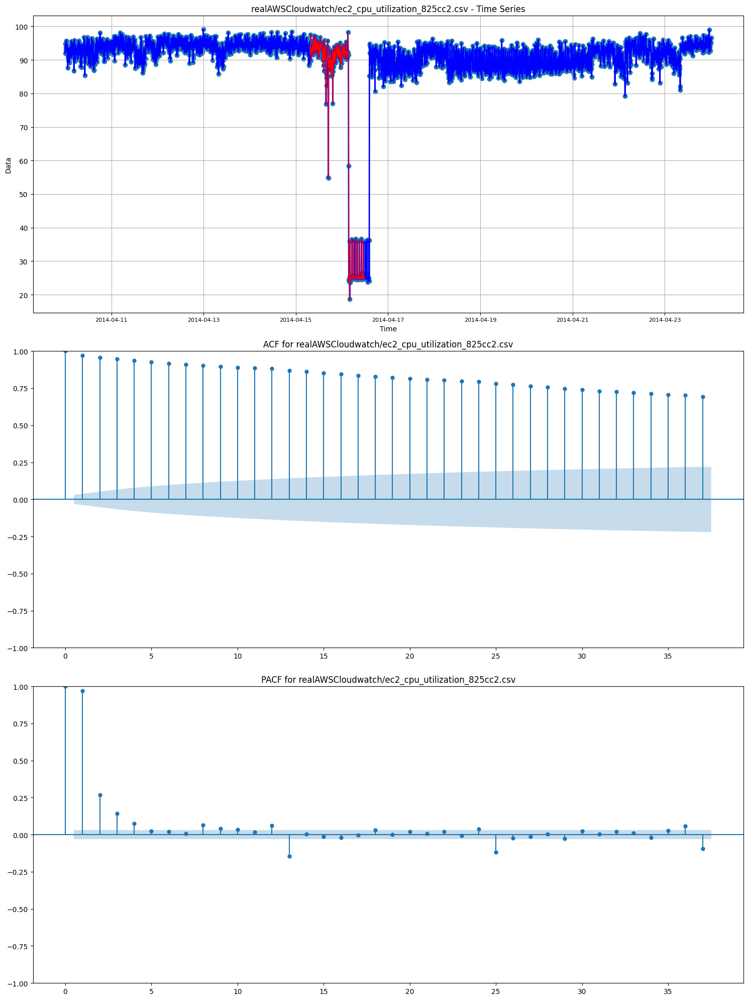

KPSS Statistic: 0.42652072349504216
p-value: 0.06572382607972321
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -5.902389
p-value: 0.000000
Critical Values:
	1%: -3.436
	5%: -2.864
	10%: -2.568
Stationary
The most frequent period is  310.75


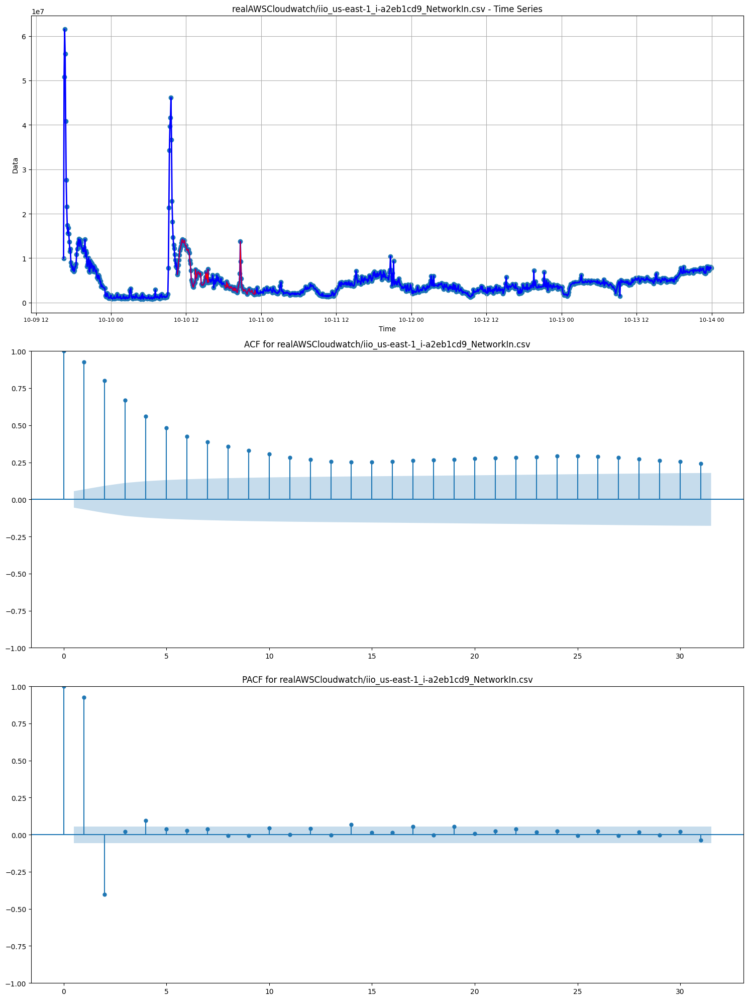

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.25392223737506364
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -11.280686
p-value: 0.000000
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  2016.0


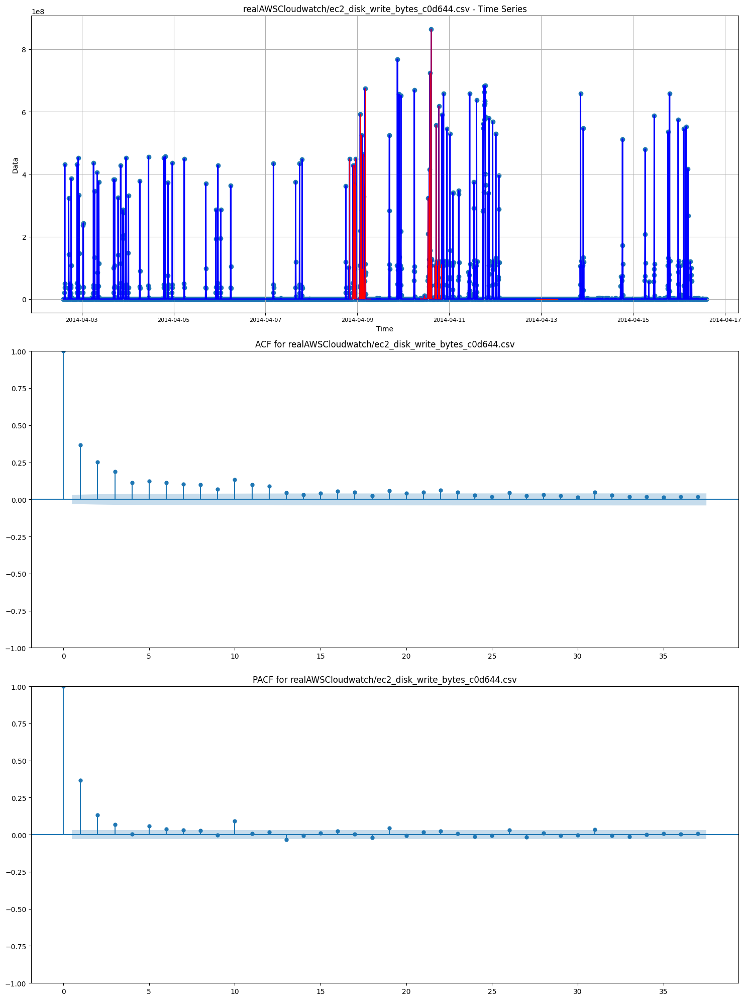

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.23909901923413893
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -8.360853
p-value: 0.000000
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  295.625


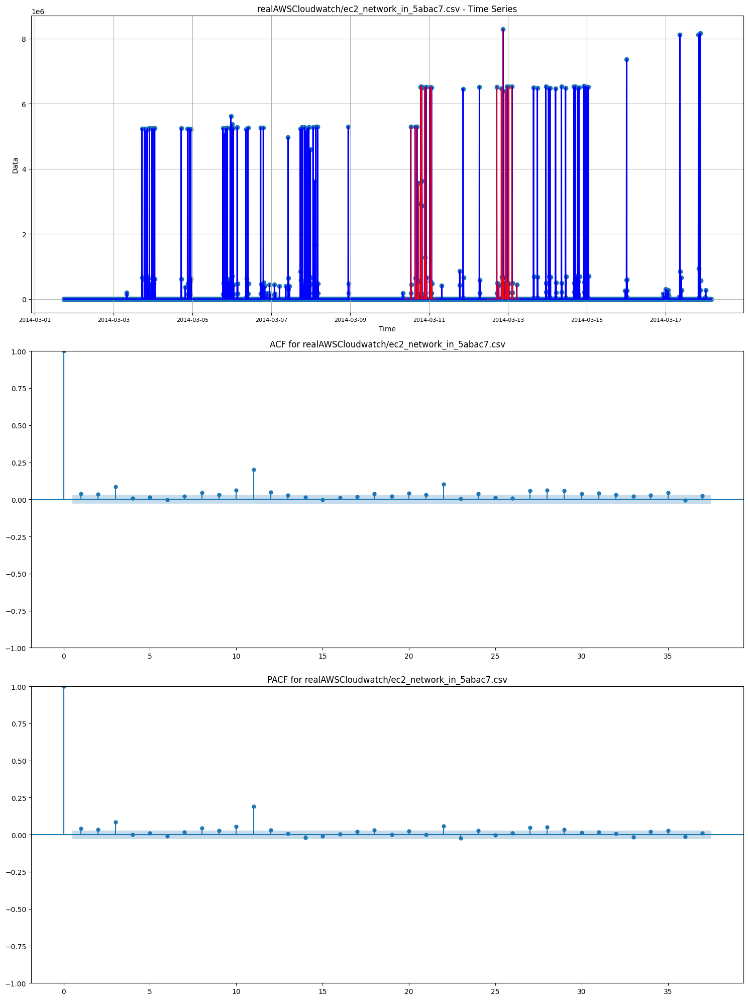

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 1.4659556266355311
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -23.287183
p-value: 0.000000
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  7933.0


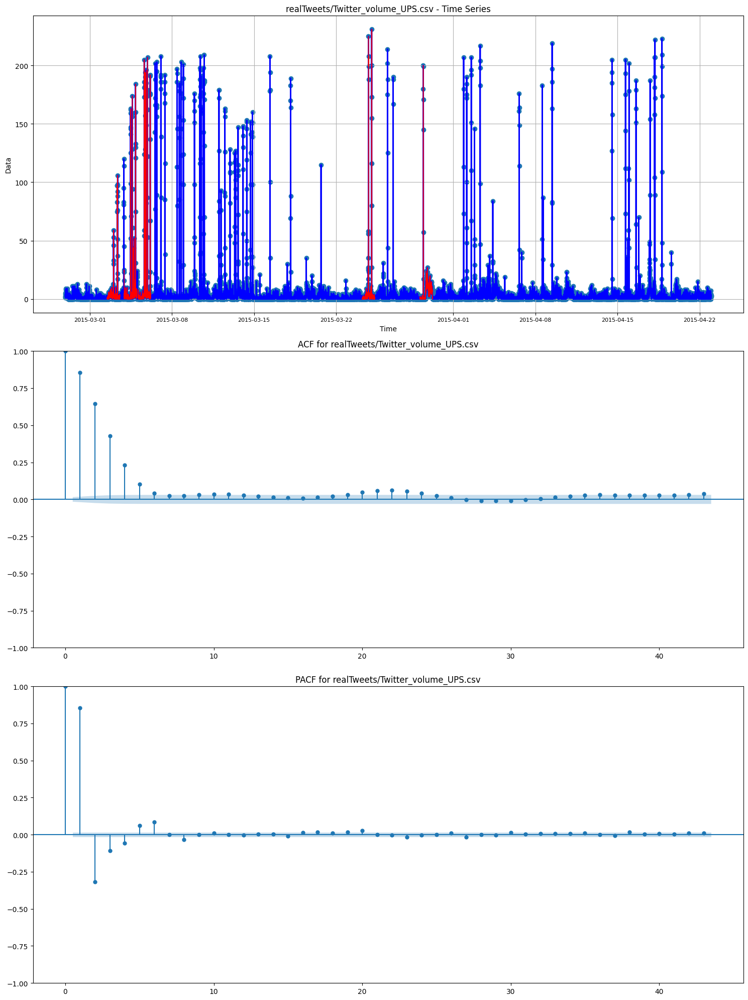

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.12178626861720654
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -10.371071
p-value: 0.000000
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  287.8727272727273


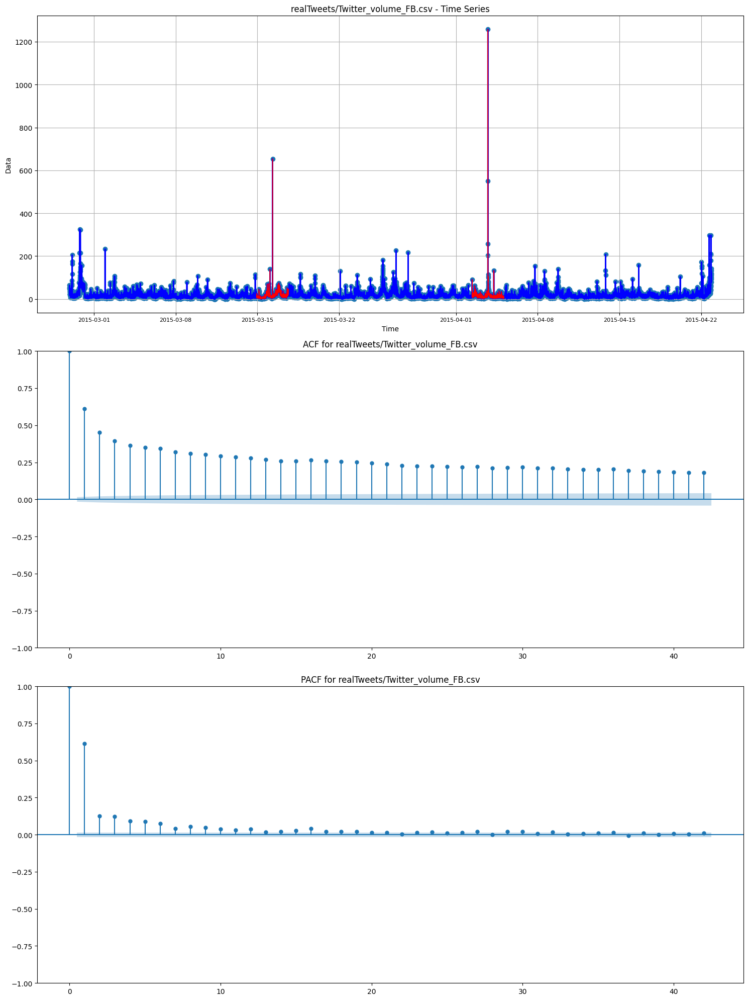

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.3170669652473919
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -12.834601
p-value: 0.000000
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  287.83636363636367


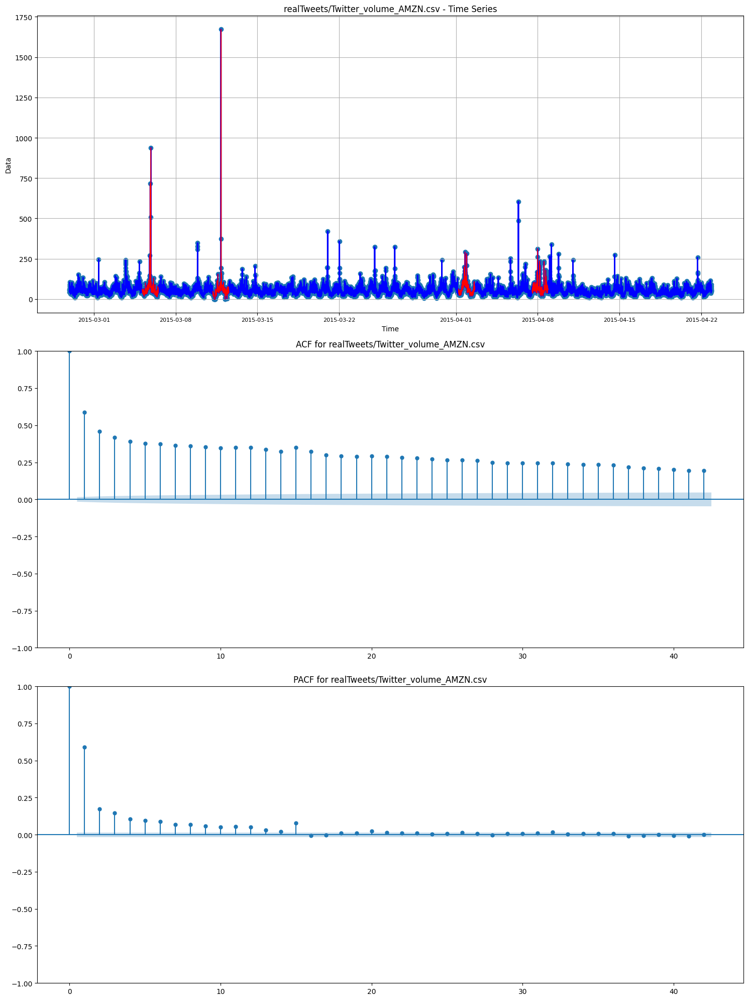

KPSS Statistic: 0.6502081651146686
p-value: 0.01807198498957558
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -11.937555
p-value: 0.000000
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  288.96363636363634


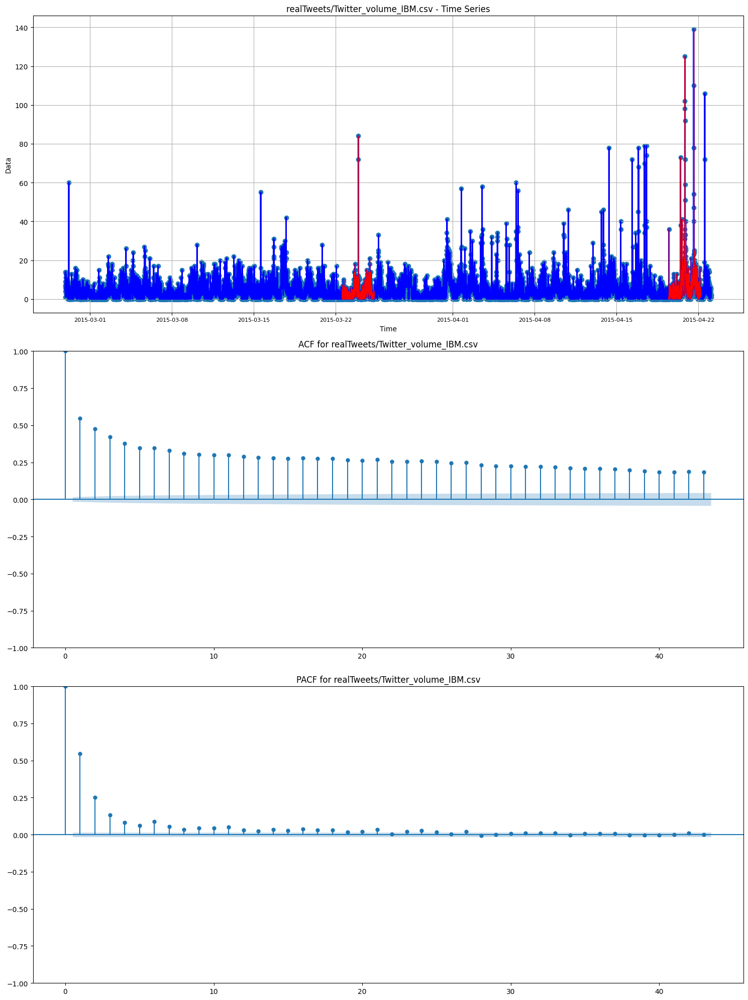

KPSS Statistic: 0.6207690014884392
p-value: 0.020748272591960073
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -17.675239
p-value: 0.000000
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  288.2


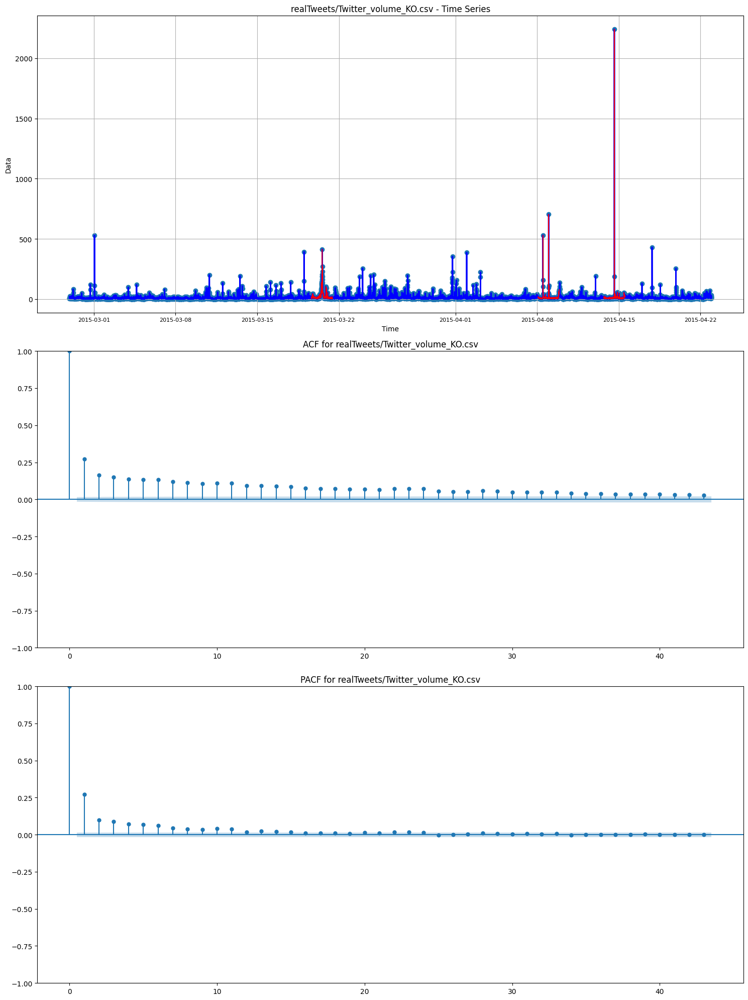

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.08459175582581273
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -10.603732
p-value: 0.000000
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  288.03636363636366


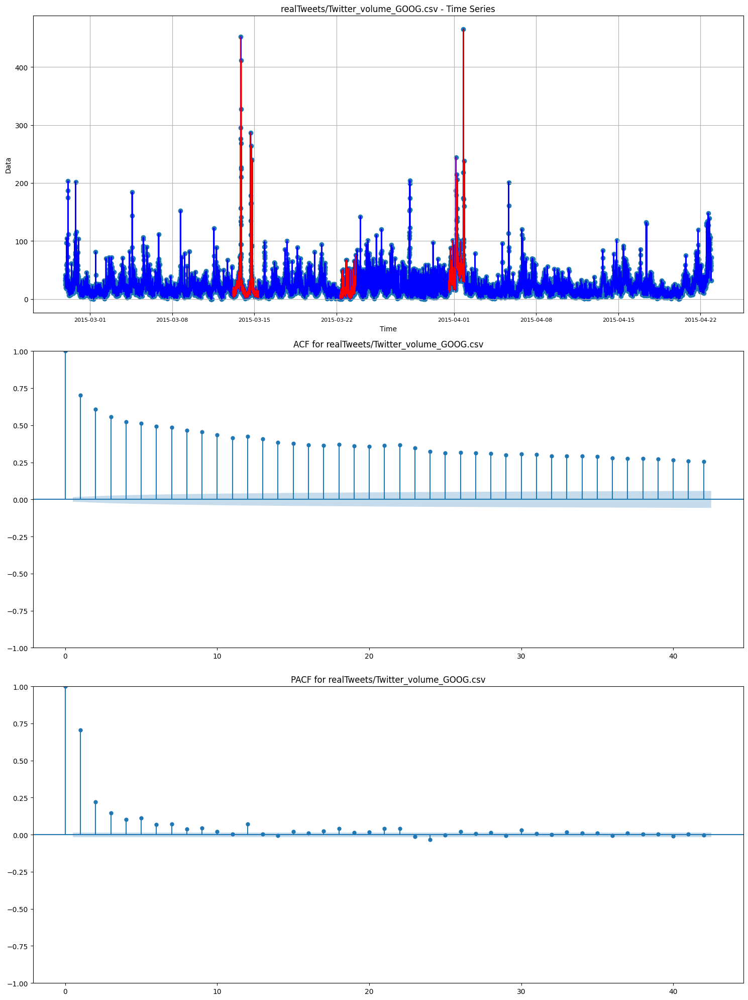

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.3315820528852594
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -8.612995
p-value: 0.000000
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  289.12727272727267


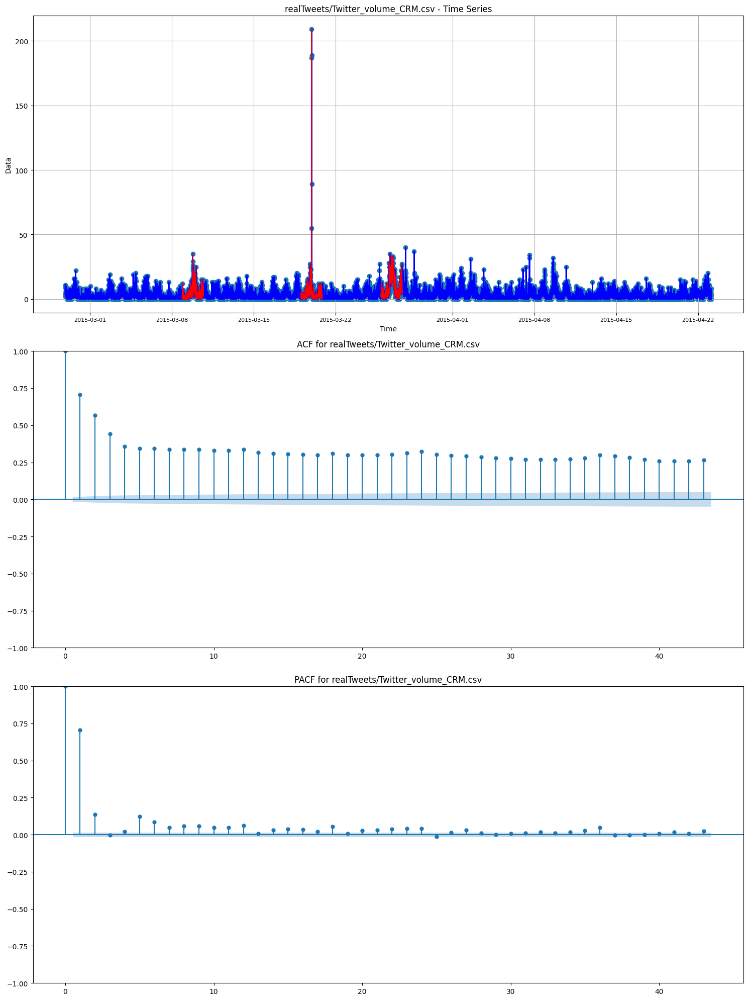

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.20093206982262482
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -23.200951
p-value: 0.000000
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  1987.7499999999998


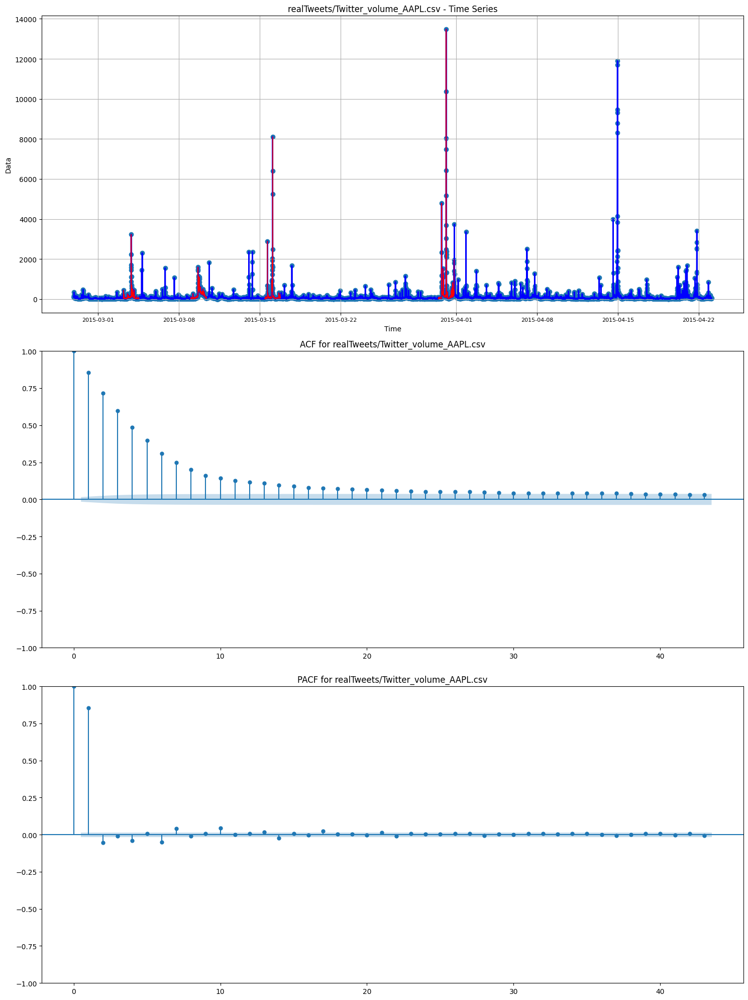

KPSS Statistic: 0.4579183977220655
p-value: 0.05219034580945454
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -17.448953
p-value: 0.000000
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  288.23636363636365


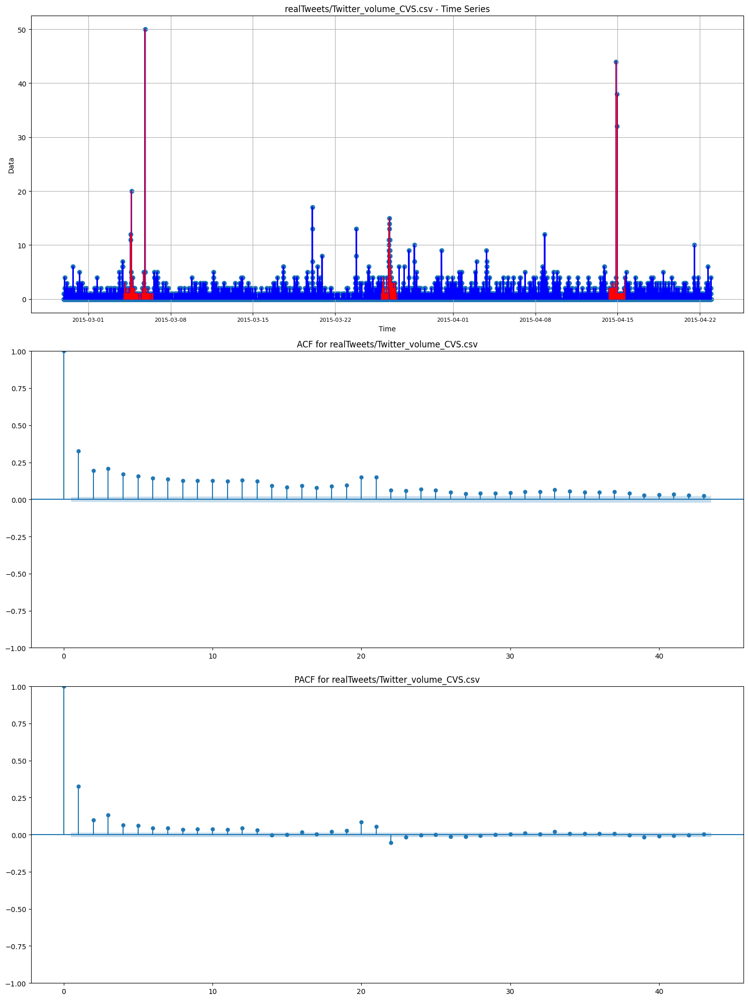

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.10681261717153907
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -10.492373
p-value: 0.000000
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  288.32727272727277


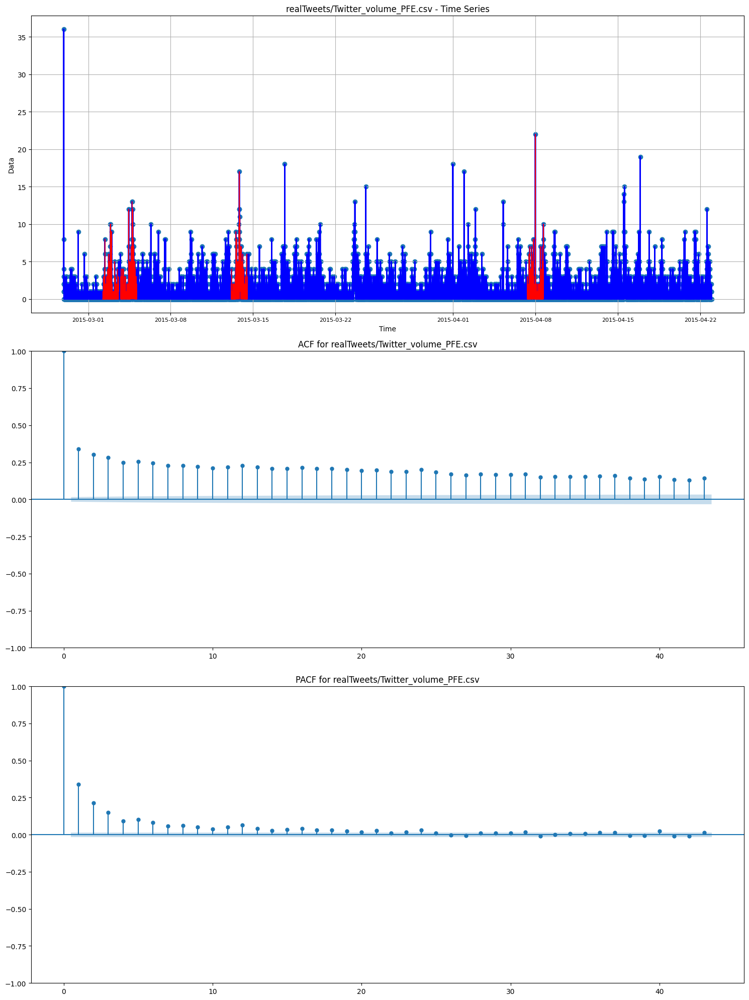

KPSS Statistic: 0.6498970072129311
p-value: 0.018100272071551717
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -3.768793
p-value: 0.003243
Critical Values:
	1%: -3.435
	5%: -2.863
	10%: -2.568
Stationary
The most frequent period is  1538.0


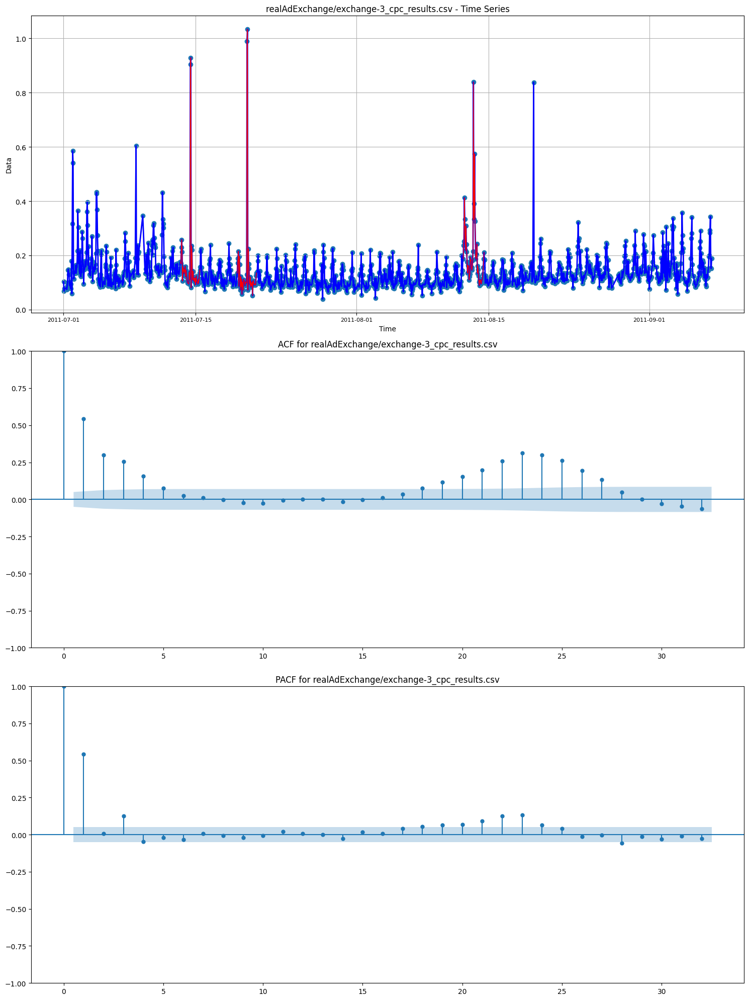

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 2.7715238631003563
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -1.982012
p-value: 0.294516
Critical Values:
	1%: -3.435
	5%: -2.863
	10%: -2.568
Non-stationary
The most frequent period is  1538.0


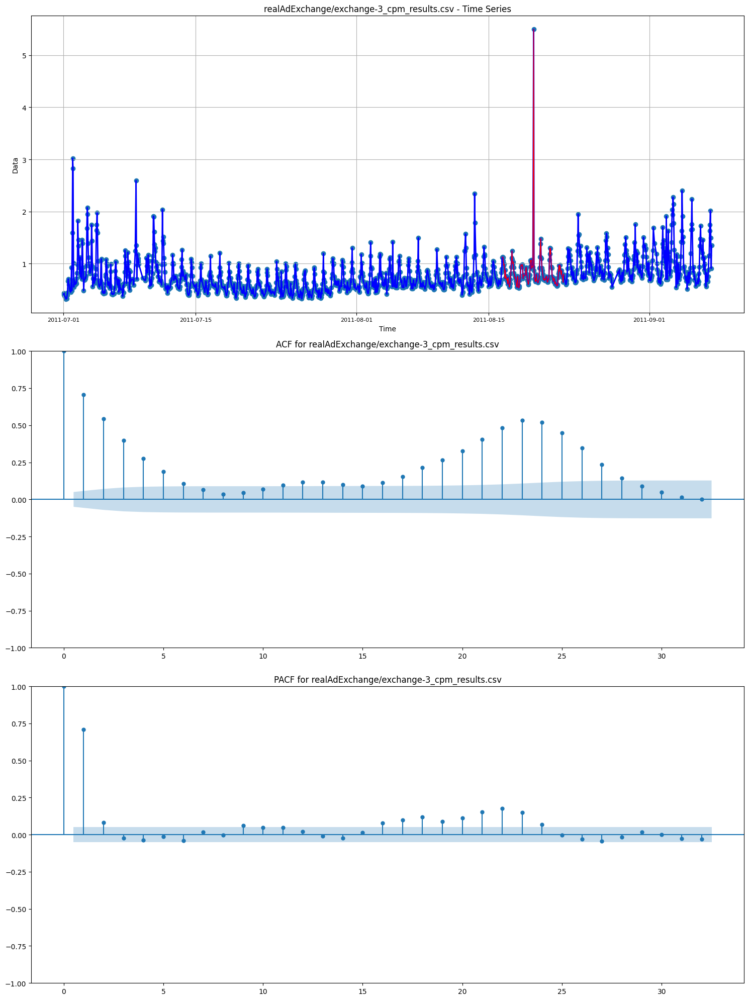

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 1.6082838905923296
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -3.092048
p-value: 0.027147
Critical Values:
	1%: -3.434
	5%: -2.863
	10%: -2.568
Stationary
The most frequent period is  23.88235294117647


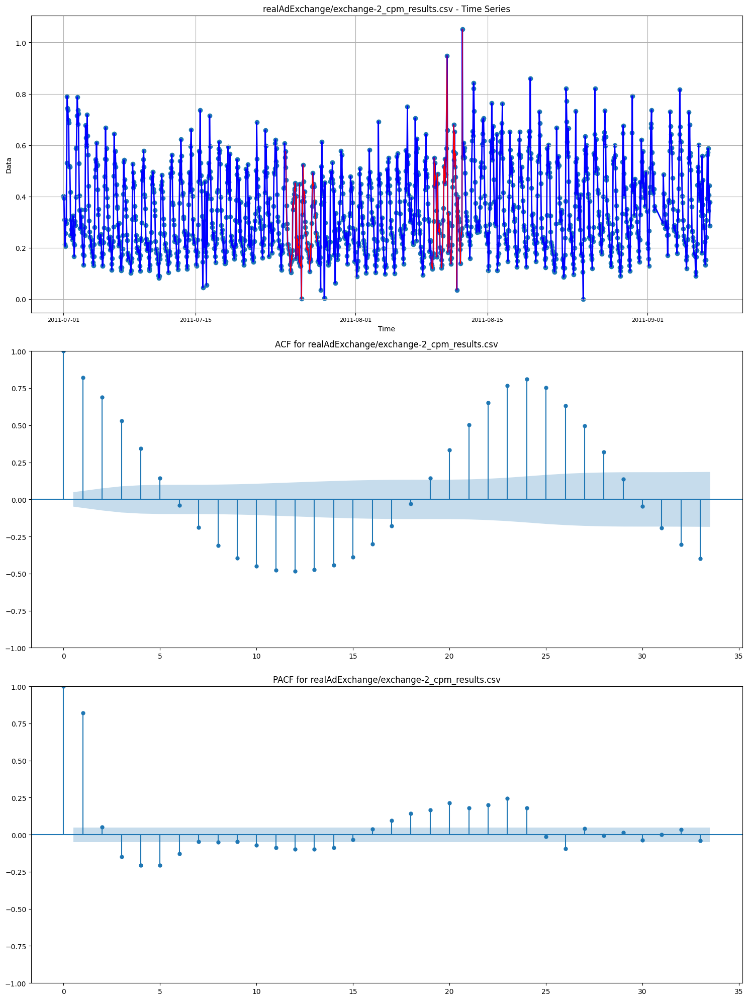

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.1700145903396511
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -14.453974
p-value: 0.000000
Critical Values:
	1%: -3.434
	5%: -2.863
	10%: -2.568
Stationary
The most frequent period is  23.81159420289855


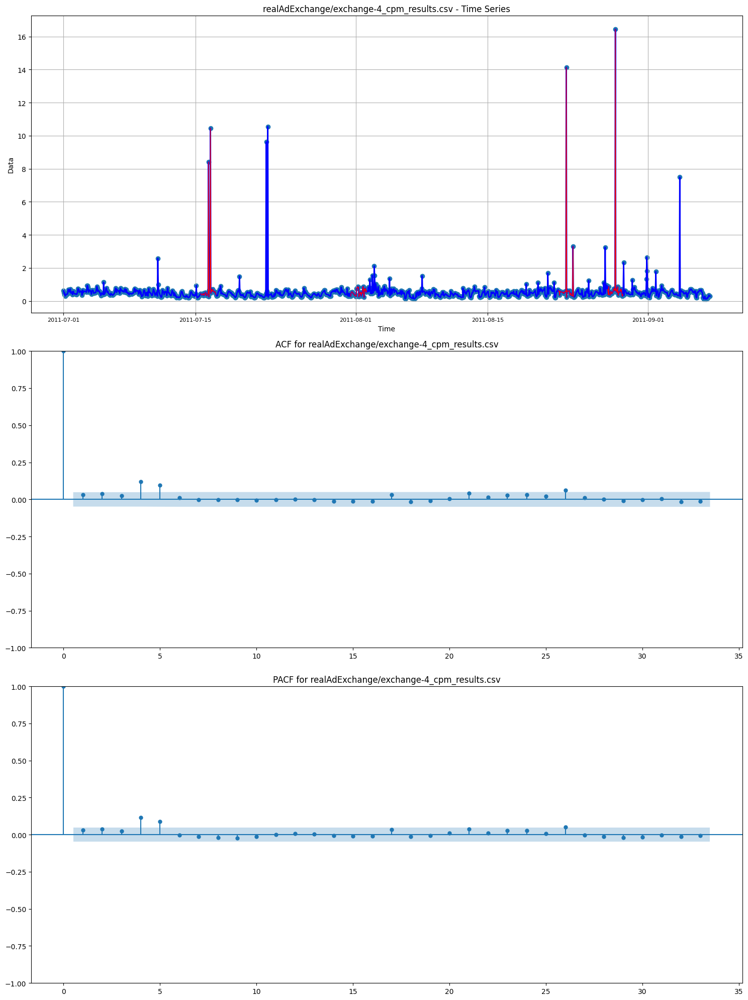

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 1.4713688393242925
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -14.080060
p-value: 0.000000
Critical Values:
	1%: -3.434
	5%: -2.863
	10%: -2.568
Stationary
The most frequent period is  1643.0


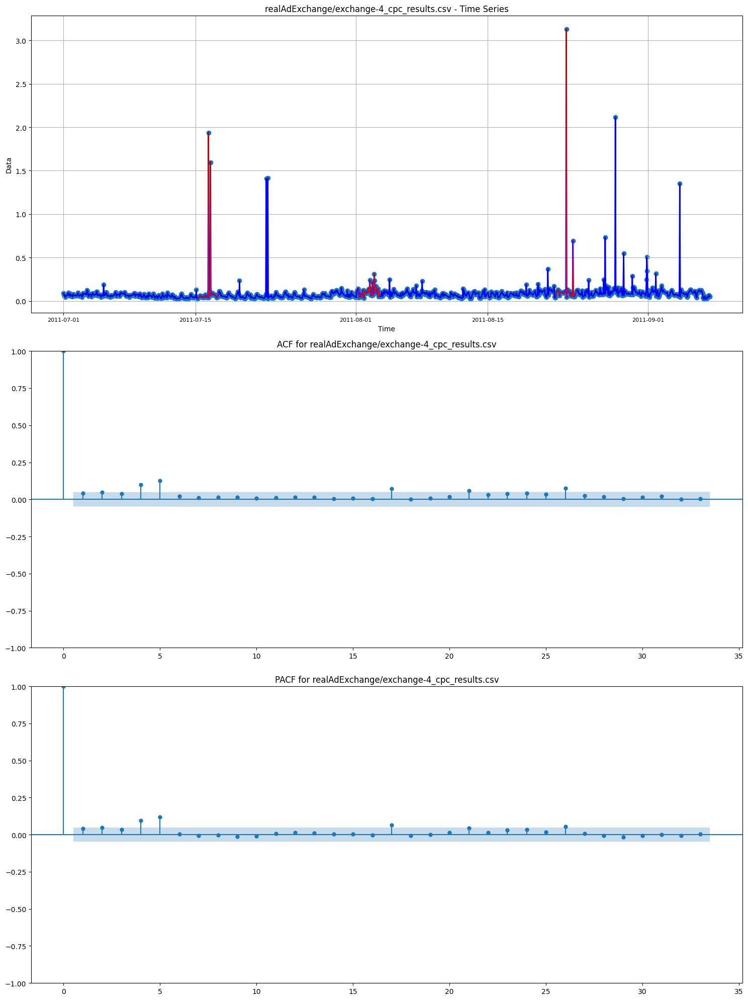

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 3.277123774558454
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -2.457233
p-value: 0.126230
Critical Values:
	1%: -3.434
	5%: -2.863
	10%: -2.568
Non-stationary
The most frequent period is  23.88235294117647


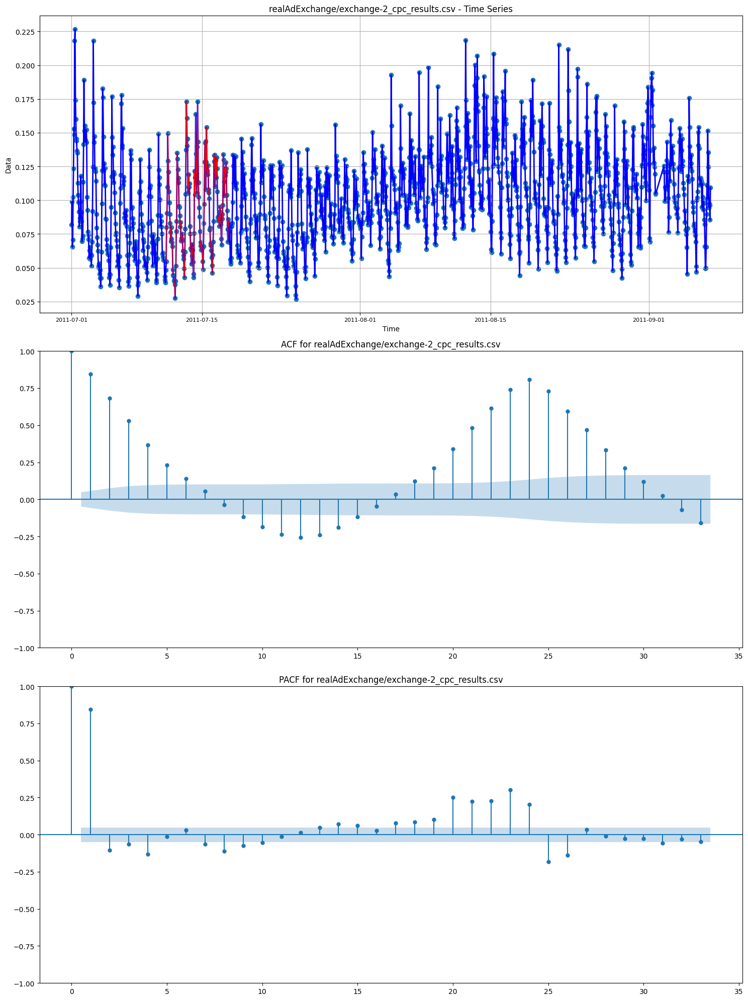

KPSS Statistic: 0.6378917599869031
p-value: 0.01919165818300881
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -5.156198
p-value: 0.000011
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  2016.0


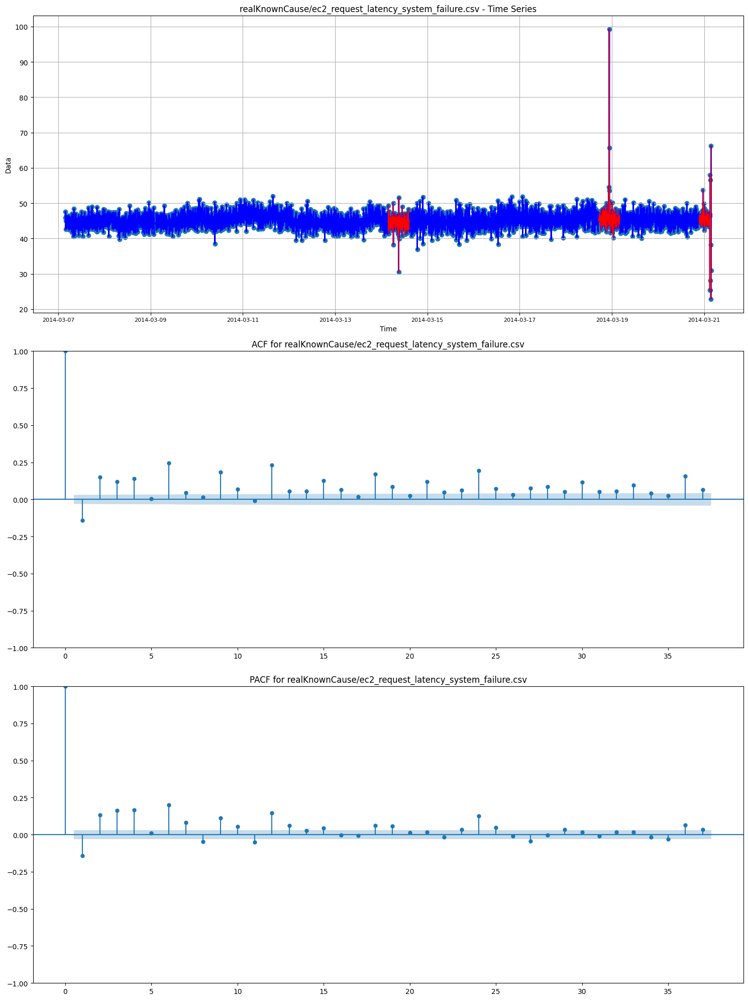

KPSS Statistic: 0.47248579710844446
p-value: 0.047863559209809815
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -7.369090
p-value: 0.000000
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  1745.7692307692307


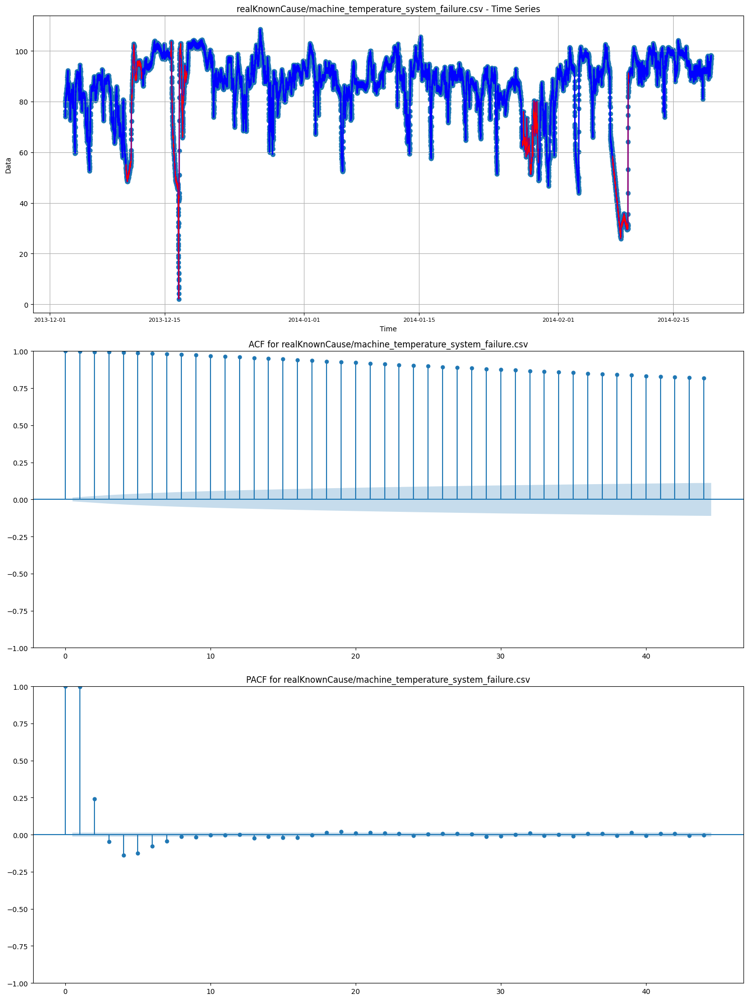

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.9274312729653883
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -6.035466
p-value: 0.000000
Critical Values:
	1%: -3.434
	5%: -2.863
	10%: -2.568
Stationary
The most frequent period is  1882.0


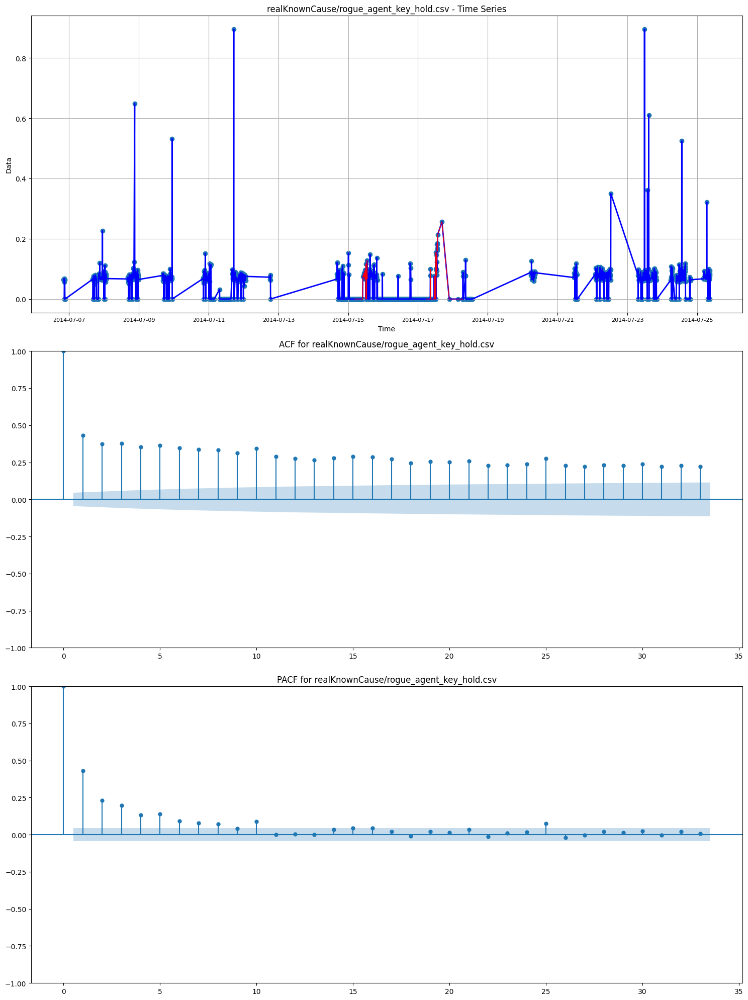

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.24267083944378104
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -9.831793
p-value: 0.000000
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  664.375


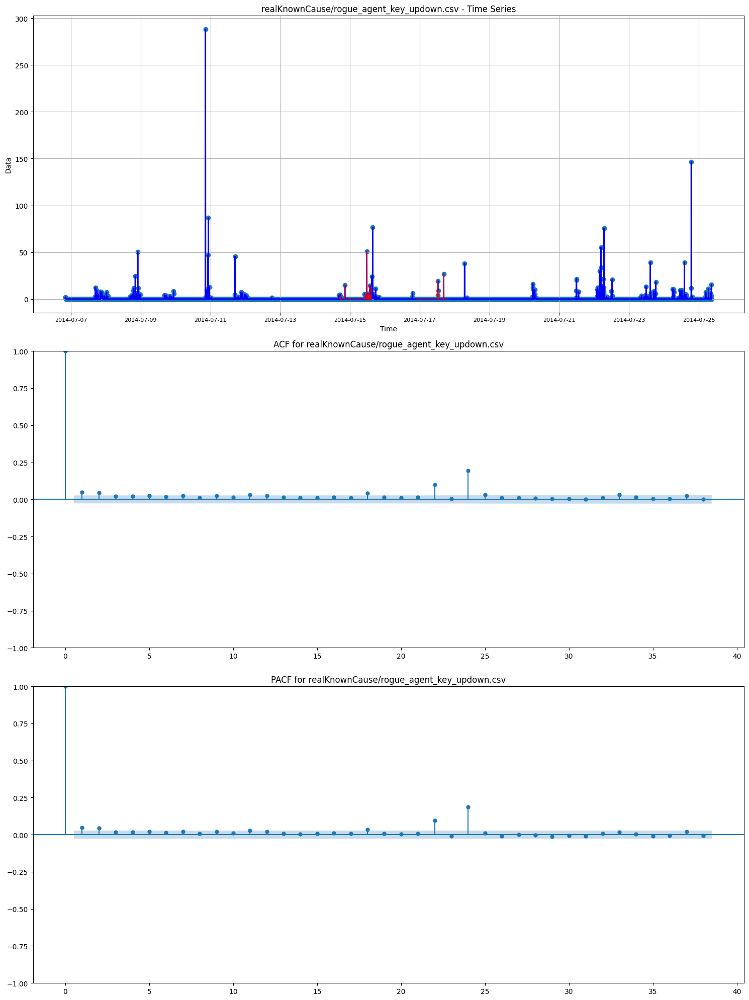

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 3.797020553336175
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -5.517563
p-value: 0.000002
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  7266.999999999999


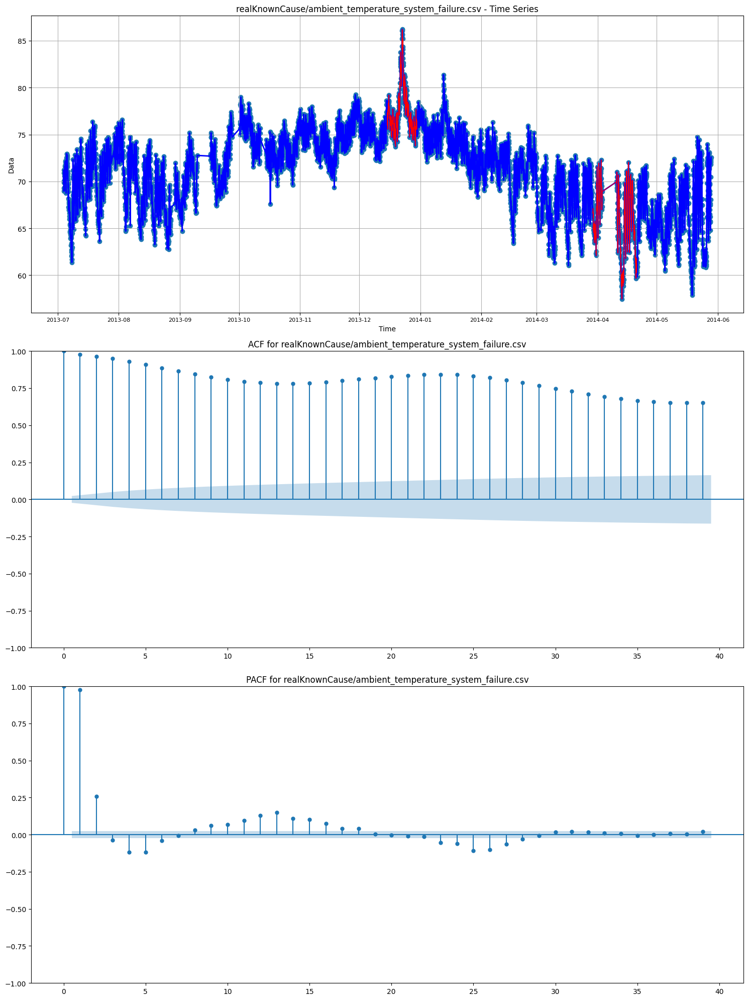

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 5.888750481177466
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -5.926240
p-value: 0.000000
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  12.001329787234042


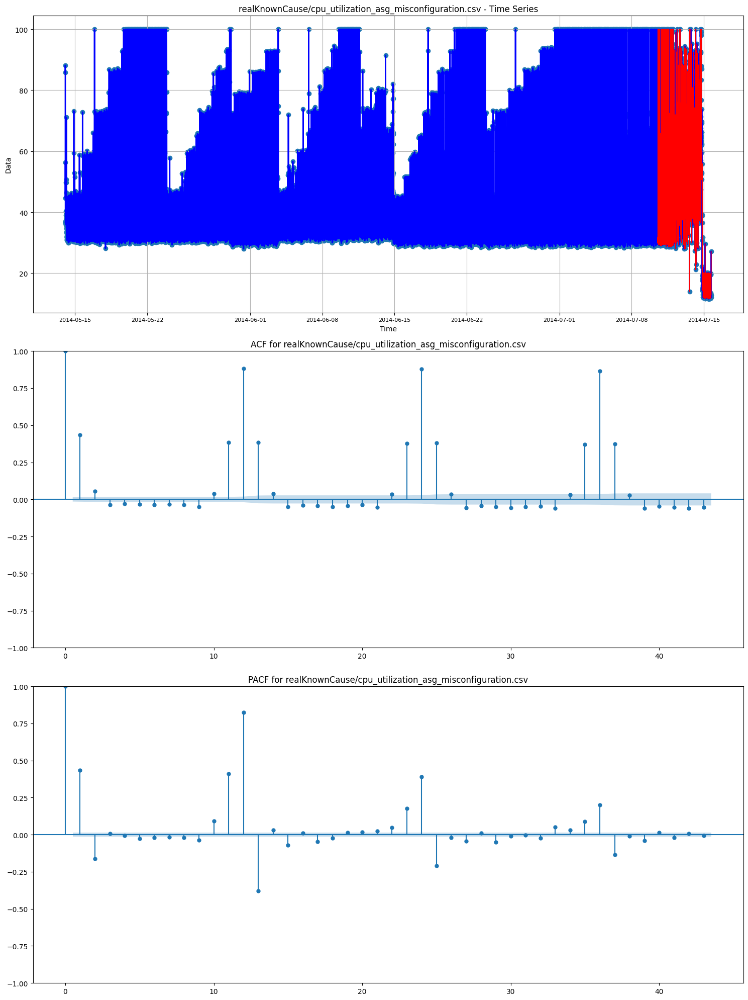

KPSS Statistic: 0.418064394398016
p-value: 0.06936879551809655
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -10.764517
p-value: 0.000000
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  48.0


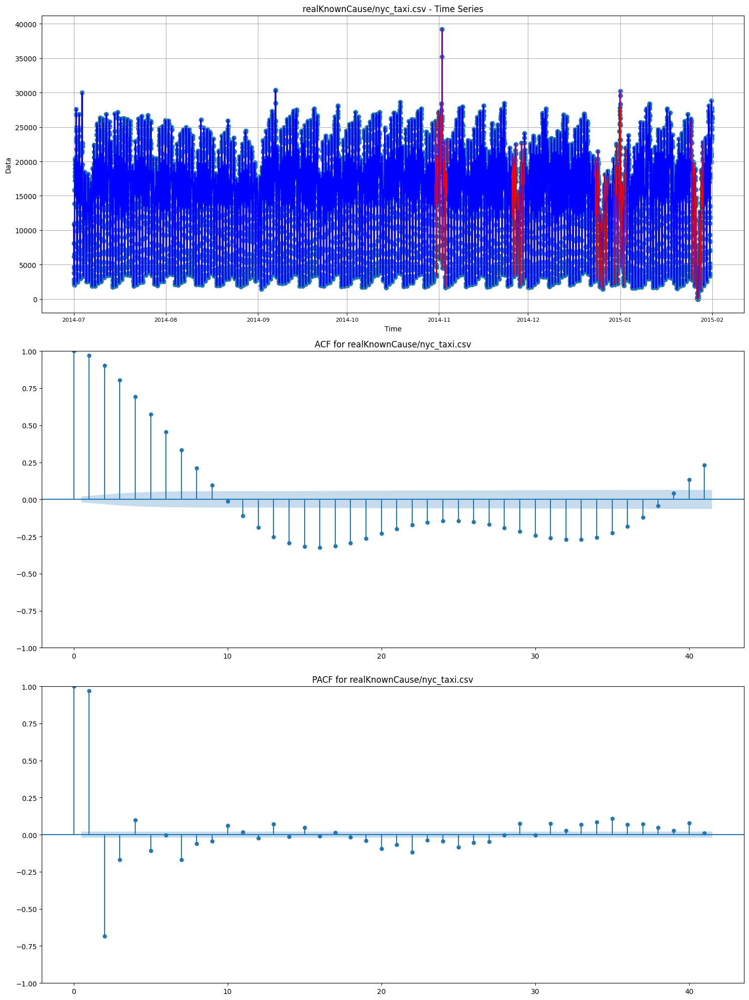

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.03856315309096897
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -5.858763
p-value: 0.000000
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  288.0


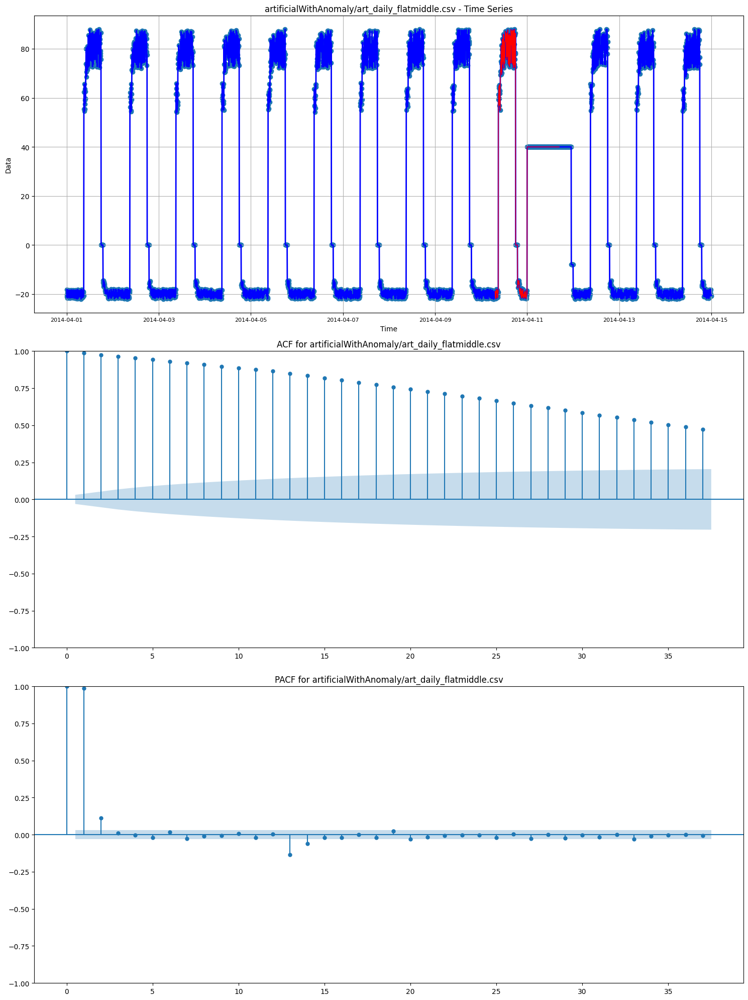

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.05821112934573597
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -5.798244
p-value: 0.000000
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  288.0


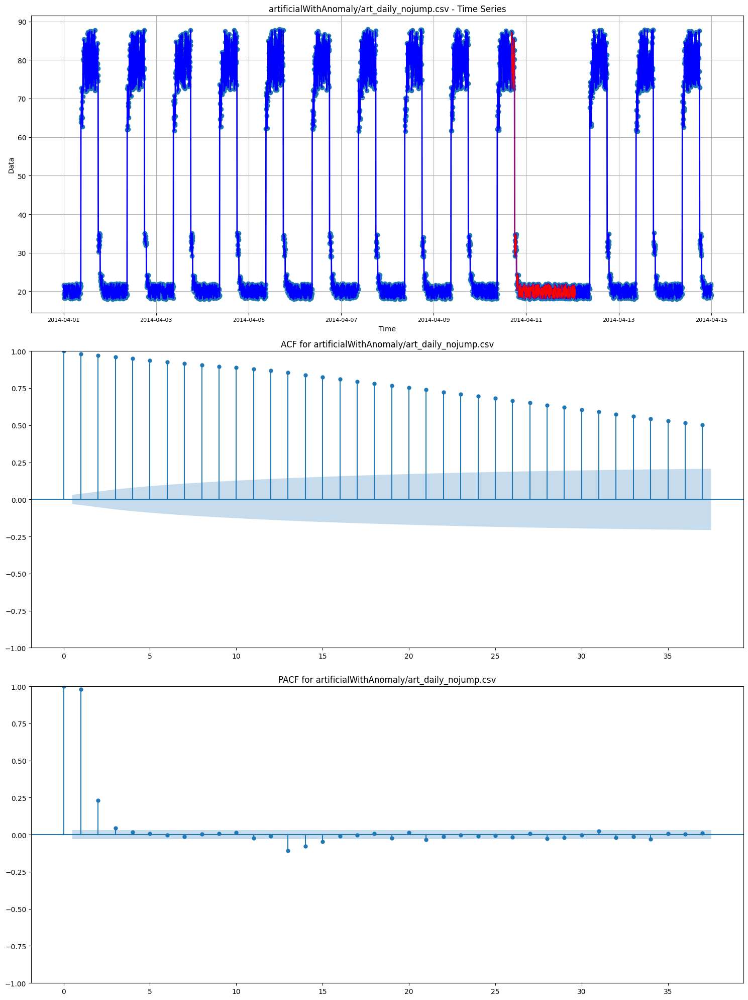

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 1.0689171864379008
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
ADF Statistic: -6.248298
p-value: 0.000000
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  2016.0


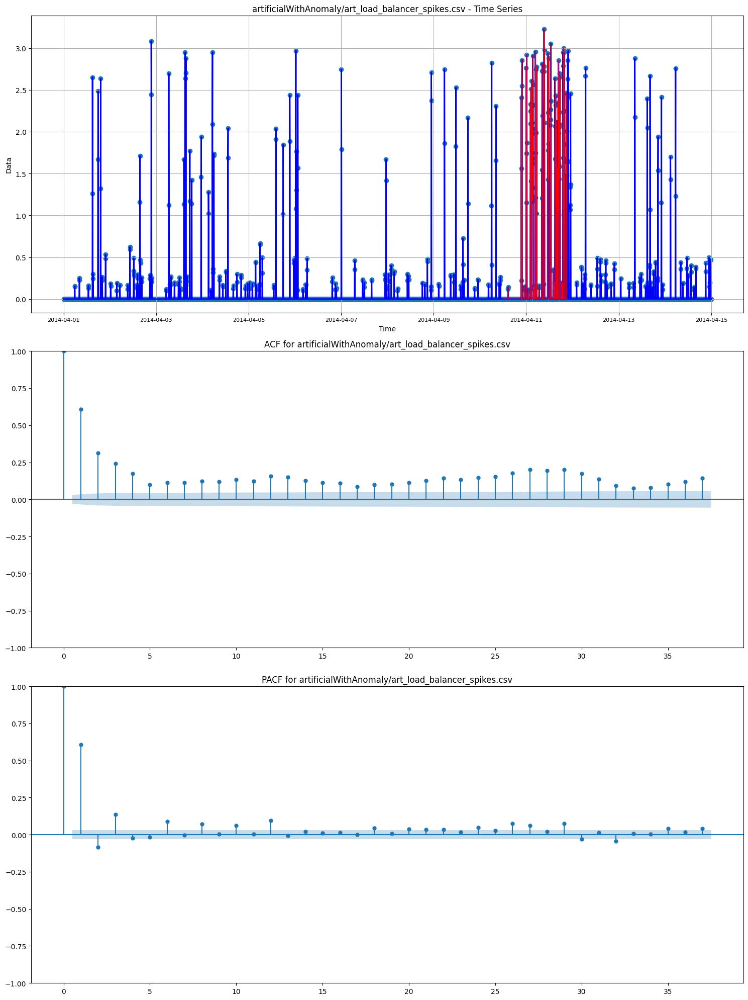

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.08198901766493469
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -5.908387
p-value: 0.000000
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  288.0


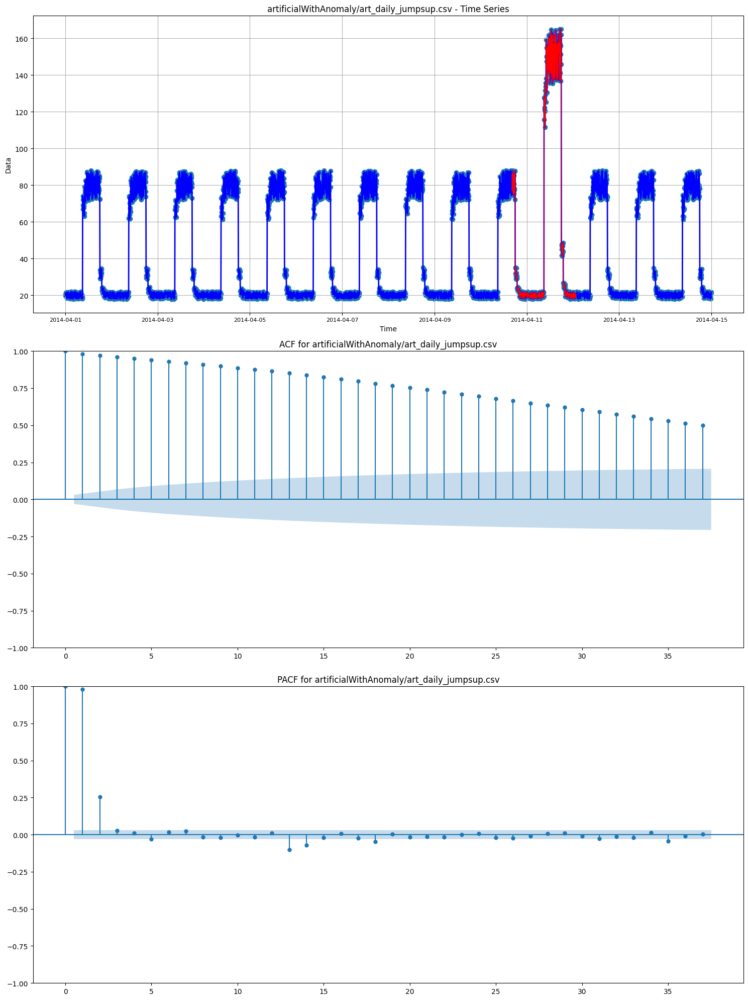

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.031045002774095717
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -5.991233
p-value: 0.000000
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  288.0


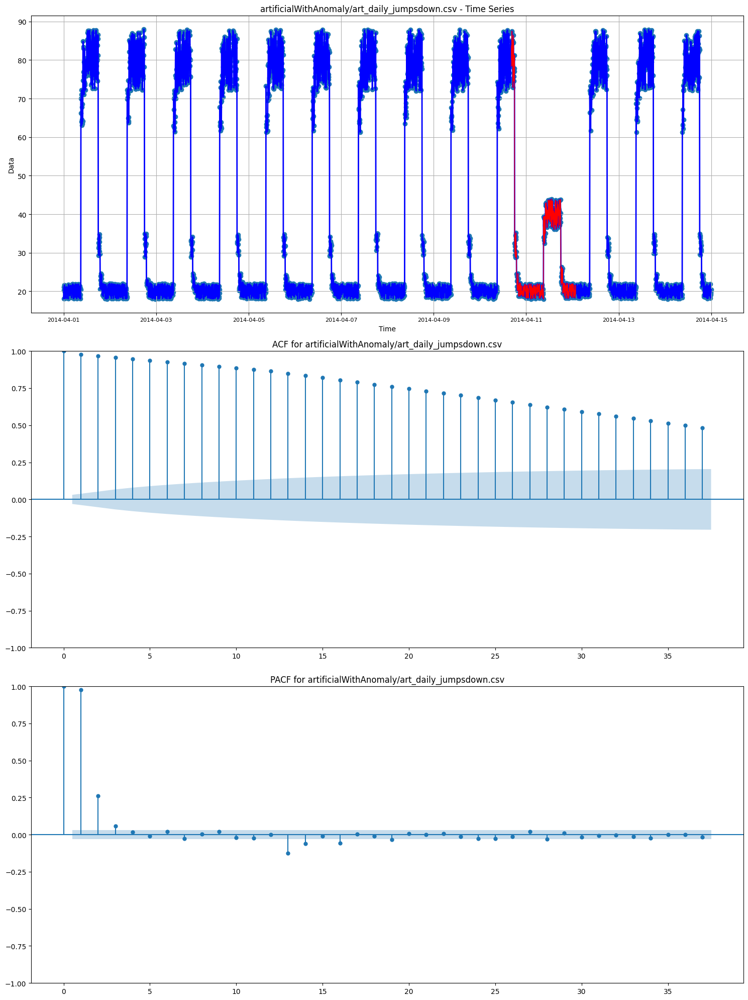

<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


KPSS Statistic: 0.009055057100336291
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
ADF Statistic: -12.269916
p-value: 0.000000
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567
Stationary
The most frequent period is  2.940919037199125


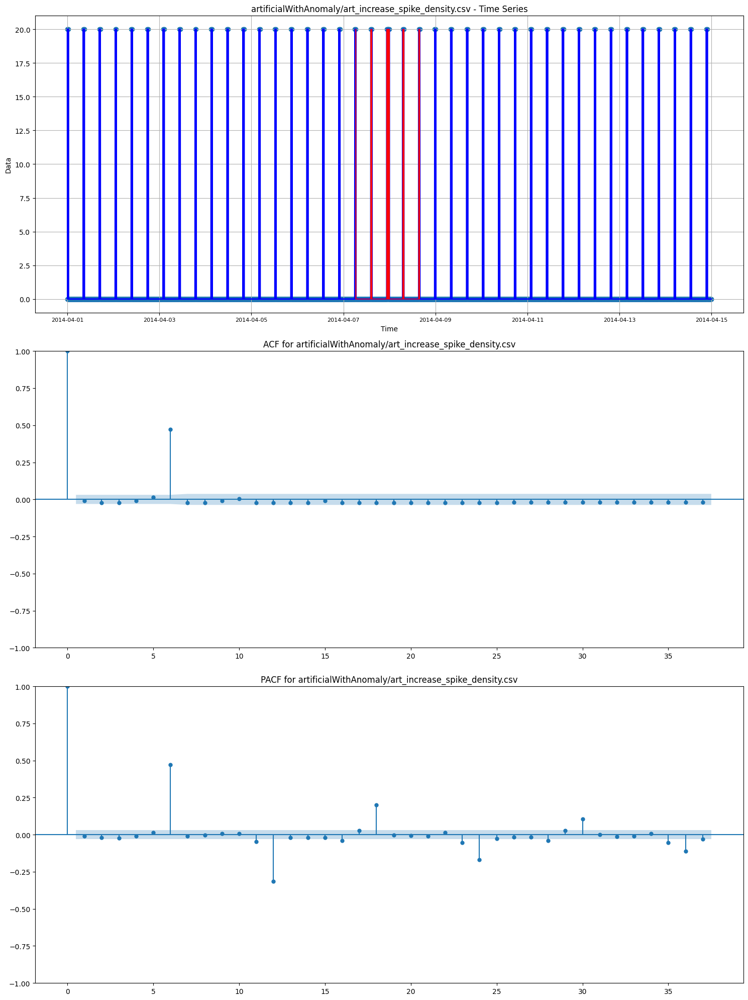

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from statsmodels.tsa.stattools import adfuller, kpss
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from scipy.signal import periodogram  # Import periodogram

# Assuming `data` is a nested dictionary with the structure:
# data = {'category1': {'sub_category1': {'value': ..., 'timestamp': ..., 'interval': ...}, ...}, ...}

fig_num = 1

for key1 in data:
    for key2 in data[key1]:
        y = data[key1][key2]['value']
        x = pd.to_datetime(data[key1][key2]['timestamp'])

        # Perform KPSS test
        try:
            kpss_test(y.values)
        except Exception as e:
            print(f"KPSS test failed for {key1}/{key2}: {e}")

        # Perform ADF test
        try:
            check_stationarity(y)
        except Exception as e:
            print(f"ADF test failed for {key1}/{key2}: {e}")

        # Create a new figure for each dataset
        fig, axes = plt.subplots(3, 1, figsize=(15, 20))  # Create figure with 4 subplots

        # Plot the main time series
        axes[0].plot(x, y, 'b-', linewidth=2)
        axes[0].set_title(f"{key1}/{key2} - Time Series")
        axes[0].set_xlabel('Time')
        axes[0].set_ylabel('Data')
        plt.setp(axes[0].get_xticklabels(), size=8)

        # Highlight intervals in red if needed
        i = 0
        while i < len(data[key1][key2]['interval']) and data[key1][key2]['interval'][i] != 0:
            bold = data[key1][key2]['interval'][i]
            axes[0].plot(x[bold], y[bold], 'r-', linewidth=1)
            i += 1

        # Add scatter plot of all points
        axes[0].scatter(x, y)
        axes[0].grid()

        # Plot the ACF
        plot_acf(y, ax=axes[1])
        axes[1].set_title(f"ACF for {key1}/{key2}")

        # Plot the PACF
        plot_pacf(y, ax=axes[2])
        axes[2].set_title(f"PACF for {key1}/{key2}")

        # Calculate and plot the periodogram
        freq, power = periodogram(y.values)
        period = 1 / freq[np.argmax(power)] if np.any(freq > 0) else np.nan
        print("The most frequent period is ", period)

        # Adjust layout to fit everything nicely and display the plots
        plt.tight_layout()
        plt.show()

        fig_num += 1  # Increment figure number


## Avg count of timestamps of all NAB datasets

In [ ]:
# Calculate the total number of rows and the total number of dataframes
total_rows = 0
total_dataframes = 0

for key1 in data:
    for key2 in data[key1]:
        # Count the number of rows in each dataframe and add to the total
        total_rows += len(data[key1][key2])
        total_dataframes += 1

# Calculate the average count of rows
if total_dataframes > 0:
    average_row_count = total_rows / total_dataframes
else:
    average_row_count = 0

print(f"Average count of rows across all dataframes: {average_row_count:.2f}")


Average count of rows across all dataframes: 6614.39


### Yahoo A1 Dataset

### Initialize dataset

In [ ]:
# Create a dictionary to hold all DataFrames
dfsA1 = {}

# Loop through the range 1 to 67 (inclusive) and load data
for i in range(1, 68):
    file_path = f"/content/drive/My Drive/YAHOO/A1/Yahoo_A1real_{i}_data.out"
    dfsA1[i] = pd.read_csv(file_path, sep=",", names=[f"value_{i}", "label"])

### Average length of each time series

In [ ]:
row_counts = [df.shape[0] for df in dfsA1.values()]

# Calculate the average count of rows
average_count = sum(row_counts) / len(row_counts)
print("Average count of rows across all DataFrames:", average_count)

Average count of rows across all DataFrames: 1415.910447761194


### YAHOO A1 Datasets with their respective stationarities (by ADF and KPSS), their ACF, PACF plots, their most frequent periodicity

ADF Statistic: -3.279475
p-value: 0.015821
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 1.4803285058030646
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1420.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


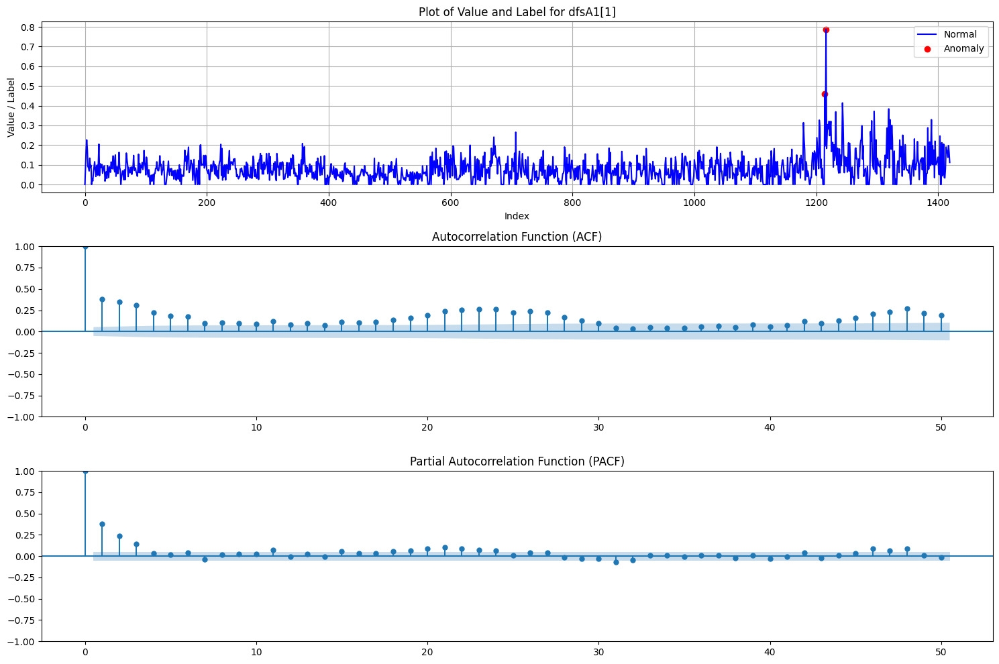

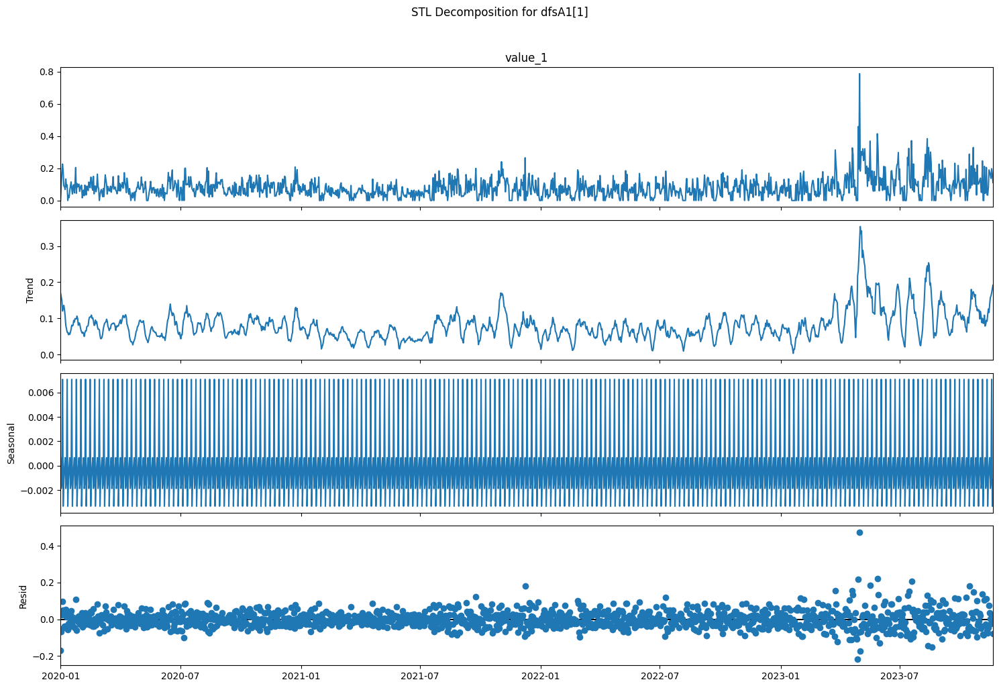

ADF Statistic: -4.529741
p-value: 0.000174
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.7621889045673196
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1439.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


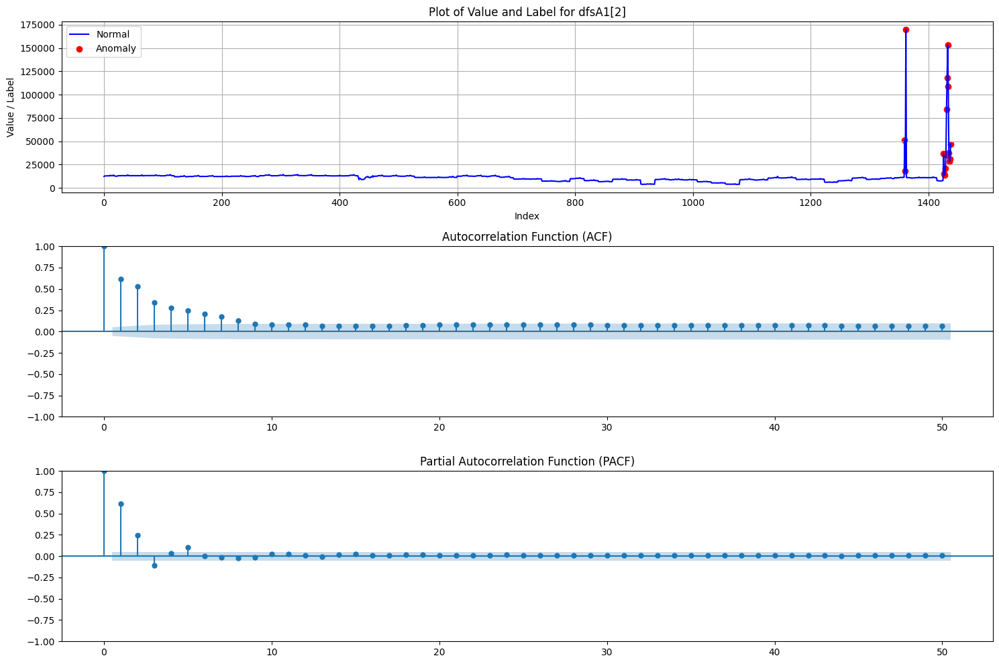

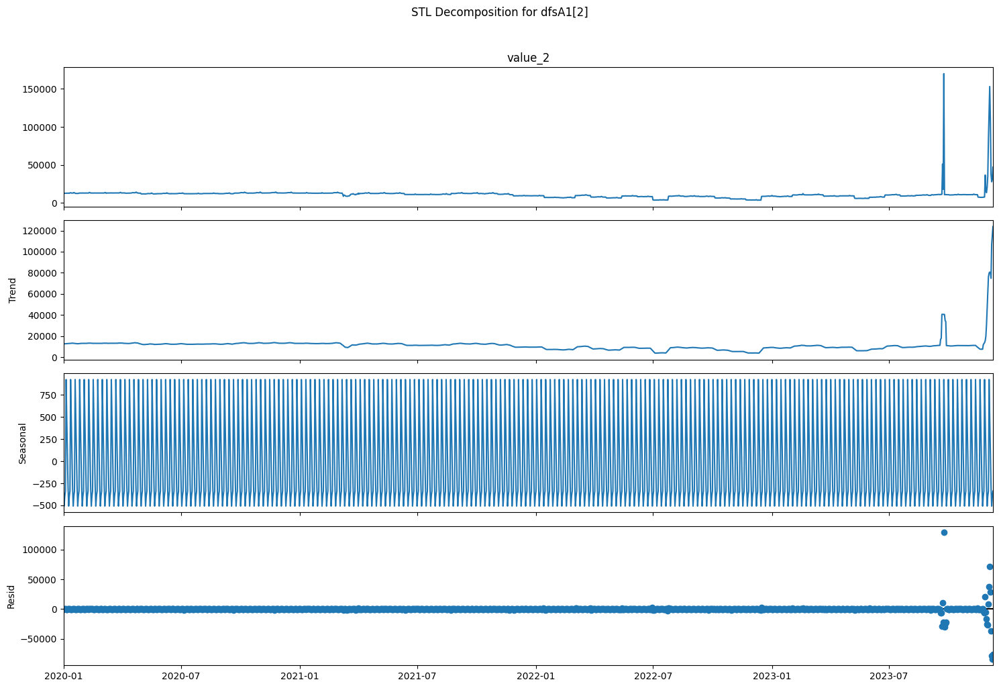

ADF Statistic: -0.828017
p-value: 0.810754
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 0.283371162157115
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  23.95081967213115


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


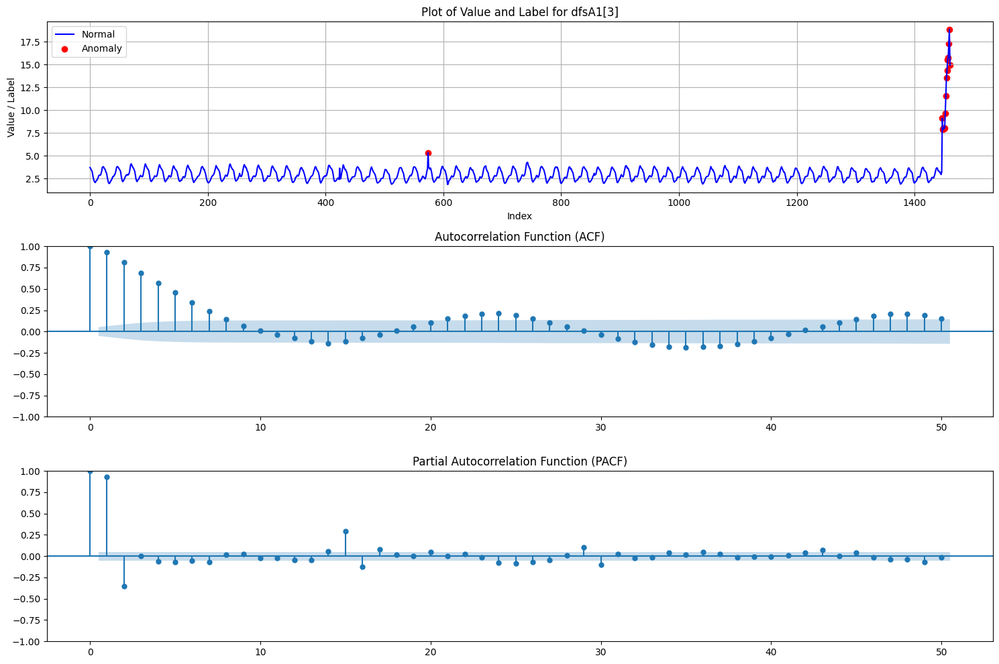

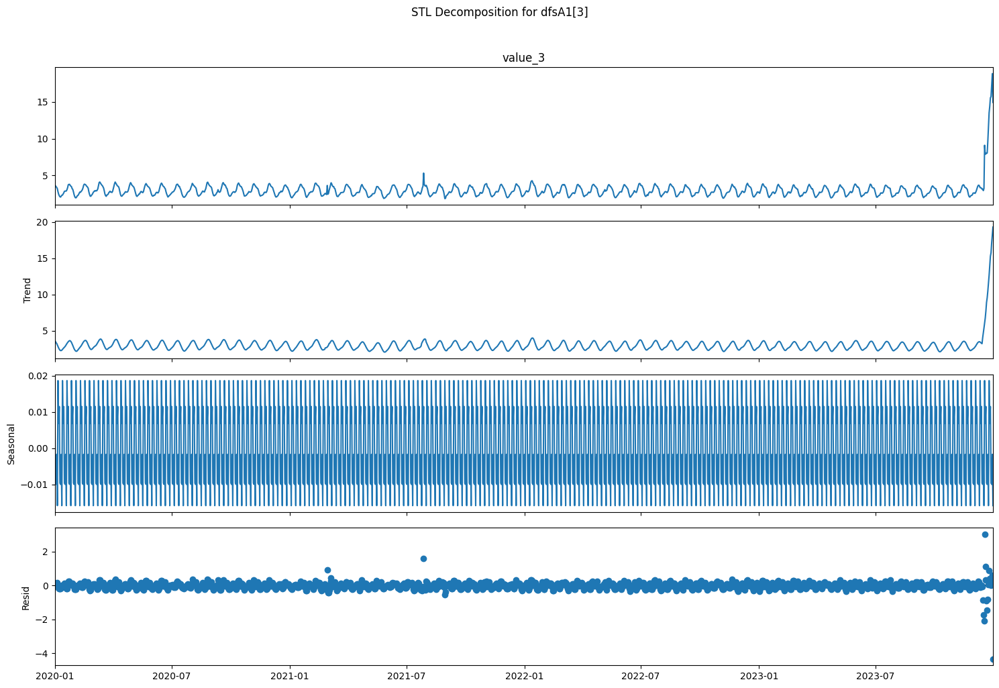

ADF Statistic: 3.176938
p-value: 1.000000
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 0.834600960971778
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1423.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


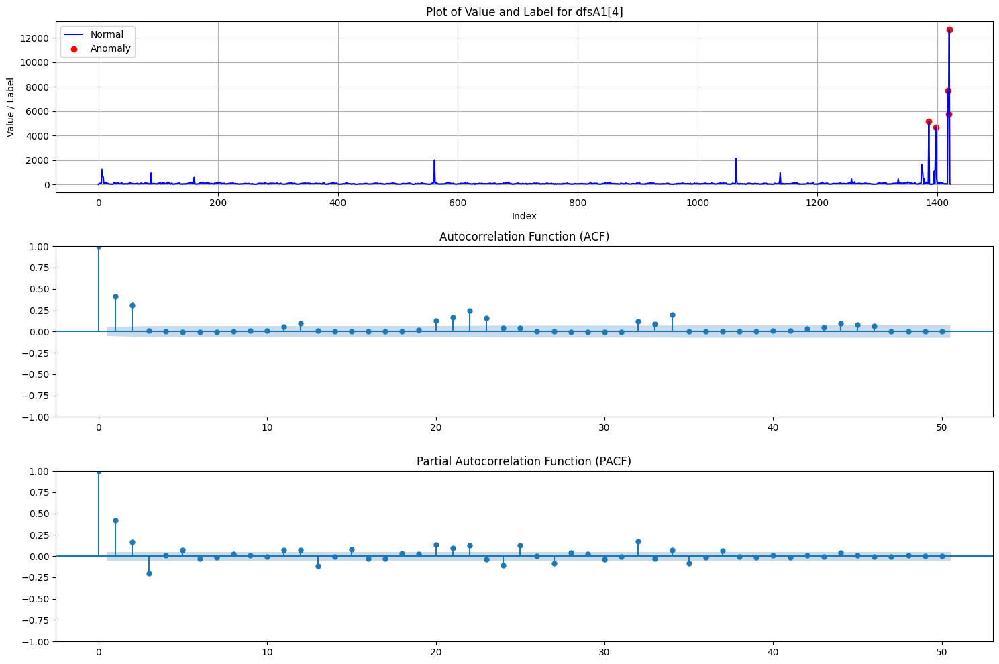

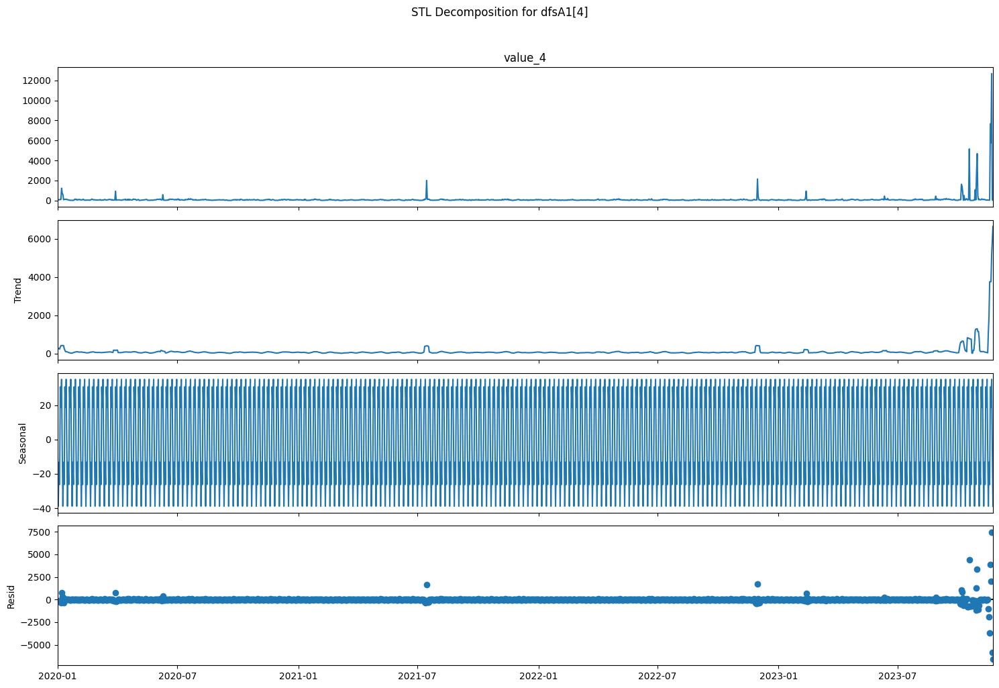

ADF Statistic: -14.911403
p-value: 0.000000
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.3971130975913892
p-value: 0.07839952690026328
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  23.983333333333334


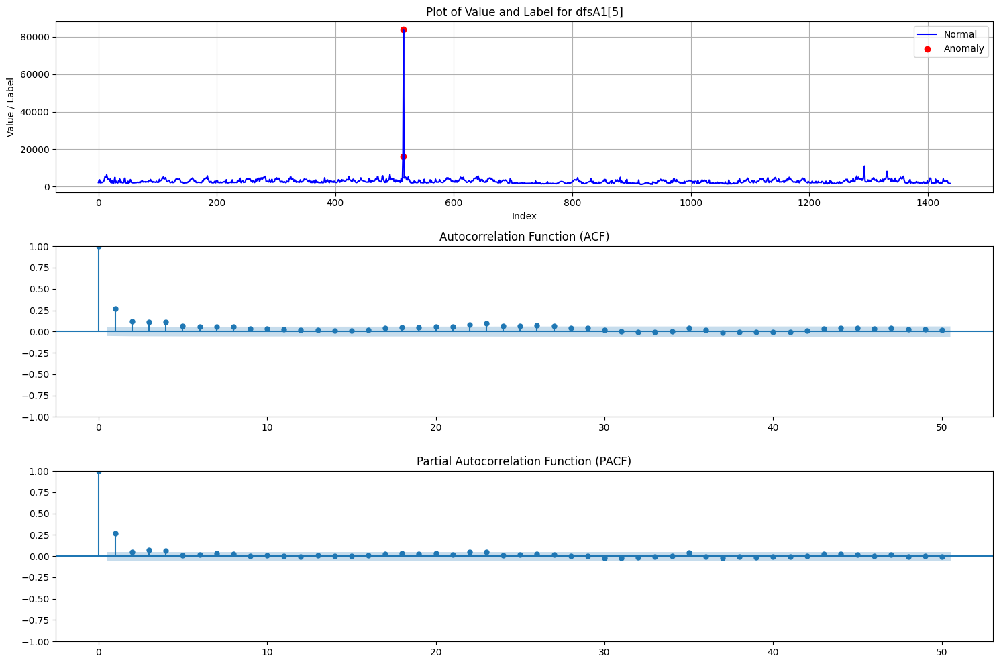

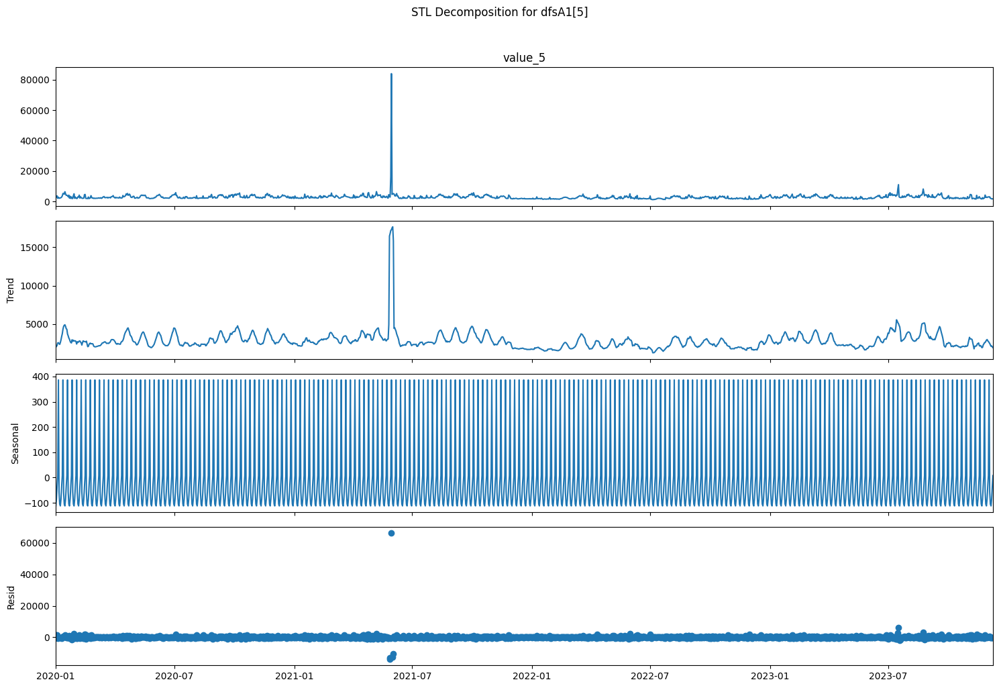

ADF Statistic: -1.642321
p-value: 0.461048
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 2.969685735122068
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1439.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


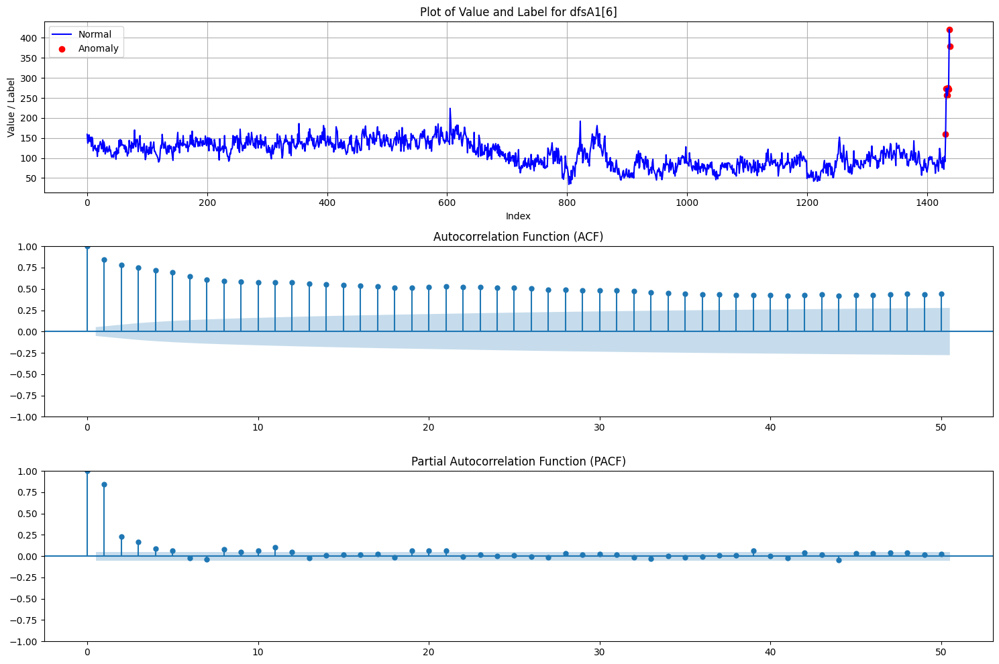

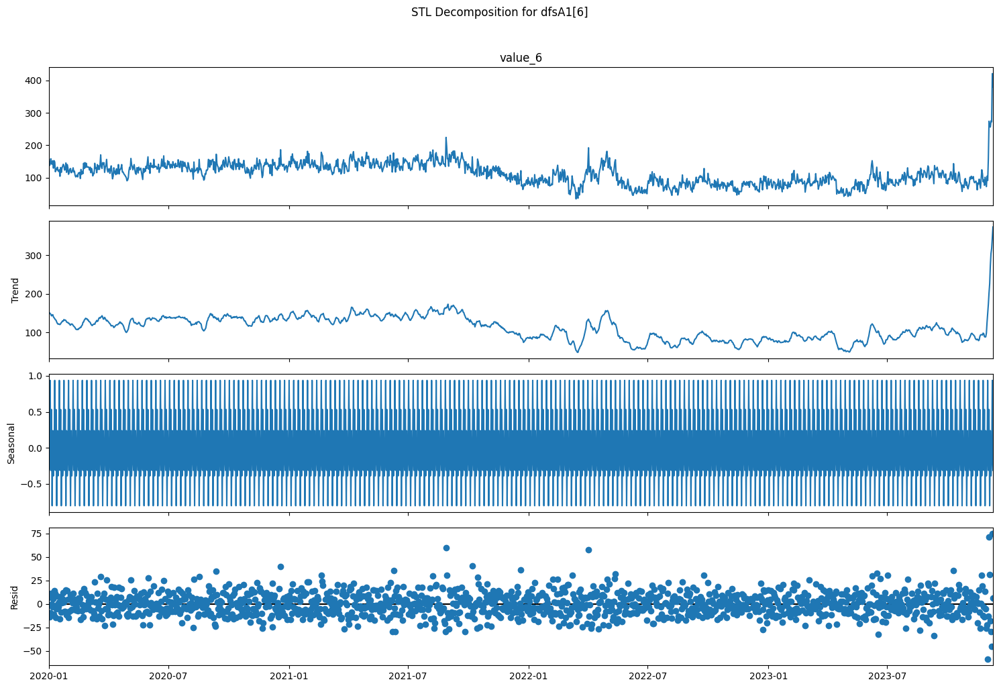

ADF Statistic: -2.139155
p-value: 0.229064
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 2.0868476437237495
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1423.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


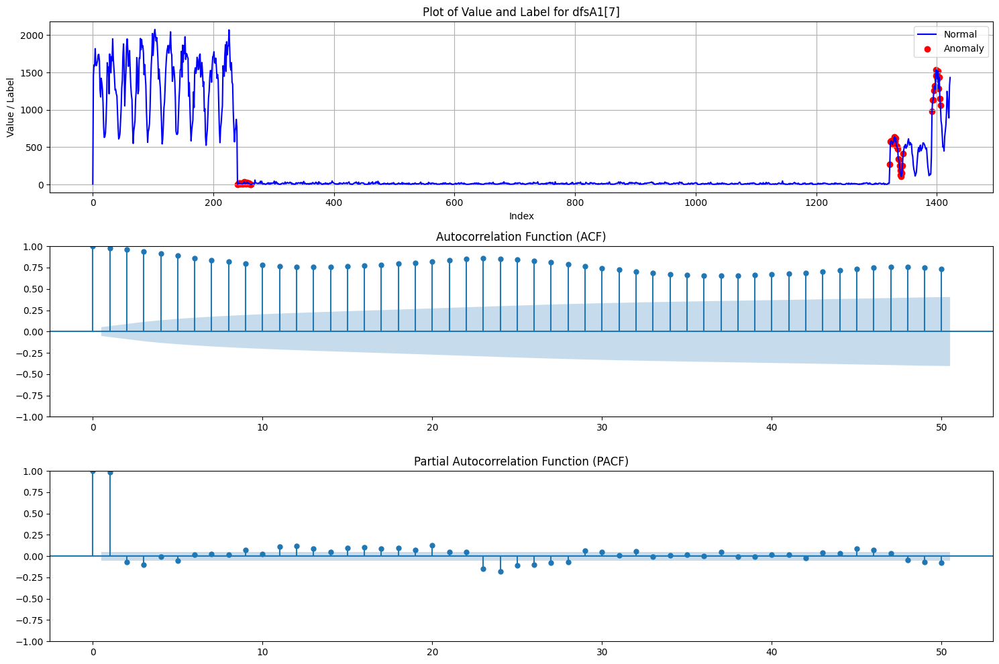

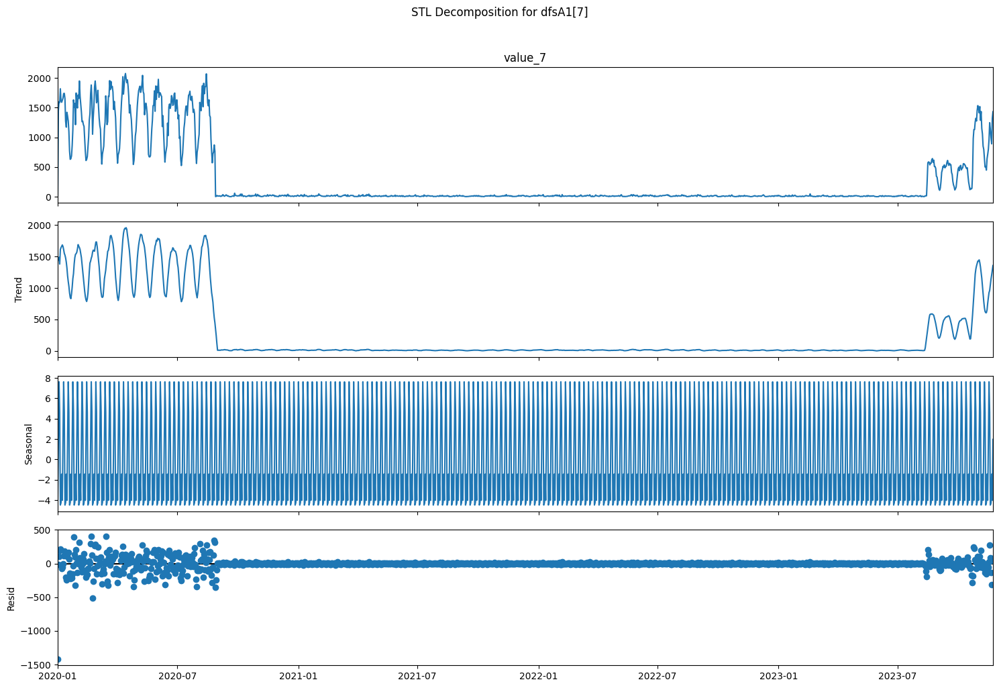

ADF Statistic: -9.633932
p-value: 0.000000
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.5586060367257649
p-value: 0.028467108845548435
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  47.333333333333336


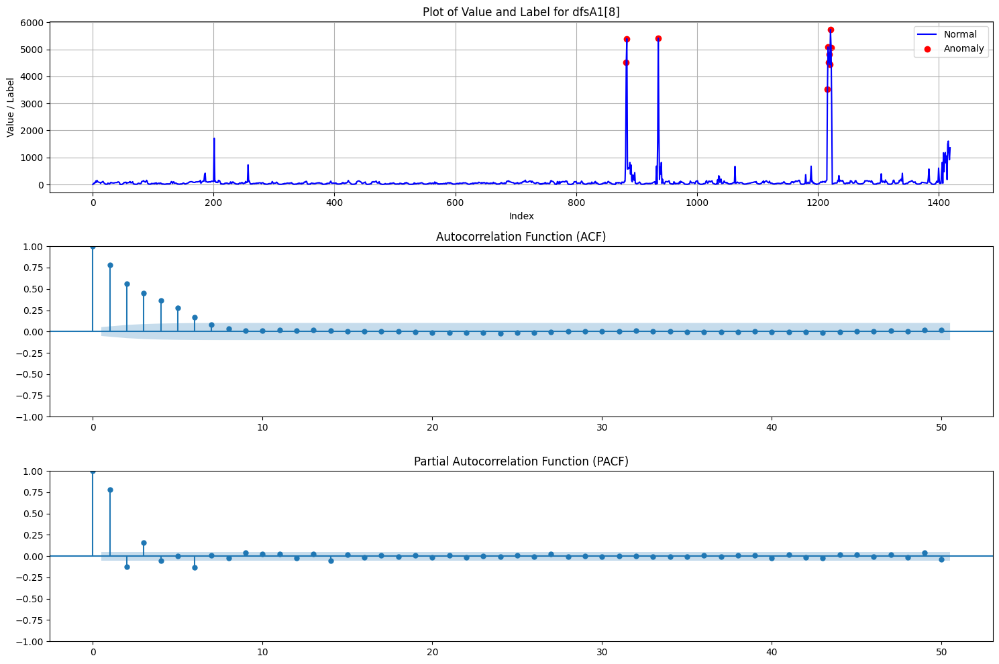

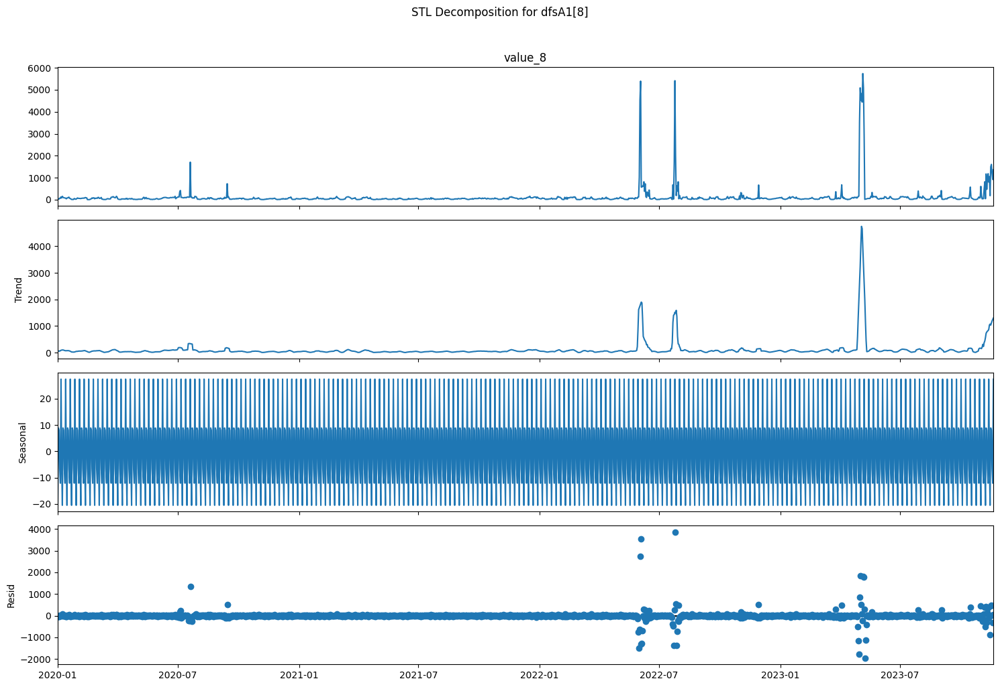

ADF Statistic: -5.939385
p-value: 0.000000
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.13235527760846344
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  23.95081967213115


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


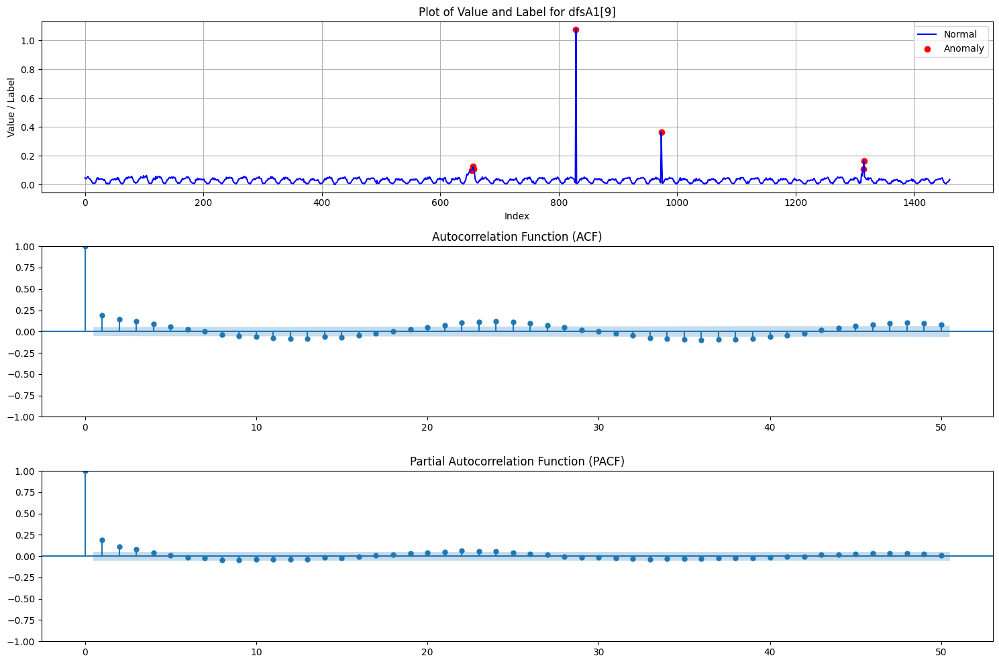

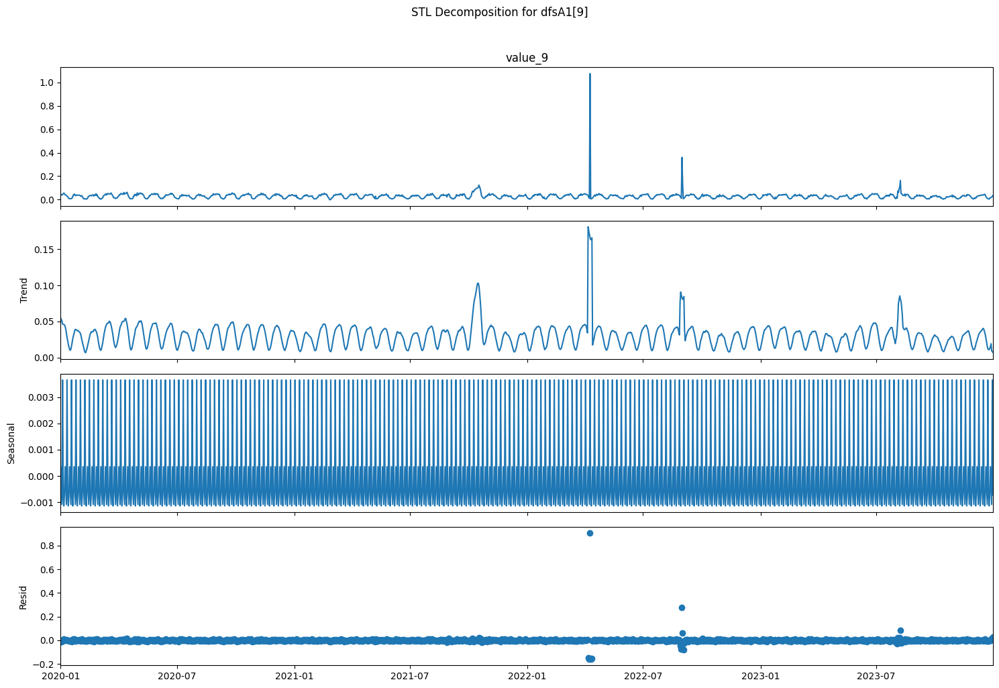

ADF Statistic: -4.040026
p-value: 0.001215
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.4717476228682412
p-value: 0.04802981466931506
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  23.59016393442623


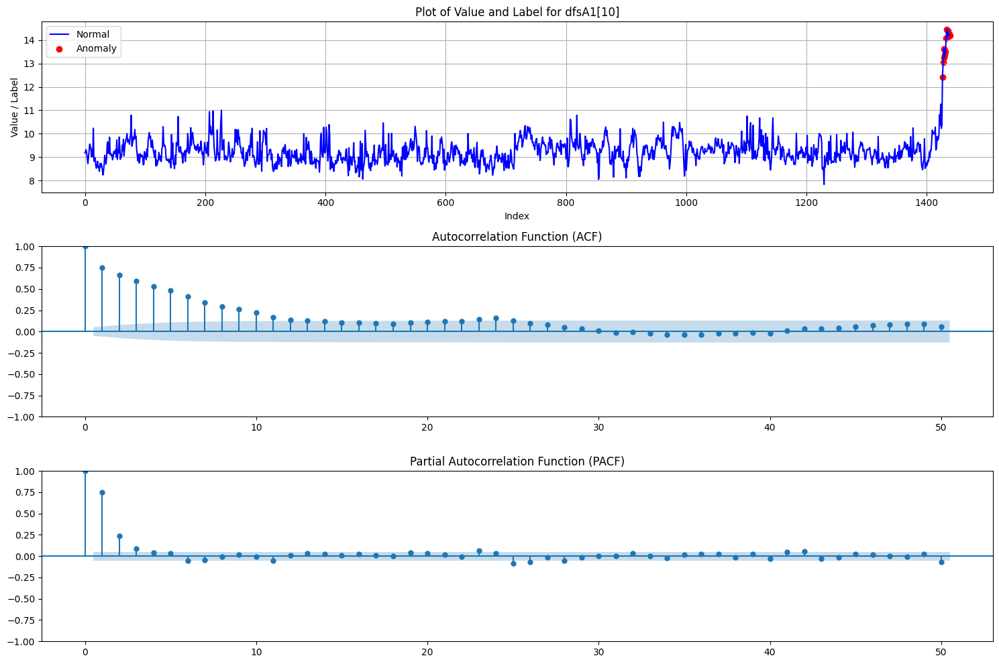

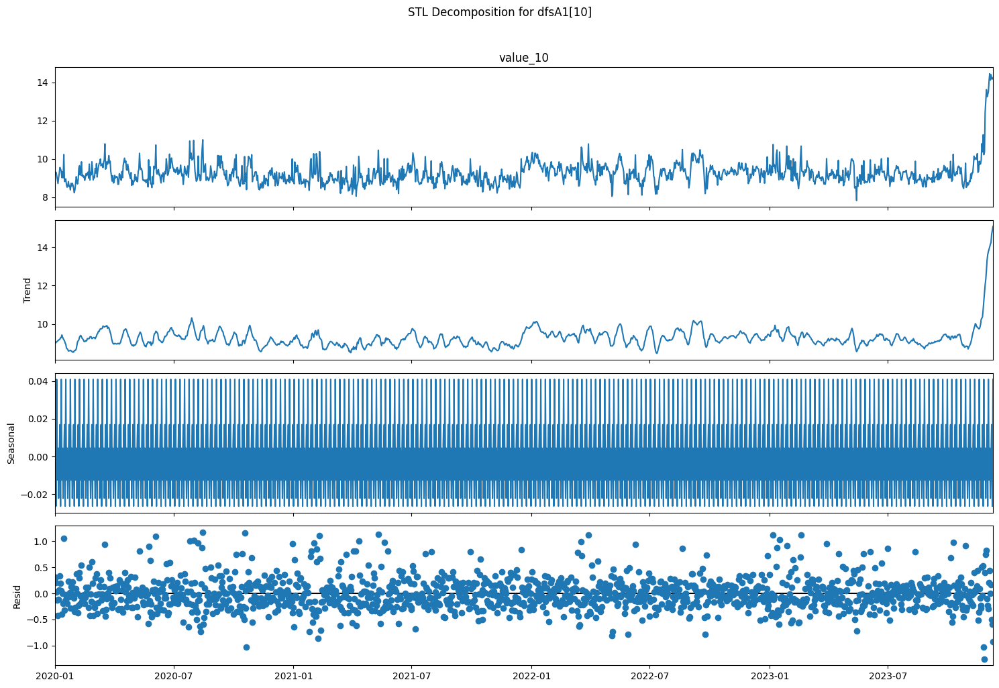

ADF Statistic: -0.942761
p-value: 0.773565
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 0.4451340215425576
p-value: 0.05770085278338035
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  1439.0


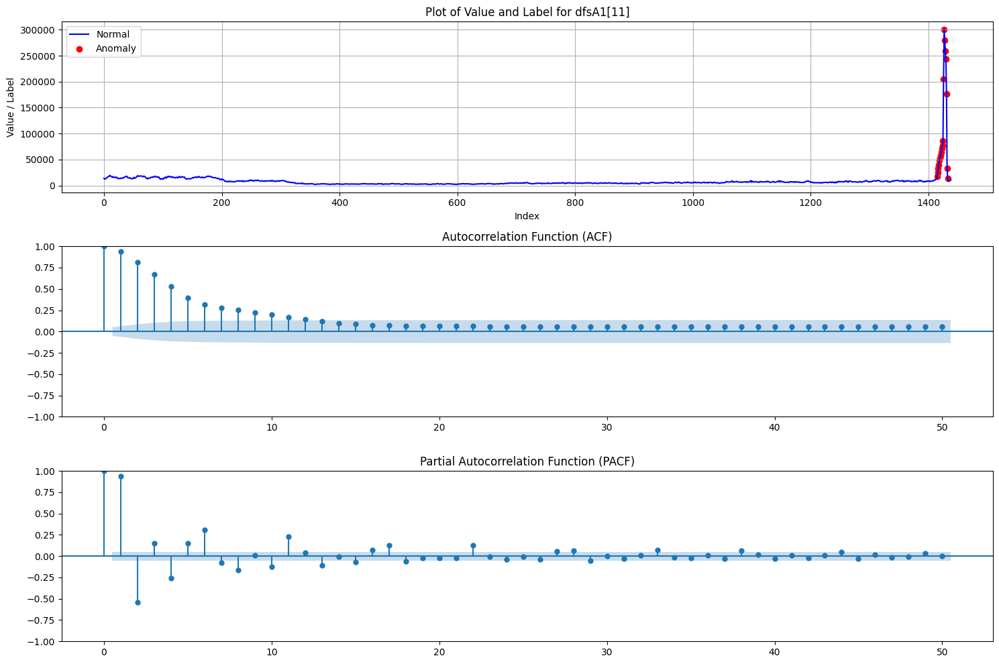

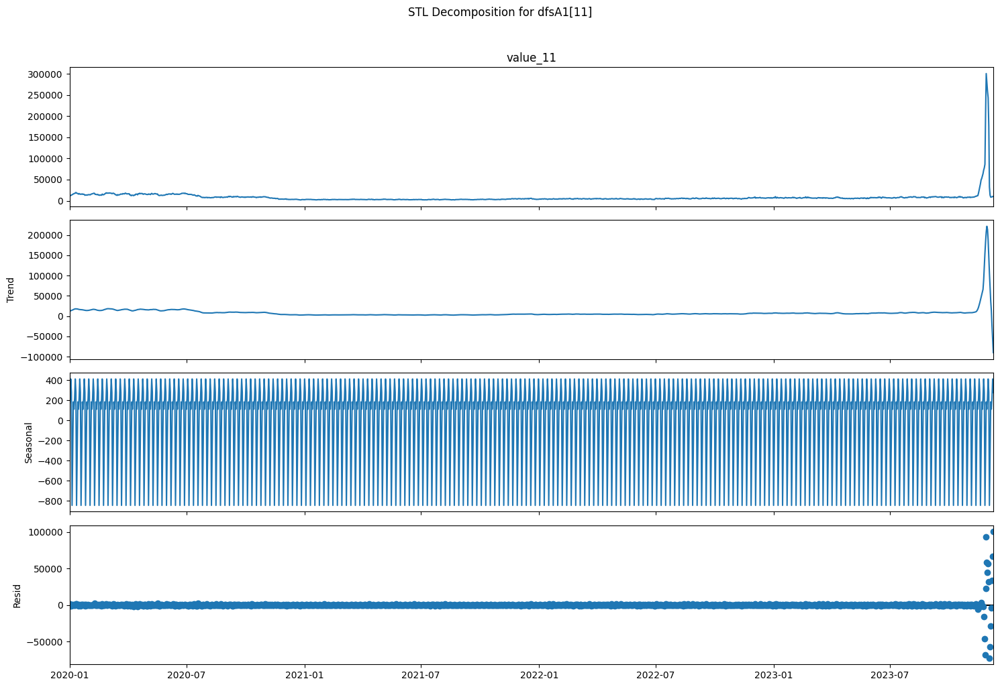

ADF Statistic: -3.027419
p-value: 0.032412
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 1.095696834759069
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


The most frequent period is  23.983333333333334


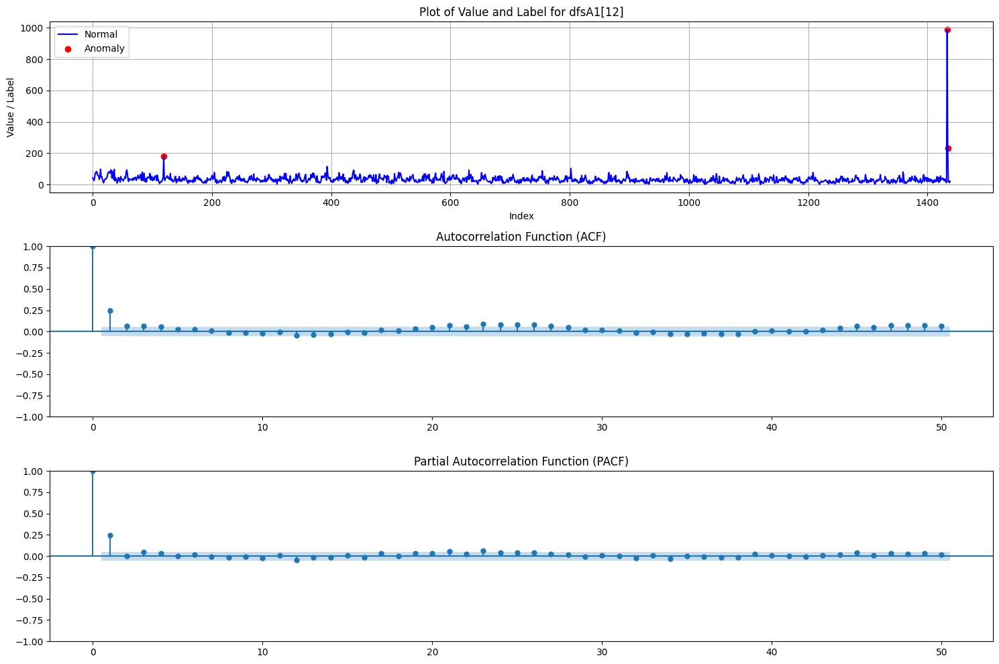

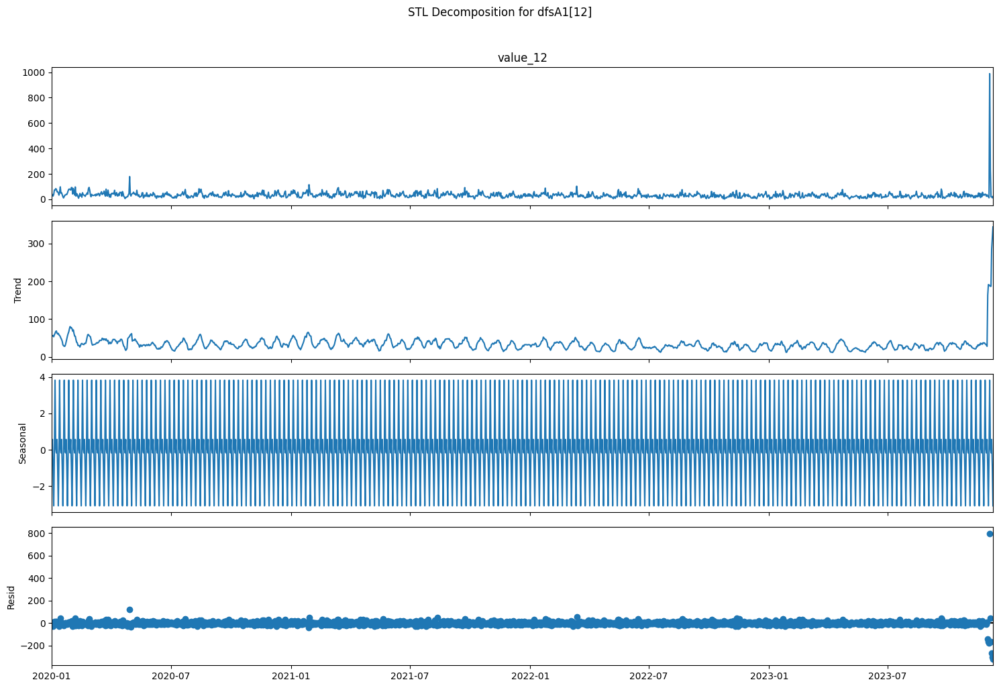

ADF Statistic: -1.890250
p-value: 0.336661
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 3.4461673284519856
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  23.983333333333334


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


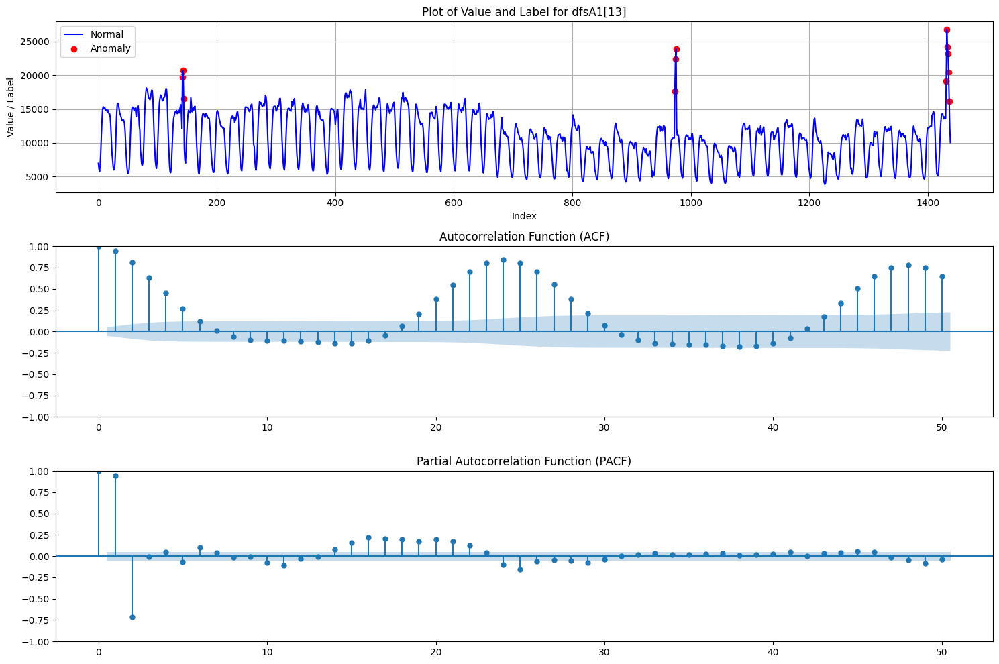

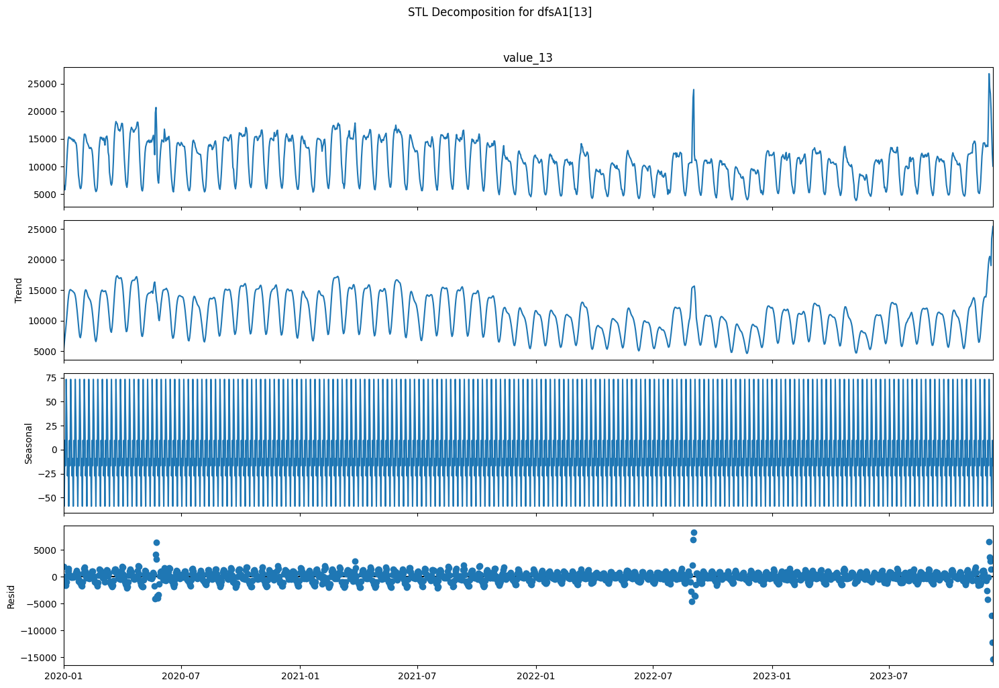

ADF Statistic: -3.194494
p-value: 0.020306
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 1.3018615850611612
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  23.983333333333334


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


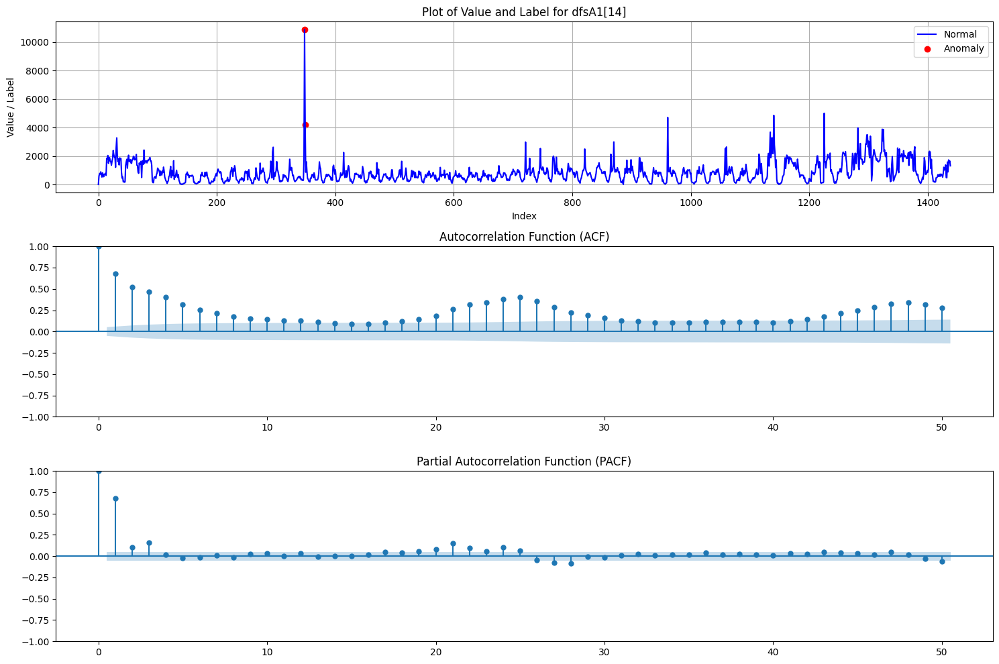

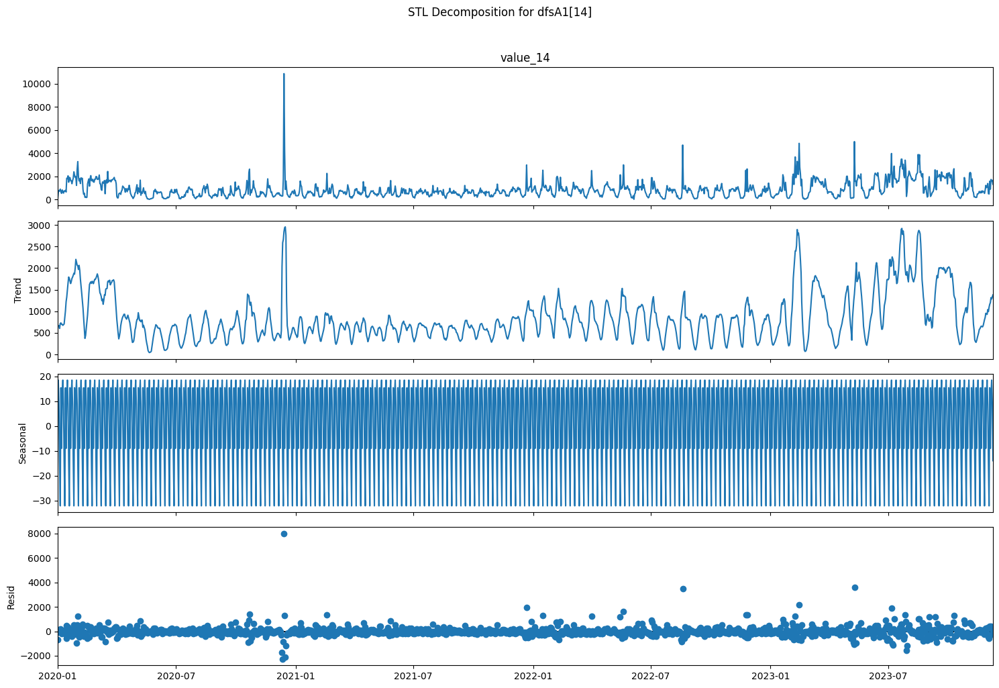

ADF Statistic: -1.884889
p-value: 0.339203
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 3.551980085996501
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


The most frequent period is  23.983333333333334


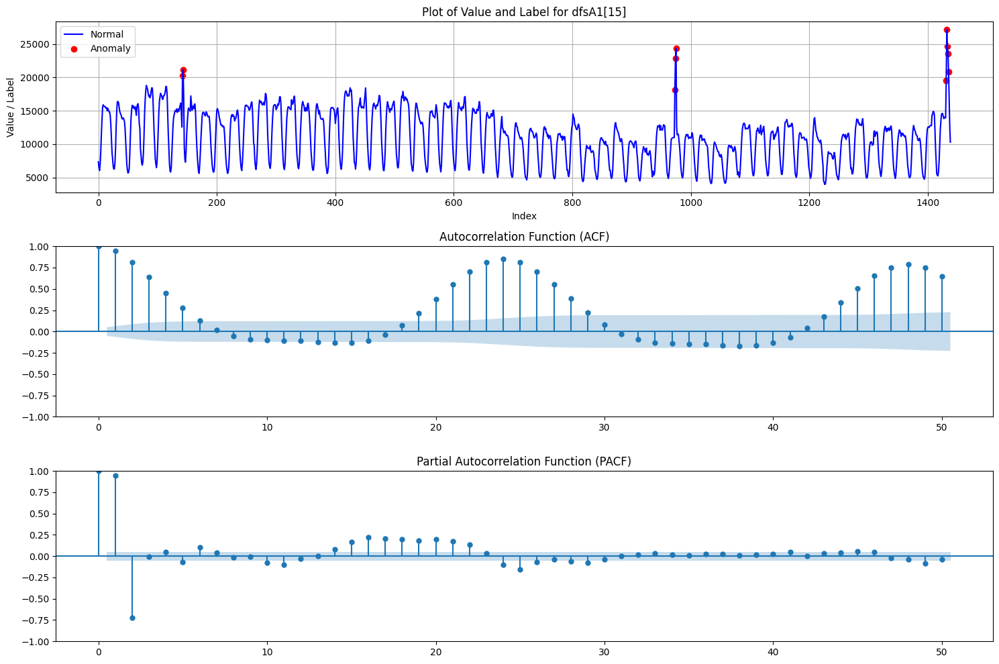

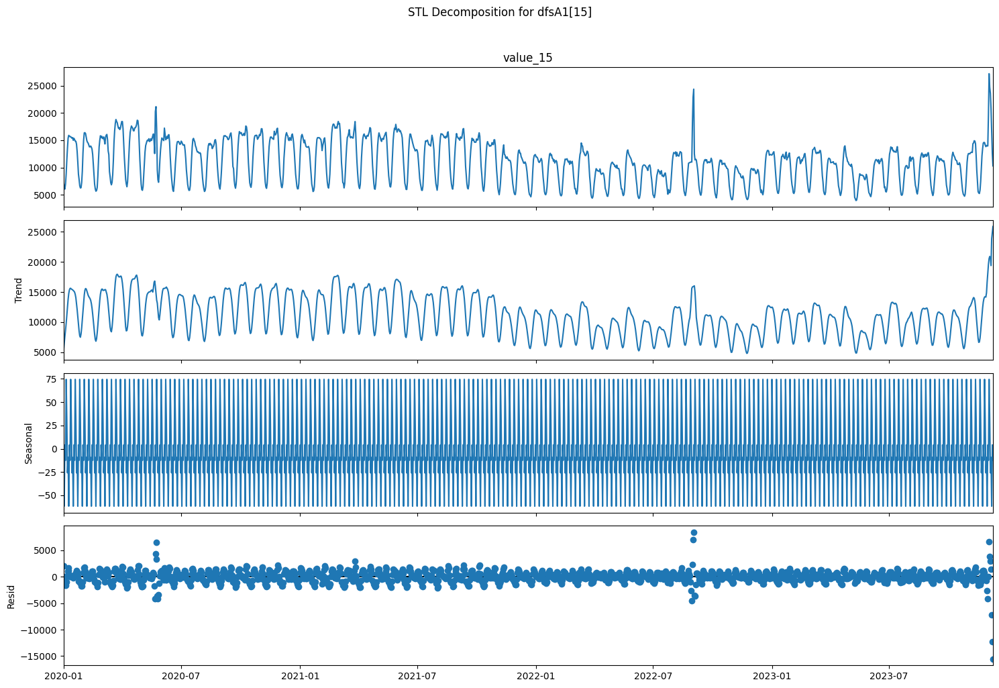

ADF Statistic: -17.328913
p-value: 0.000000
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.1498169717216639
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  23.95081967213115


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


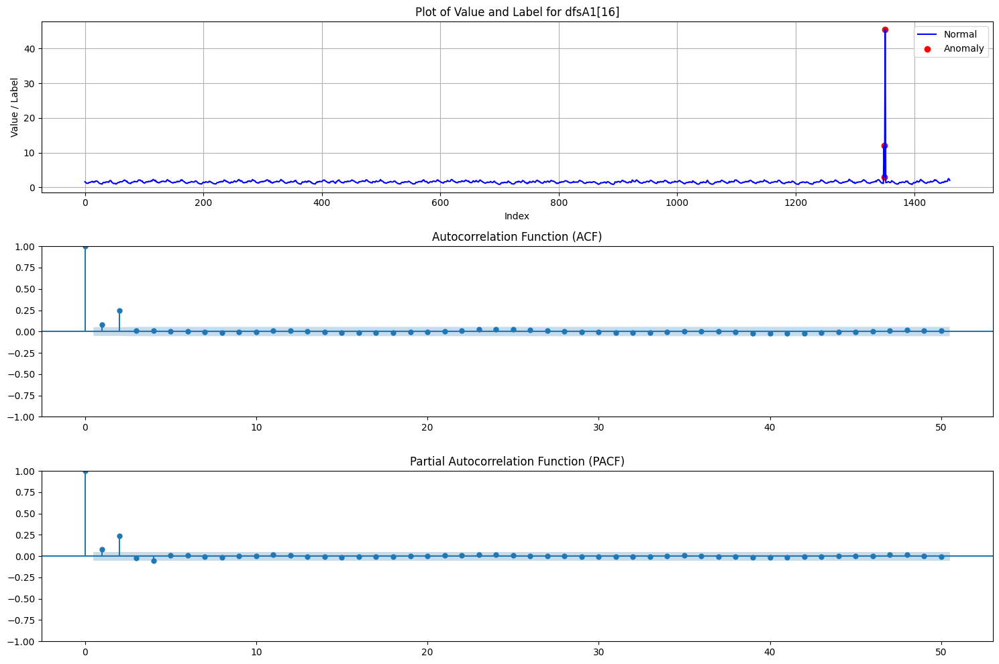

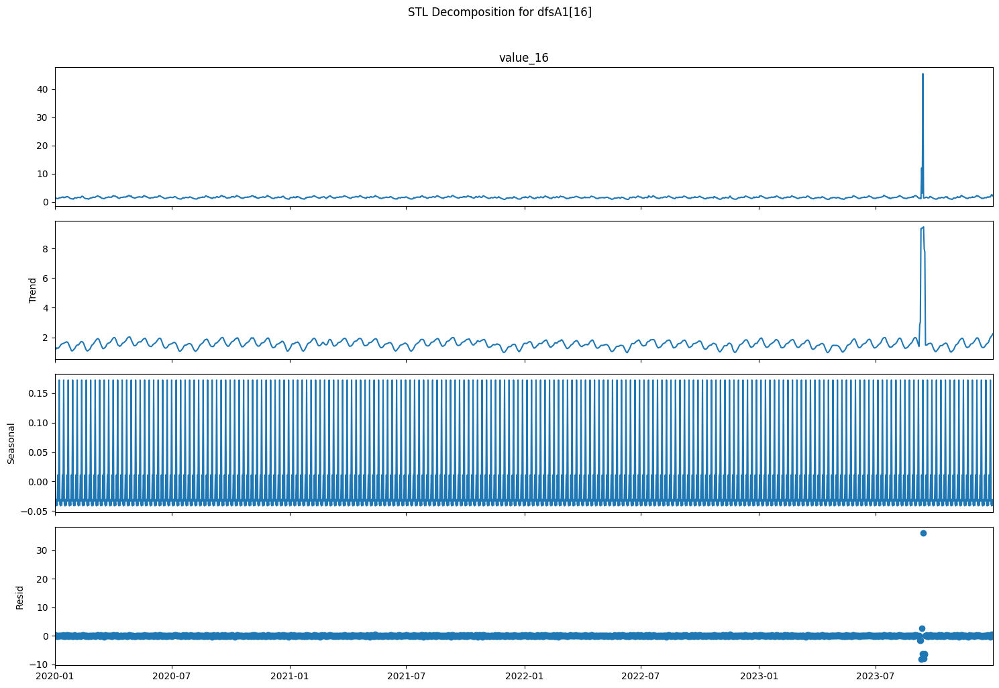

ADF Statistic: -3.348634
p-value: 0.012840
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.6549537159726796
p-value: 0.017640571275210945
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  284.8


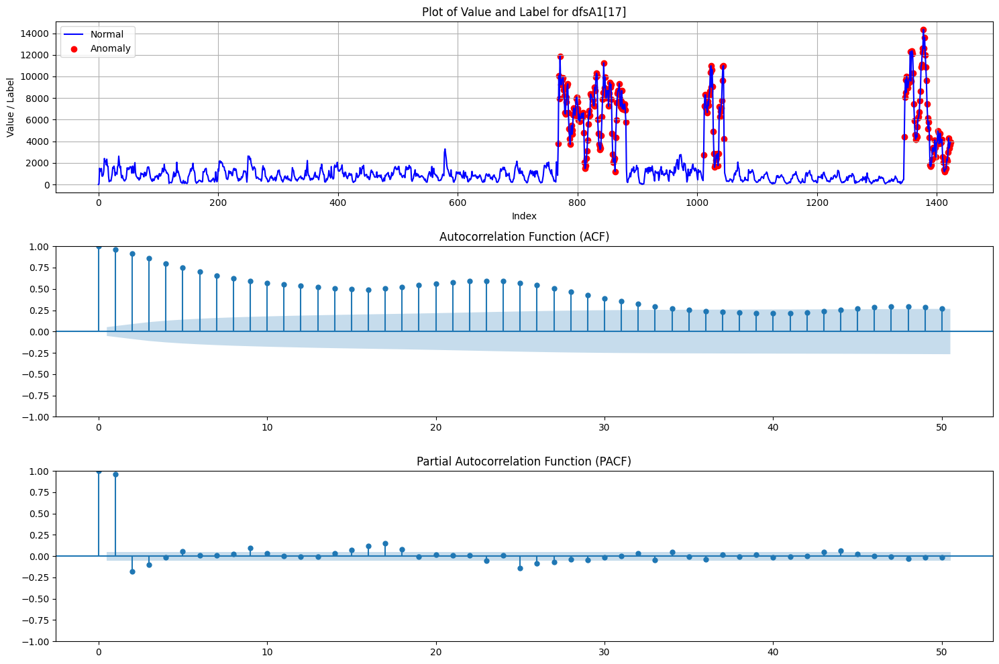

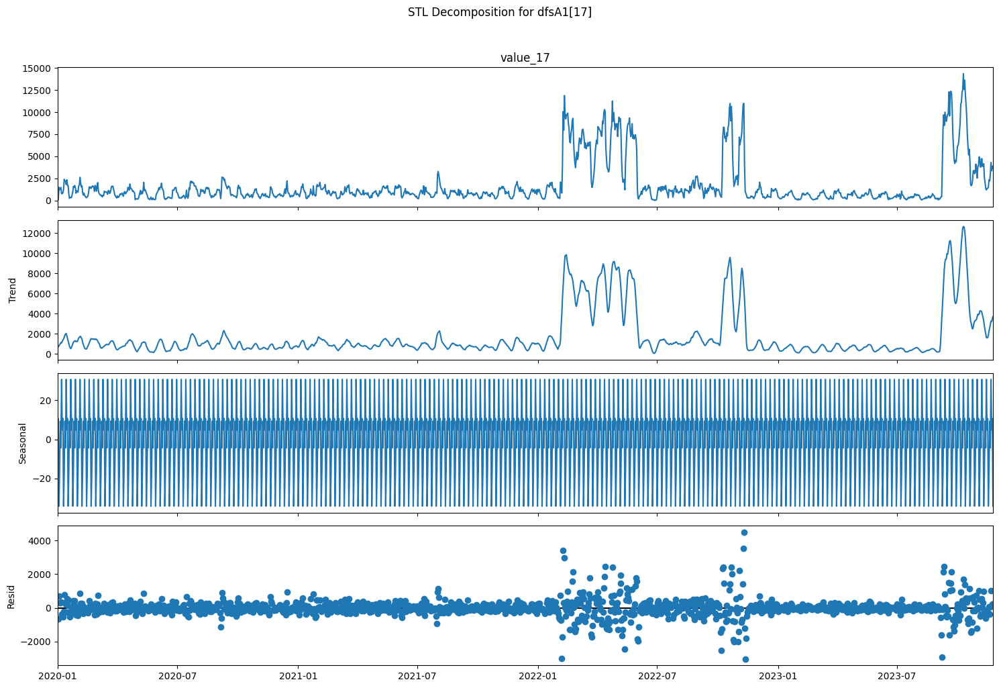

ADF Statistic: -3.411273
p-value: 0.010581
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.29553884413036724
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  23.95081967213115


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


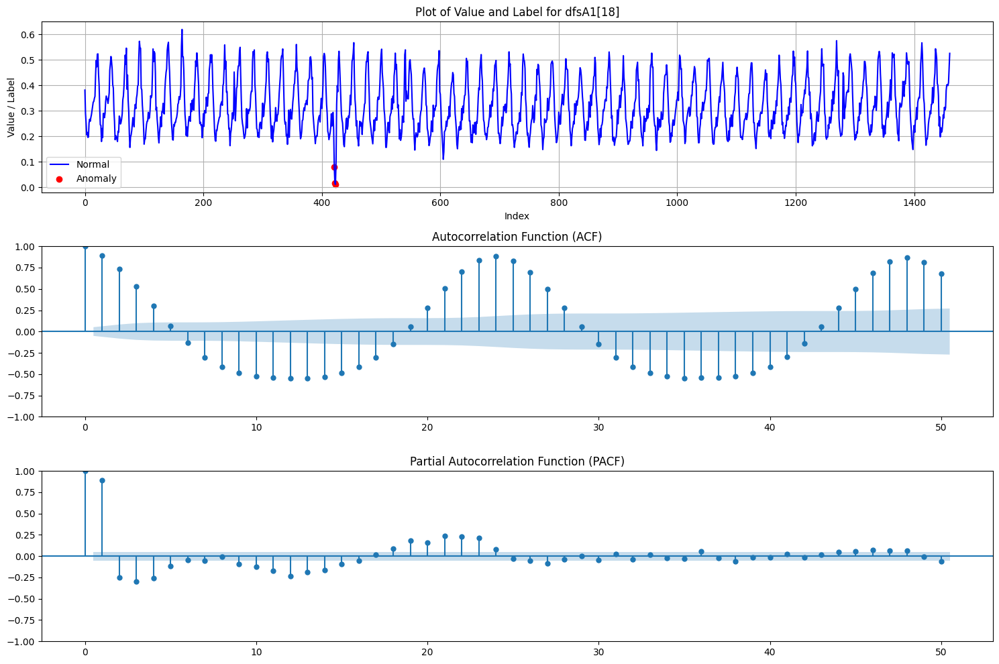

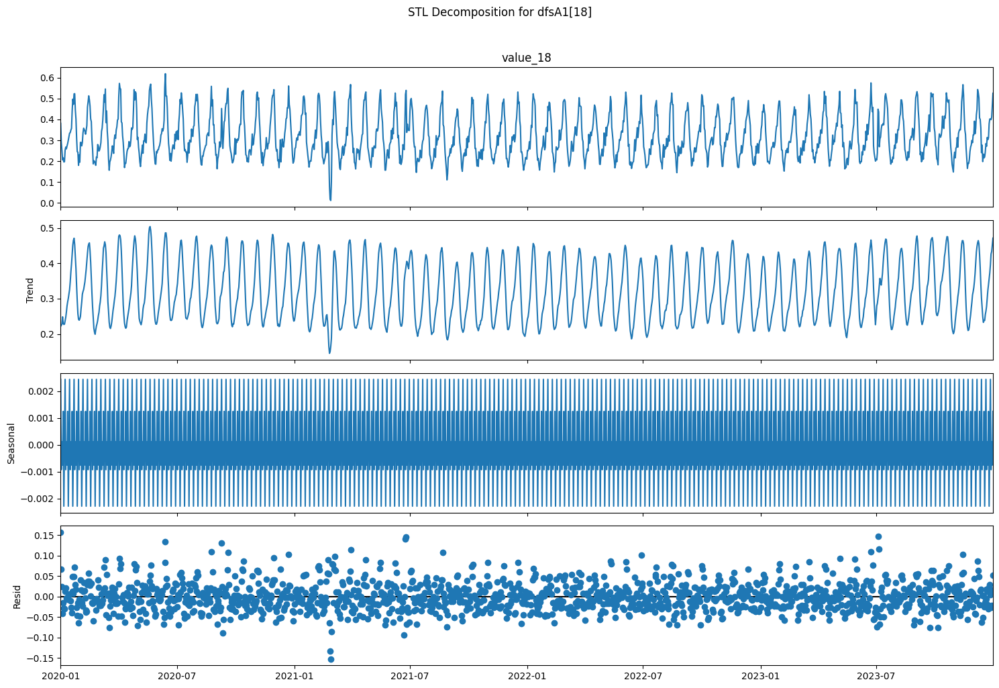

ADF Statistic: -3.471639
p-value: 0.008746
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.8438816033755168
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  284.8


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


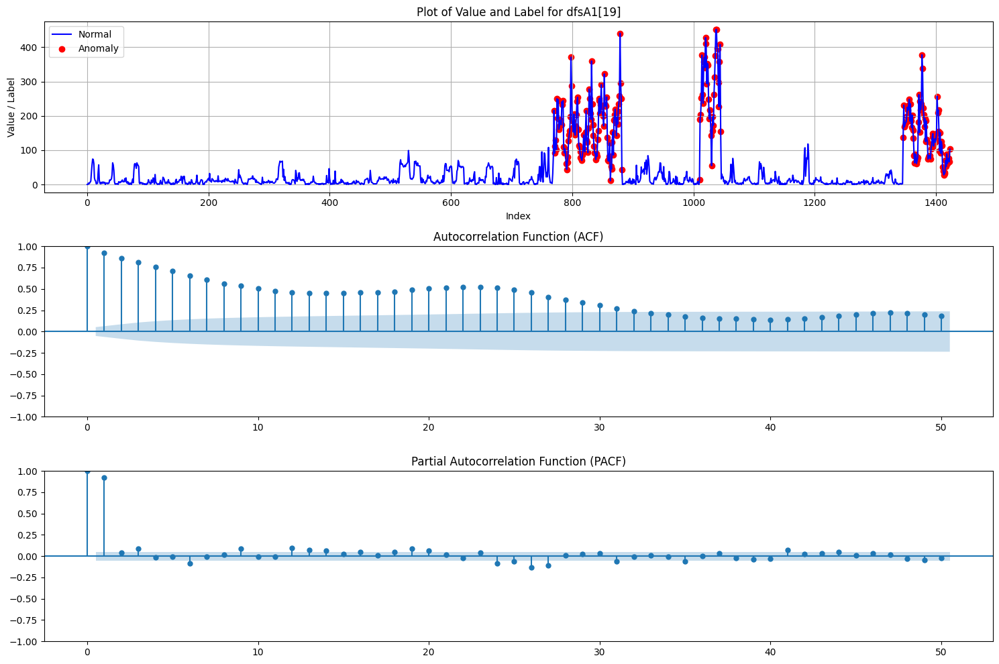

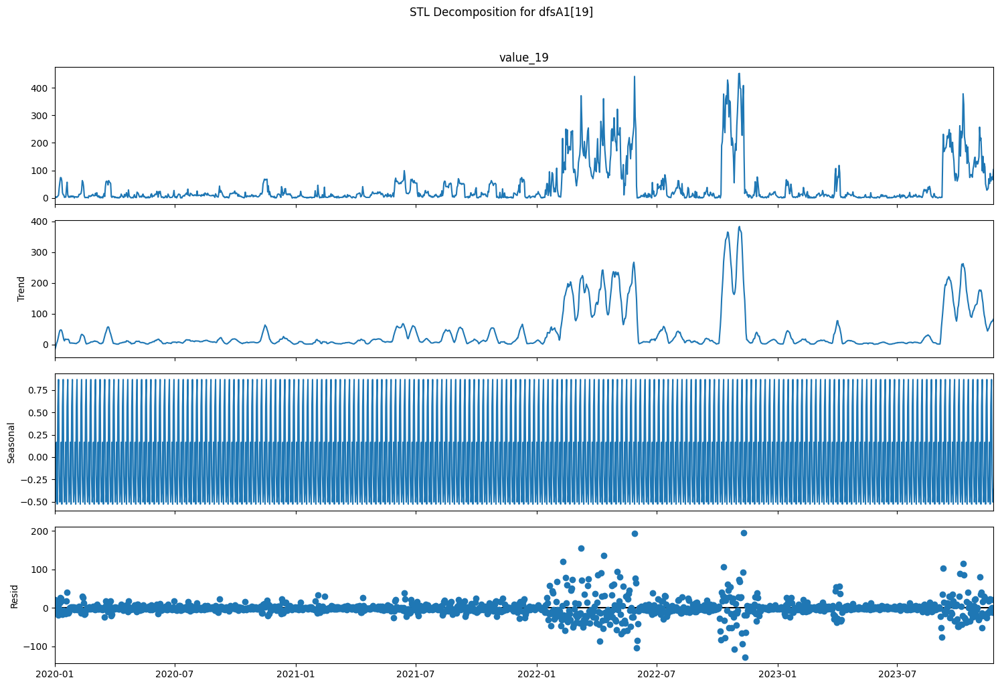

ADF Statistic: -1.249126
p-value: 0.652114
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 4.50031253534975
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1422.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


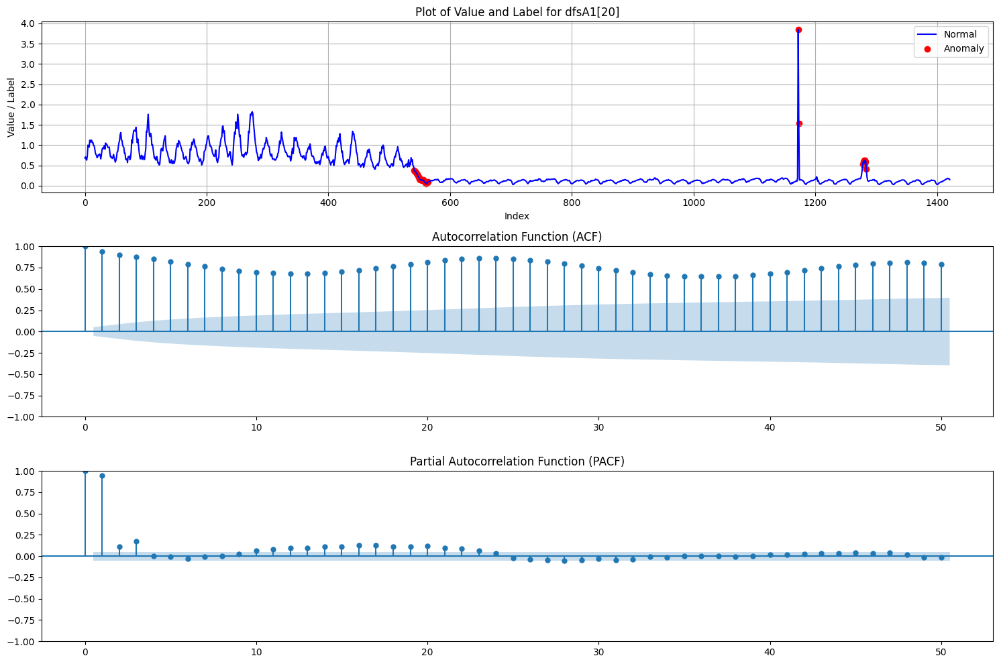

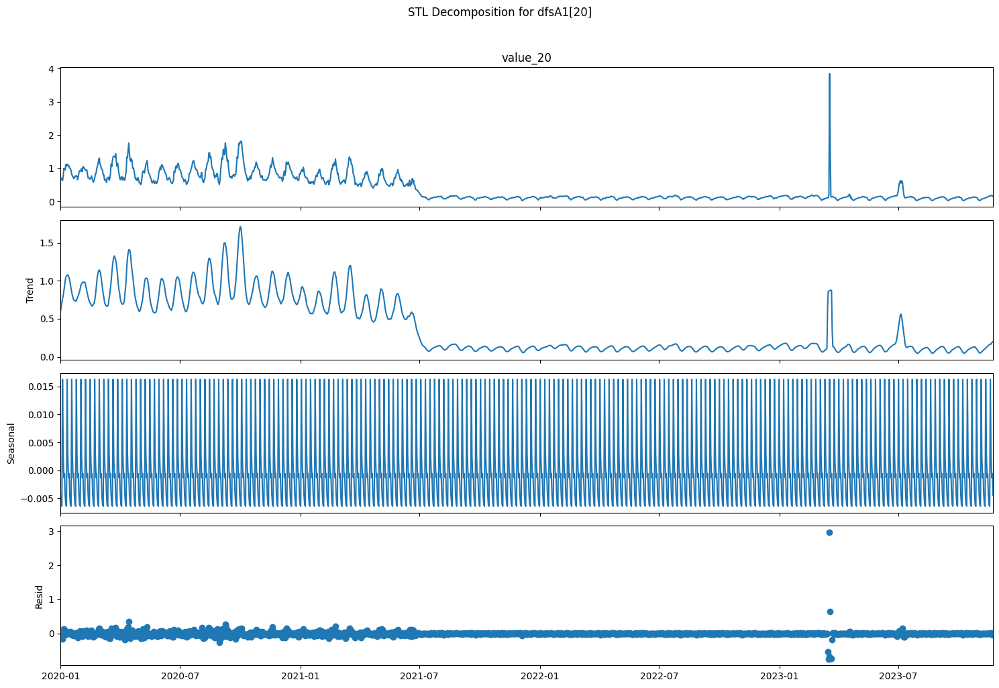

ADF Statistic: -2.857523
p-value: 0.050515
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 0.6012045206523143
p-value: 0.022526861758880513
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  24.06779661016949


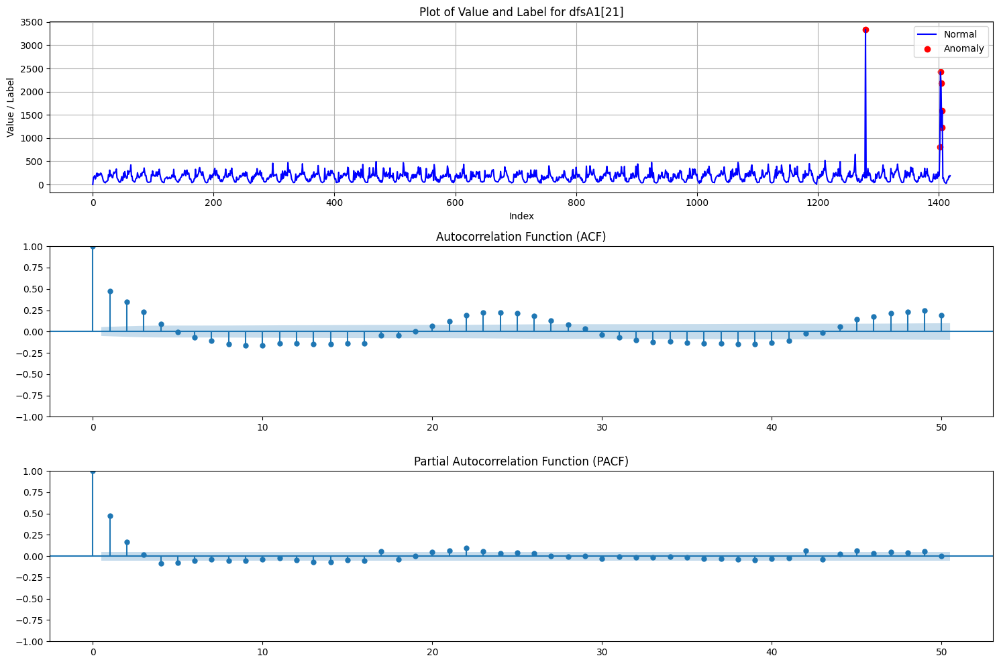

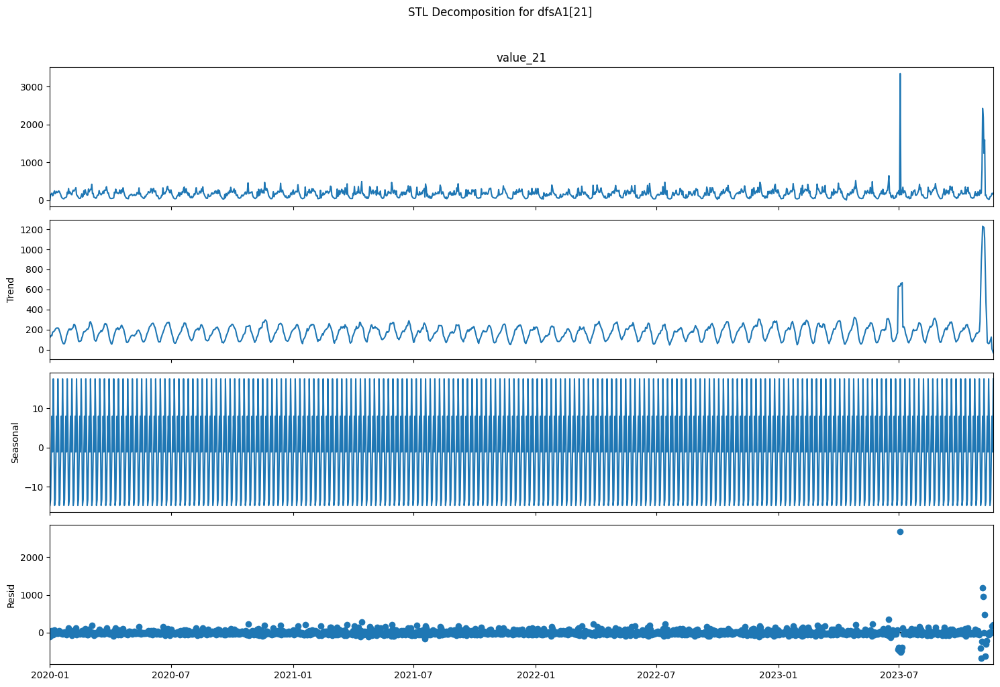

ADF Statistic: 2.056786
p-value: 0.998742
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 0.7666992169103812
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1420.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


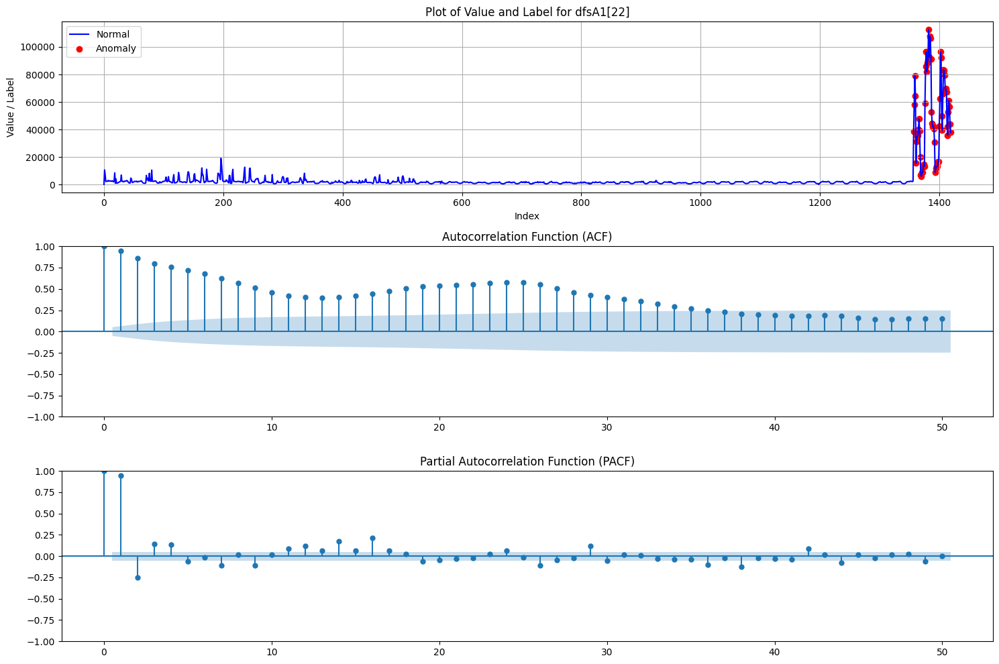

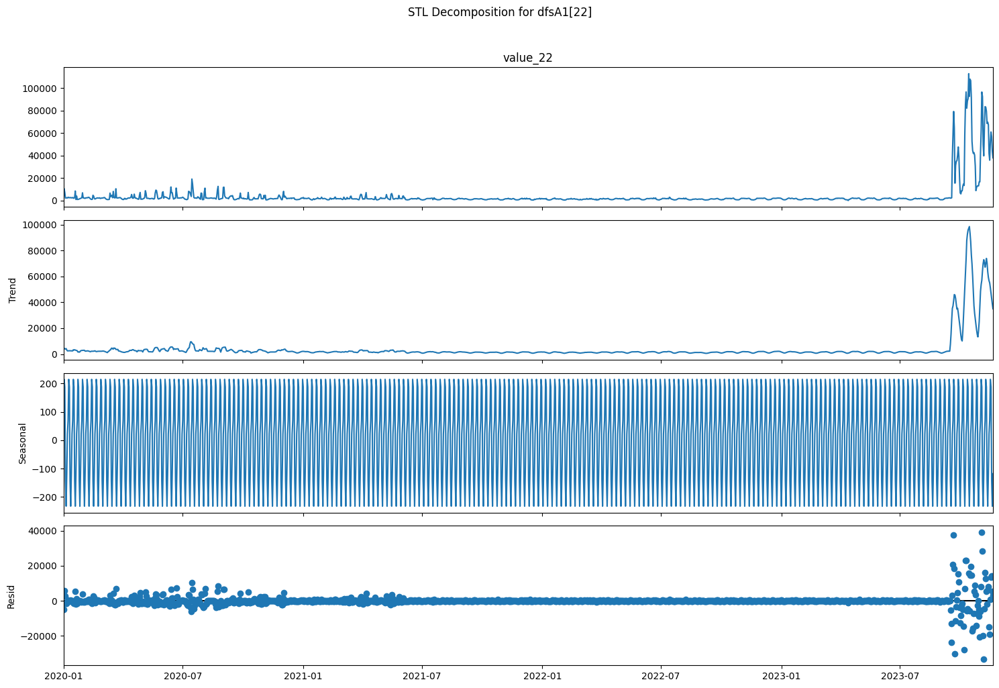

ADF Statistic: -12.562289
p-value: 0.000000
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.42220124286503624
p-value: 0.06758567117886369
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  355.0


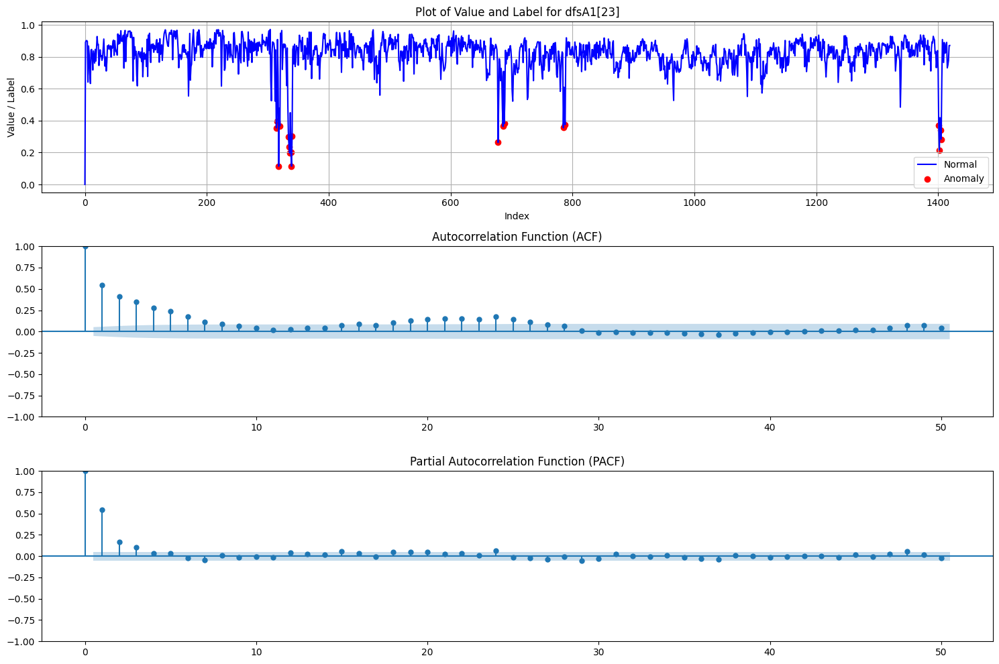

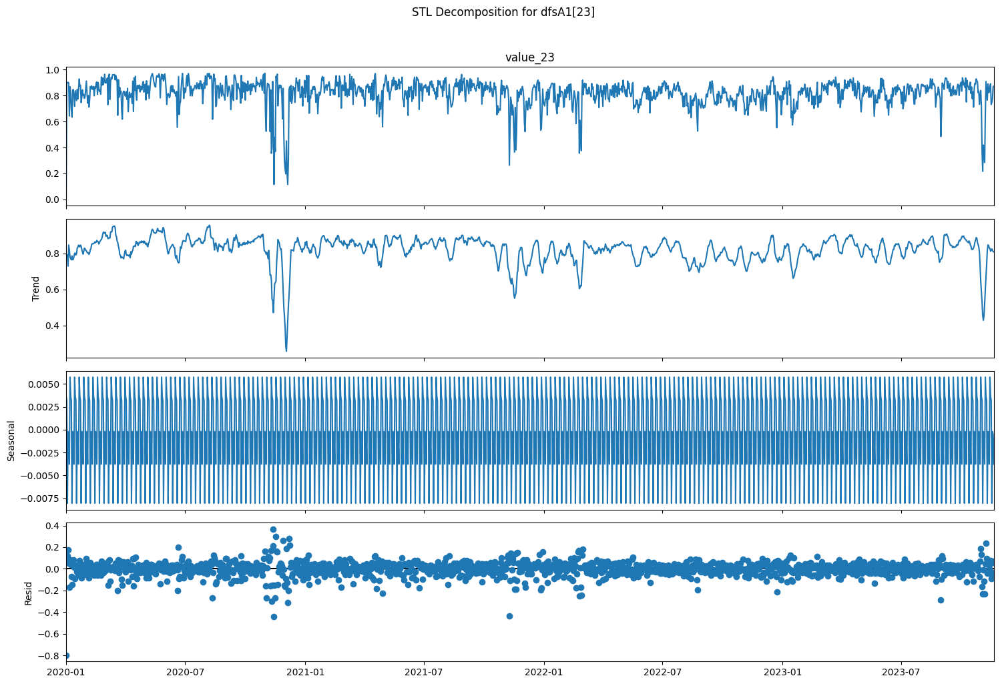

ADF Statistic: 3.955925
p-value: 1.000000
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 1.4794980905011386
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  23.95081967213115


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


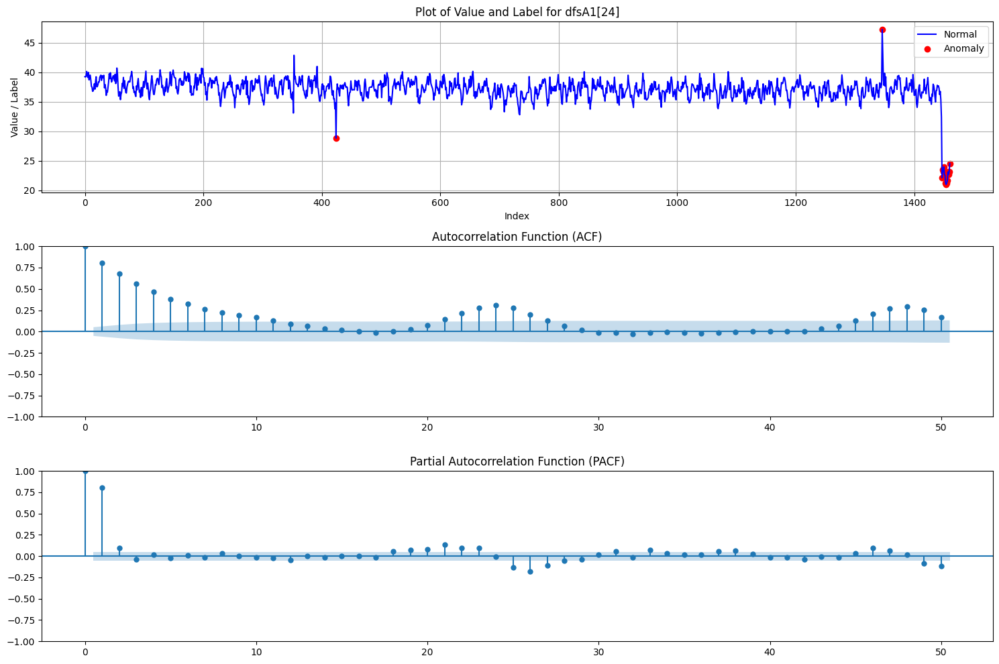

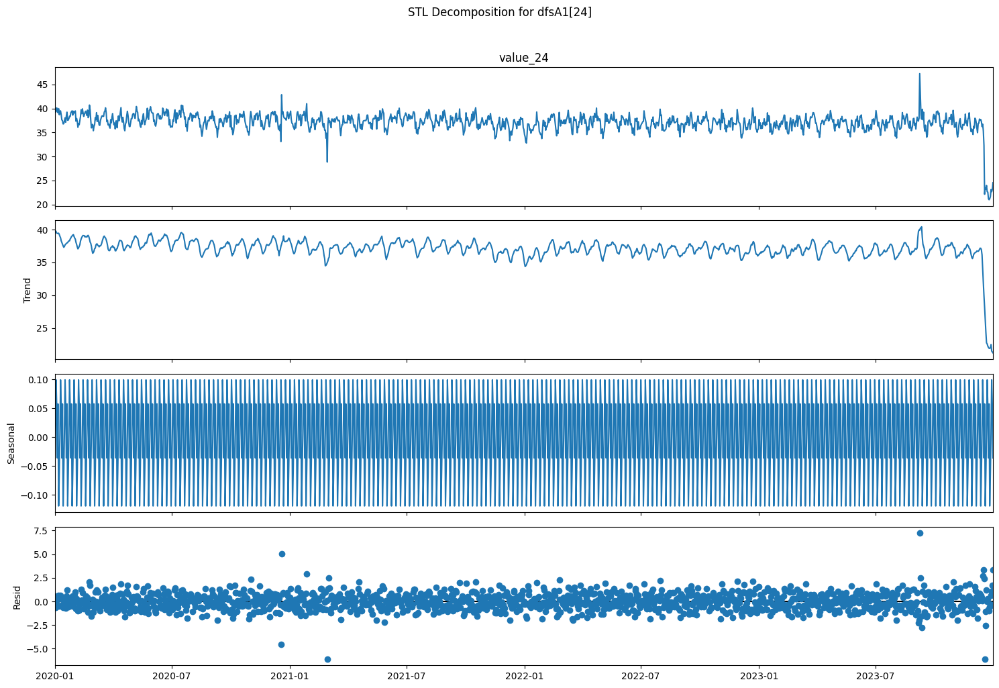

ADF Statistic: -0.873680
p-value: 0.796516
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 0.627259978605825
p-value: 0.02015818376310681
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  478.3333333333333


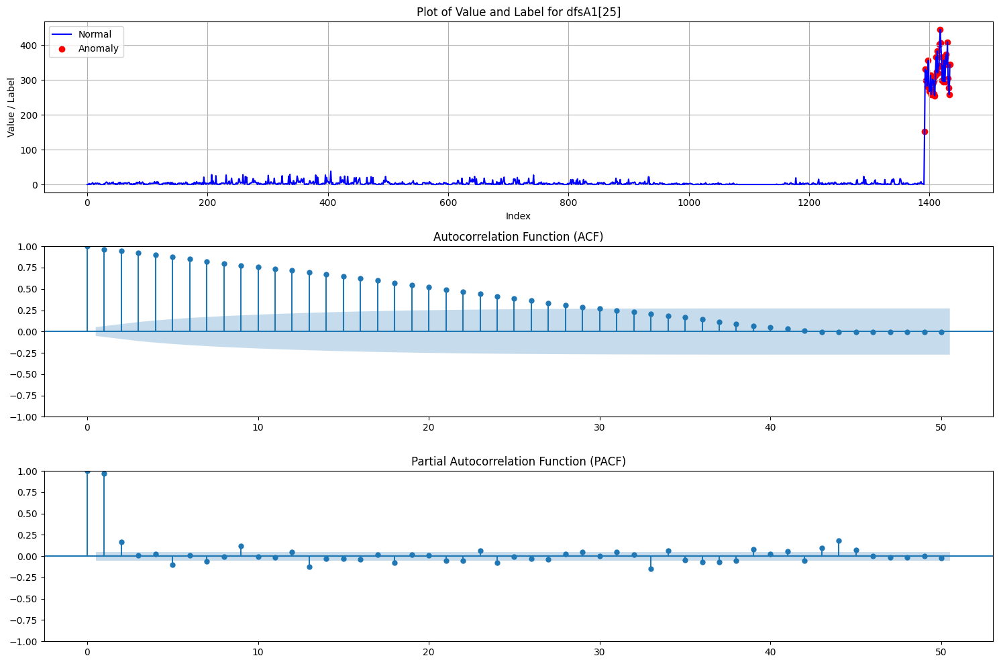

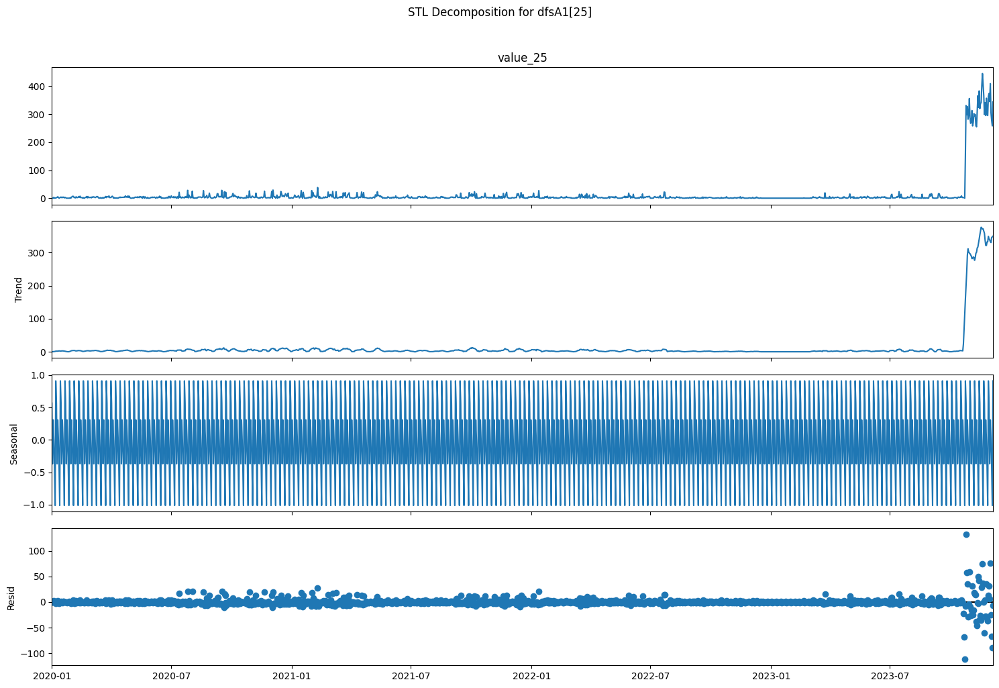

ADF Statistic: -2.576857
p-value: 0.097875
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 0.9732242496648703
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  23.916666666666664


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


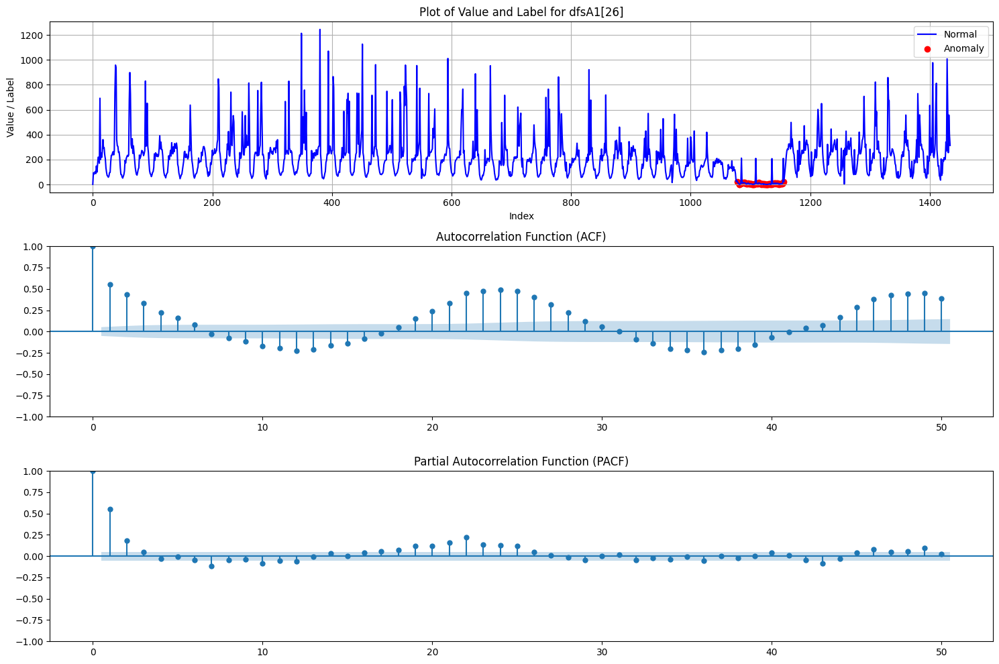

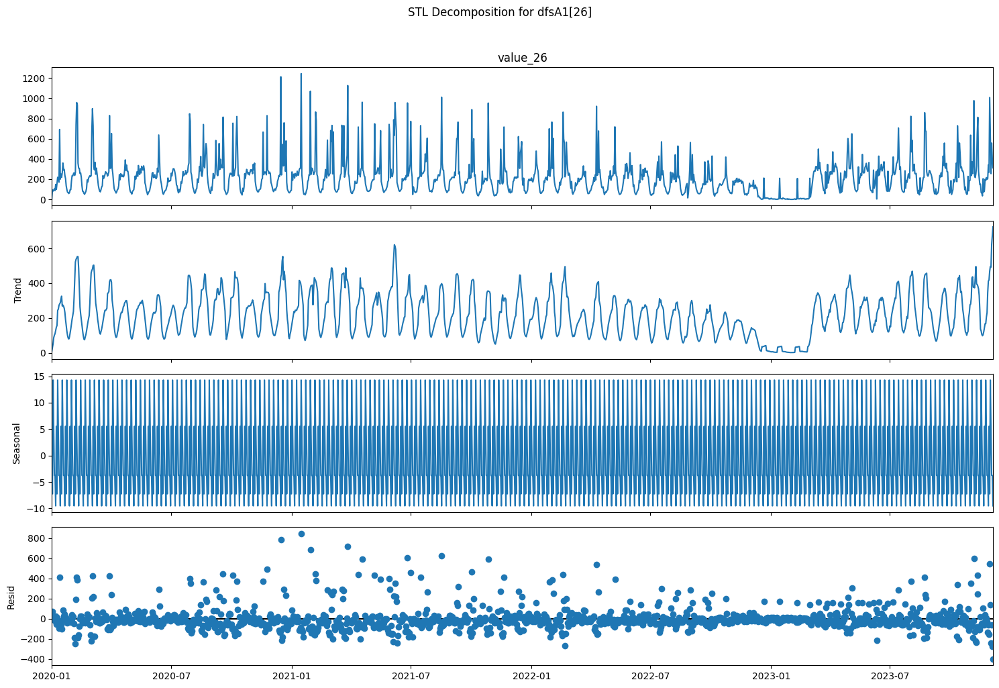

ADF Statistic: -2.372537
p-value: 0.149638
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 0.0866954904235728
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  24.186440677966104


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


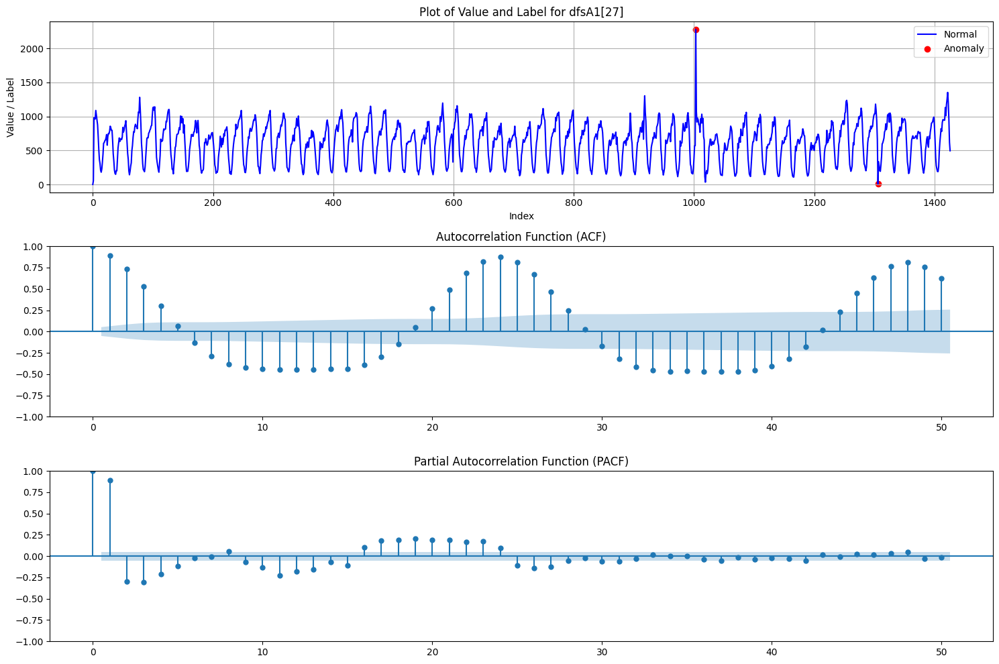

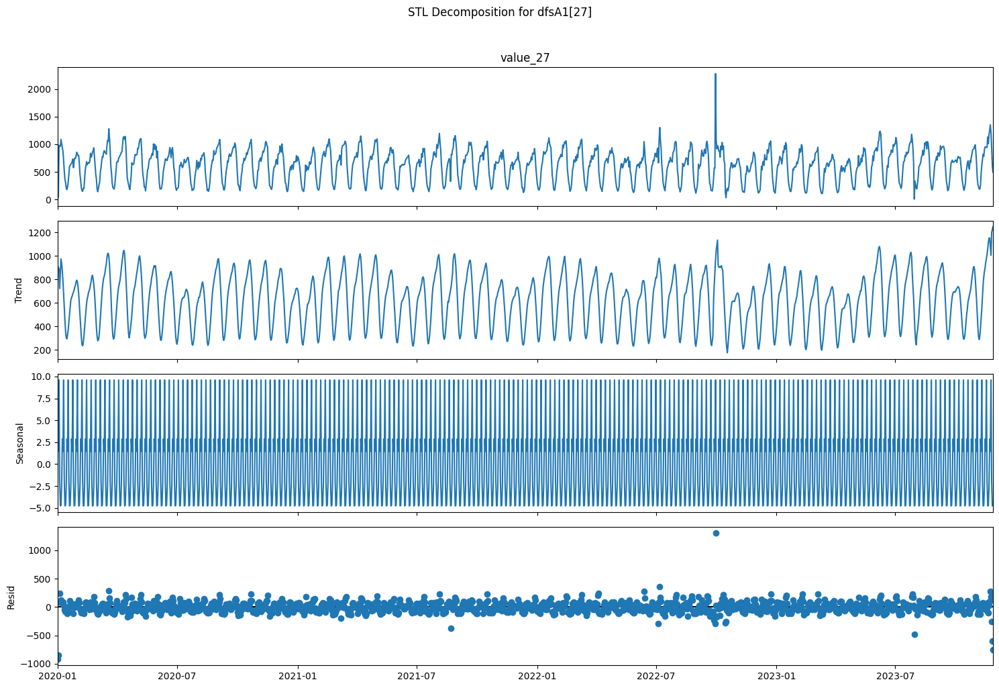

ADF Statistic: -0.081379
p-value: 0.951262
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 1.6098879341457142
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1441.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


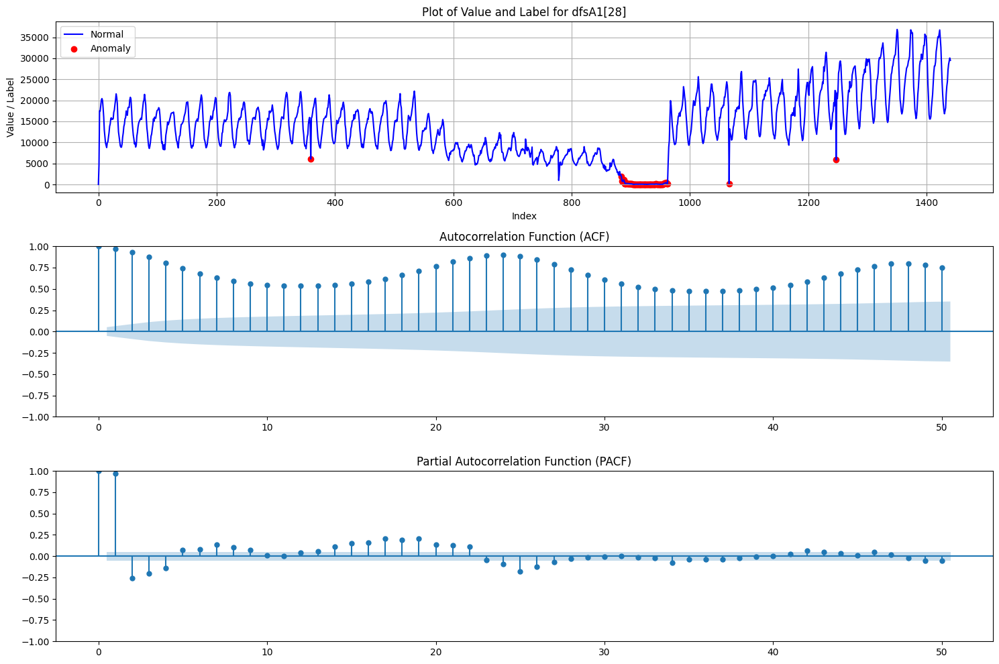

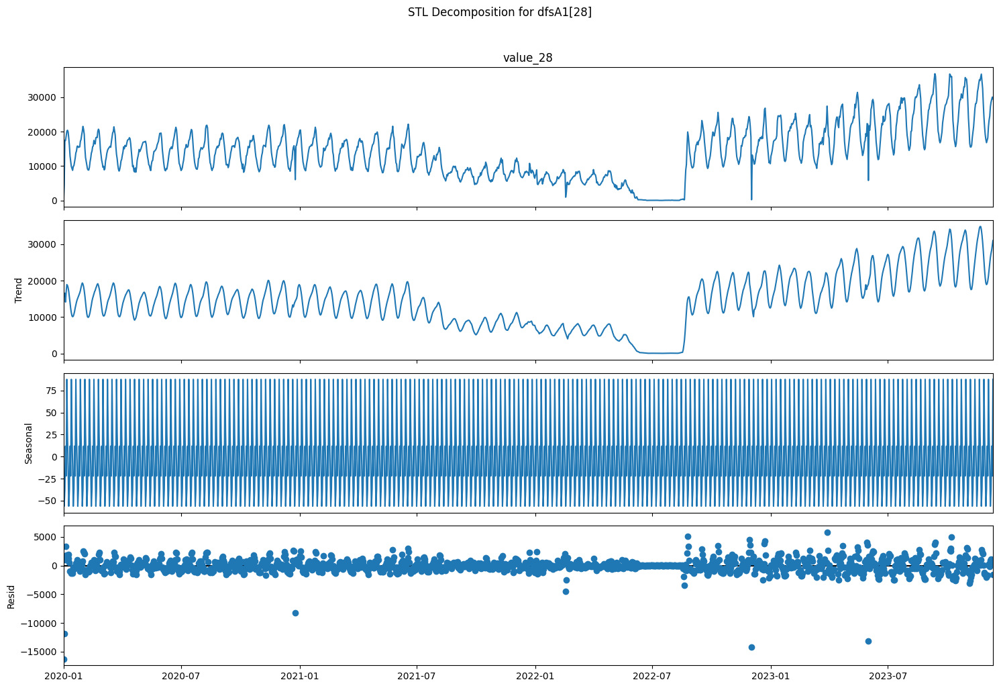

ADF Statistic: -0.939975
p-value: 0.774523
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 0.9258146228219873
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


The most frequent period is  24.01666666666667


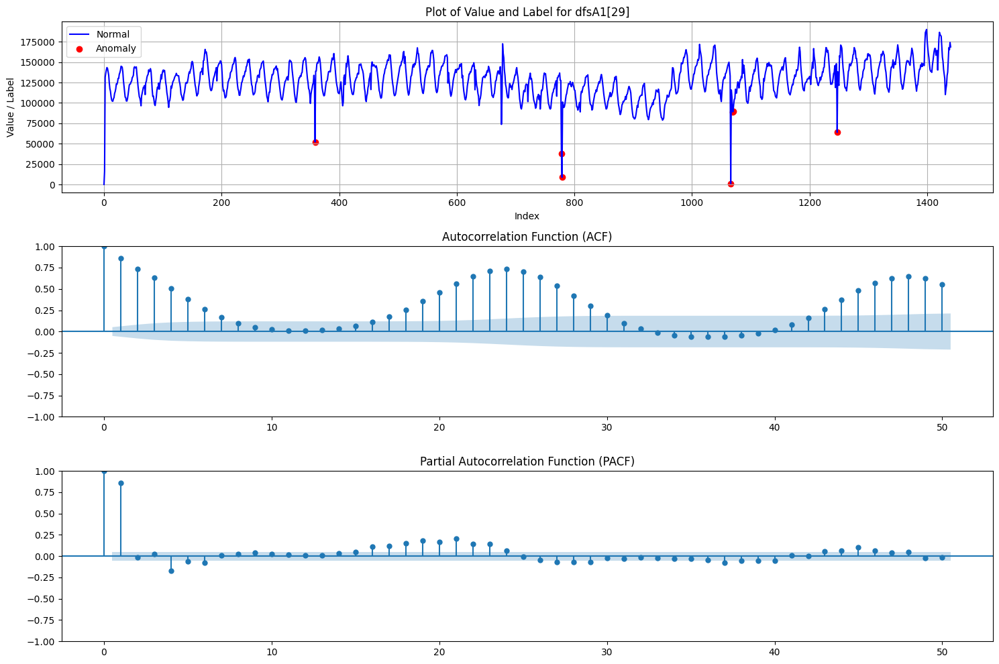

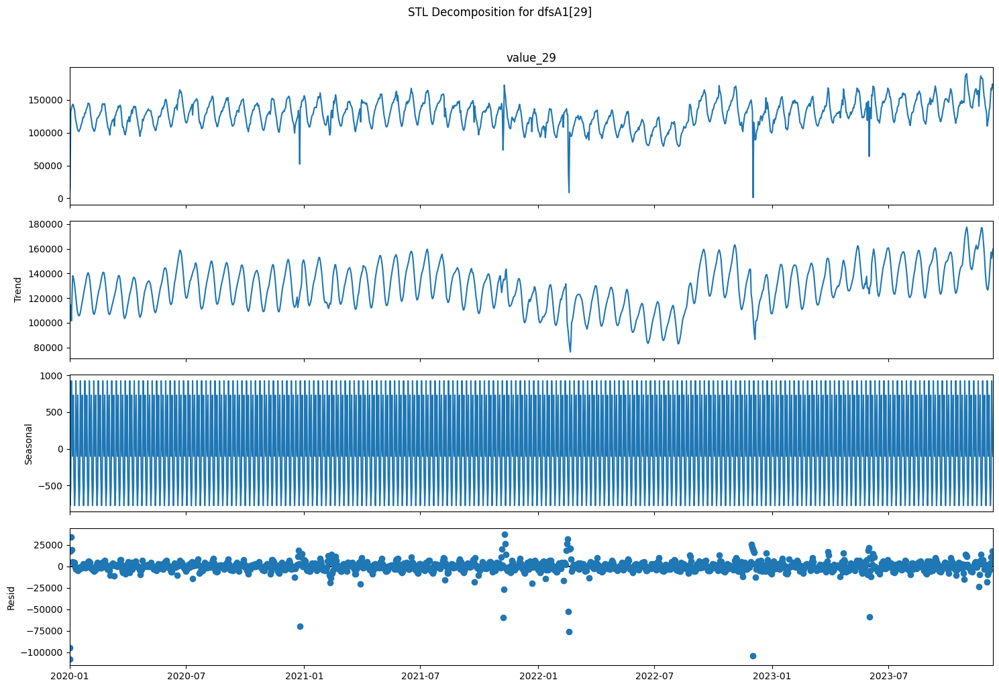

ADF Statistic: -1.038731
p-value: 0.738877
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 0.28263511017688275
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  23.95081967213115


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


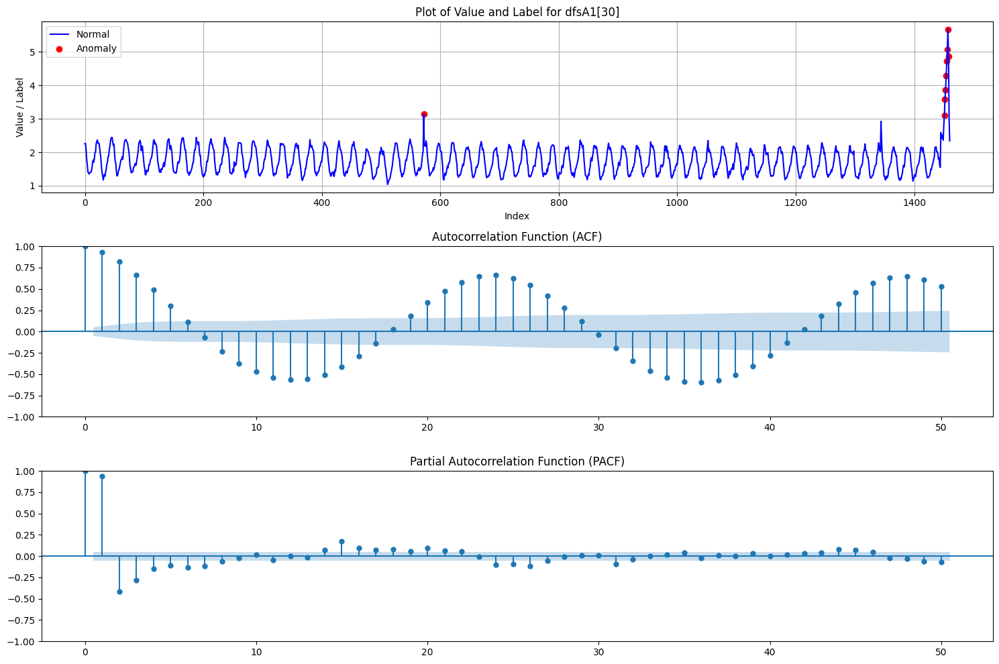

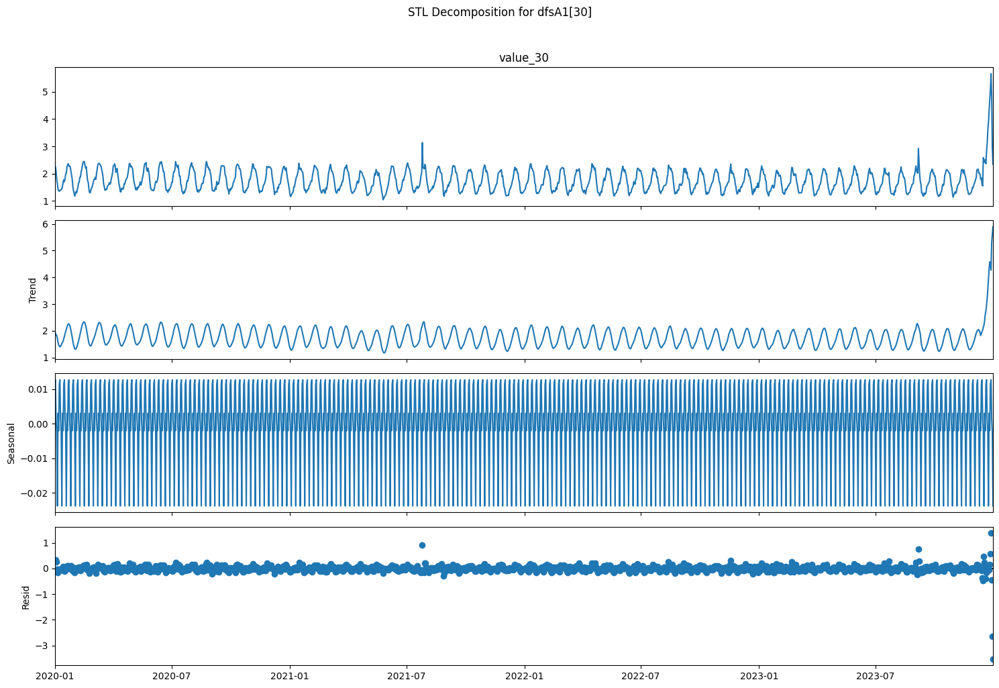

ADF Statistic: -0.457086
p-value: 0.900122
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 2.1572902182096434
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1427.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


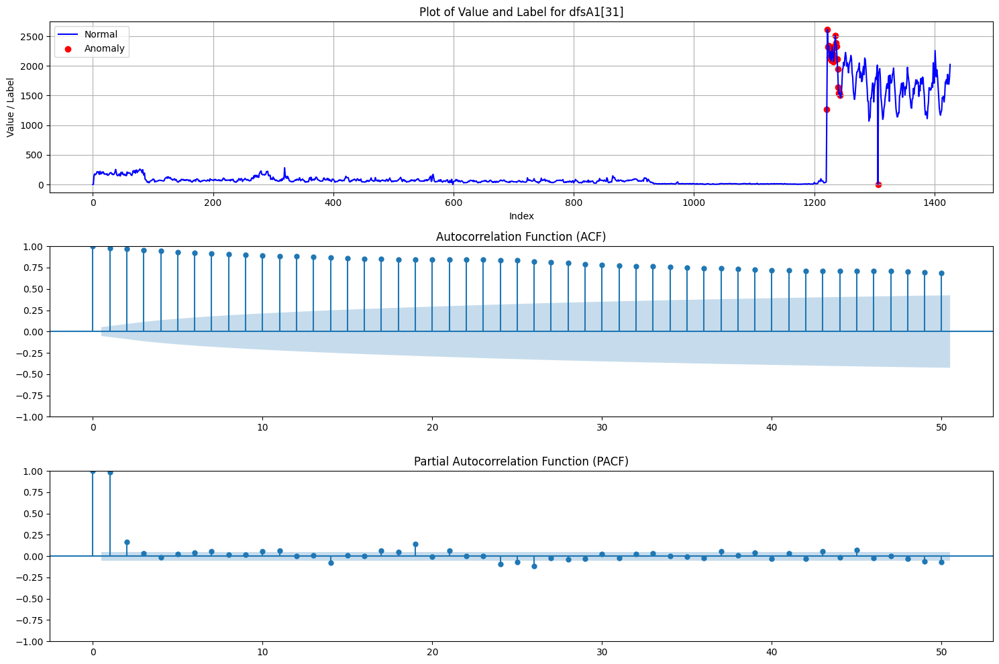

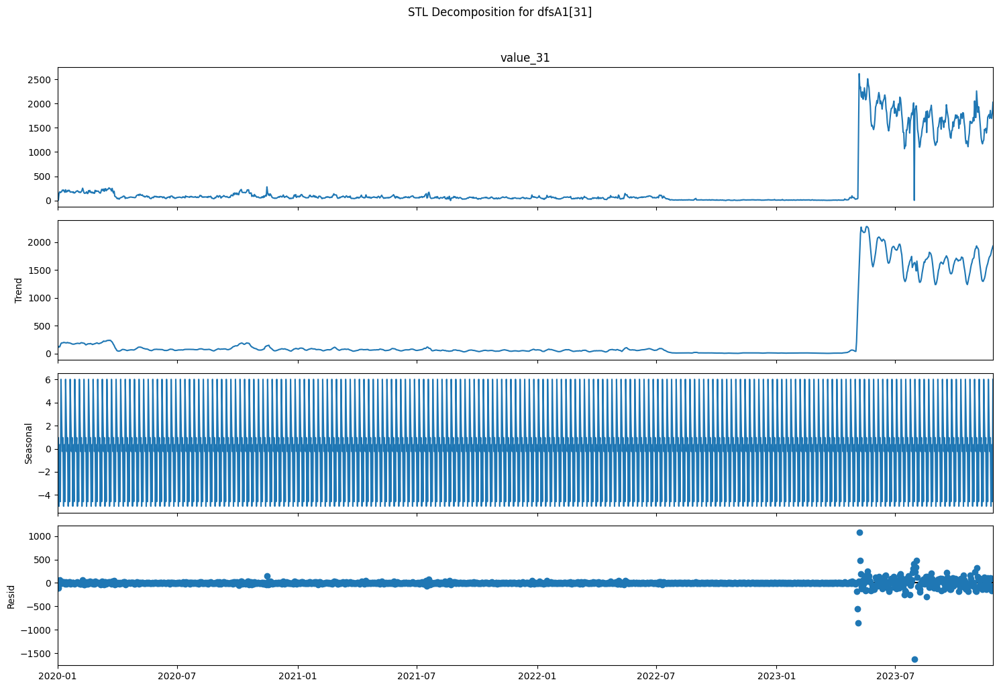

ADF Statistic: -0.804450
p-value: 0.817811
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 2.233086227721056
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1427.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


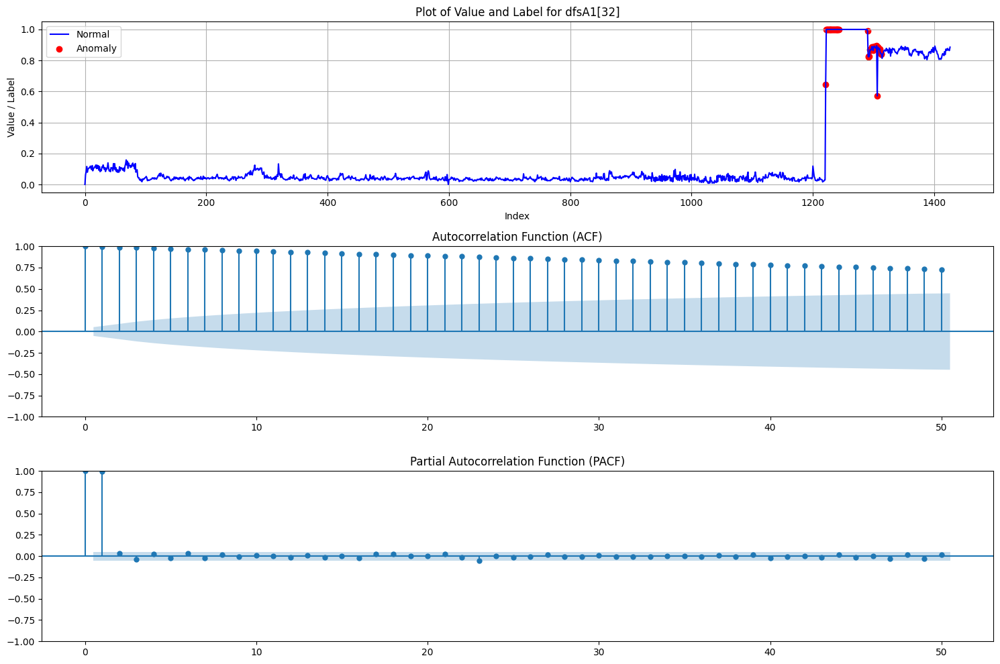

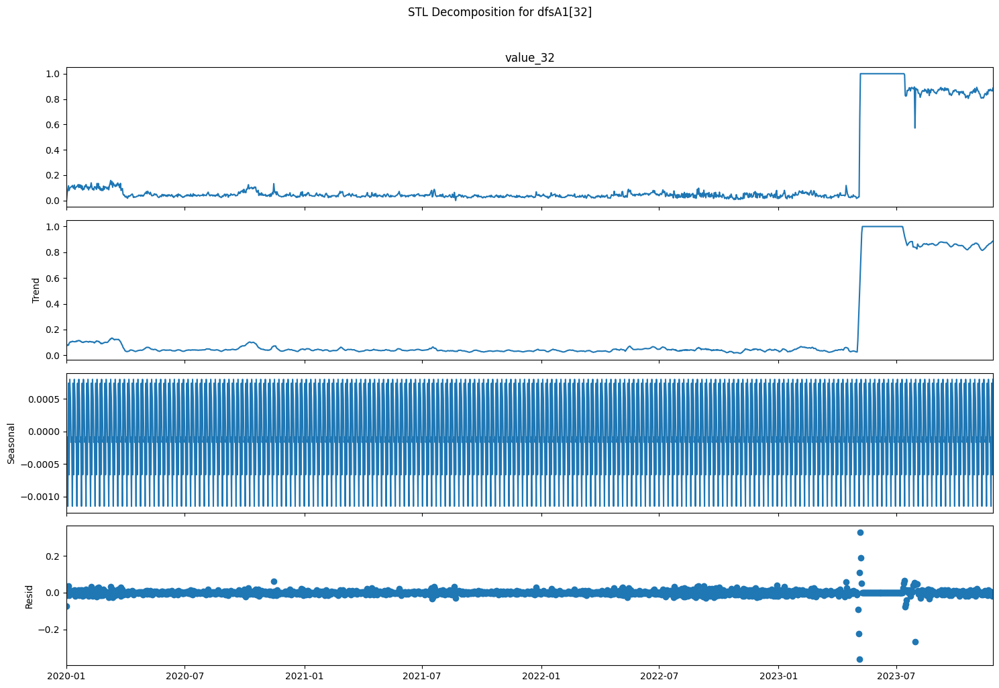

ADF Statistic: -3.027419
p-value: 0.032412
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 1.095696834759069
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  23.983333333333334


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


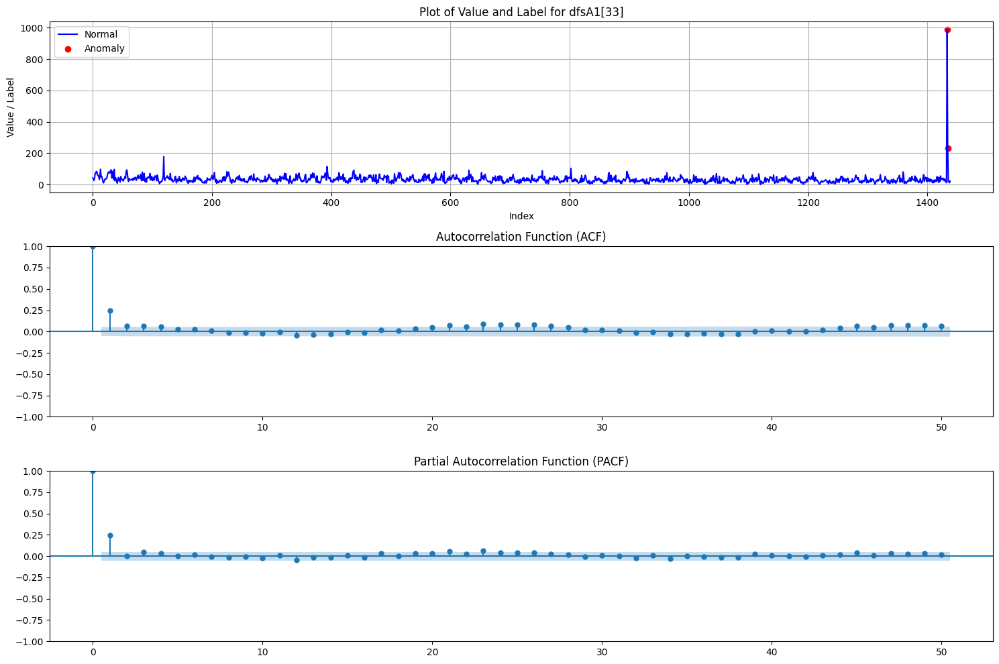

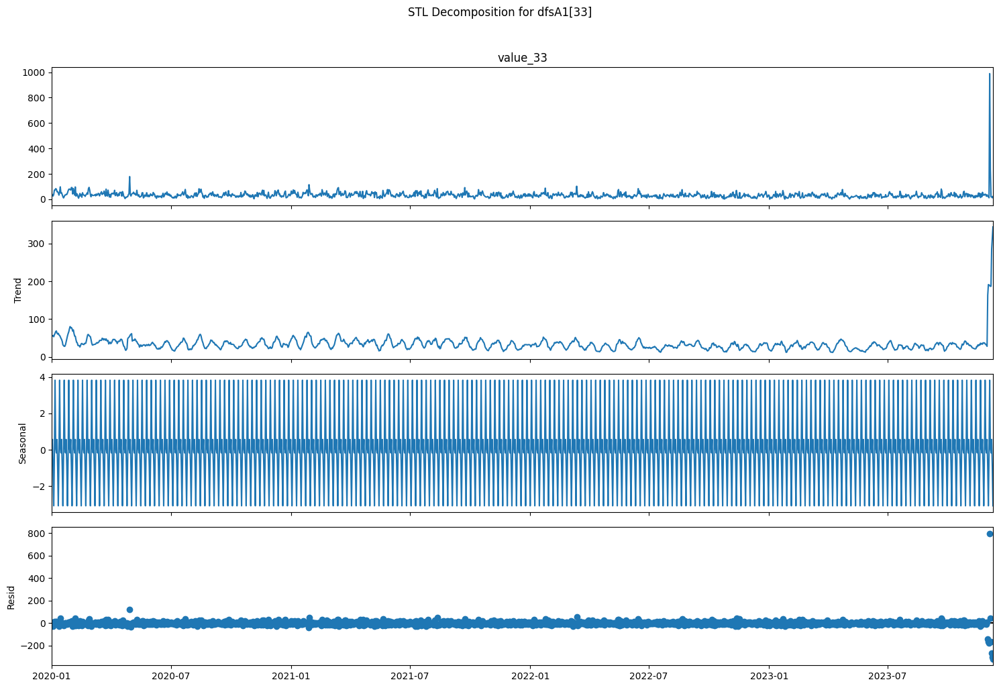

ADF Statistic: -3.225187
p-value: 0.018572
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.18204890565860088
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  24.186440677966104


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


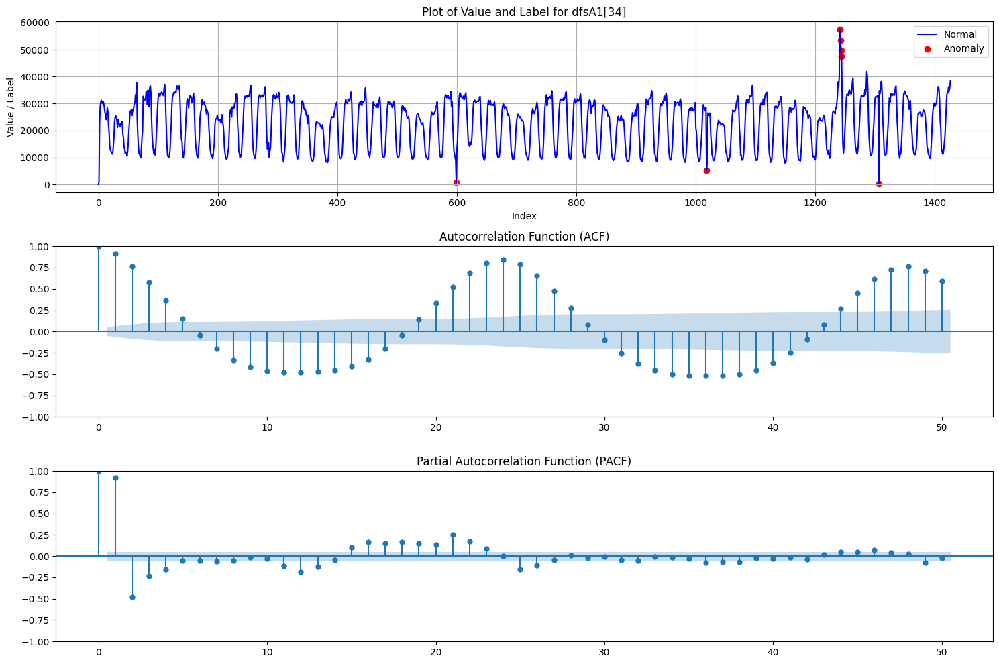

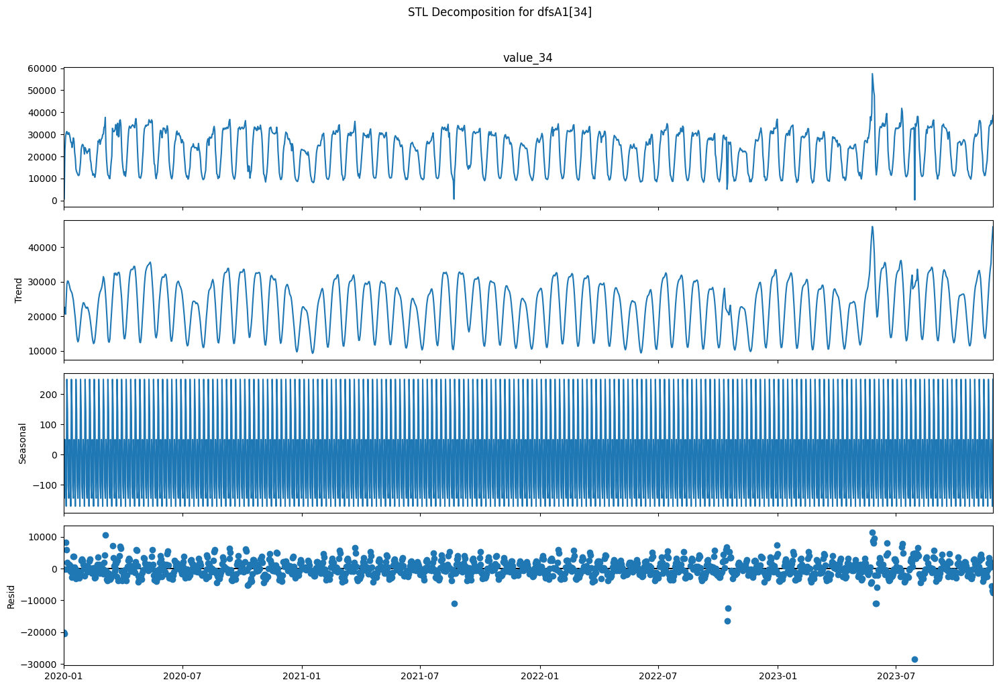

ADF Statistic: -3.544251
p-value: 0.006921
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.4185914248252982
p-value: 0.06914162723047491
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  24.186440677966104


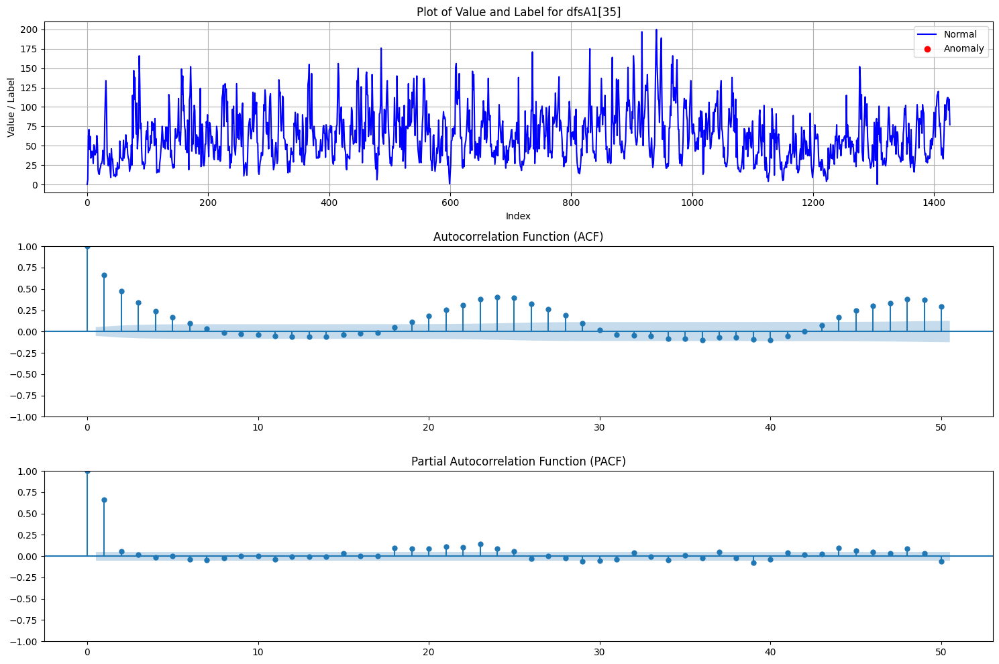

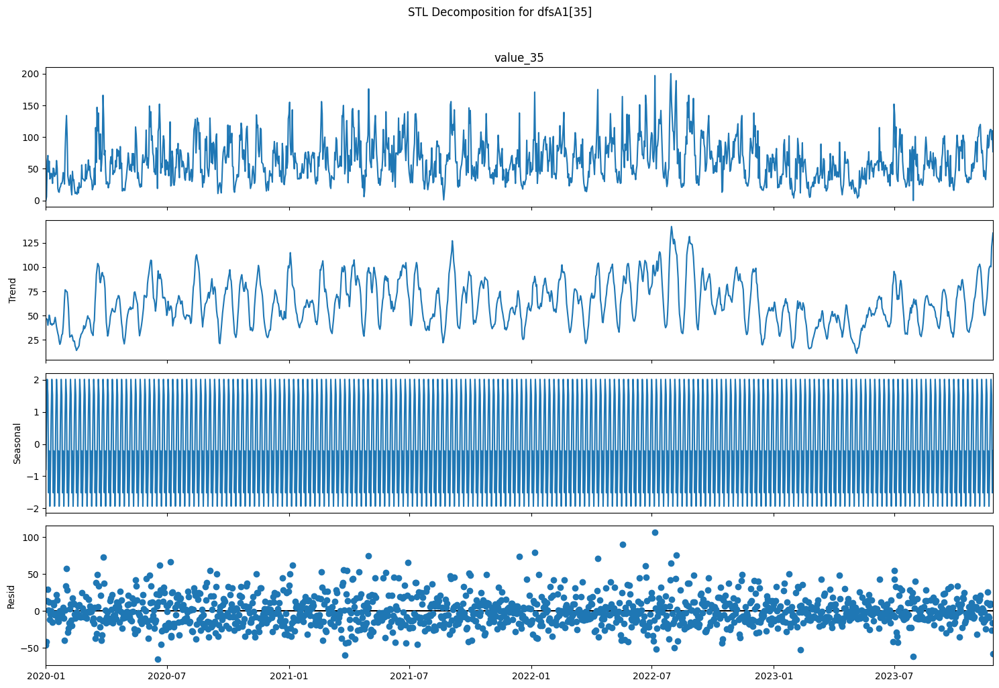

ADF Statistic: -3.188930
p-value: 0.020634
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 2.492454724311826
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  23.95081967213115


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


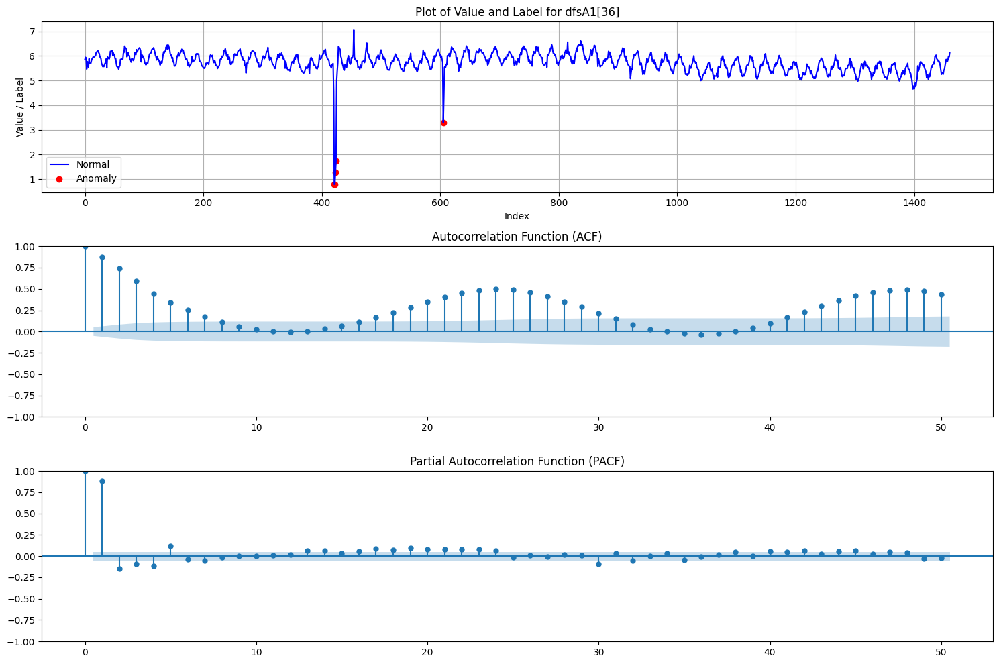

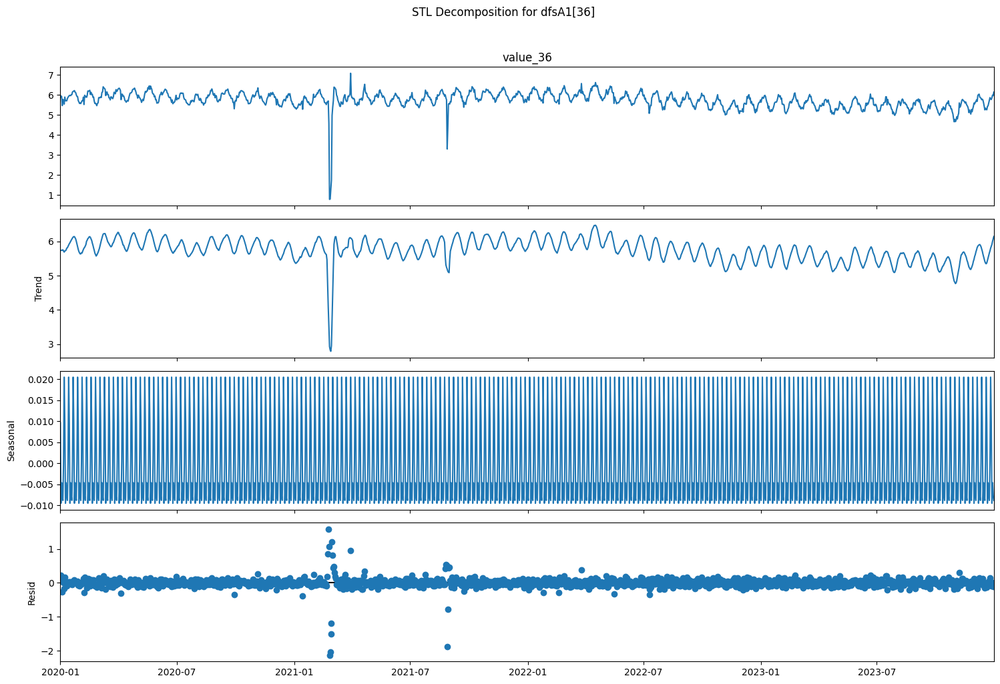

ADF Statistic: -4.293125
p-value: 0.000457
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.48654023669287244
p-value: 0.0446981448889927
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  23.900000000000002


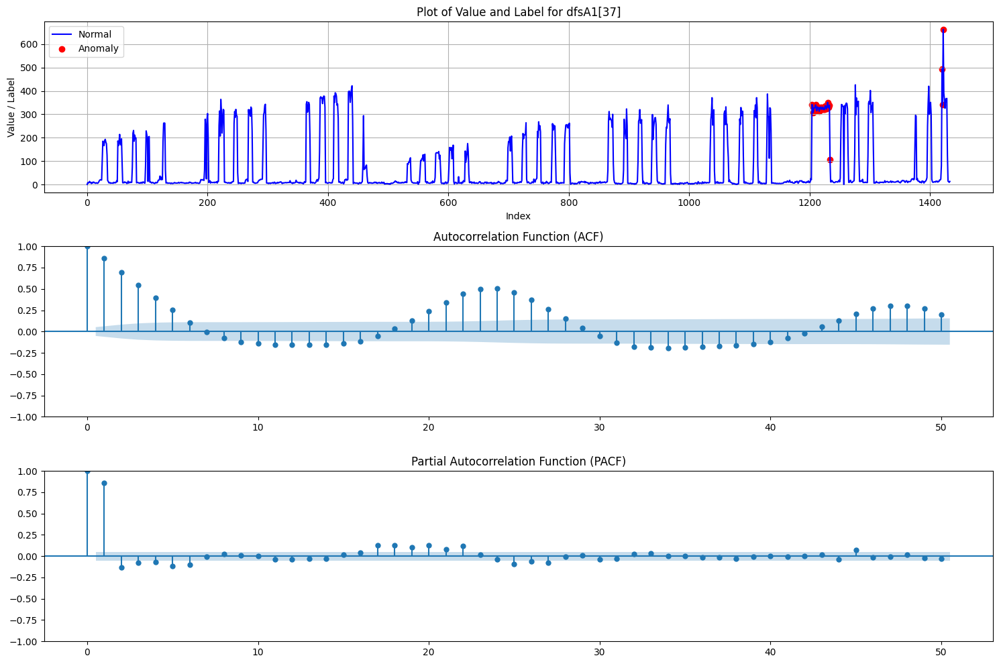

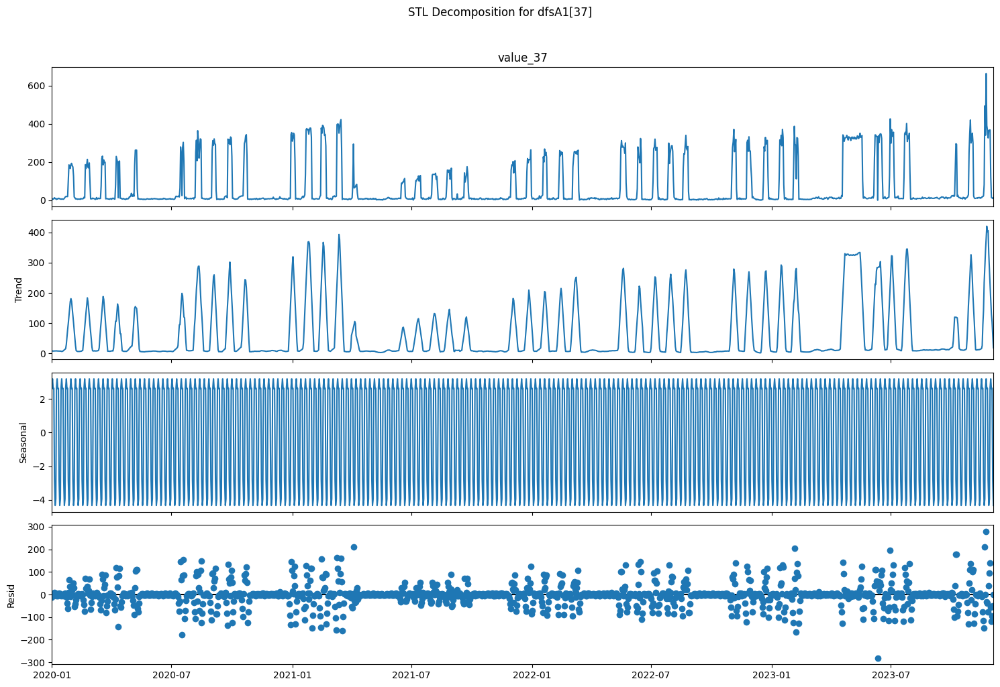

ADF Statistic: -3.136060
p-value: 0.023997
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.41589542560730164
p-value: 0.07030369585892171
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  24.186440677966104


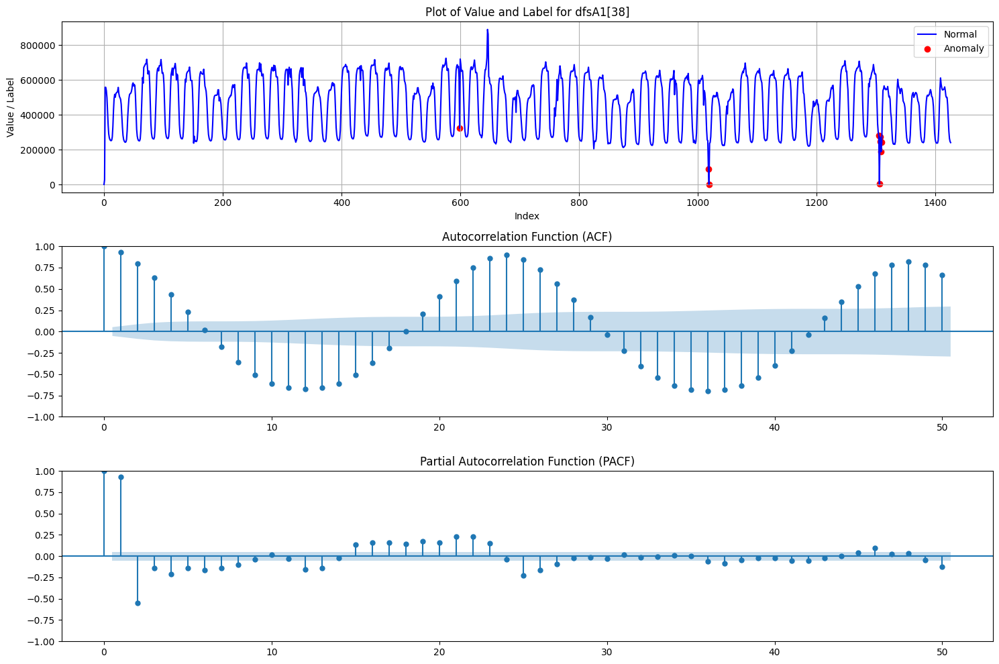

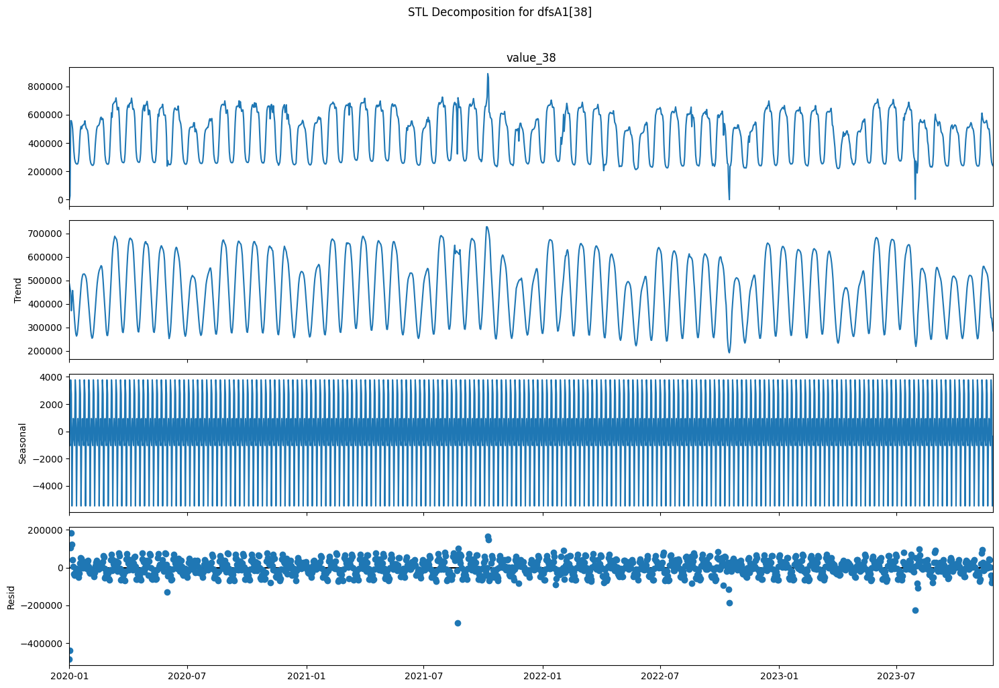

ADF Statistic: -4.112612
p-value: 0.000923
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.5196988958445687
p-value: 0.03722997841338542
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  24.186440677966104


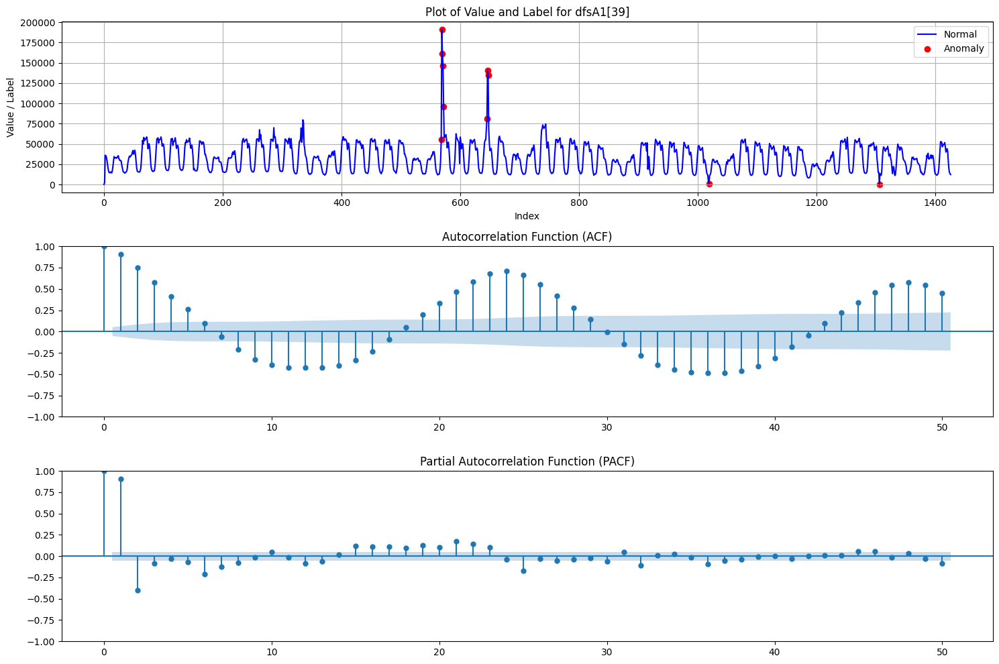

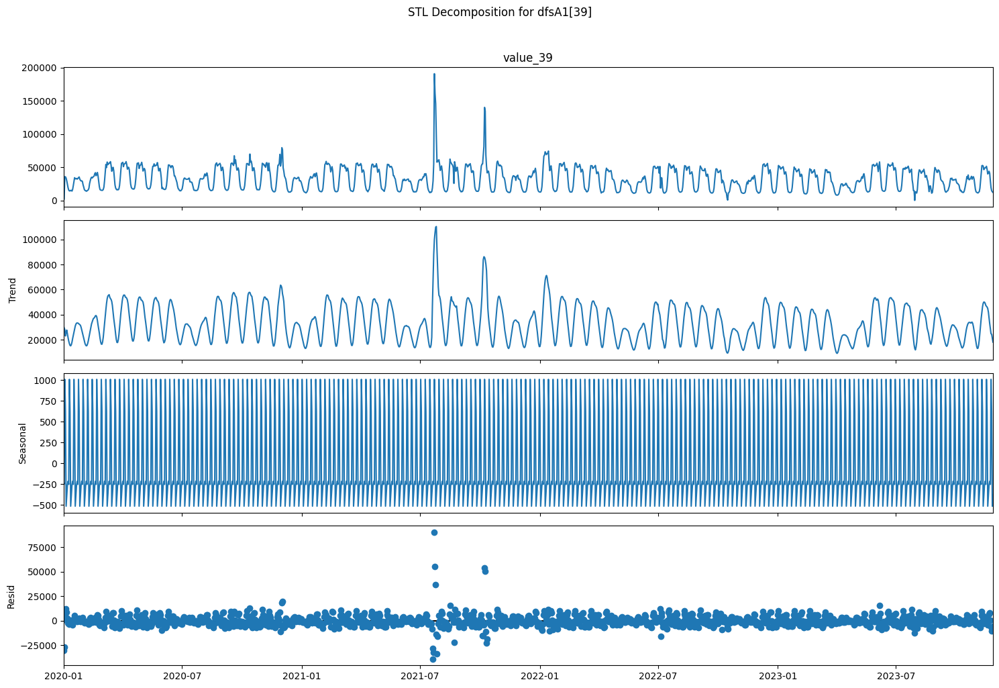

ADF Statistic: -2.944505
p-value: 0.040412
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.830460989851177
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1427.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


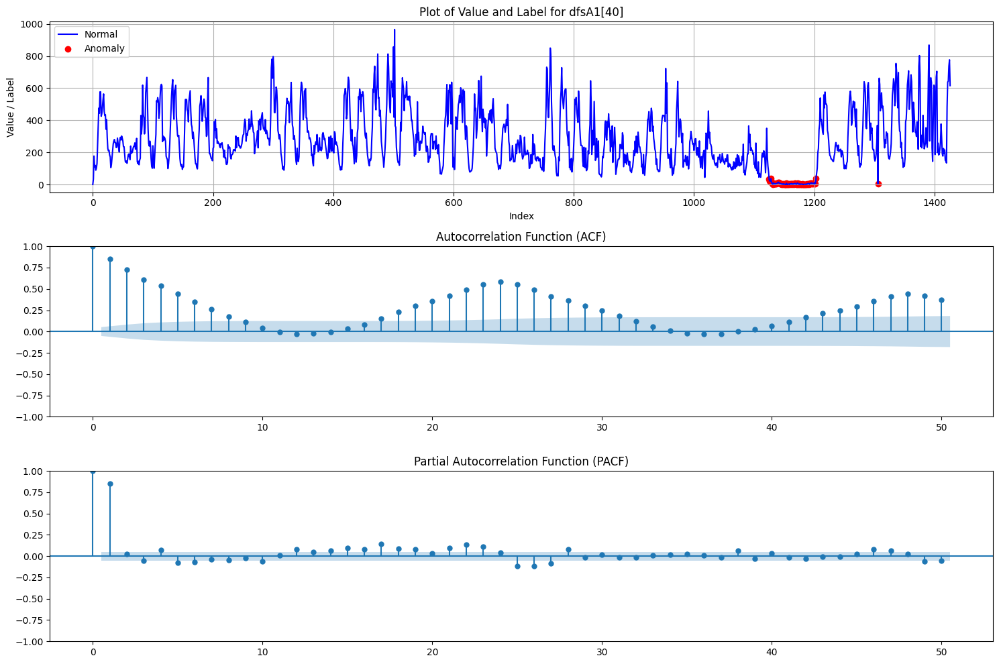

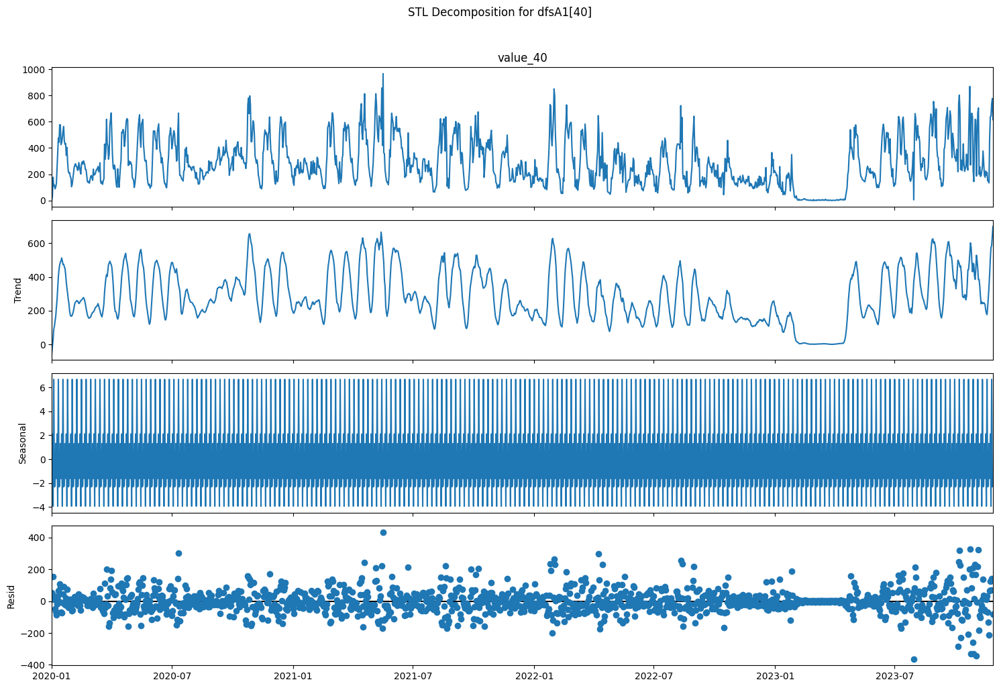

ADF Statistic: -3.680523
p-value: 0.004396
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.5314195311644873
p-value: 0.03459019568367404
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1435.0


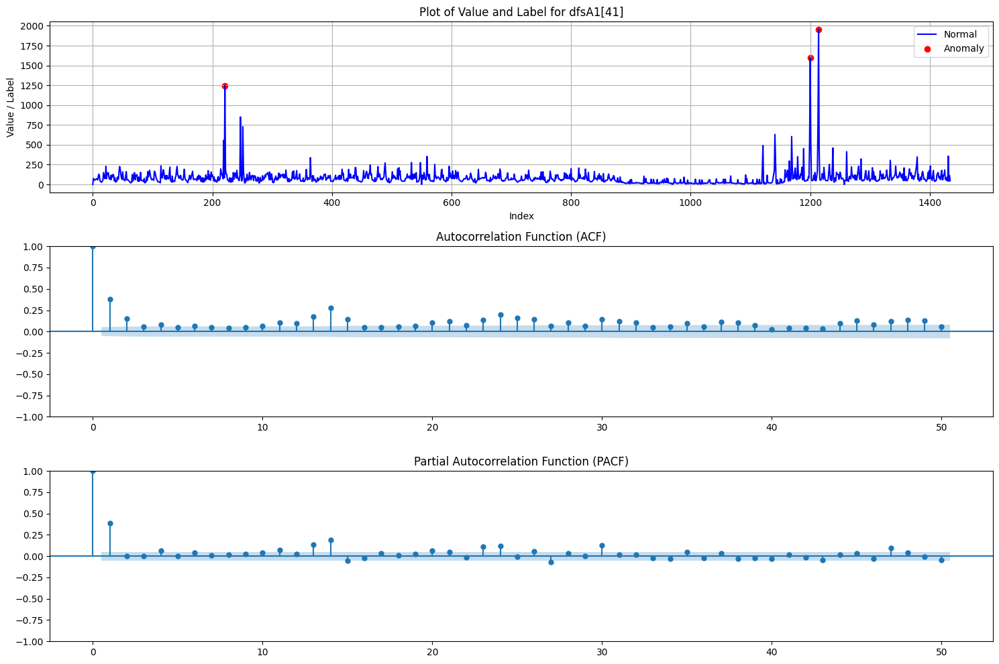

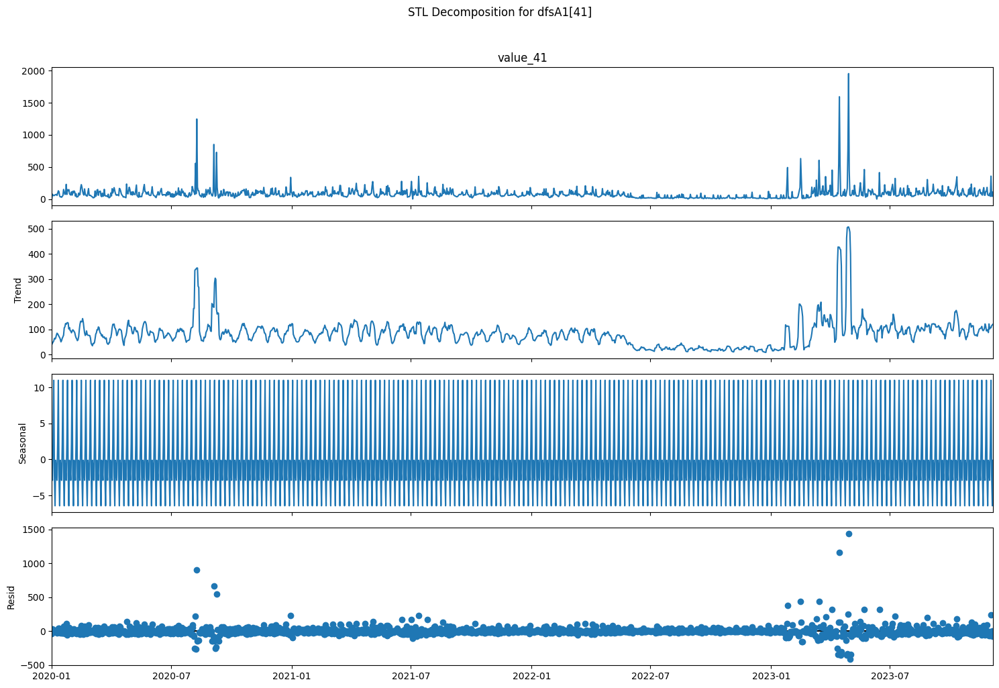

ADF Statistic: 1.433677
p-value: 0.997262
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 1.3013595714768837
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1440.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


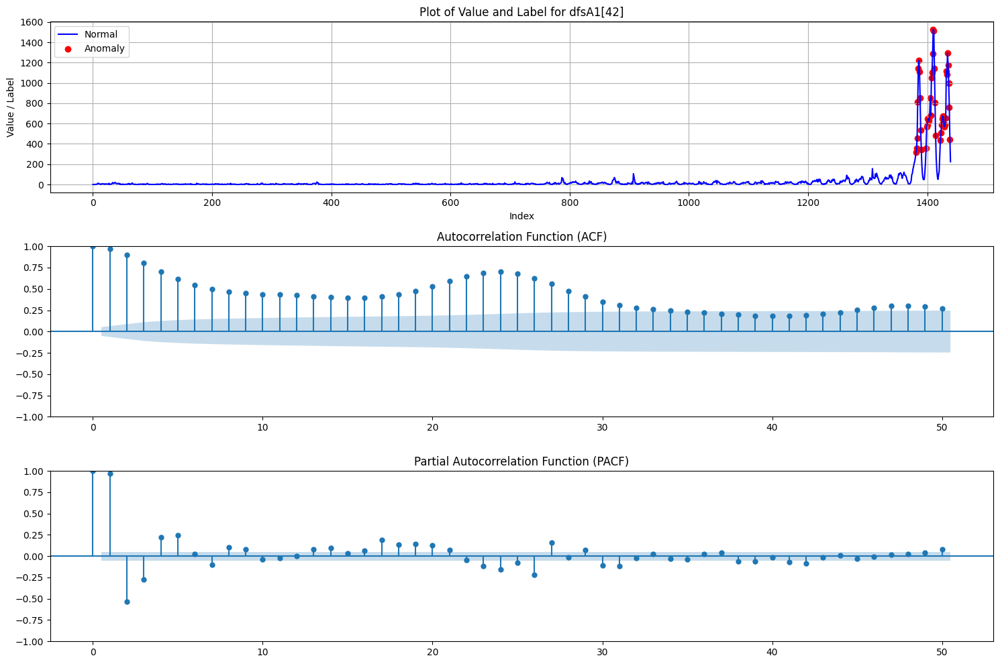

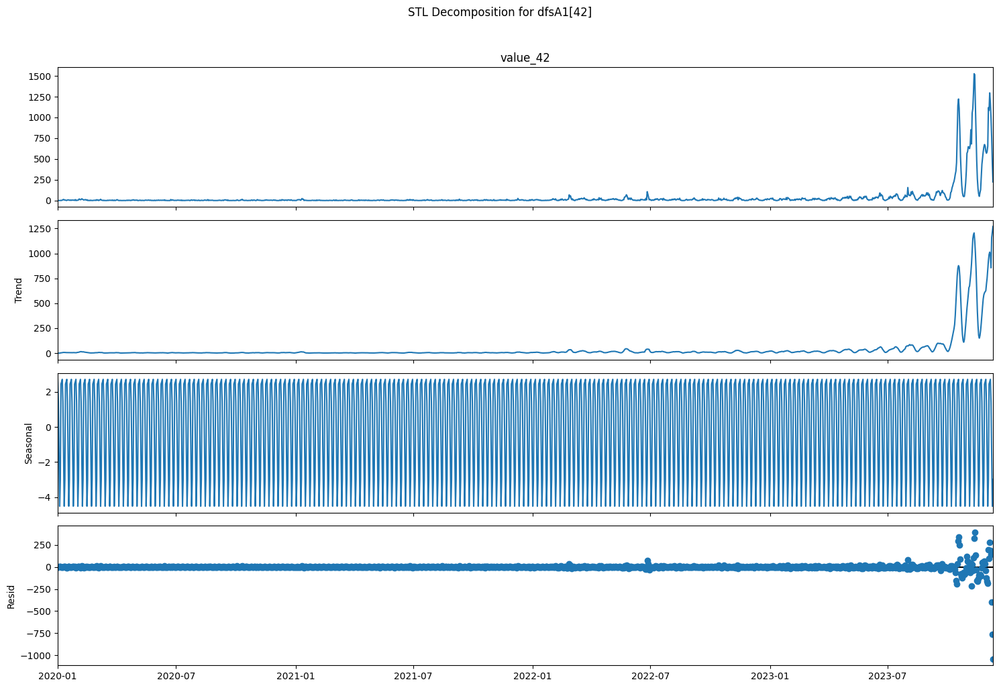

ADF Statistic: -1.386593
p-value: 0.588687
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 2.465488548139444
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1440.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


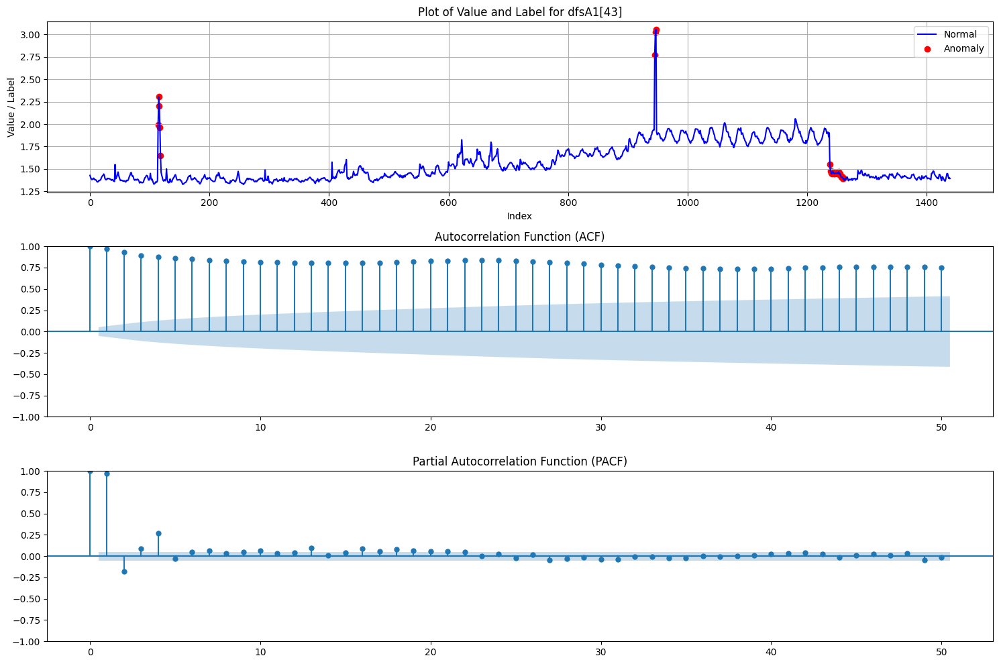

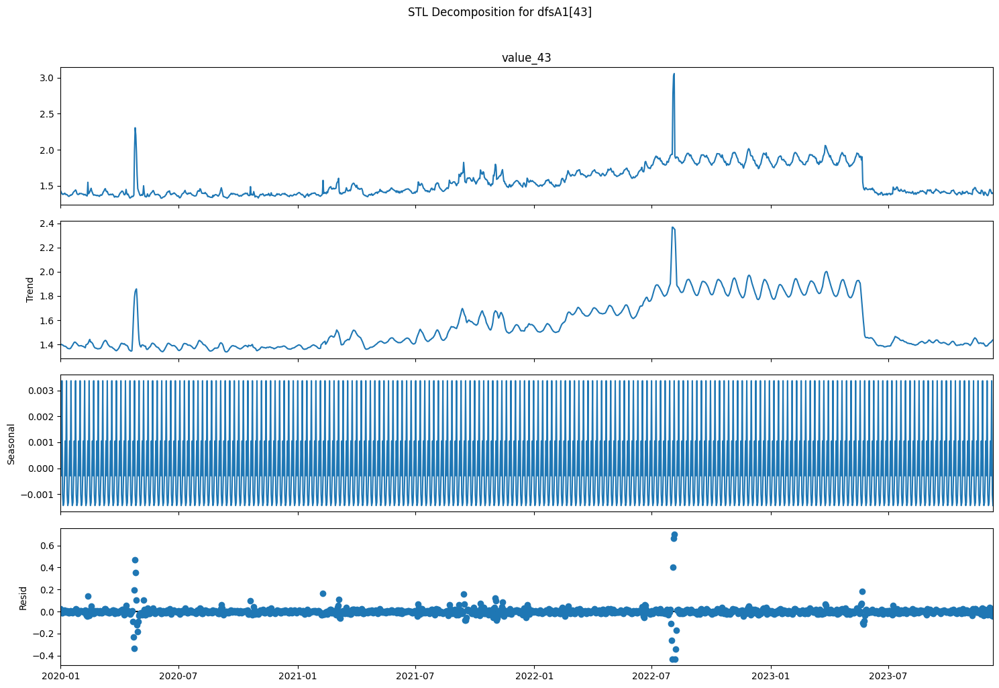

ADF Statistic: -2.895729
p-value: 0.045847
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 3.7229768397092995
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  23.95081967213115


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


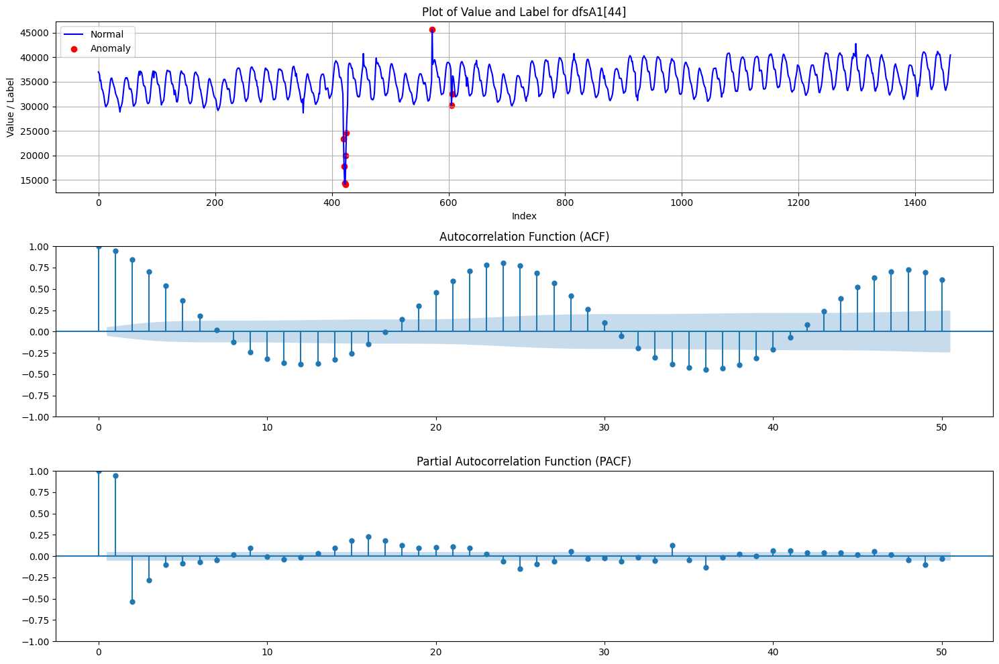

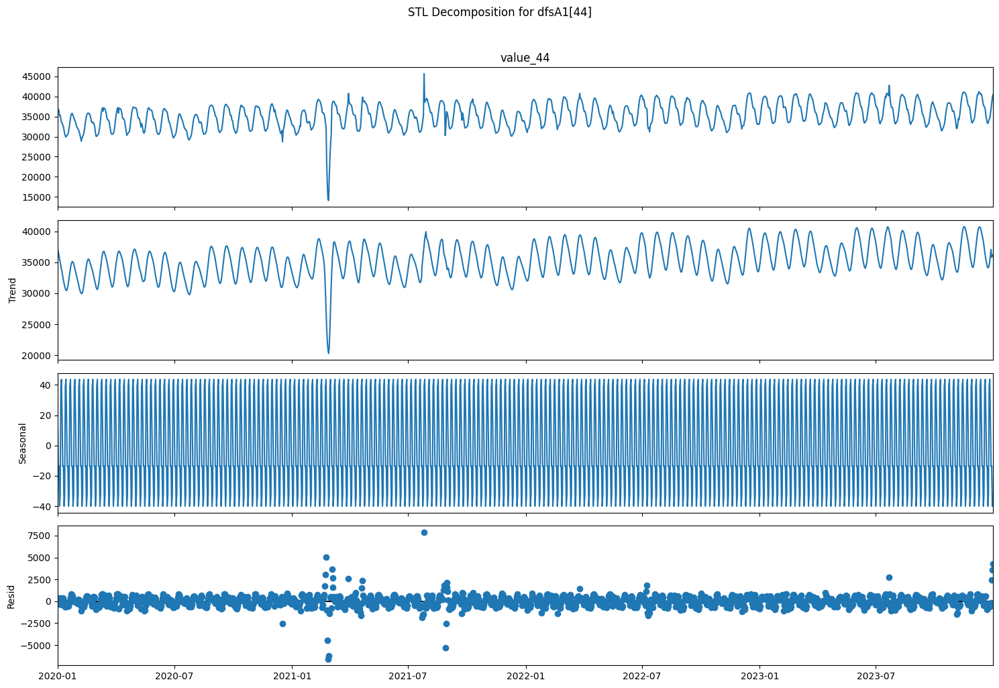

ADF Statistic: -10.742780
p-value: 0.000000
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.46639865088548654
p-value: 0.04923453808885439
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  4.0


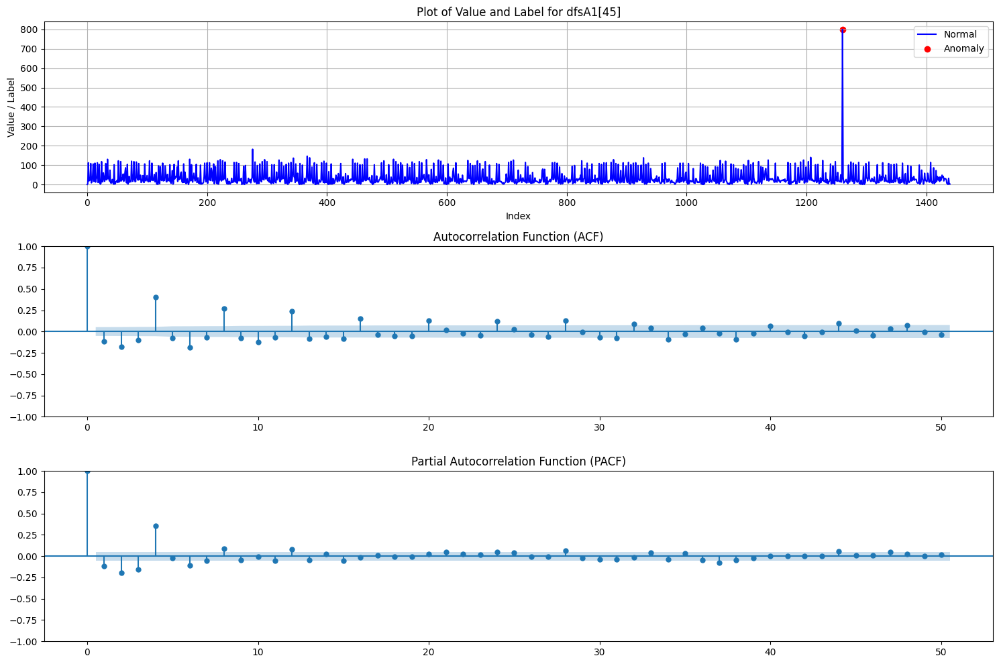

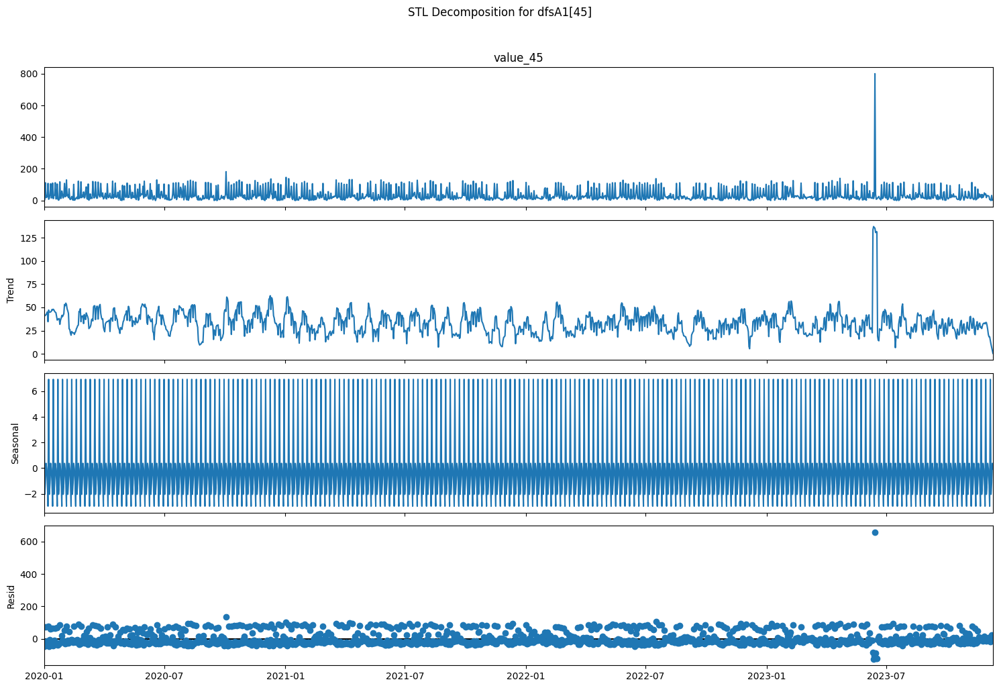

ADF Statistic: -0.826505
p-value: 0.811212
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 1.339888054874793
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


The most frequent period is  1441.0


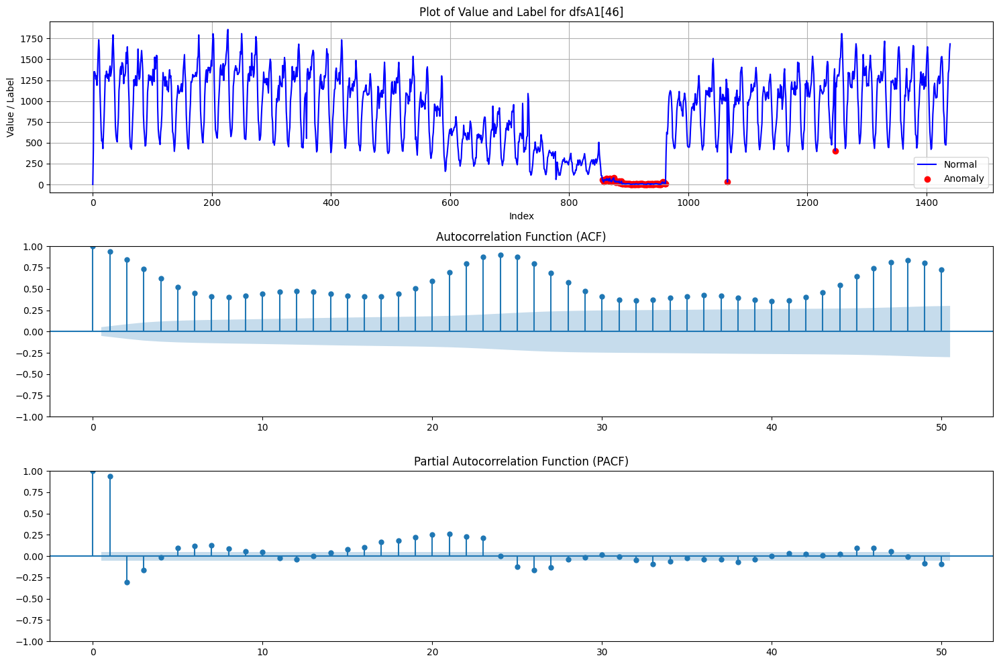

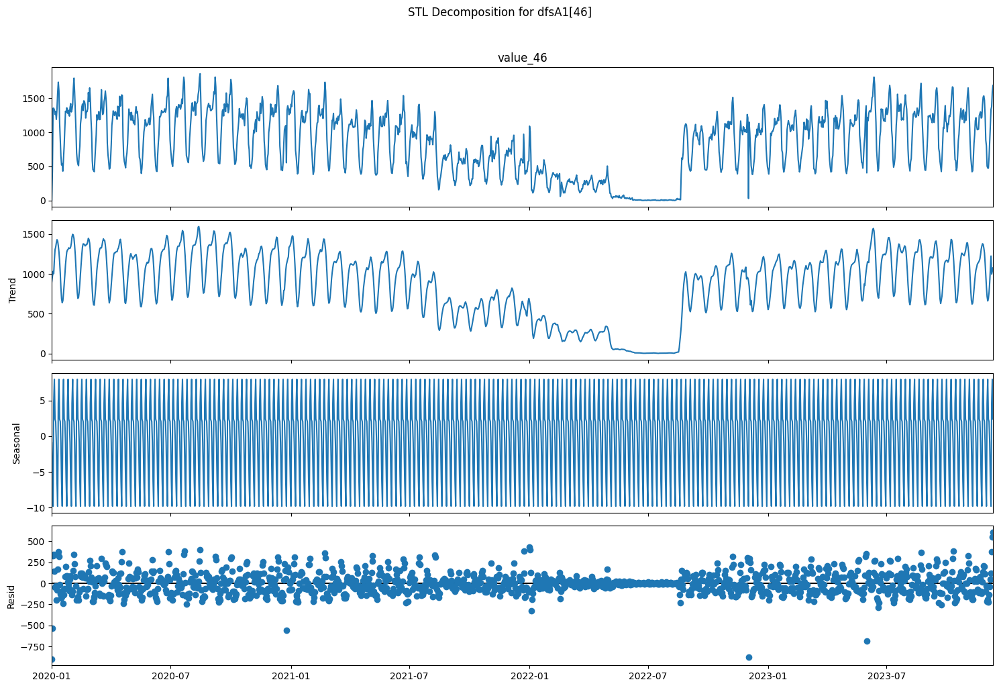

ADF Statistic: -1.704924
p-value: 0.428577
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 1.375199202033939
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  11.991596638655462


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


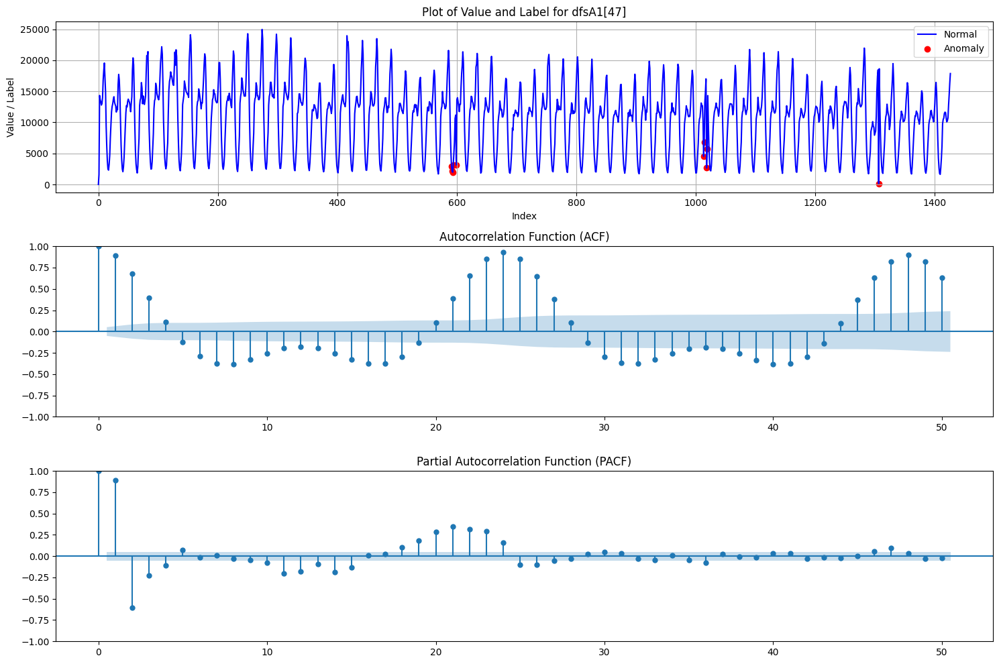

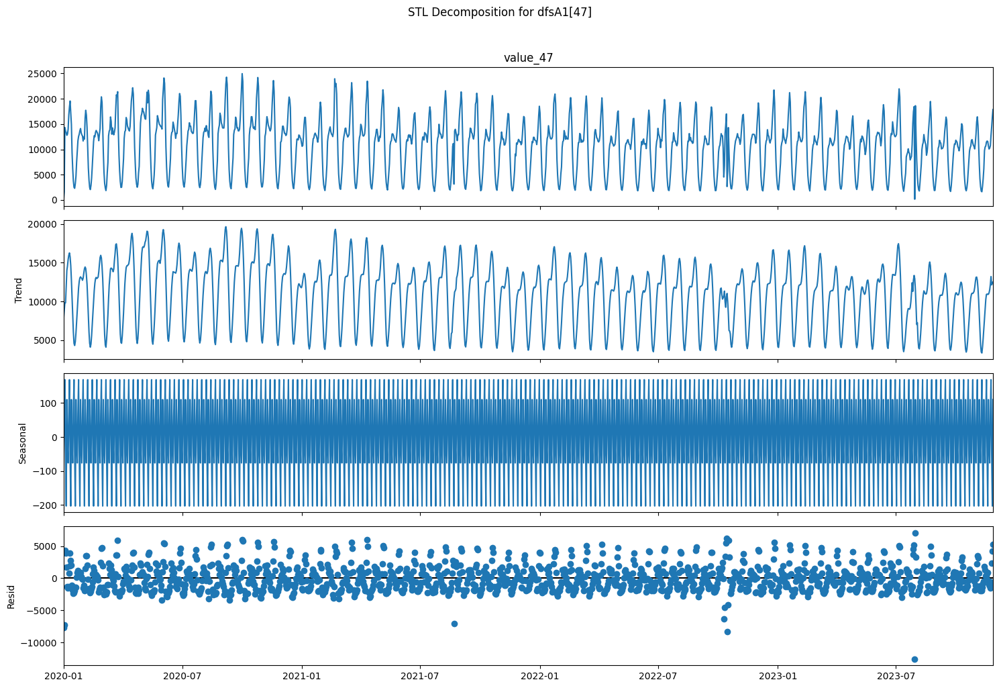

ADF Statistic: -4.644558
p-value: 0.000107
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 2.792587357827889
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1439.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


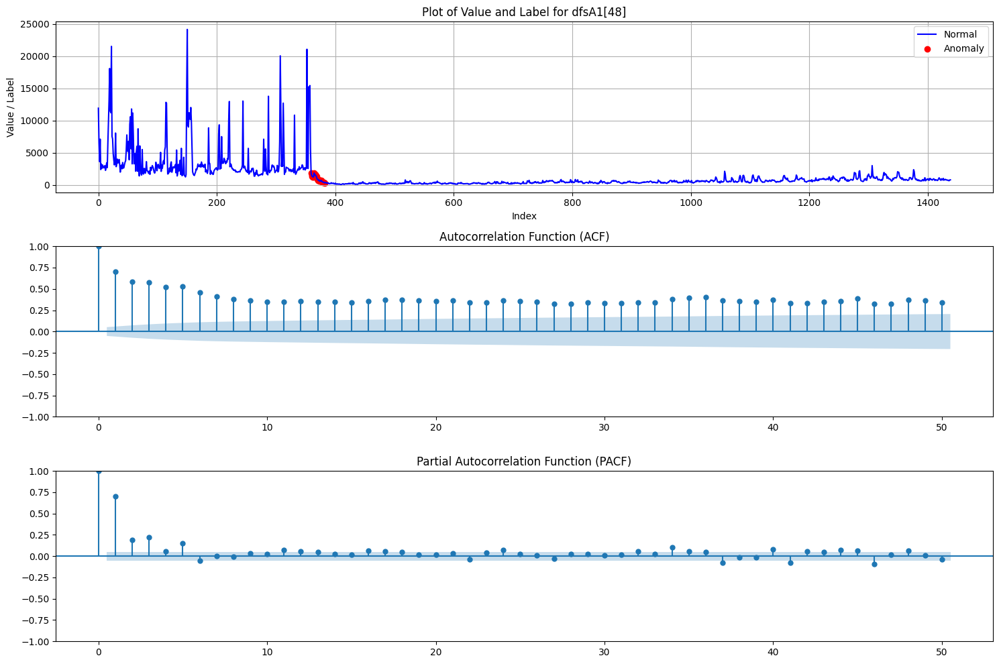

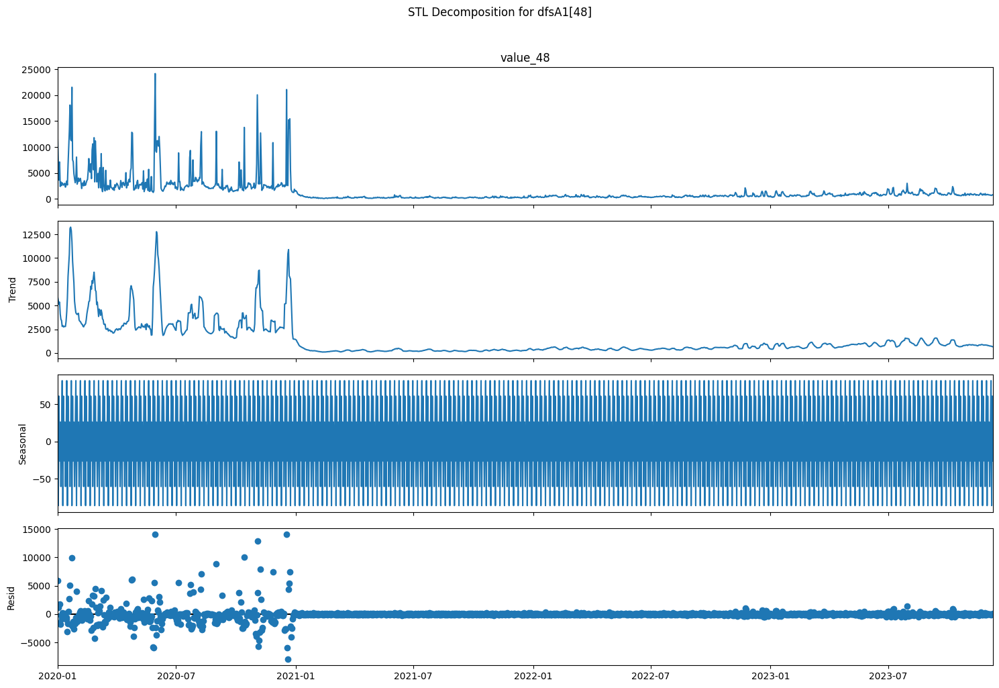

ADF Statistic: -3.411273
p-value: 0.010581
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.29553884413036724
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  23.95081967213115


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


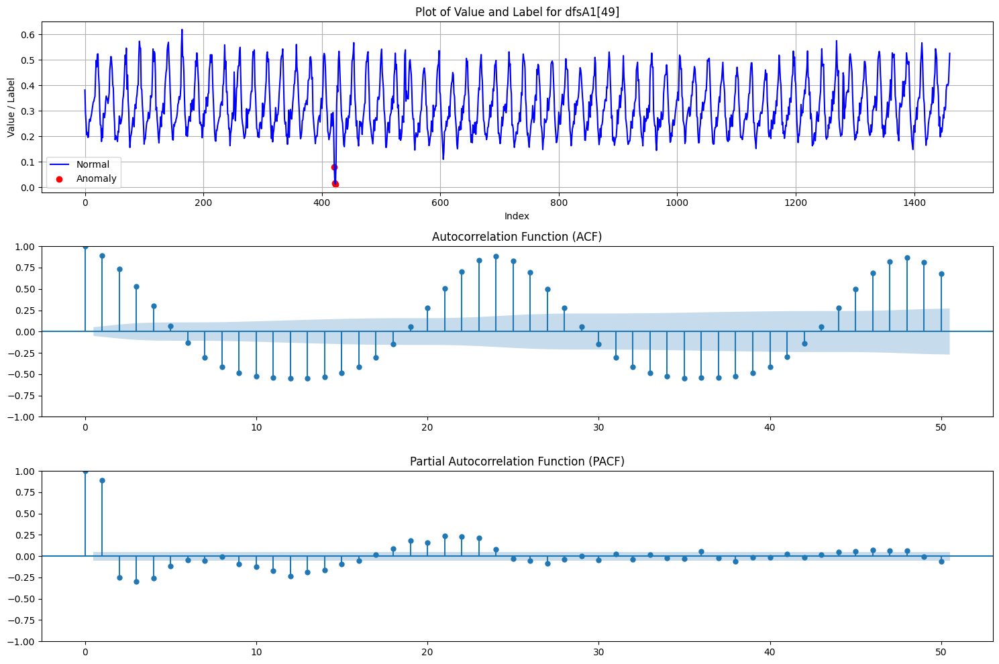

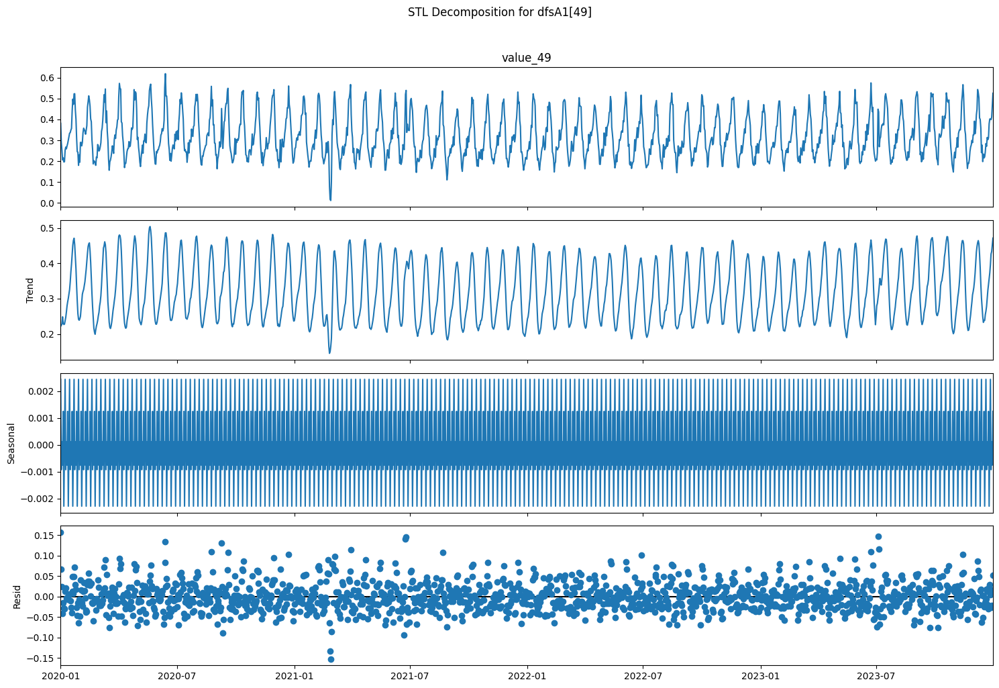

ADF Statistic: 0.218552
p-value: 0.973283
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 0.9189278424399889
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  23.983333333333334


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


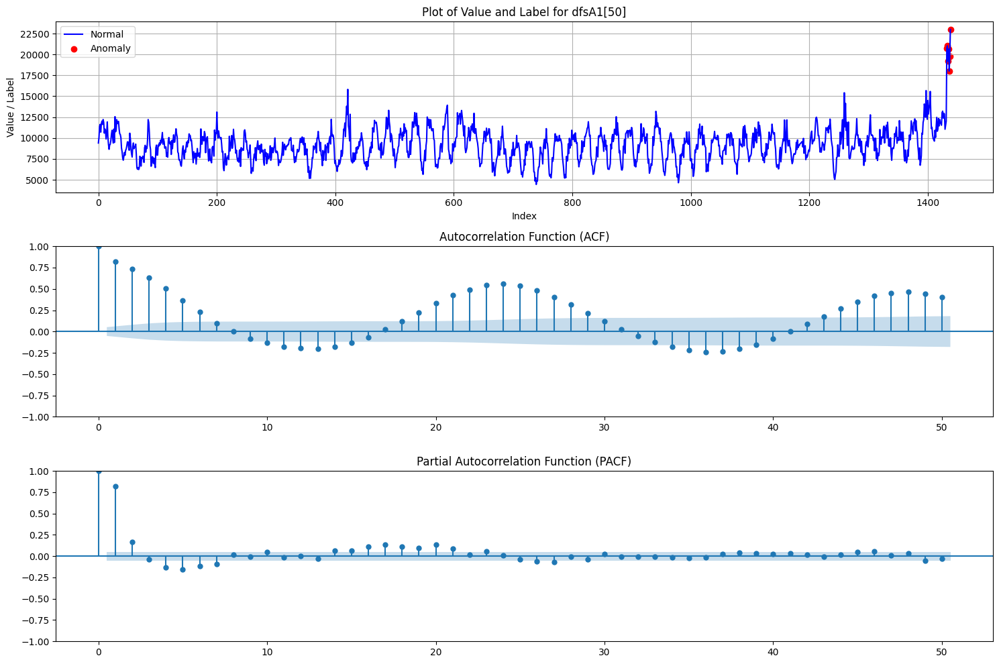

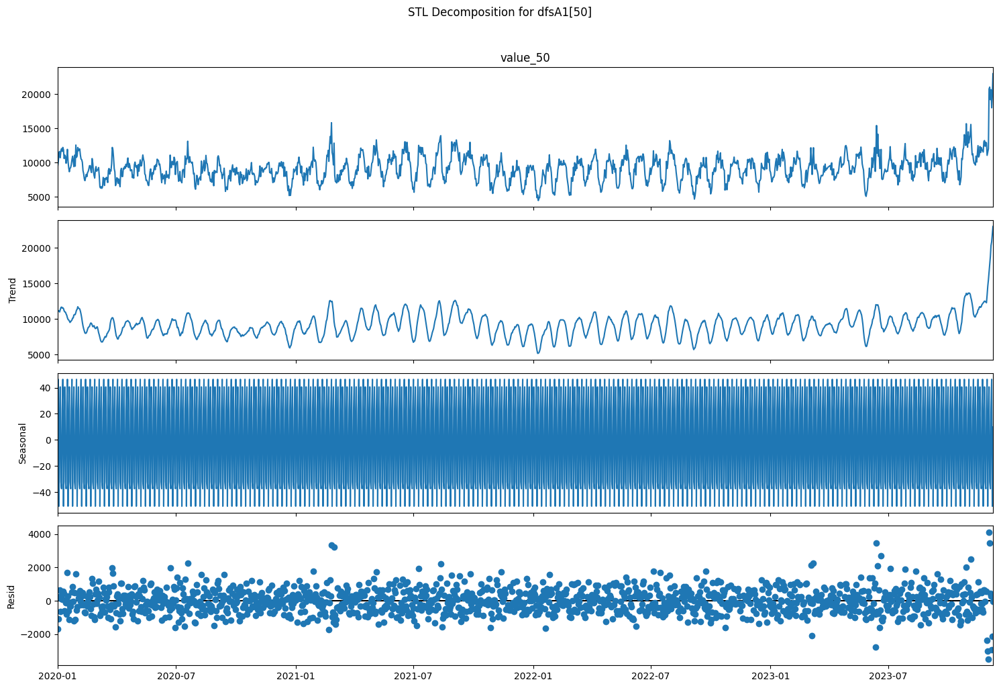

ADF Statistic: -1.735349
p-value: 0.412998
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 0.6901466330418574
p-value: 0.01444121517801296
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  24.186440677966104


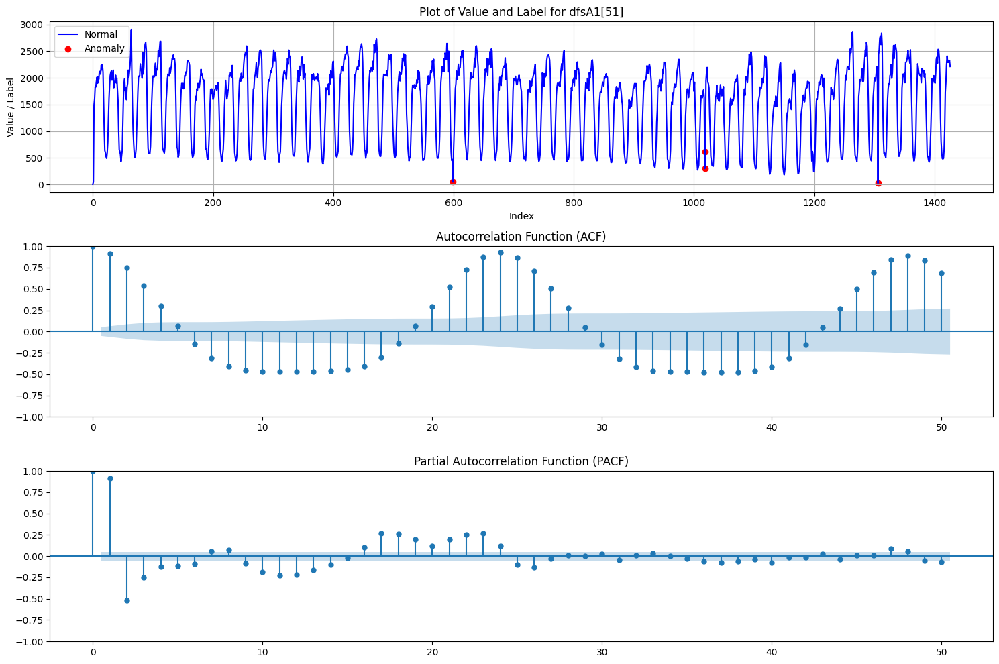

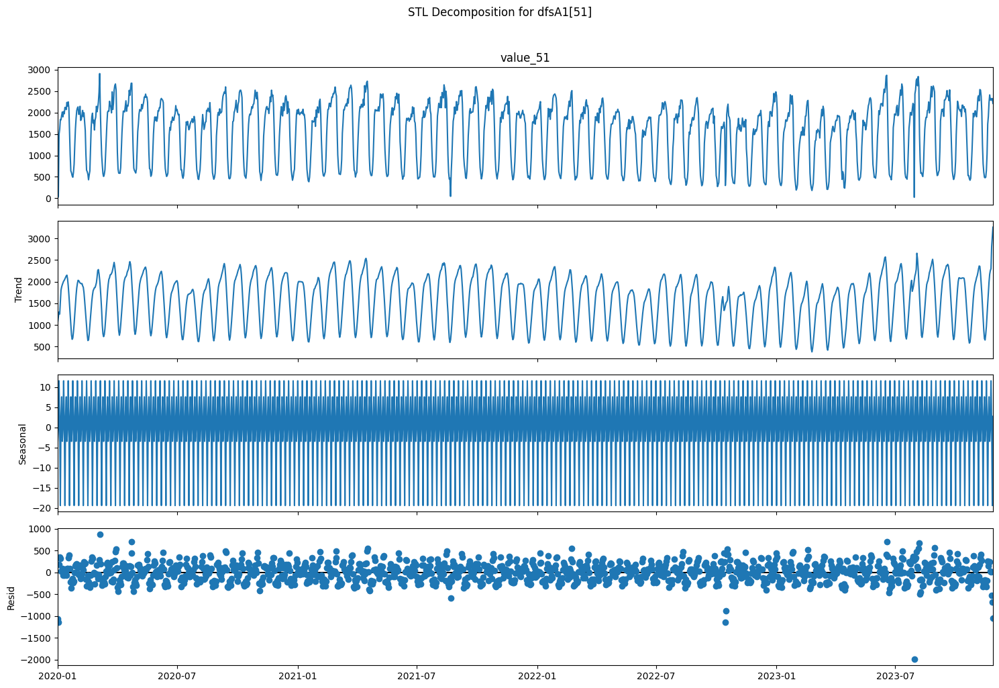

ADF Statistic: -1.234169
p-value: 0.658727
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 2.075546604672613
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  23.866666666666664


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


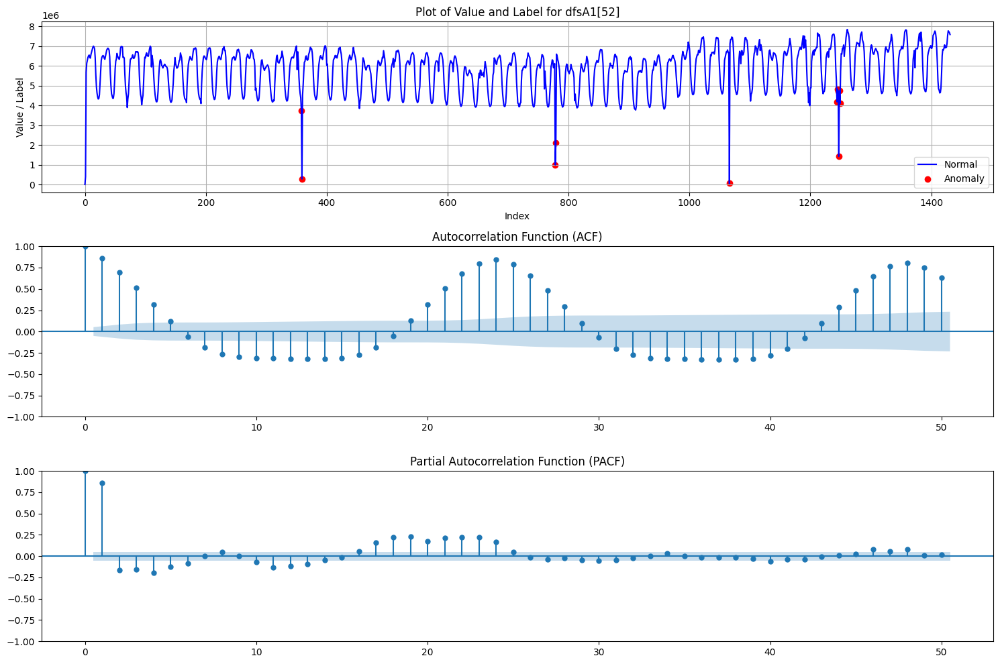

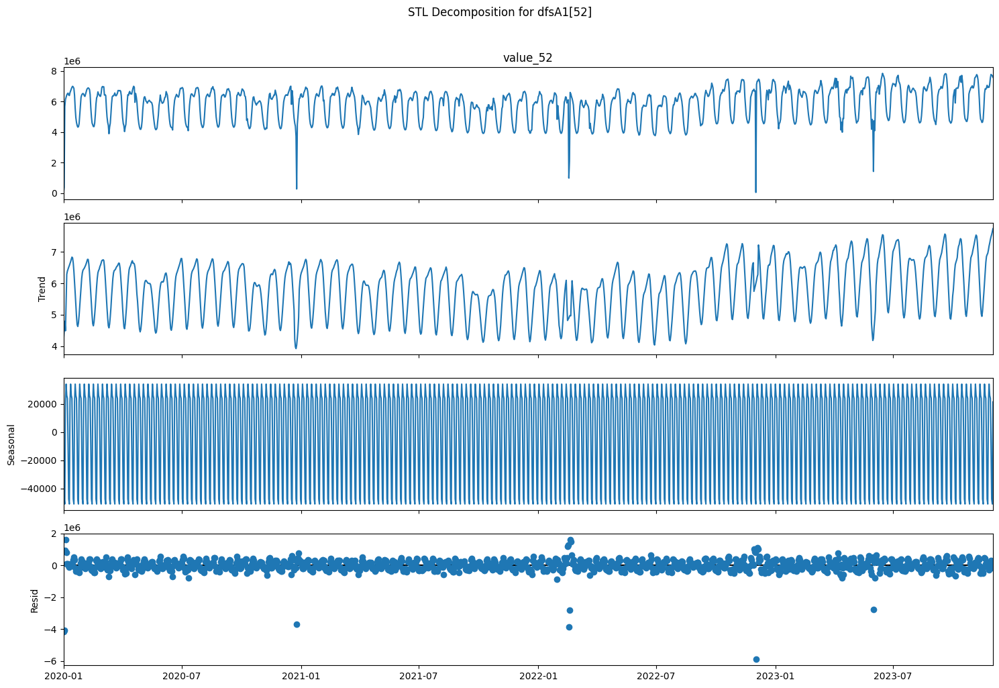

ADF Statistic: 3.955925
p-value: 1.000000
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 1.4794980905011386
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  23.95081967213115


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


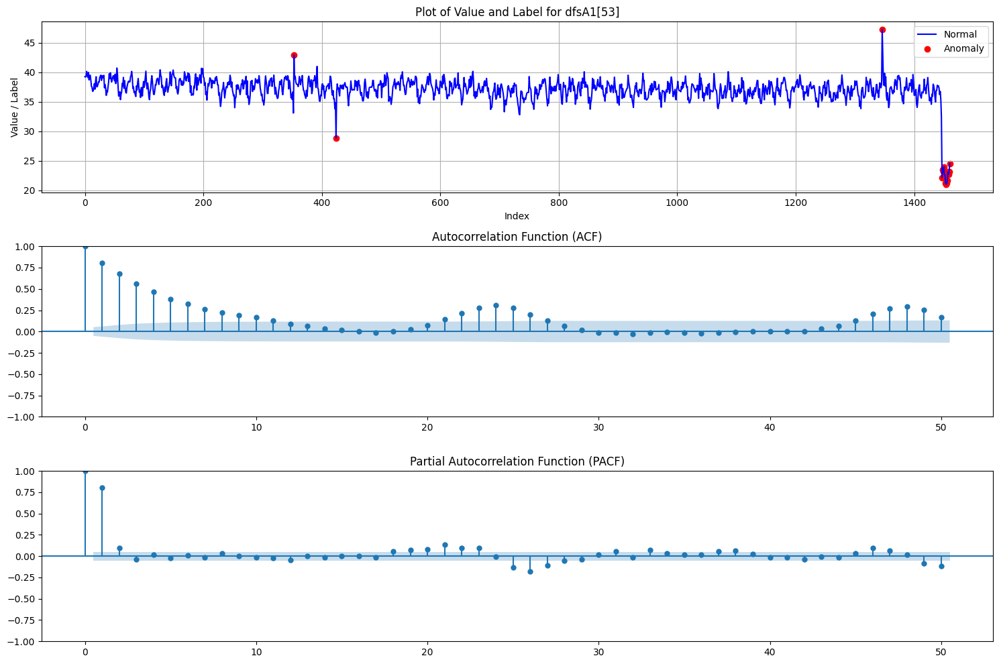

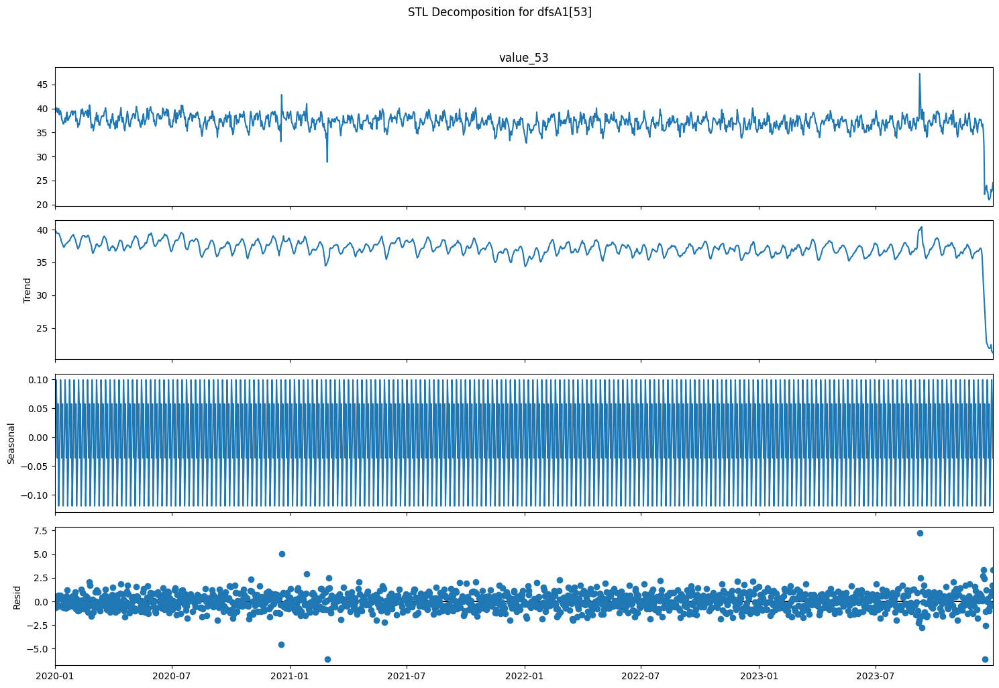

ADF Statistic: -3.600495
p-value: 0.005752
Critical Values:
	1%: -3.439
	5%: -2.866
	10%: -2.569
Stationary
KPSS Statistic: 0.06298729174945536
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  23.903225806451612


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


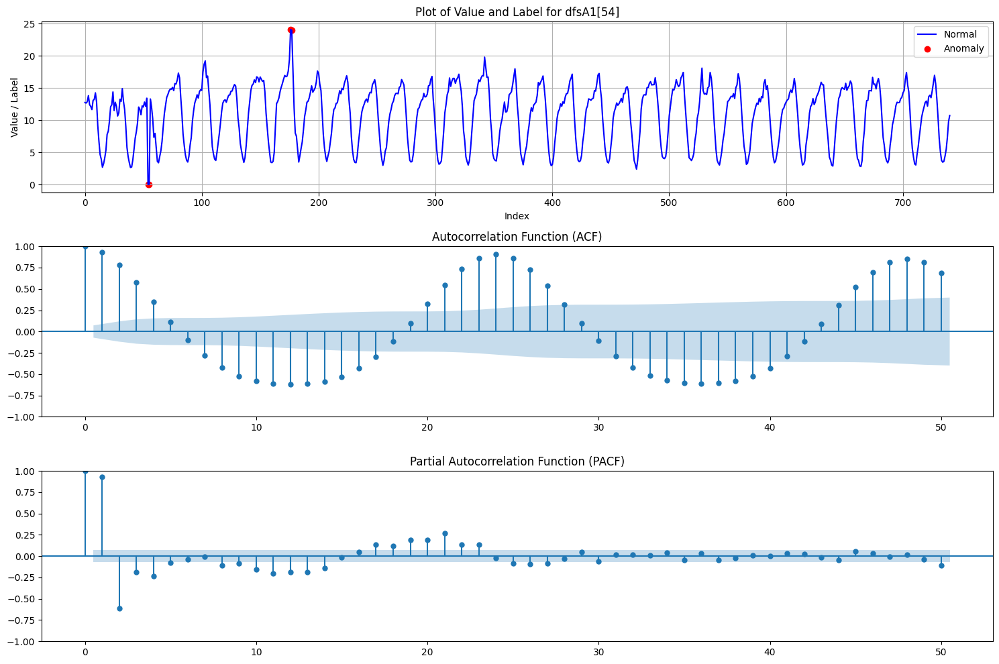

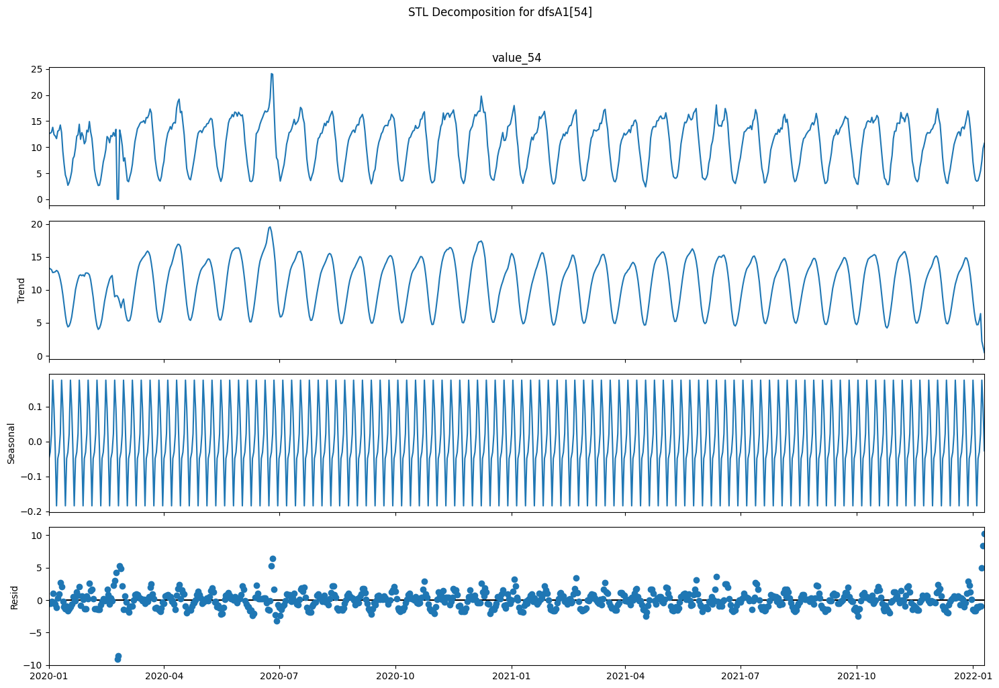

ADF Statistic: -1.288862
p-value: 0.634252
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 4.5842835705225795
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1427.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


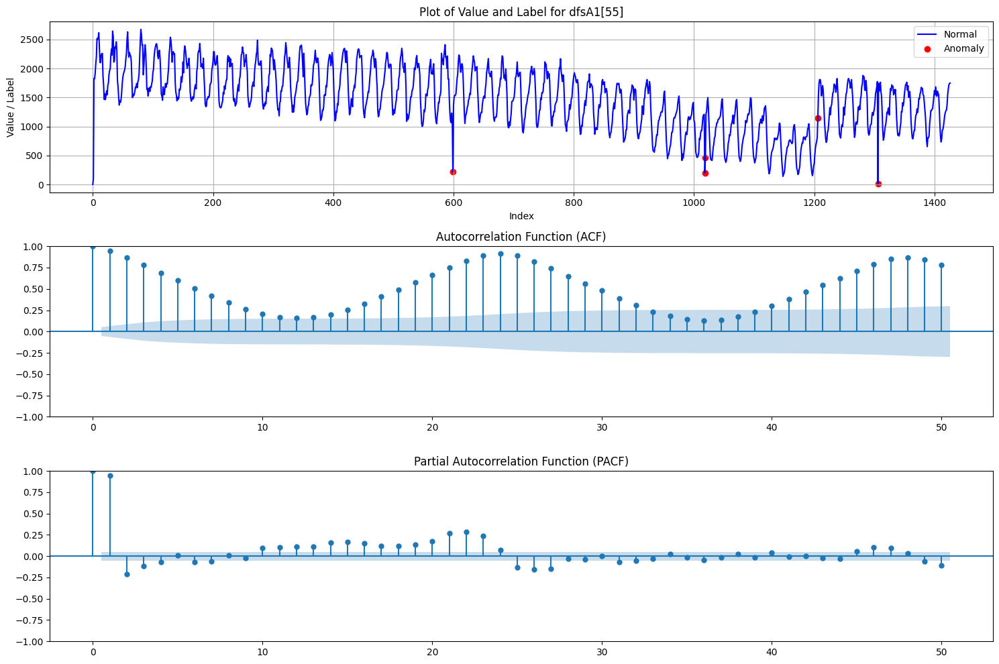

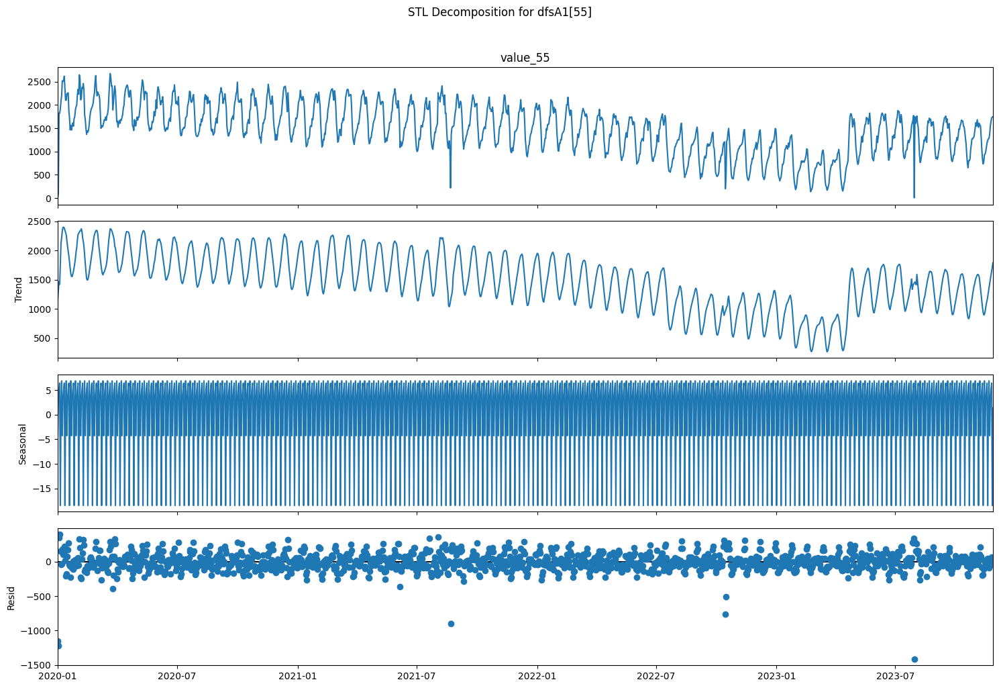

ADF Statistic: -1.693209
p-value: 0.434615
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 2.169275606484963
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1427.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


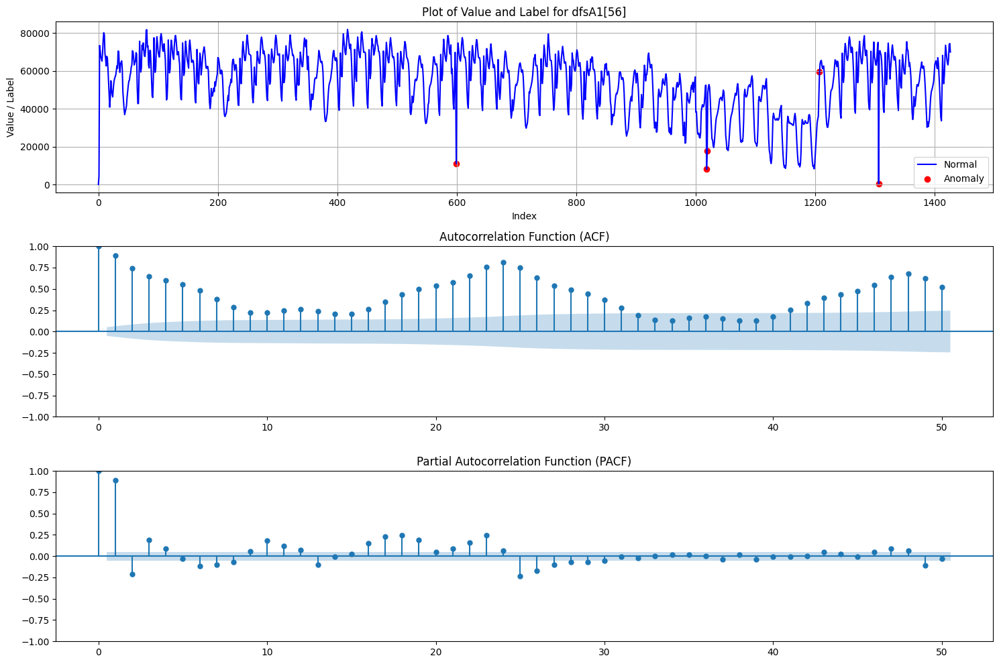

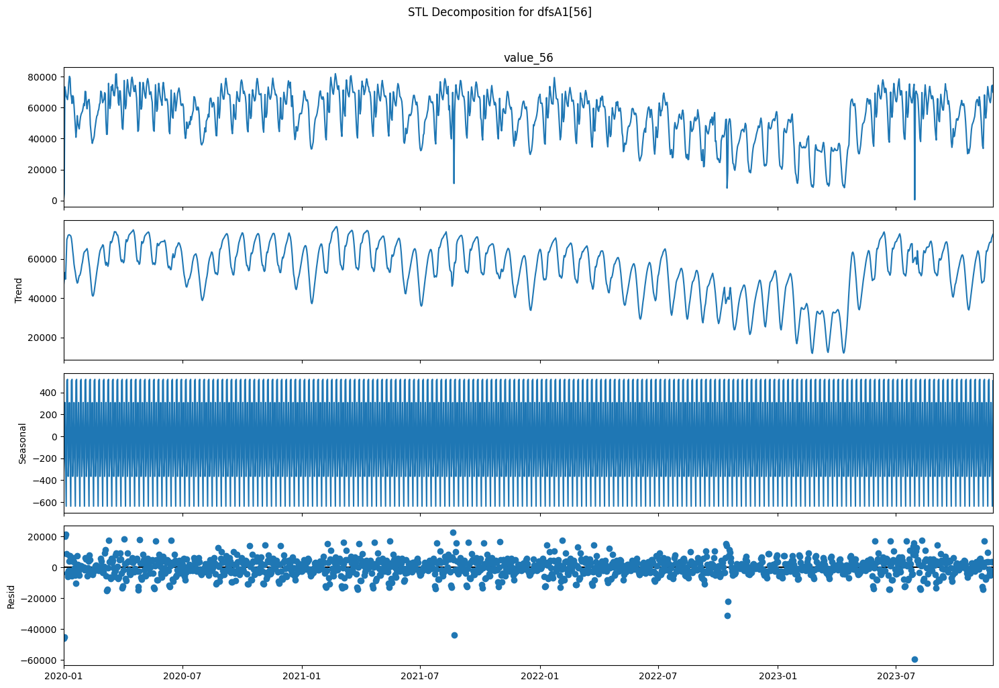

ADF Statistic: -0.716974
p-value: 0.842304
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 4.464397860188151
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1441.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


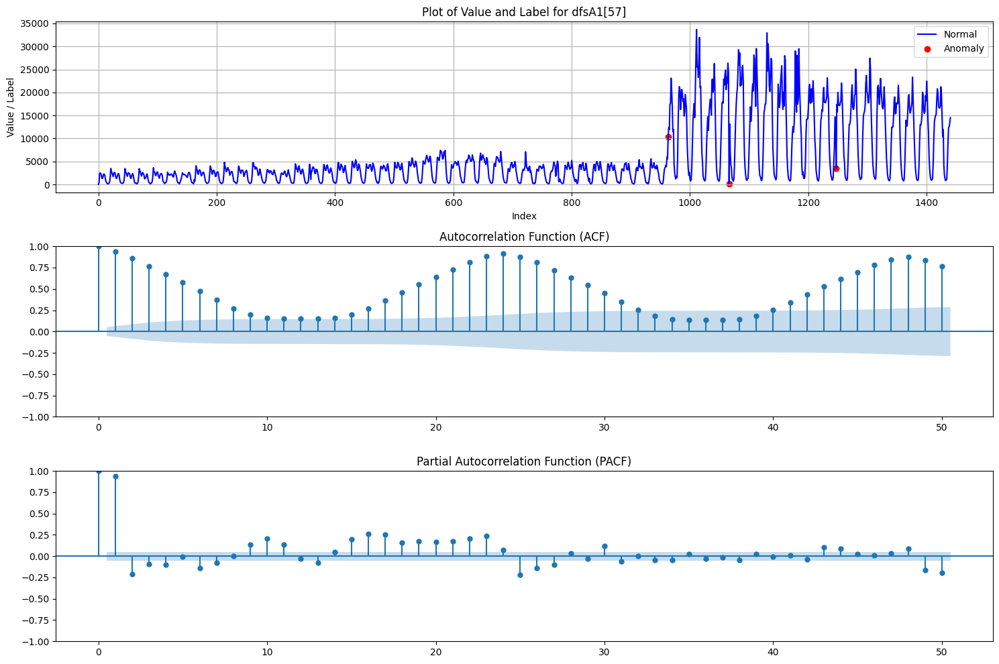

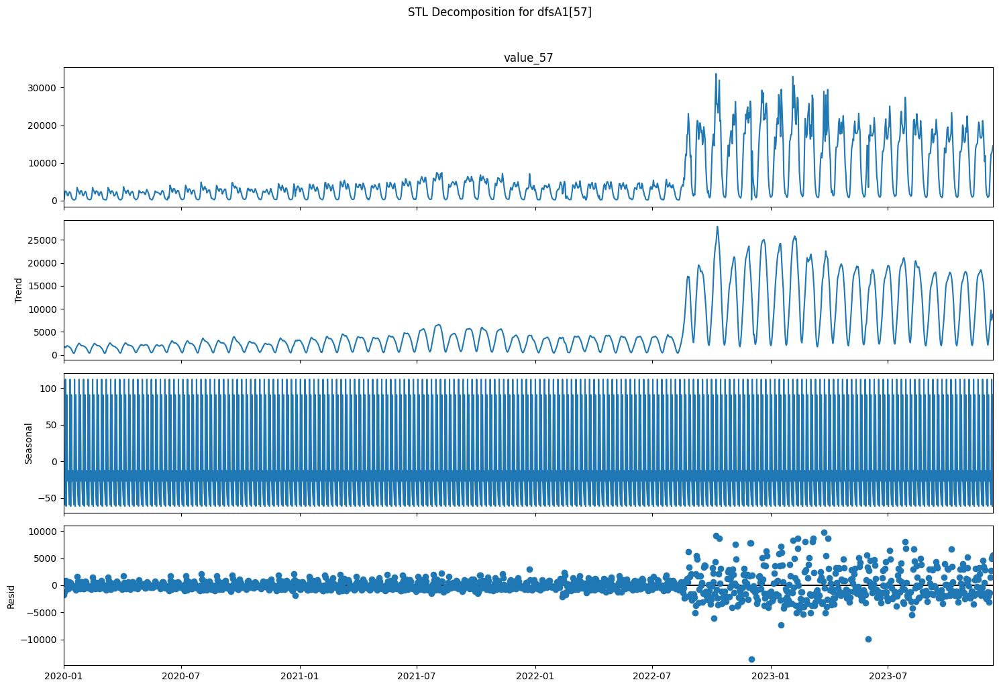

ADF Statistic: -0.547760
p-value: 0.882355
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 0.6170880759760288
p-value: 0.02108290218399738
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1435.0


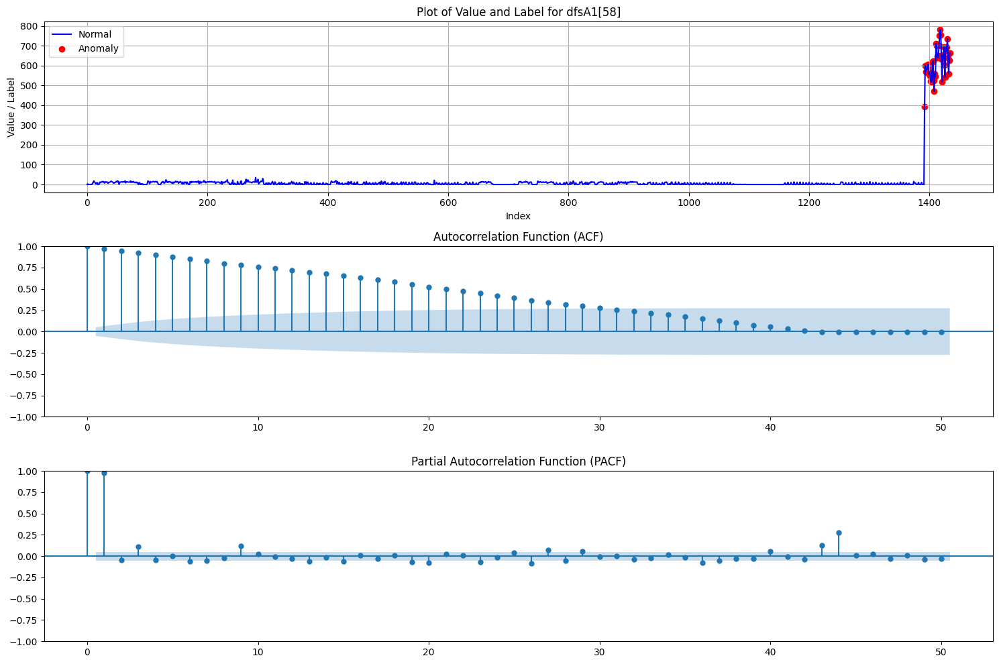

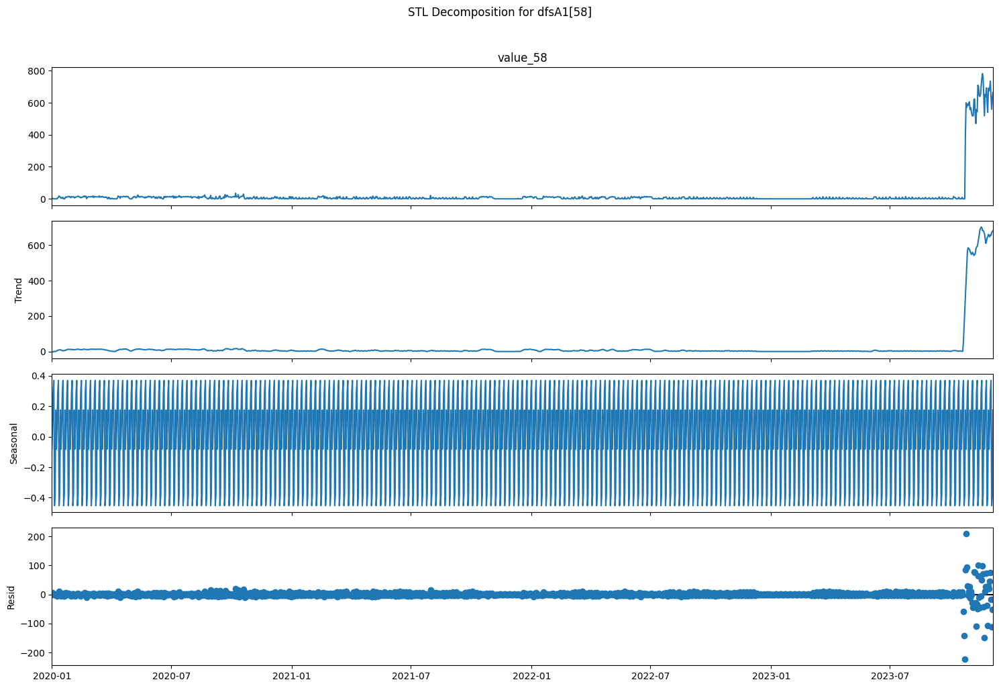

ADF Statistic: -23.195933
p-value: 0.000000
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.21380123156440345
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  7.9943820224719095


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


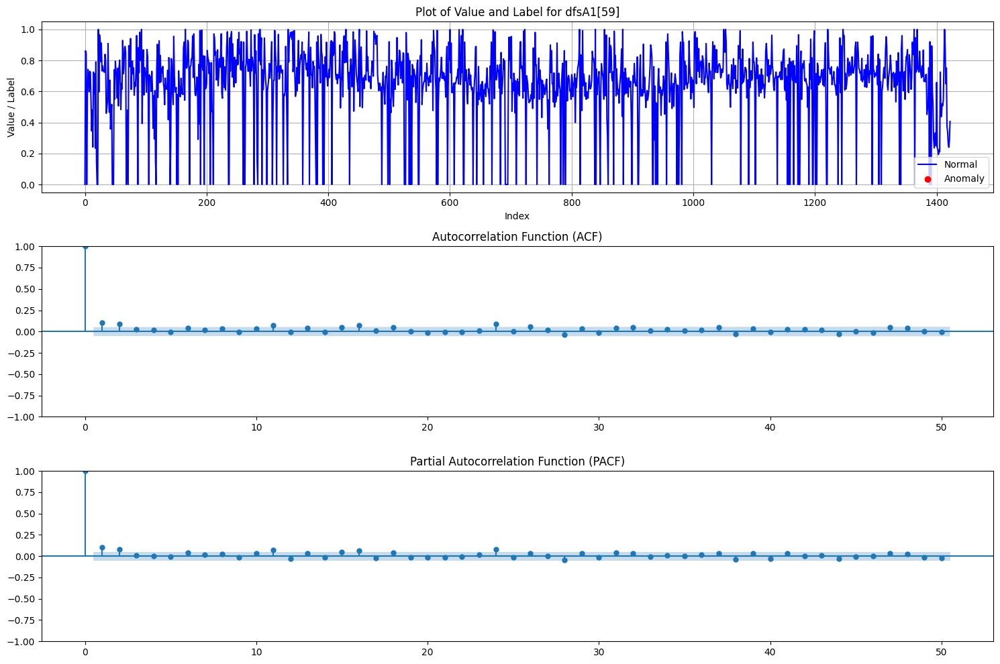

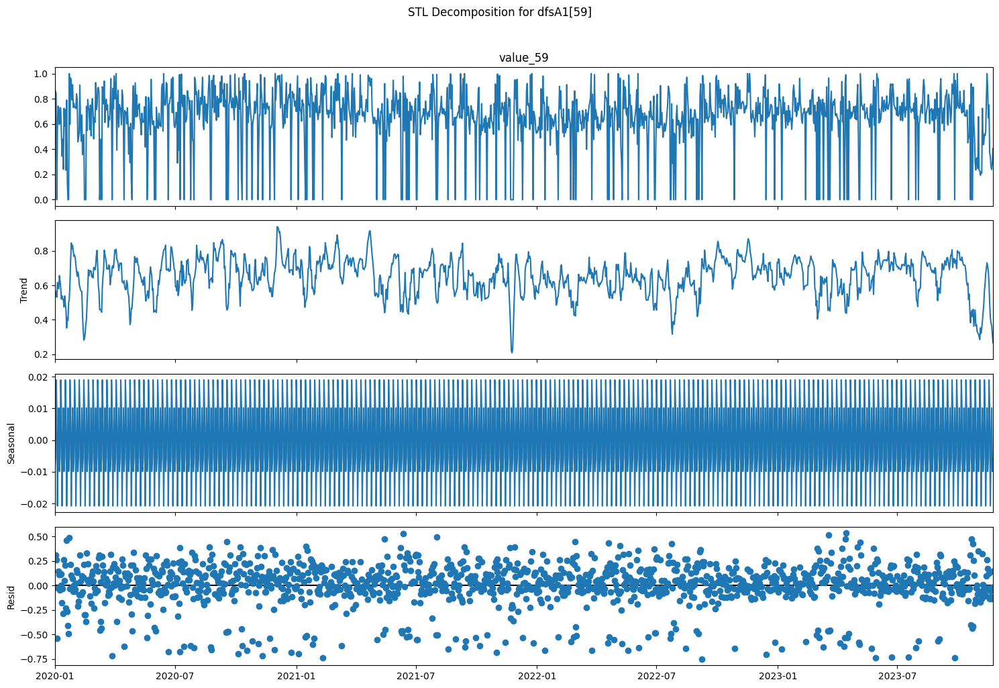

ADF Statistic: -14.284308
p-value: 0.000000
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.3255022165393584
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  23.95081967213115


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


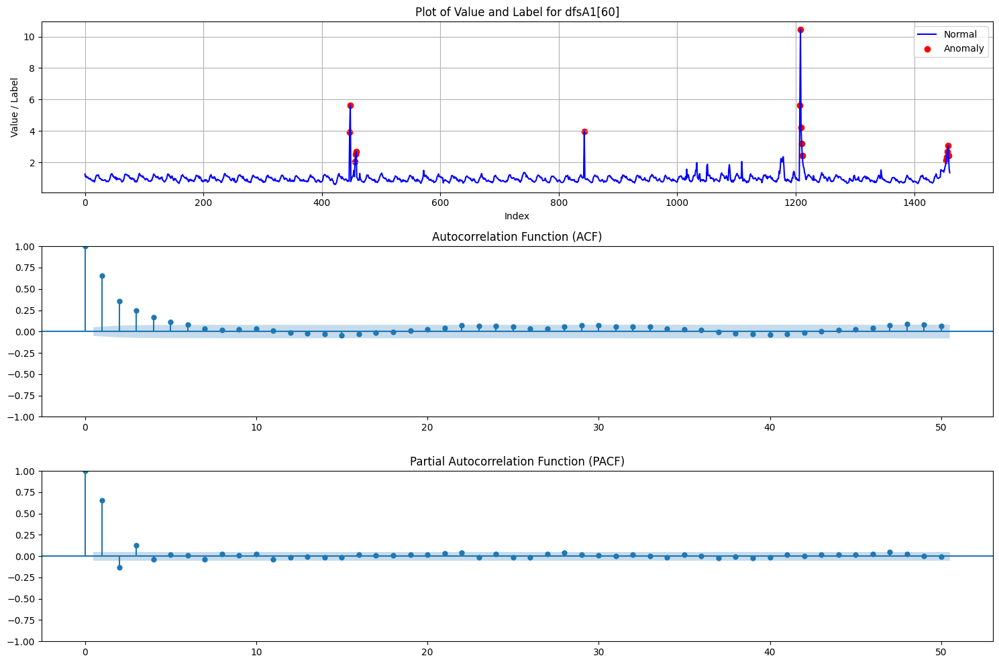

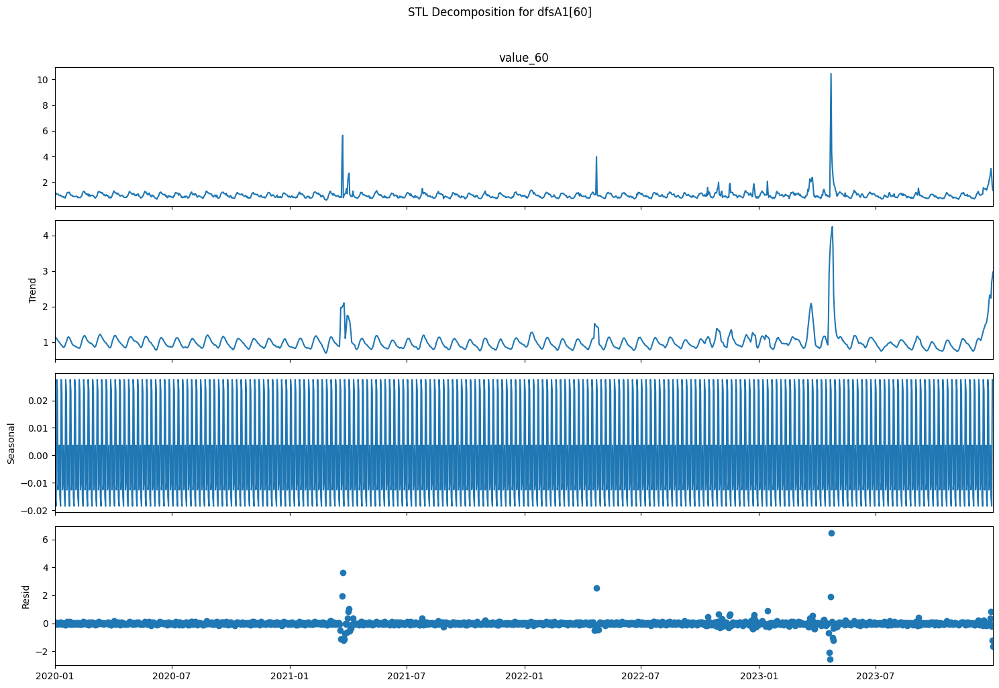

ADF Statistic: -1.897810
p-value: 0.333092
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 3.9517751814238933
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1441.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


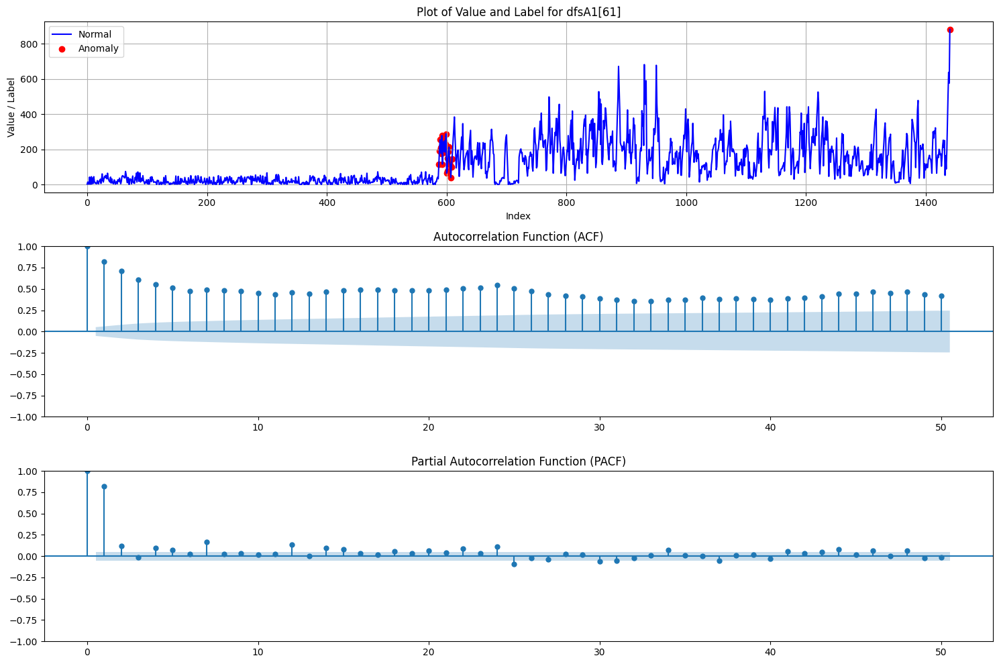

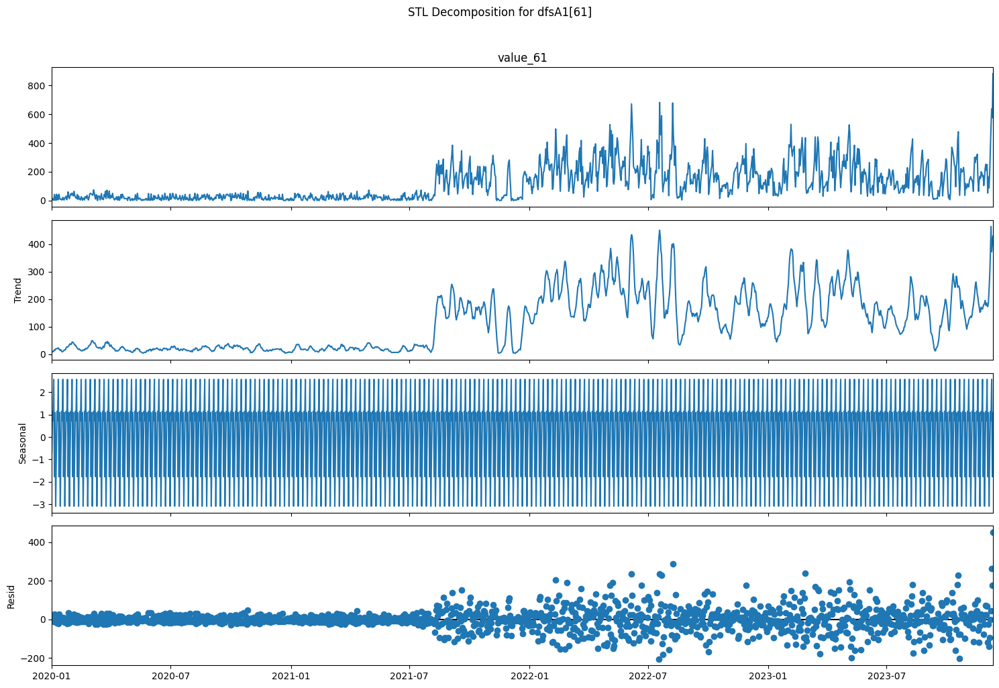

ADF Statistic: -1.314300
p-value: 0.622605
Critical Values:
	1%: -3.439
	5%: -2.866
	10%: -2.569
Non-stationary
KPSS Statistic: 0.26146211536812314
p-value: 0.1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  370.5


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


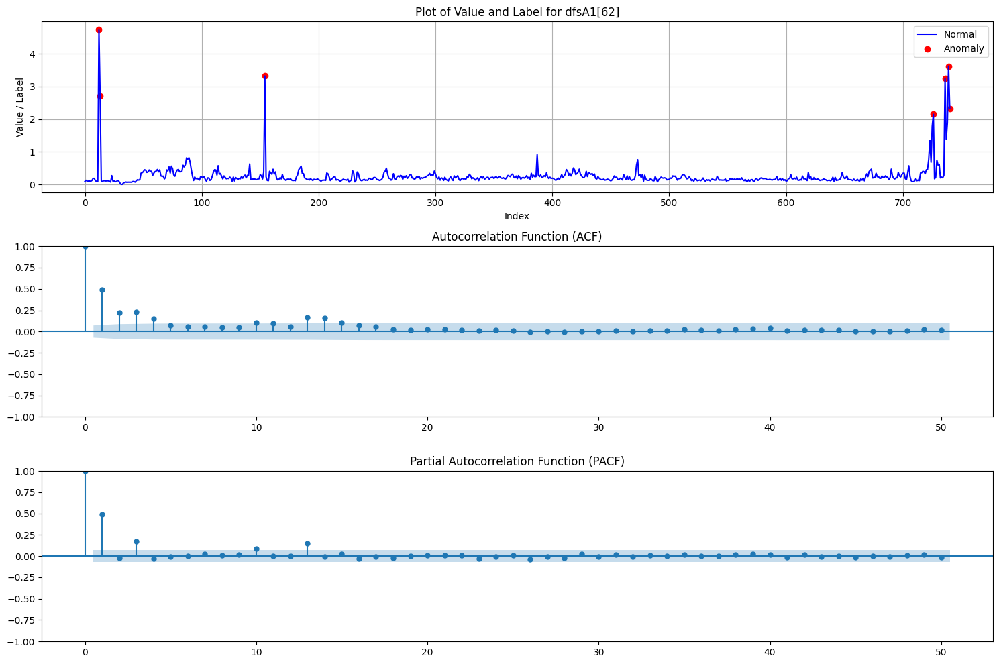

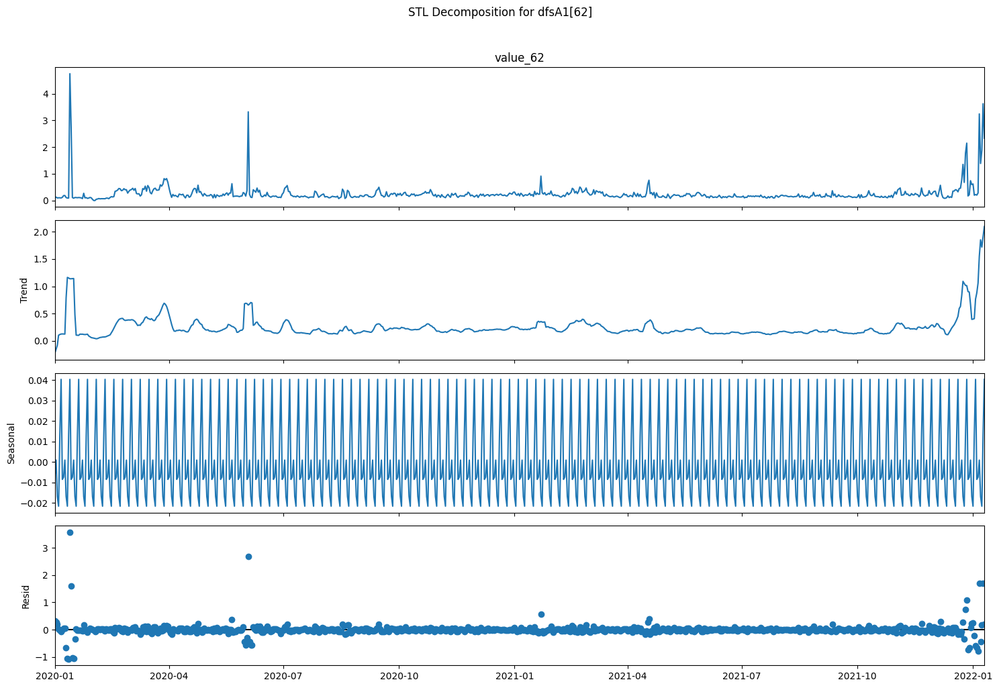

ADF Statistic: -3.402272
p-value: 0.010882
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.3910950470069891
p-value: 0.08099351422112538
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Non-stationary
The most frequent period is  719.5


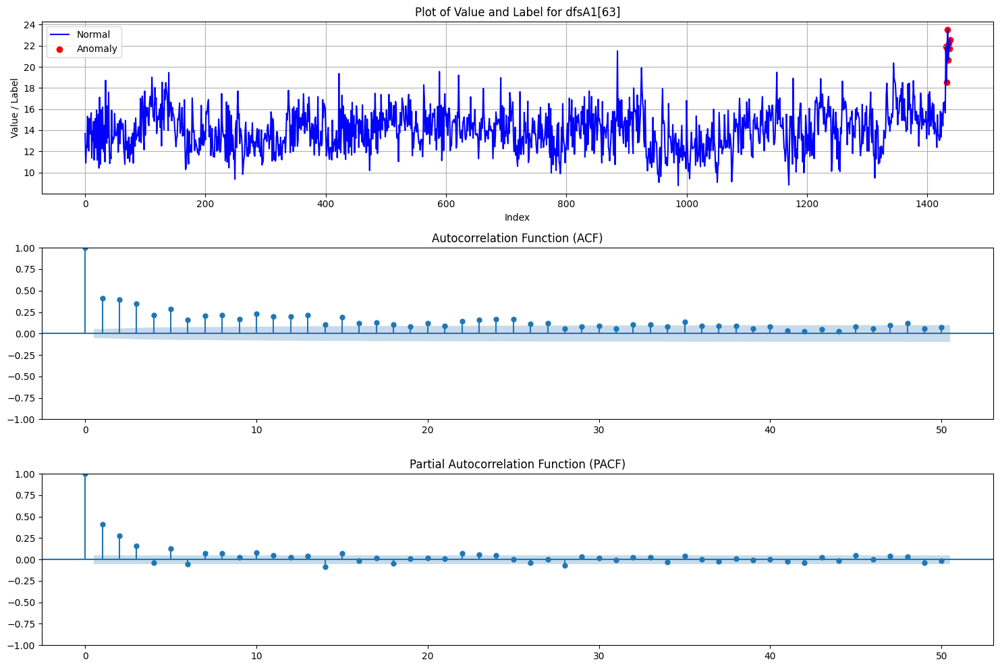

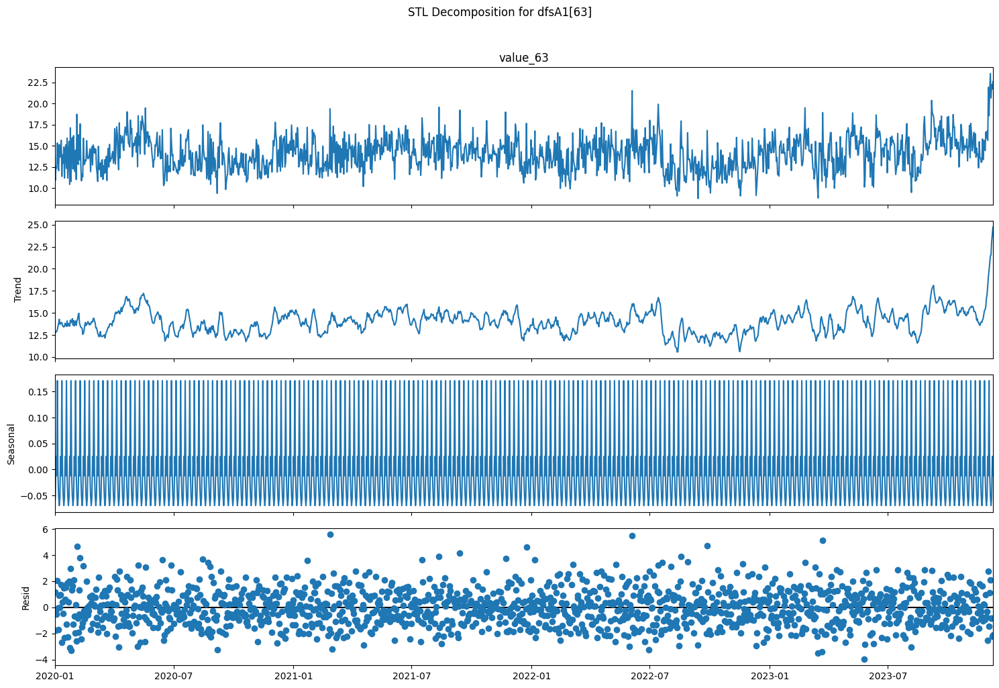

ADF Statistic: -3.916419
p-value: 0.001917
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 0.7675823642499819
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  24.01666666666667


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


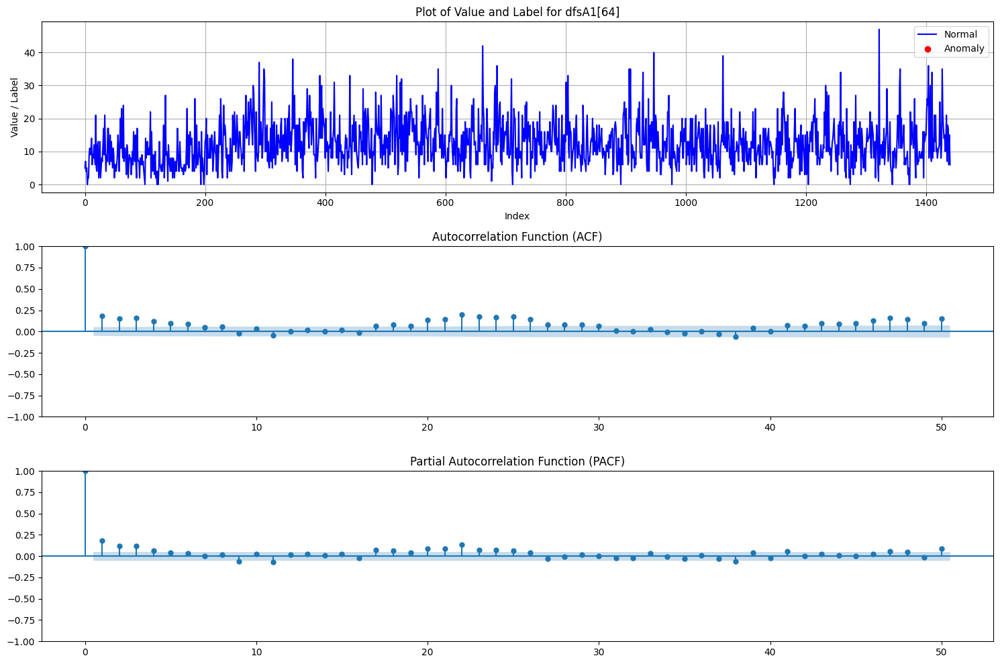

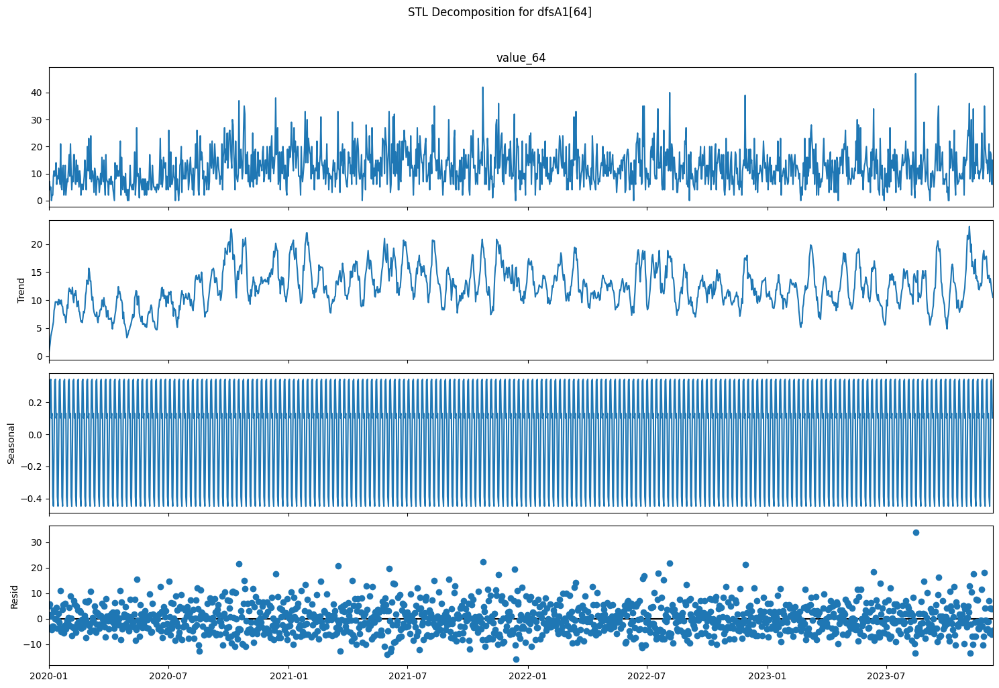

ADF Statistic: -1.284405
p-value: 0.636277
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 4.123212920148748
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1424.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


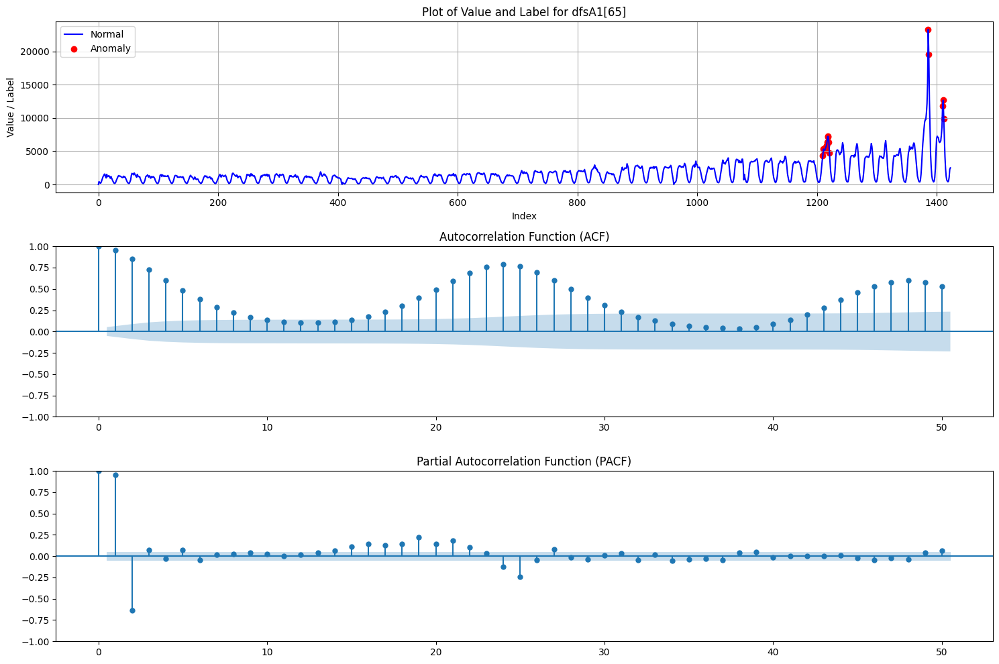

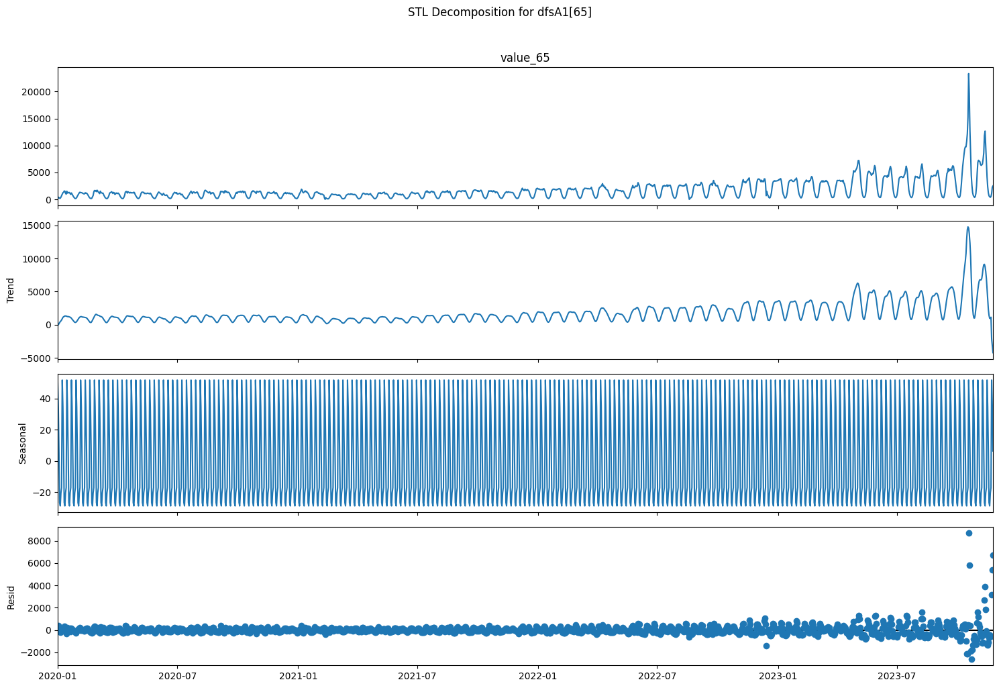

ADF Statistic: -3.177877
p-value: 0.021302
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Stationary
KPSS Statistic: 1.0685392661364792
p-value: 0.01
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1424.0


<ipython-input-5-b65af3c60d52>:4: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  statistic, p_value, n_lags, critical_values = kpss(data, **kw, regression='c')


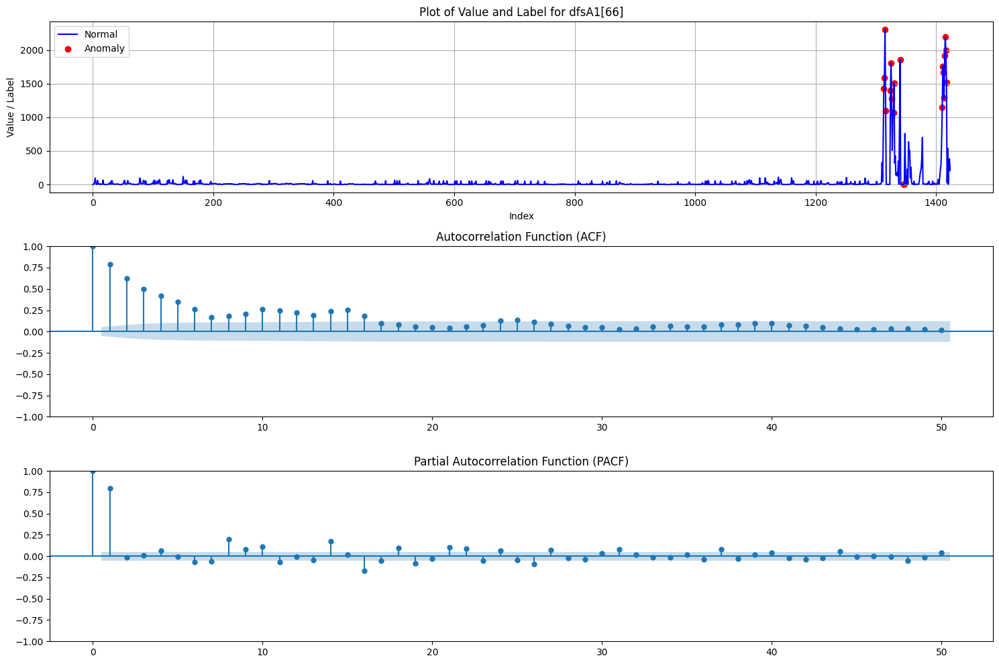

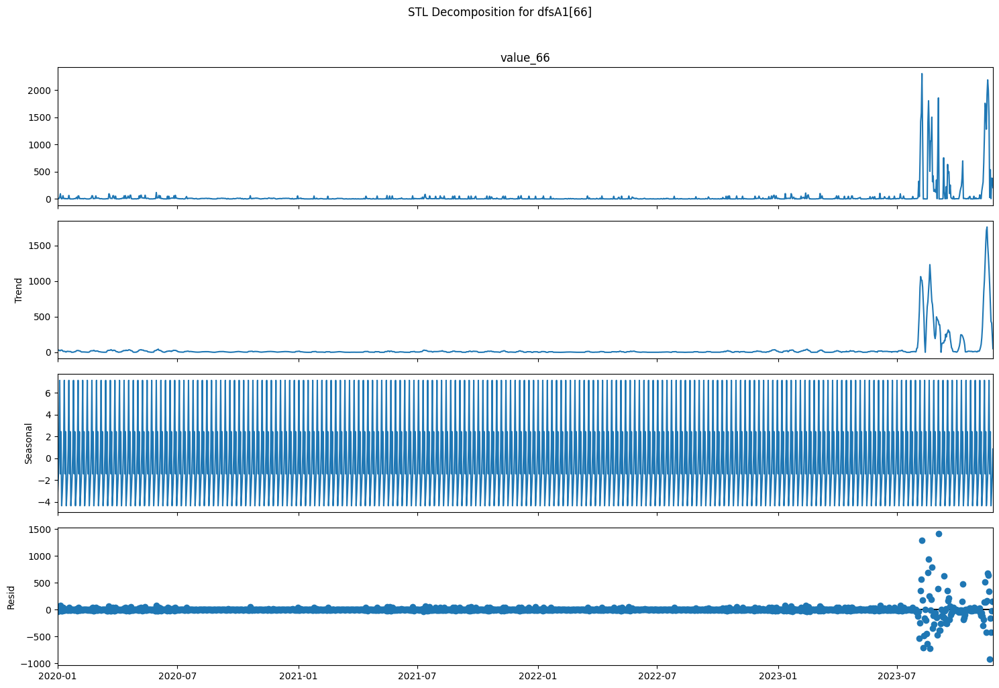

ADF Statistic: 3.243619
p-value: 1.000000
Critical Values:
	1%: -3.435
	5%: -2.864
	10%: -2.568
Non-stationary
KPSS Statistic: 0.6684306301693801
p-value: 0.01641539725732908
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Stationary
The most frequent period is  1423.0


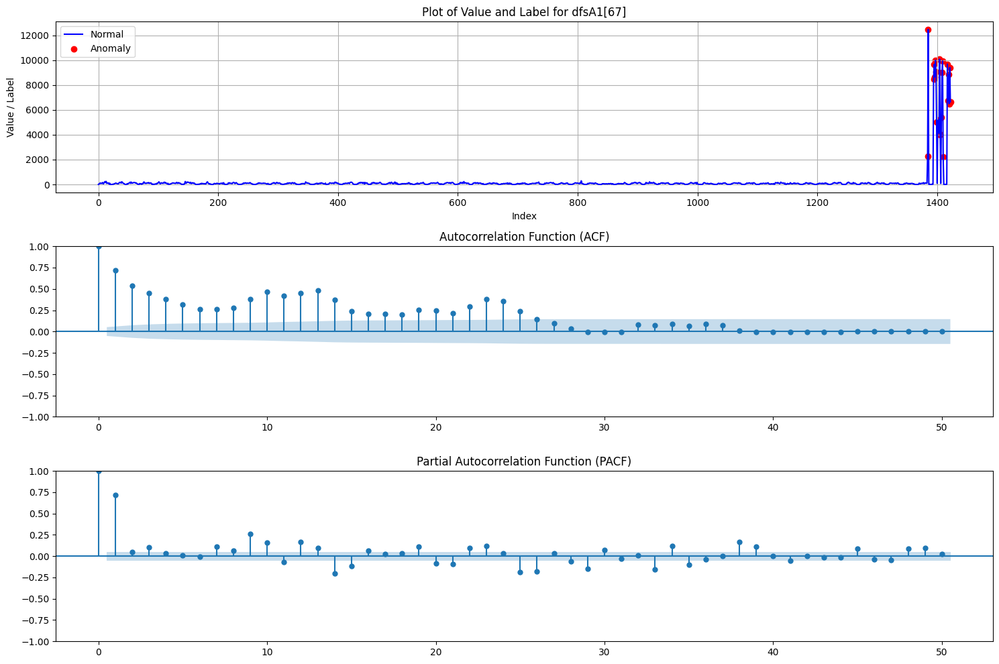

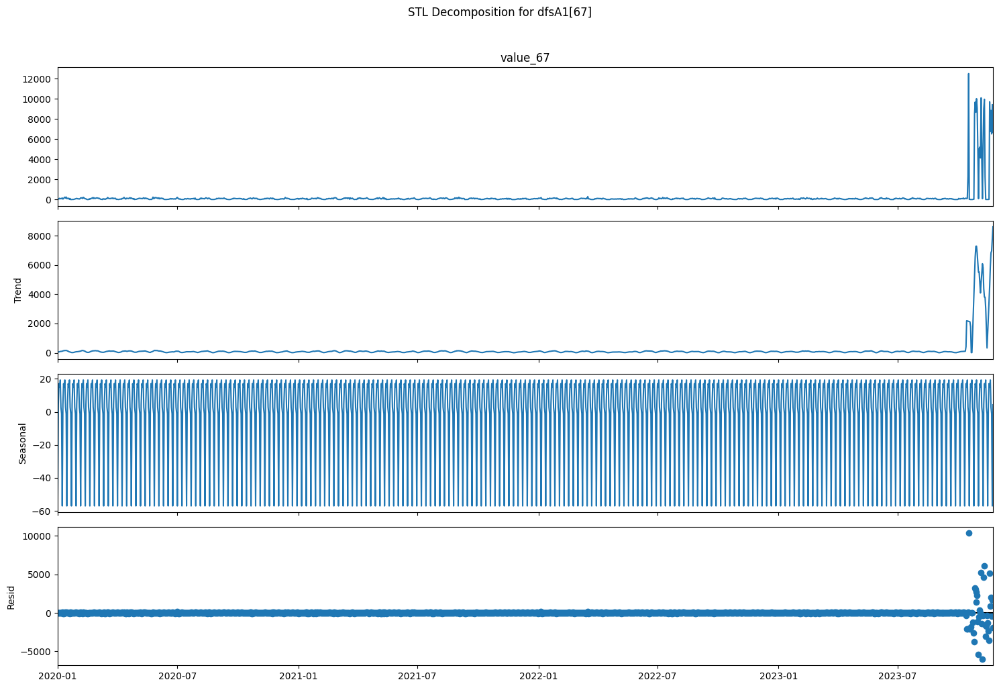

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
from statsmodels.tsa.stattools import adfuller, kpss
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from scipy.signal import periodogram
import numpy as np

# Create a dictionary to hold all DataFrames
dfsA1 = {}

# Loop through the range 1 to 67 (inclusive) and load data
for i in range(1, 68):
    file_path = f"/content/drive/My Drive/YAHOO/A1/Yahoo_A1real_{i}_data.out"
    dfsA1[i] = pd.read_csv(file_path, sep=",", names=[f"value_{i}", "label"])

# Loop through each DataFrame and plot
for i in range(1, 68):
    fig, axes = plt.subplots(3, 1, figsize=(15, 10))  # Create a figure with 3 subplots

    # Extract data
    normal_data = dfsA1[i]
    values = normal_data[f"value_{i}"]
    anomaly_data = normal_data[normal_data['label'] == 1]


    # Perform stationarity checks and print results
    try:
        check_stationarity(values)
        kpss_test(values.values)
    except Exception as e:
        print(f"Stationarity checks failed for dfsA1[{i}]: {e}")


    # Plot the time series on the first axis
    axes[0].plot(normal_data.index, values, label='Normal', color='blue')
    axes[0].scatter(anomaly_data.index, anomaly_data[f'value_{i}'], label='Anomaly', color='red')
    axes[0].set_title(f'Plot of Value and Label for dfsA1[{i}]')
    axes[0].set_xlabel('Index')
    axes[0].set_ylabel('Value / Label')
    axes[0].legend()
    axes[0].grid(True)

    # Plot ACF on the second axis
    plot_acf(values, lags=50, ax=axes[1])  # Adjust the number of lags as needed
    axes[1].set_title('Autocorrelation Function (ACF)')

    # Plot PACF on the third axis
    plot_pacf(values, lags=50, ax=axes[2])  # Adjust the number of lags as needed
    axes[2].set_title('Partial Autocorrelation Function (PACF)')

    # Calculate and plot the periodogram
    freq, power = periodogram(values)
    period = 1 / freq[np.argmax(power)] if np.any(freq > 0) else np.nan
    print("The most frequent period is ", period)

    # Adjust layout to fit everything nicely
    plt.tight_layout()
    plt.show()

    # Define a start date and create a date range
    start_date = "2020-01-01"  # Adjust this to the desired starting date
    date_range = pd.date_range(start=start_date, periods=len(values), freq="D")

    # Add the Date column to your DataFrame and set it as the index
    normal_data["Date"] = date_range
    values_with_date_index = values.copy()
    values_with_date_index.index = normal_data["Date"]

    # Perform STL decomposition and plot it with a bigger size
    try:
        stl_dfsA1 = seasonal_decompose(values_with_date_index, model="additive", extrapolate_trend="freq")
        fig_stl = stl_dfsA1.plot()  # Plot STL decomposition
        fig_stl.set_size_inches(15, 10)  # Set the figure size
        plt.suptitle(f'STL Decomposition for dfsA1[{i}]', y=1.02)
        plt.tight_layout()
        plt.show()
    except Exception as e:
        print(f"STL decomposition failed for dfsA1[{i}]: {e}")



In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
from scipy.signal import periodogram
import numpy as np

# Create a dictionary to hold all DataFrames
dfsA1 = {}

# Load data
for i in range(1, 68):
    file_path = f"/content/drive/My Drive/YAHOO/A1/Yahoo_A1real_{i}_data.out"
    dfsA1[i] = pd.read_csv(file_path, sep=",", names=[f"value_{i}", "label"])



Series 1: Dominant Period = 1420.0000


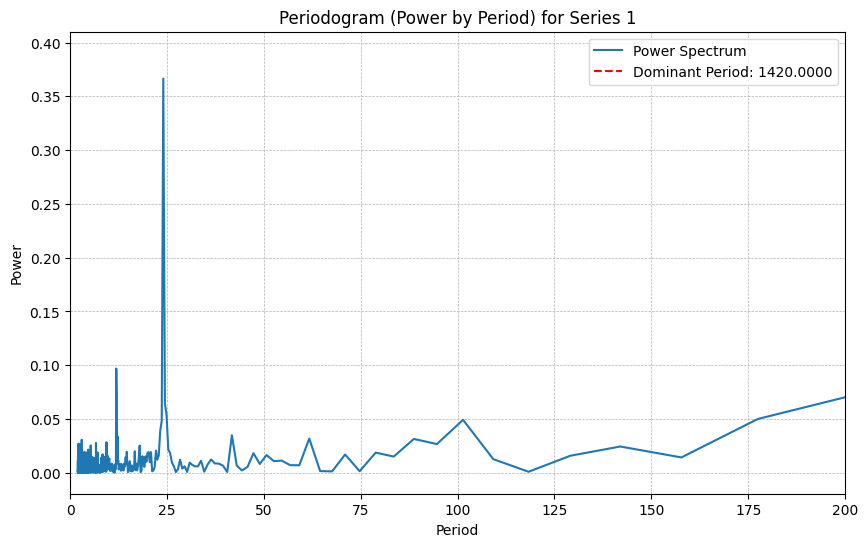

Series 2: Dominant Period = 1439.0000


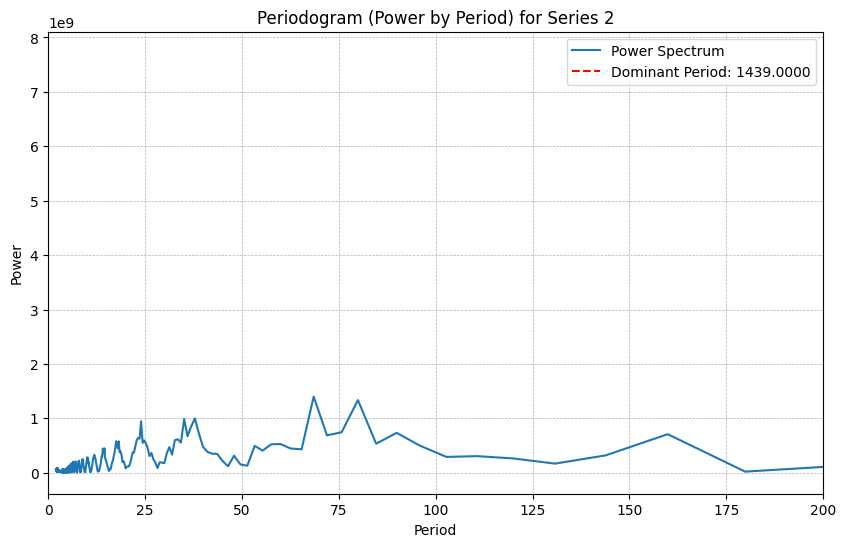

Series 3: Dominant Period = 23.9508


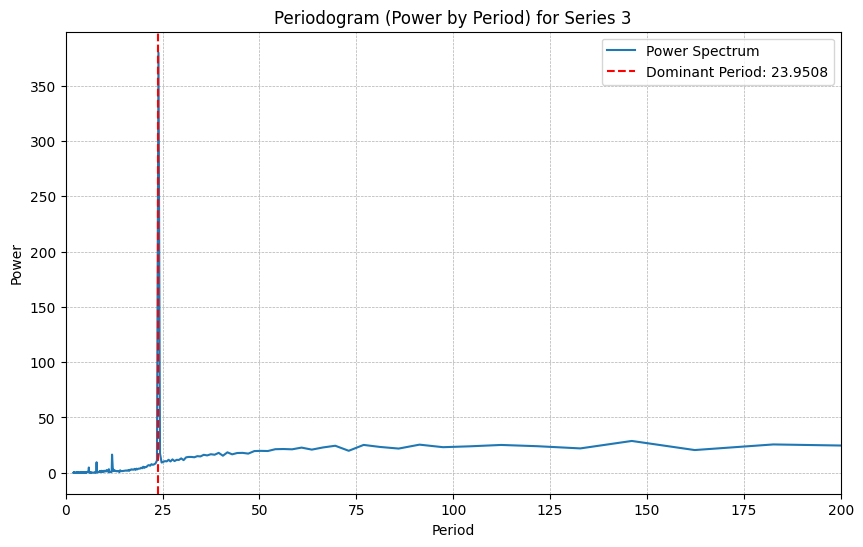

Series 8: Dominant Period = 47.3333


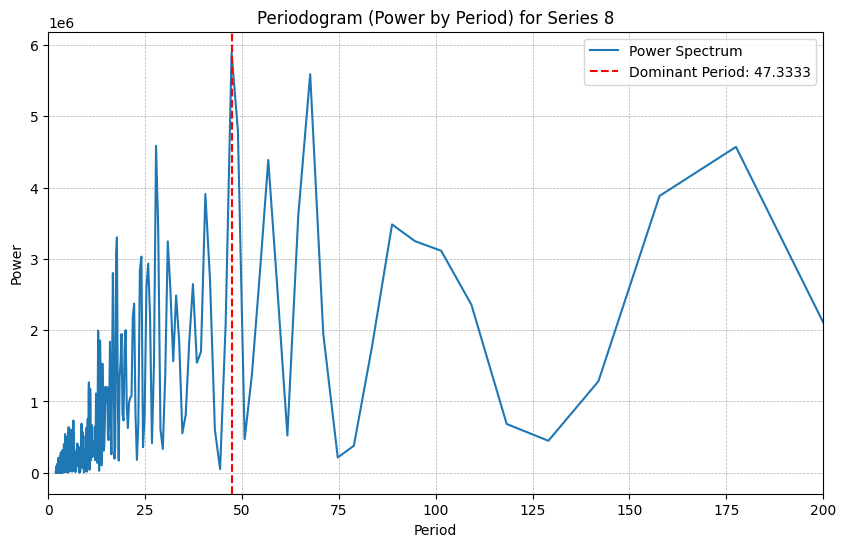

Series 9: Dominant Period = 23.9508


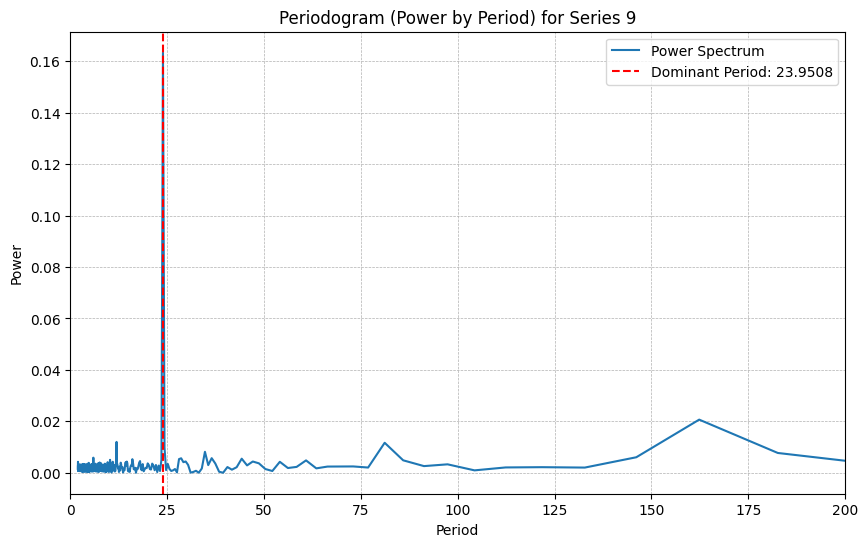

Series 10: Dominant Period = 23.5902


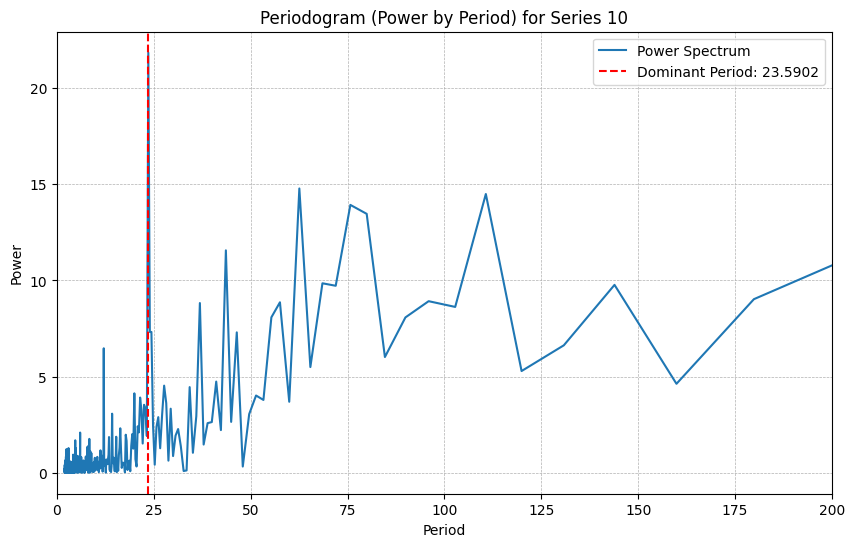

Series 13: Dominant Period = 23.9833


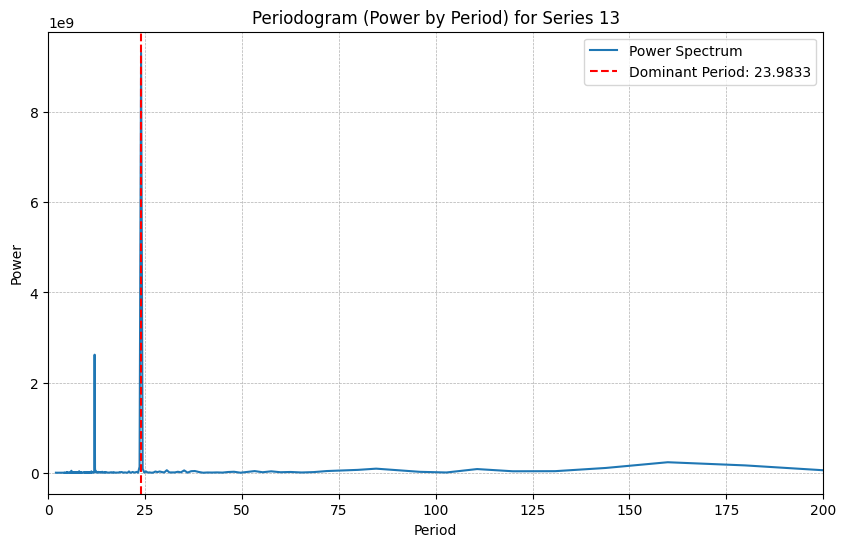

Series 23: Dominant Period = 355.0000


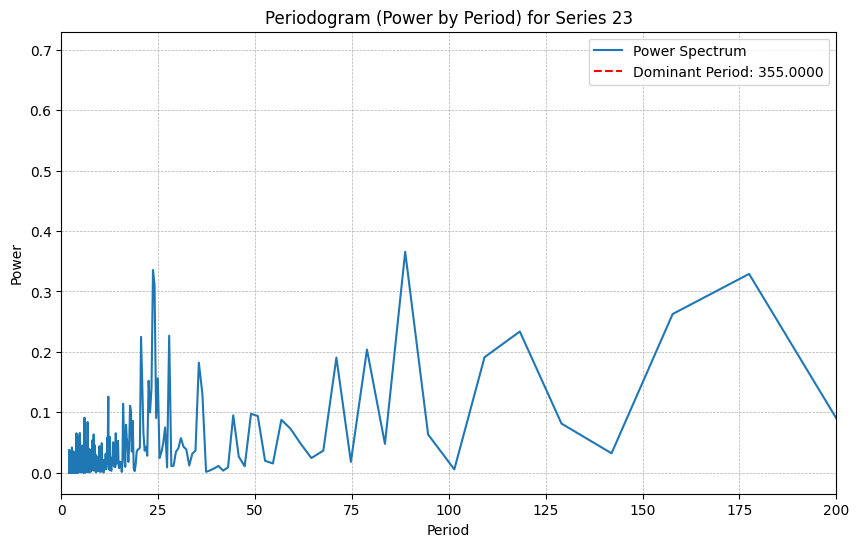

Series 24: Dominant Period = 23.9508


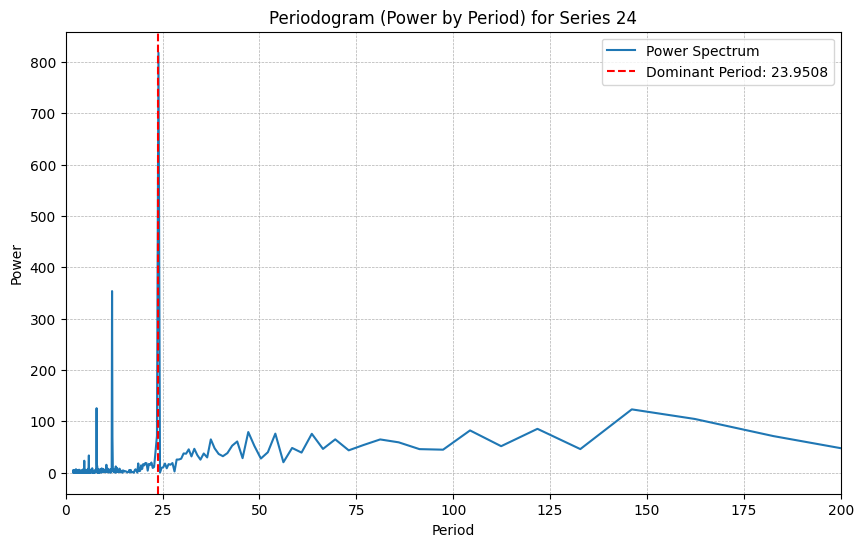

Series 27: Dominant Period = 24.1864


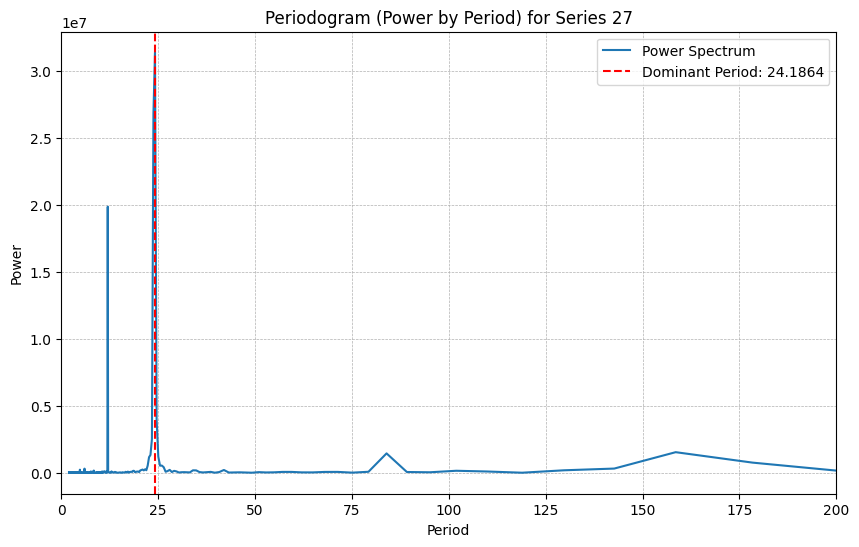

Series 34: Dominant Period = 24.1864


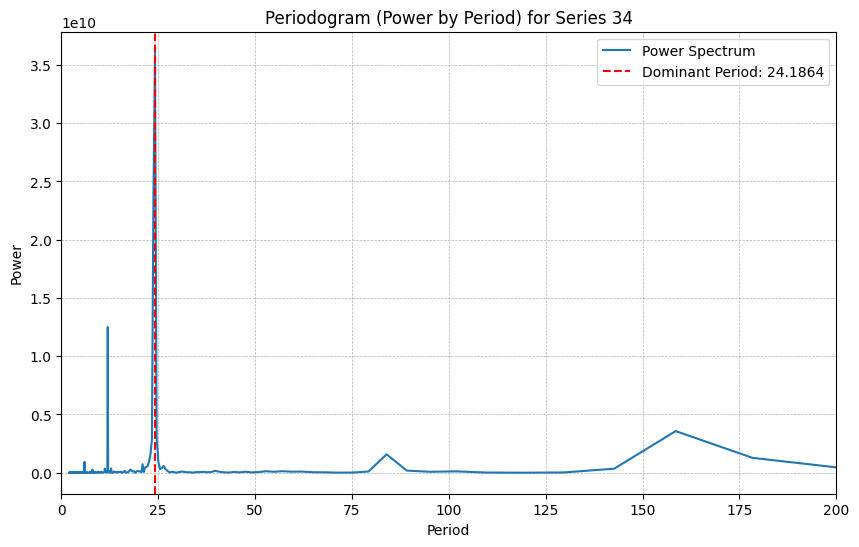

Series 41: Dominant Period = 1435.0000


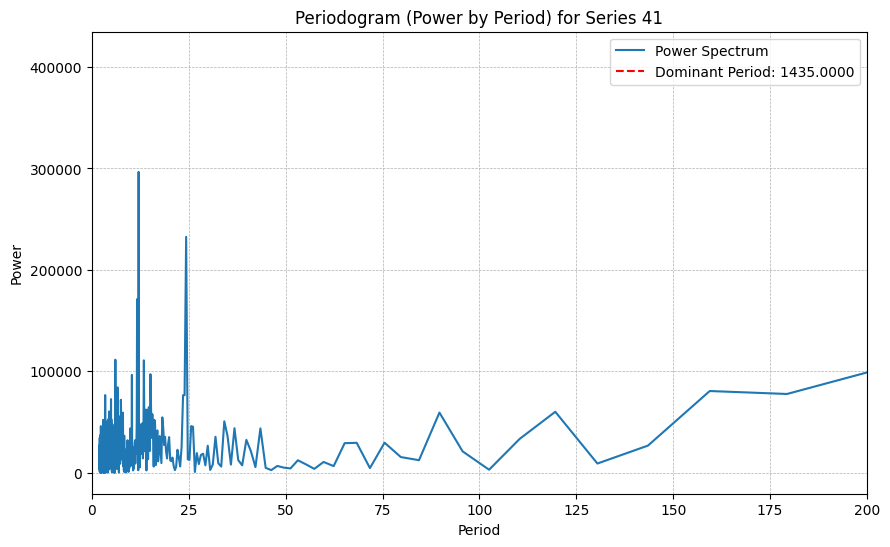

Series 66: Dominant Period = 1424.0000


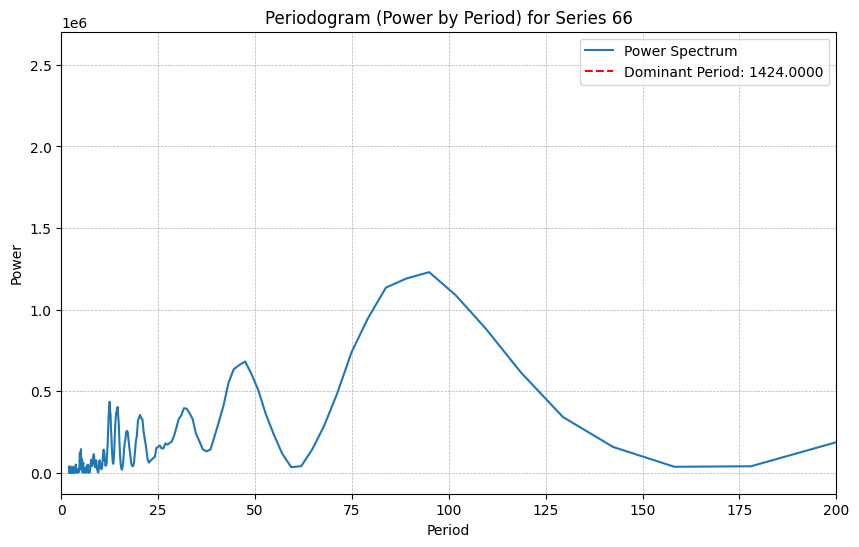

In [ ]:
A1A = [1,2,3,8,9,10,13,23,24,27,34,41,66]
# Loop through each DataFrame and plot periodograms
for i in A1A:
    # Extract data
    normal_data = dfsA1[i]
    values = normal_data[f"value_{i}"]

    # Calculate periodogram
    freq, power = periodogram(values)

    # Convert frequency to period (avoid division by zero)
    with np.errstate(divide='ignore', invalid='ignore'):  # Handle division warnings
        periods = np.where(freq > 0, 1 / freq, np.nan)  # Replace freq=0 with NaN

    # Identify dominant period
    if np.any(freq > 0):
        dominant_period = periods[np.argmax(power)]
        print(f"Series {i}: Dominant Period = {dominant_period:.4f}")
    else:
        dominant_period = np.nan
        print(f"Series {i}: No dominant period detected.")

    # Plot the periodogram (Power by Period)
    plt.figure(figsize=(10, 6))
    plt.plot(periods, power, label="Power Spectrum")
    if not np.isnan(dominant_period):
        plt.axvline(x=dominant_period, color='red', linestyle='--', label=f"Dominant Period: {dominant_period:.4f}")
    plt.title(f"Periodogram (Power by Period) for Series {i}")
    plt.xlabel("Period")
    plt.ylabel("Power")
    plt.xlim(0, 200)
    plt.legend()
    plt.grid(True, which="both", linestyle="--", linewidth=0.5)
    plt.show()


### Yahoo A1A - Long-term Stationarity with point anomalies

Stationarity checks failed for dfsA1[1]: name 'check_stationarity' is not defined
The most frequent period is  1420.0


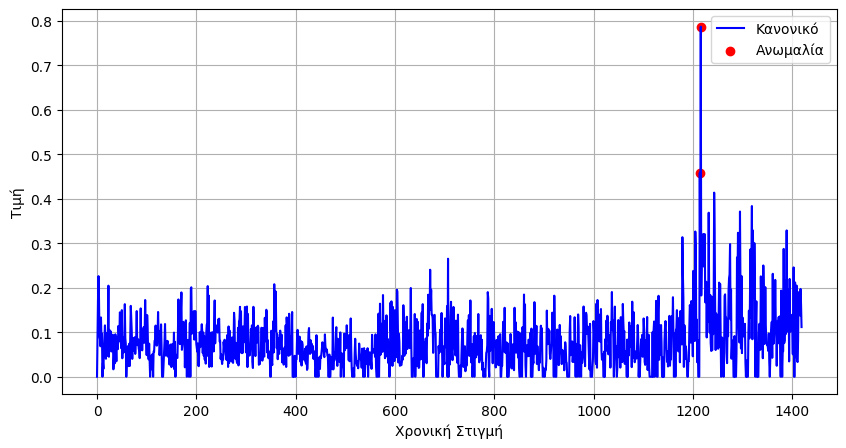

Stationarity checks failed for dfsA1[2]: name 'check_stationarity' is not defined
The most frequent period is  1439.0


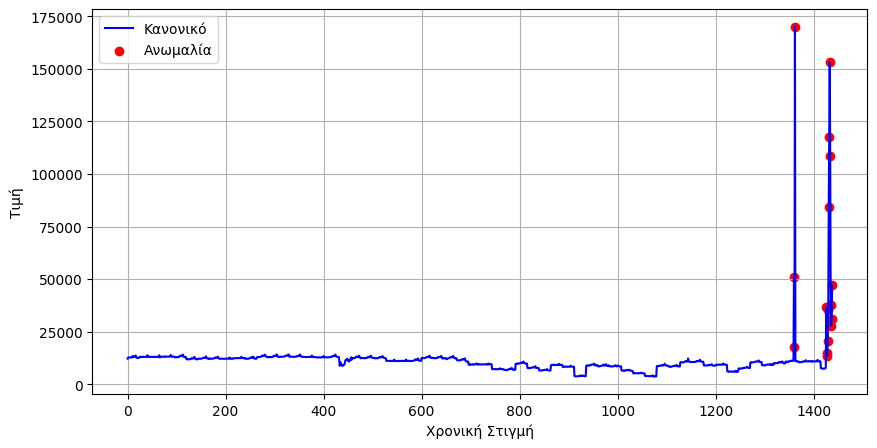

Stationarity checks failed for dfsA1[3]: name 'check_stationarity' is not defined
The most frequent period is  23.95081967213115


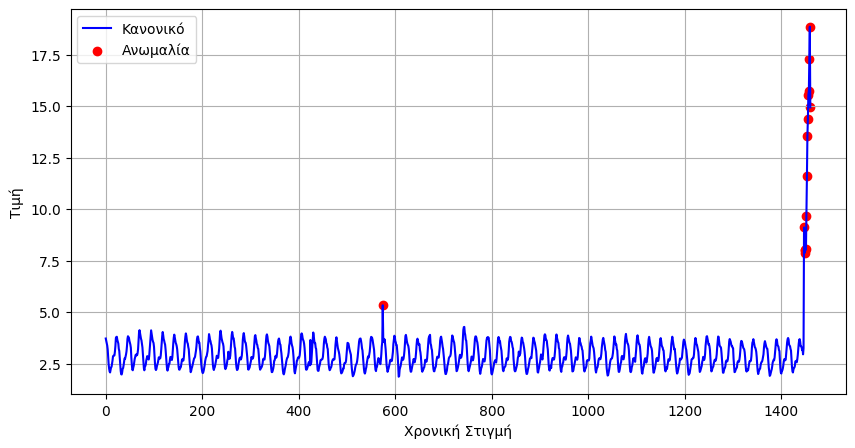

Stationarity checks failed for dfsA1[8]: name 'check_stationarity' is not defined
The most frequent period is  47.333333333333336


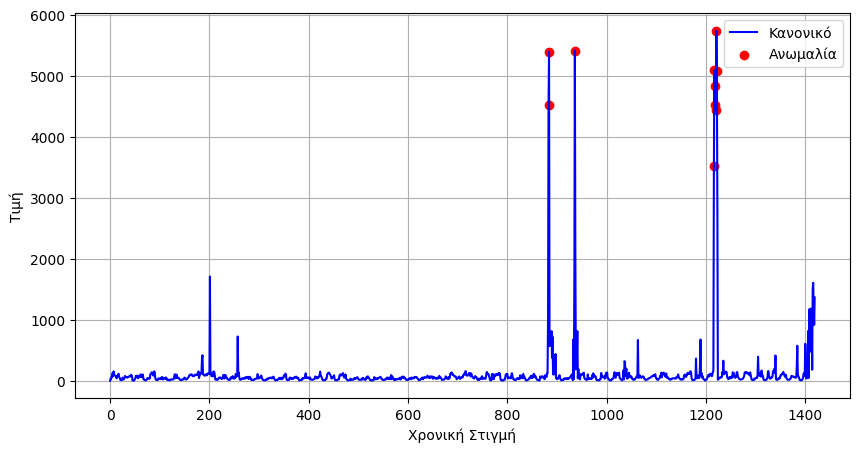

Stationarity checks failed for dfsA1[9]: name 'check_stationarity' is not defined
The most frequent period is  23.95081967213115


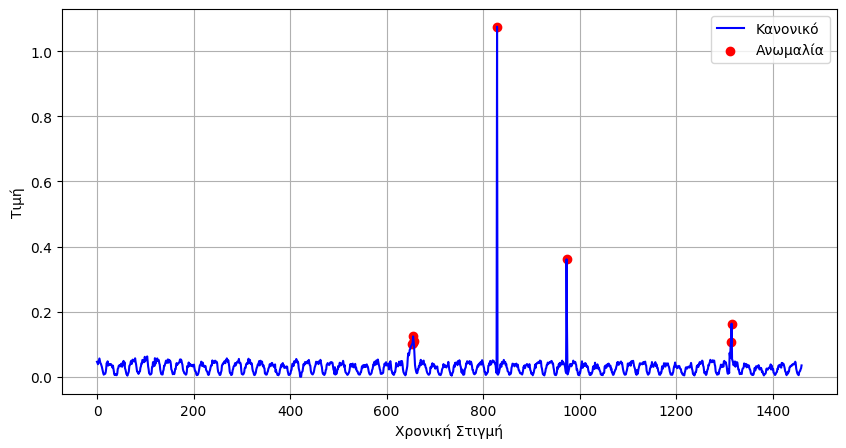

Stationarity checks failed for dfsA1[10]: name 'check_stationarity' is not defined
The most frequent period is  23.59016393442623


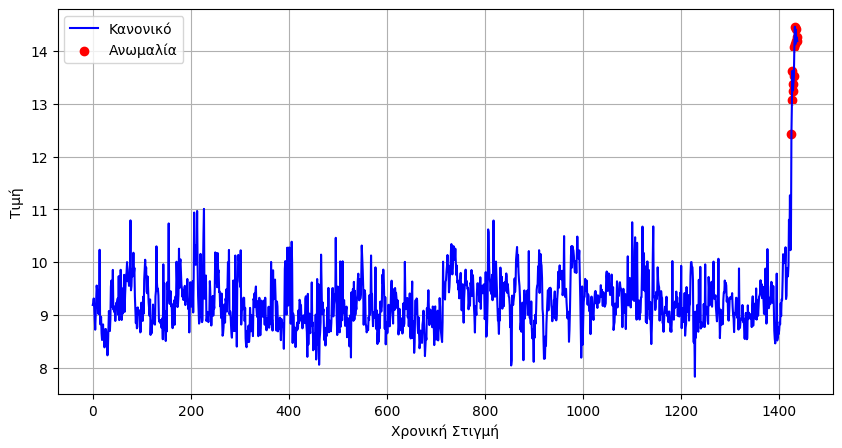

Stationarity checks failed for dfsA1[13]: name 'check_stationarity' is not defined
The most frequent period is  23.983333333333334


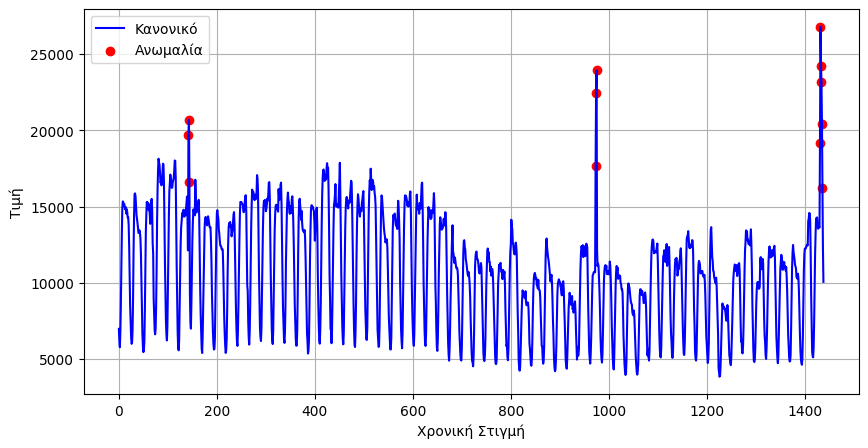

Stationarity checks failed for dfsA1[23]: name 'check_stationarity' is not defined
The most frequent period is  355.0


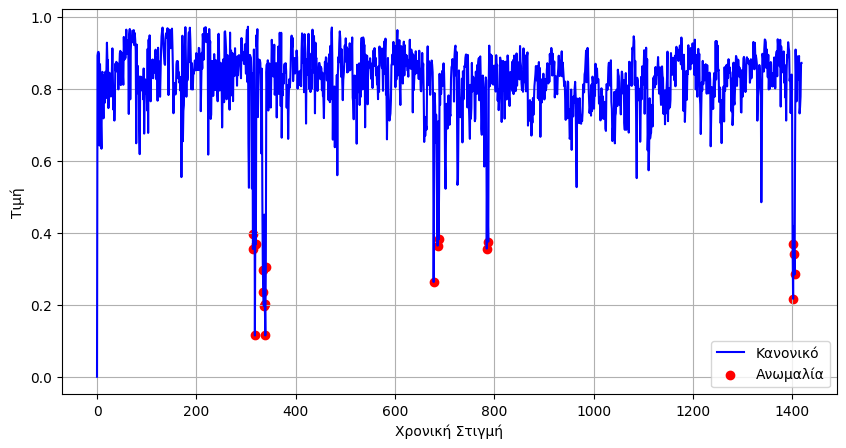

Stationarity checks failed for dfsA1[24]: name 'check_stationarity' is not defined
The most frequent period is  23.95081967213115


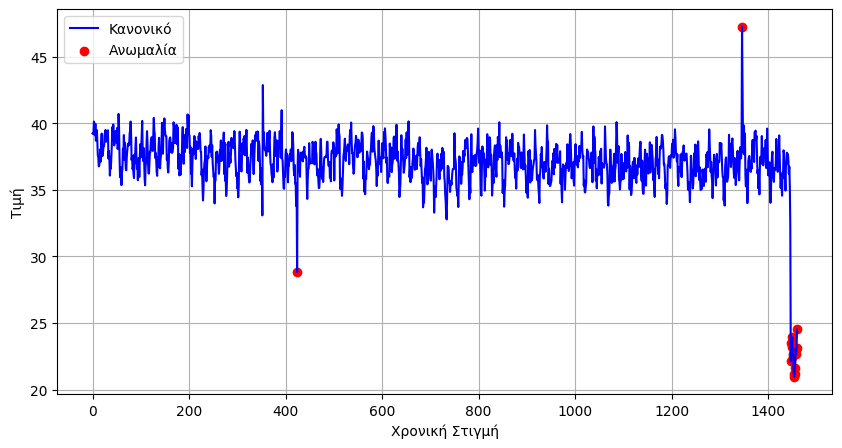

Stationarity checks failed for dfsA1[27]: name 'check_stationarity' is not defined
The most frequent period is  24.186440677966104


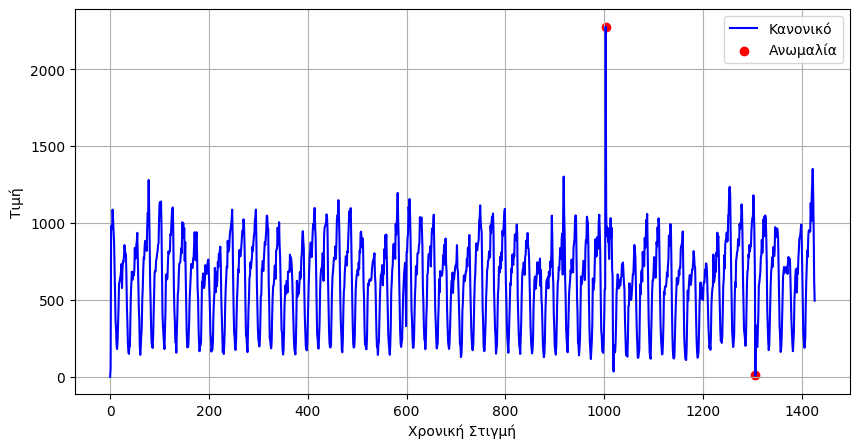

Stationarity checks failed for dfsA1[34]: name 'check_stationarity' is not defined
The most frequent period is  24.186440677966104


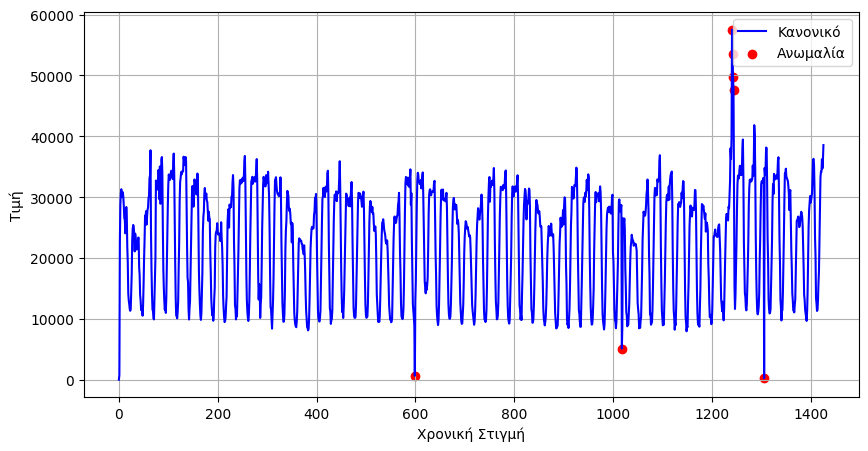

Stationarity checks failed for dfsA1[41]: name 'check_stationarity' is not defined
The most frequent period is  1435.0


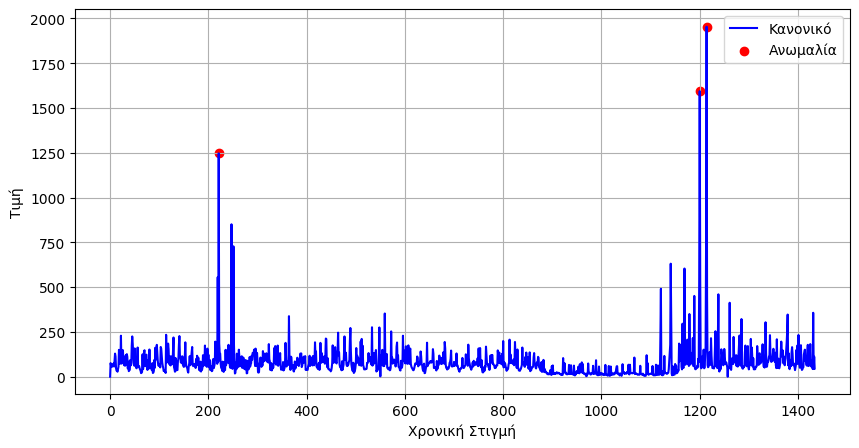

Stationarity checks failed for dfsA1[66]: name 'check_stationarity' is not defined
The most frequent period is  1424.0


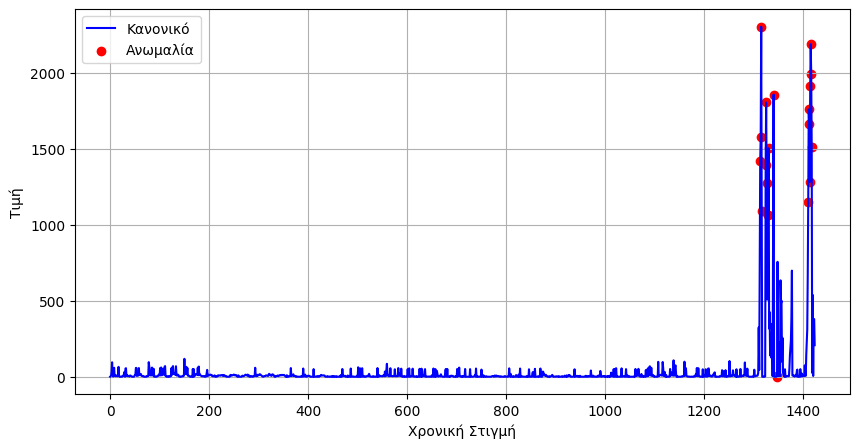

In [ ]:
#Long-term Stationarity
A1A = [1,2,3,8,9,10,13,23,24,27,34,41,66]

for i in A1A:
    plt.figure(figsize=(10, 5))

    # Plot normal data points (label == 0) in blue
    normal_data = dfsA1[i]
    values = normal_data[f"value_{i}"]
    plt.plot(normal_data.index, normal_data[f'value_{i}'], label='Κανονικό', color='blue')

    # Highlight anomalies (label == 1) in red
    anomaly_data = dfsA1[i][dfsA1[i]['label'] == 1]
    plt.scatter(anomaly_data.index, anomaly_data[f'value_{i}'], label='Ανωμαλία', color='red')

    # Perform stationarity checks and print results
    try:
        check_stationarity(values)
        kpss_test(values.values)
    except Exception as e:
        print(f"Stationarity checks failed for dfsA1[{i}]: {e}")

    # Calculate and plot the periodogram
    freq, power = periodogram(values)
    period = 1 / freq[np.argmax(power)] if np.any(freq > 0) else np.nan
    print("The most frequent period is ", period)

    # Add labels and title
    plt.xlabel('Χρονική Στιγμή')
    plt.ylabel('Τιμή')
    plt.legend()
    plt.grid(True)

    # Show the plot
    plt.show()

### Yahoo A1B - Stationarity with Change-Shift

Stationarity checks failed for dfsA1[7]: name 'check_stationarity' is not defined
The most frequent period is  1423.0


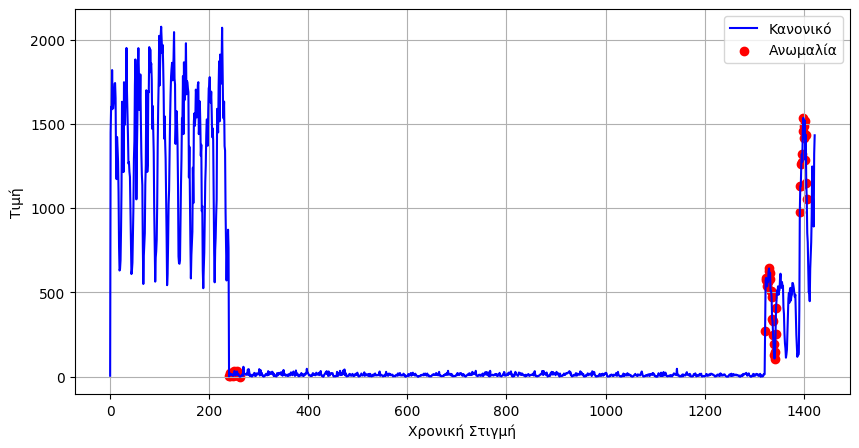

Stationarity checks failed for dfsA1[20]: name 'check_stationarity' is not defined
The most frequent period is  1422.0


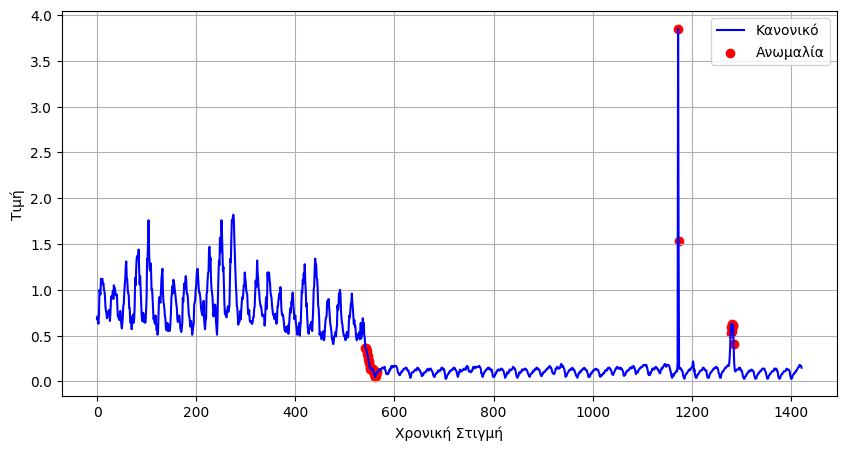

Stationarity checks failed for dfsA1[31]: name 'check_stationarity' is not defined
The most frequent period is  1427.0


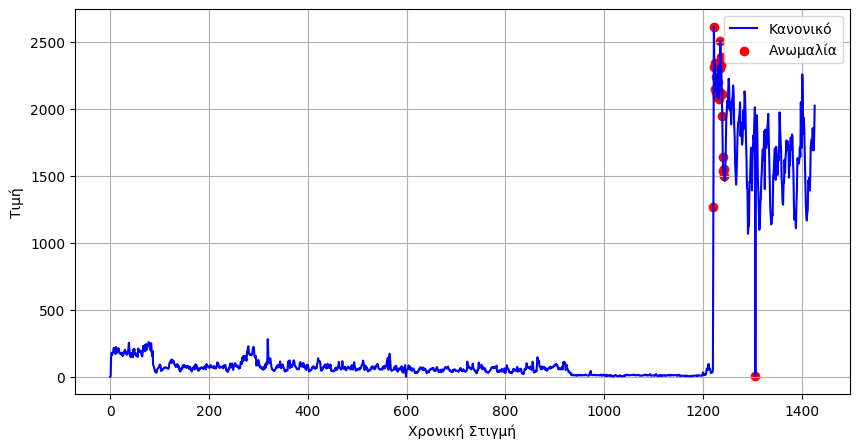

Stationarity checks failed for dfsA1[32]: name 'check_stationarity' is not defined
The most frequent period is  1427.0


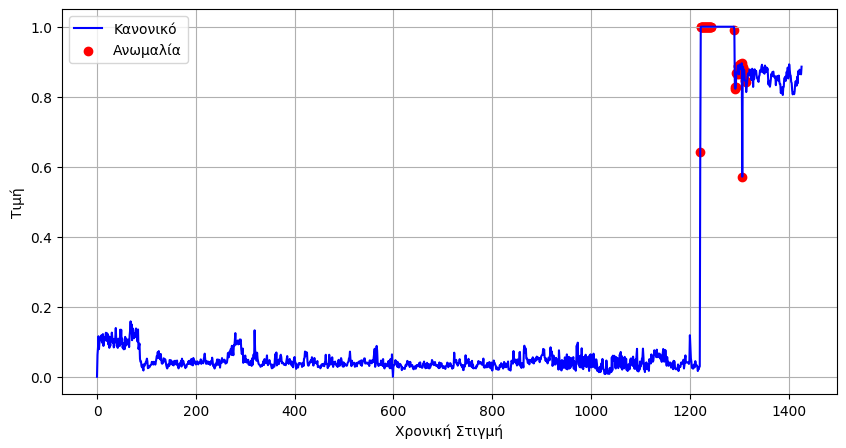

Stationarity checks failed for dfsA1[48]: name 'check_stationarity' is not defined
The most frequent period is  1439.0


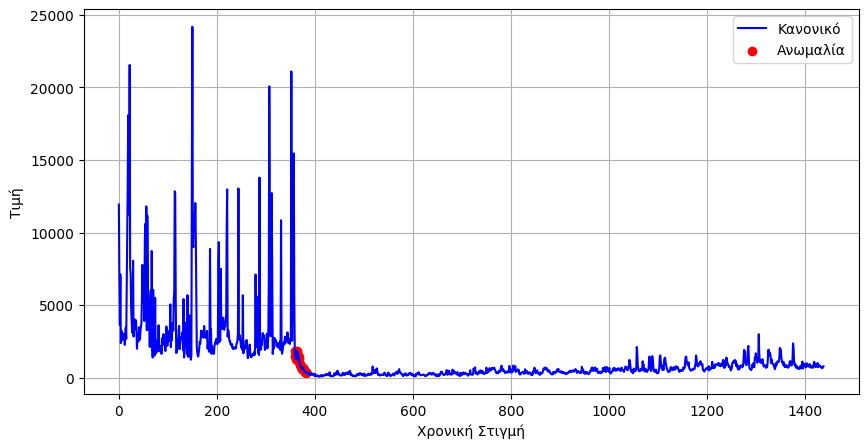

Stationarity checks failed for dfsA1[57]: name 'check_stationarity' is not defined
The most frequent period is  1441.0


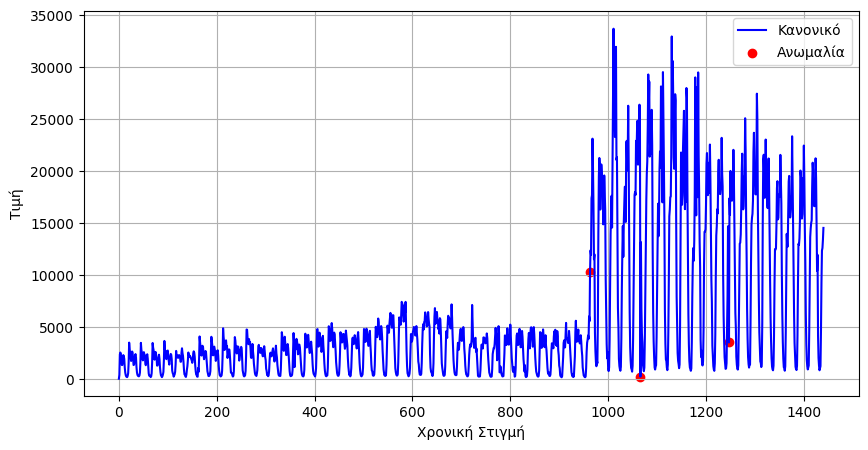

Stationarity checks failed for dfsA1[61]: name 'check_stationarity' is not defined
The most frequent period is  1441.0


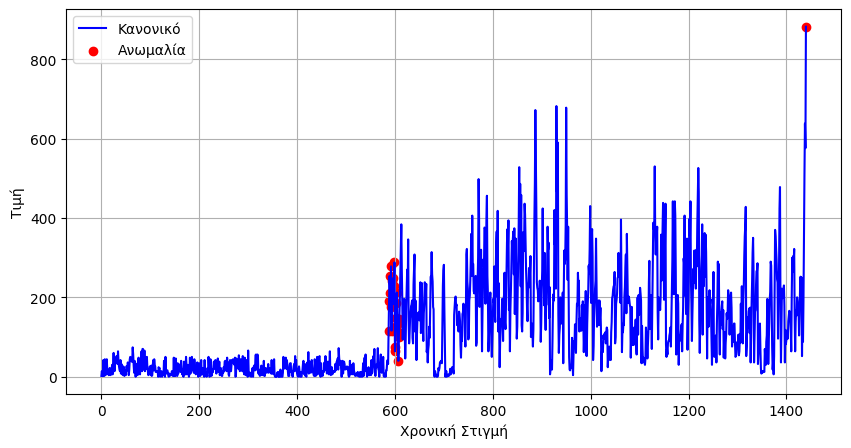

In [ ]:
# stationarity with change shift
A1B = [7,20,31,32,48,57,61]

for i in A1B:
    plt.figure(figsize=(10, 5))

    # Plot normal data points (label == 0) in blue
    normal_data = dfsA1[i]
    values = normal_data[f"value_{i}"]
    plt.plot(normal_data.index, normal_data[f'value_{i}'], label='Κανονικό', color='blue')

    # Highlight anomalies (label == 1) in red
    anomaly_data = dfsA1[i][dfsA1[i]['label'] == 1]
    plt.scatter(anomaly_data.index, anomaly_data[f'value_{i}'], label='Ανωμαλία', color='red')

    # Perform stationarity checks and print results
    try:
        check_stationarity(values)
        kpss_test(values.values)
    except Exception as e:
        print(f"Stationarity checks failed for dfsA1[{i}]: {e}")

    # Calculate and plot the periodogram
    freq, power = periodogram(values)
    period = 1 / freq[np.argmax(power)] if np.any(freq > 0) else np.nan
    print("The most frequent period is ", period)

    # Add labels and title
    plt.xlabel('Χρονική Στιγμή')
    plt.ylabel('Τιμή')
    plt.legend()
    plt.grid(True)

    # Show the plot
    plt.show()

### Yahoo A1C - Contextual and collective anomalies



Stationarity checks failed for dfsA1[17]: name 'check_stationarity' is not defined
The most frequent period is  284.8


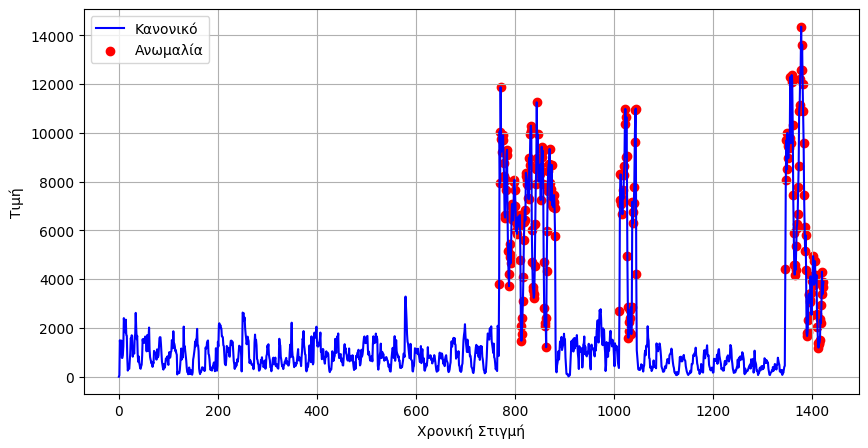

Stationarity checks failed for dfsA1[19]: name 'check_stationarity' is not defined
The most frequent period is  284.8


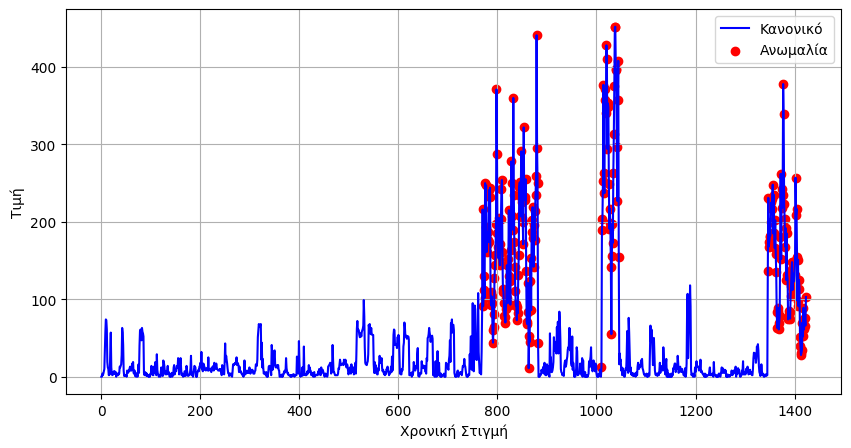

Stationarity checks failed for dfsA1[26]: name 'check_stationarity' is not defined
The most frequent period is  23.916666666666664


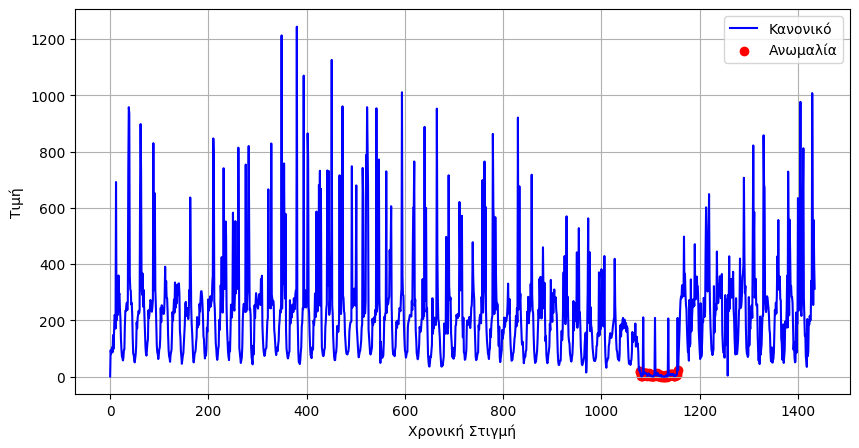

Stationarity checks failed for dfsA1[37]: name 'check_stationarity' is not defined
The most frequent period is  23.900000000000002


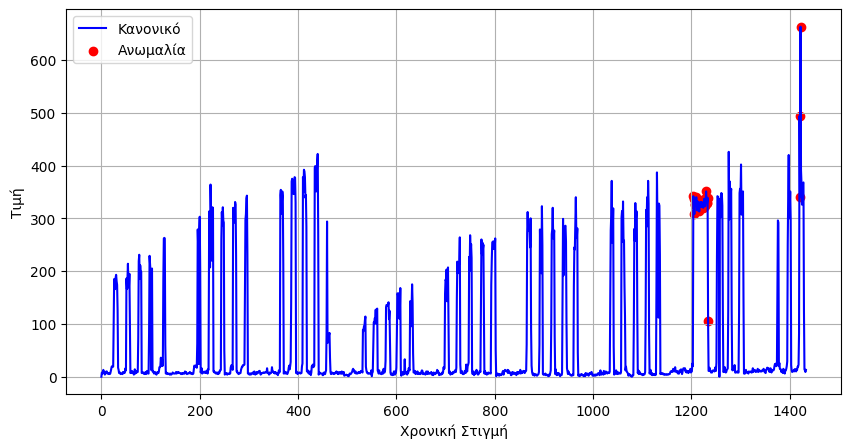

Stationarity checks failed for dfsA1[40]: name 'check_stationarity' is not defined
The most frequent period is  1427.0


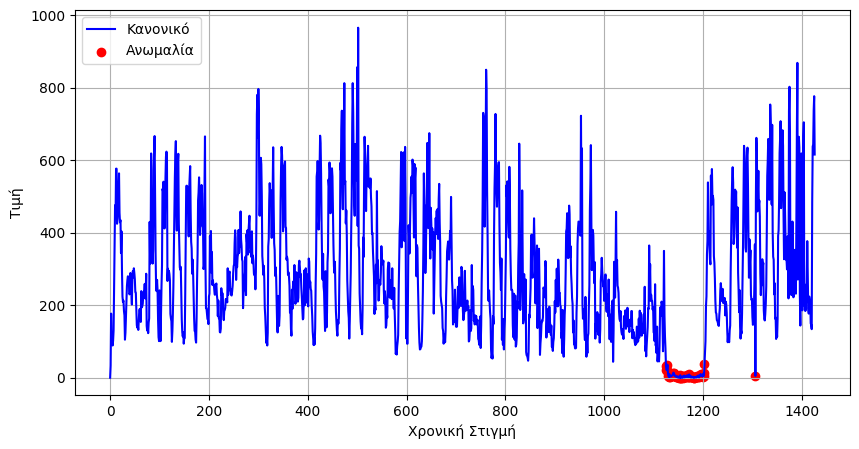

Stationarity checks failed for dfsA1[47]: name 'check_stationarity' is not defined
The most frequent period is  11.991596638655462


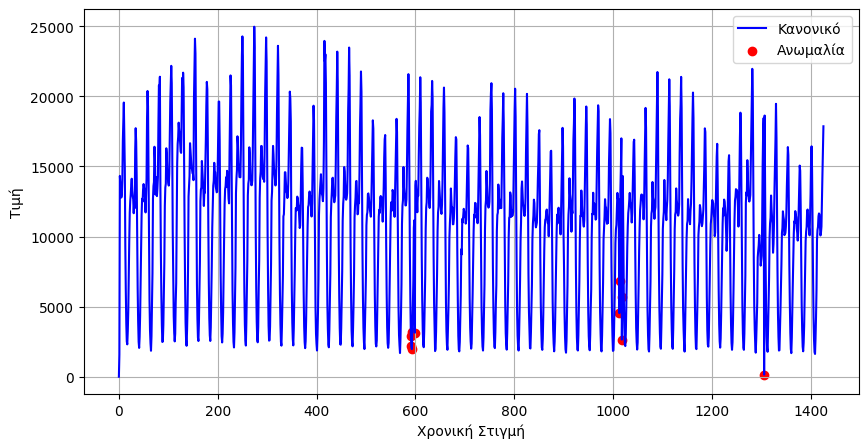

In [ ]:
#Long-term Seasonality

A1C = [17, 19, 26, 37, 40, 47]


for i in A1C:
    plt.figure(figsize=(10, 5))

    # Plot normal data points (label == 0) in blue
    normal_data = dfsA1[i]
    values = normal_data[f"value_{i}"]
    plt.plot(normal_data.index, normal_data[f'value_{i}'], label='Κανονικό', color='blue')

    # Highlight anomalies (label == 1) in red
    anomaly_data = dfsA1[i][dfsA1[i]['label'] == 1]
    plt.scatter(anomaly_data.index, anomaly_data[f'value_{i}'], label='Ανωμαλία', color='red')

    # Perform stationarity checks and print results
    try:
        check_stationarity(values)
        kpss_test(values.values)
    except Exception as e:
        print(f"Stationarity checks failed for dfsA1[{i}]: {e}")

    # Calculate and plot the periodogram
    freq, power = periodogram(values)
    period = 1 / freq[np.argmax(power)] if np.any(freq > 0) else np.nan
    print("The most frequent period is ", period)

    # Add labels and title
    plt.xlabel('Χρονική Στιγμή')
    plt.ylabel('Τιμή')
    plt.legend()
    plt.grid(True)

    # Show the plot
    plt.show()

### Yahoo A1D - Seasonality, trend and shift



Stationarity checks failed for dfsA1[28]: name 'check_stationarity' is not defined
The most frequent period is  1441.0


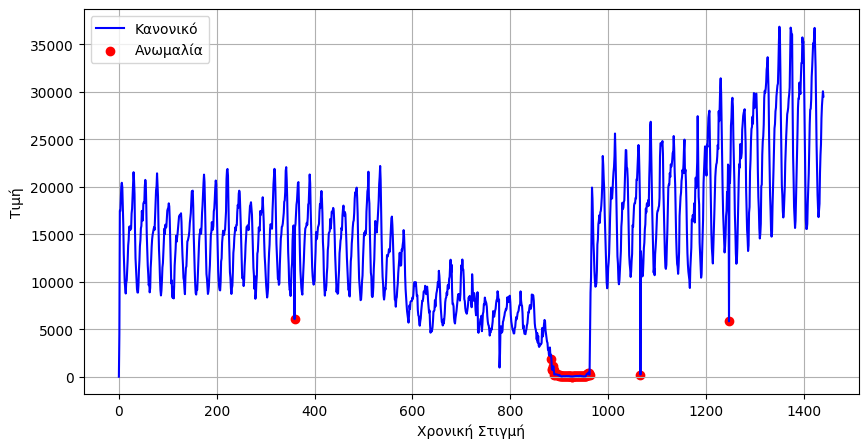

Stationarity checks failed for dfsA1[43]: name 'check_stationarity' is not defined
The most frequent period is  1440.0


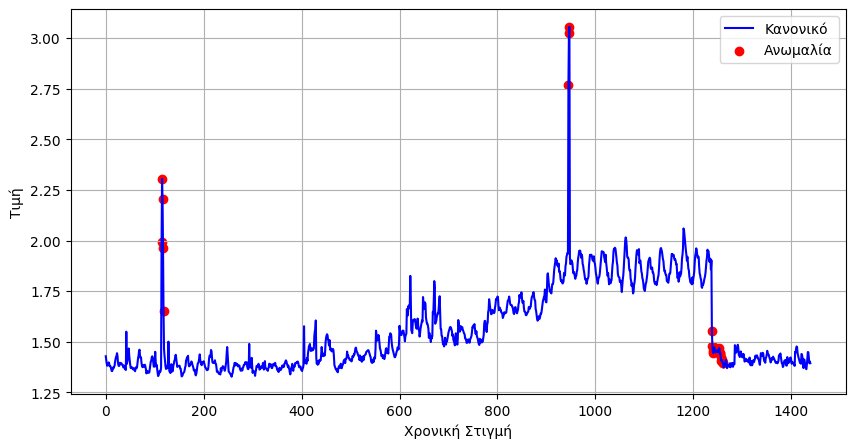

Stationarity checks failed for dfsA1[46]: name 'check_stationarity' is not defined
The most frequent period is  1441.0


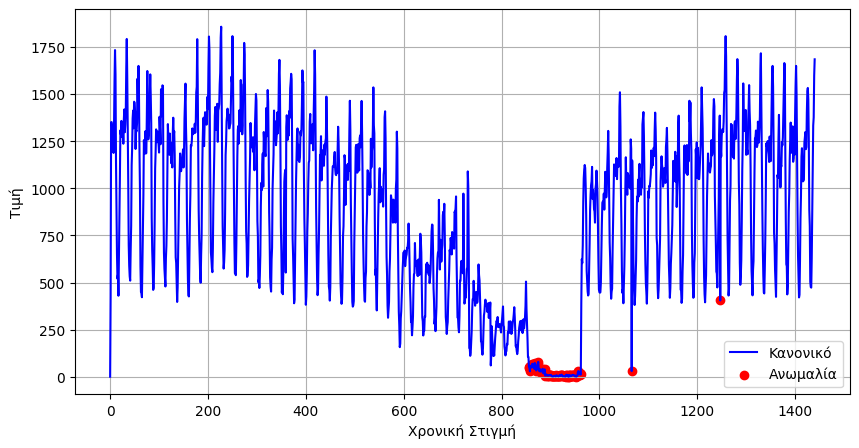

Stationarity checks failed for dfsA1[55]: name 'check_stationarity' is not defined
The most frequent period is  1427.0


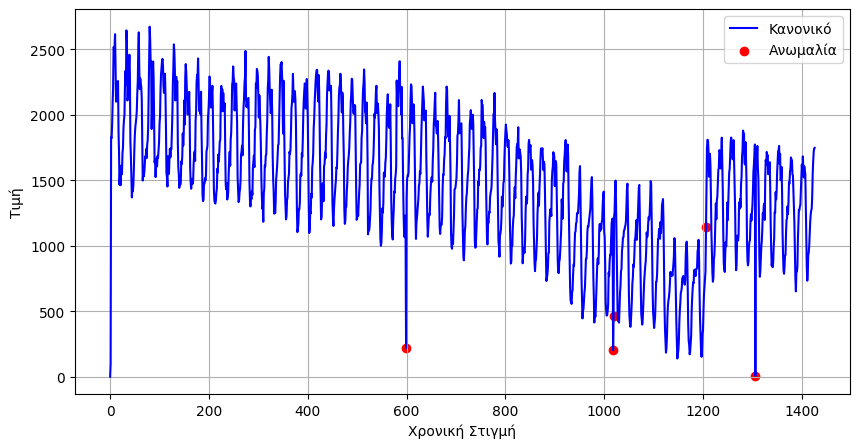

Stationarity checks failed for dfsA1[56]: name 'check_stationarity' is not defined
The most frequent period is  1427.0


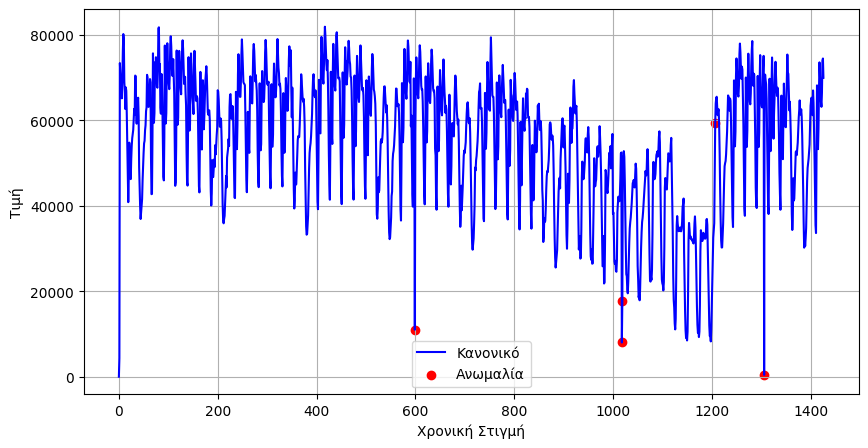

Stationarity checks failed for dfsA1[65]: name 'check_stationarity' is not defined
The most frequent period is  1424.0


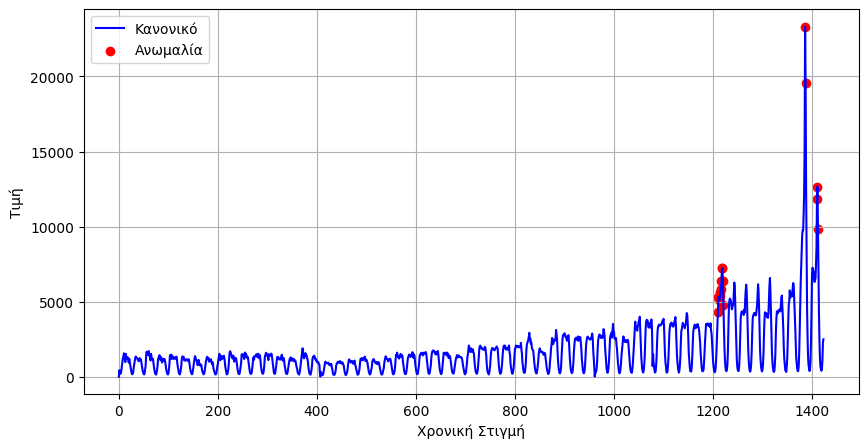

In [ ]:
# Seasonaltiy trend and shift
A1D = [28,43,46,55,56,65]

for i in A1D:
    plt.figure(figsize=(10, 5))

    # Plot normal data points (label == 0) in blue
    normal_data = dfsA1[i]
    values = normal_data[f"value_{i}"]
    plt.plot(normal_data.index, normal_data[f'value_{i}'], label='Κανονικό', color='blue')

    # Highlight anomalies (label == 1) in red
    anomaly_data = dfsA1[i][dfsA1[i]['label'] == 1]
    plt.scatter(anomaly_data.index, anomaly_data[f'value_{i}'], label='Ανωμαλία', color='red')

    # Perform stationarity checks and print results
    try:
        check_stationarity(values)
        kpss_test(values.values)
    except Exception as e:
        print(f"Stationarity checks failed for dfsA1[{i}]: {e}")

    # Calculate and plot the periodogram
    freq, power = periodogram(values)
    period = 1 / freq[np.argmax(power)] if np.any(freq > 0) else np.nan
    print("The most frequent period is ", period)

    # Add labels and title
    plt.xlabel('Χρονική Στιγμή')
    plt.ylabel('Τιμή')
    plt.legend()
    plt.grid(True)

    # Show the plot
    plt.show()

### Violin plots of the anomalies of every Yahoo A1 dataset

<ipython-input-4-341392113753>:28: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='count'` for the same effect.
  sns.violinplot(data=anomaly_data, x="Dataset", y="Anomaly Count", scale="count", inner="quartile", cut=0)


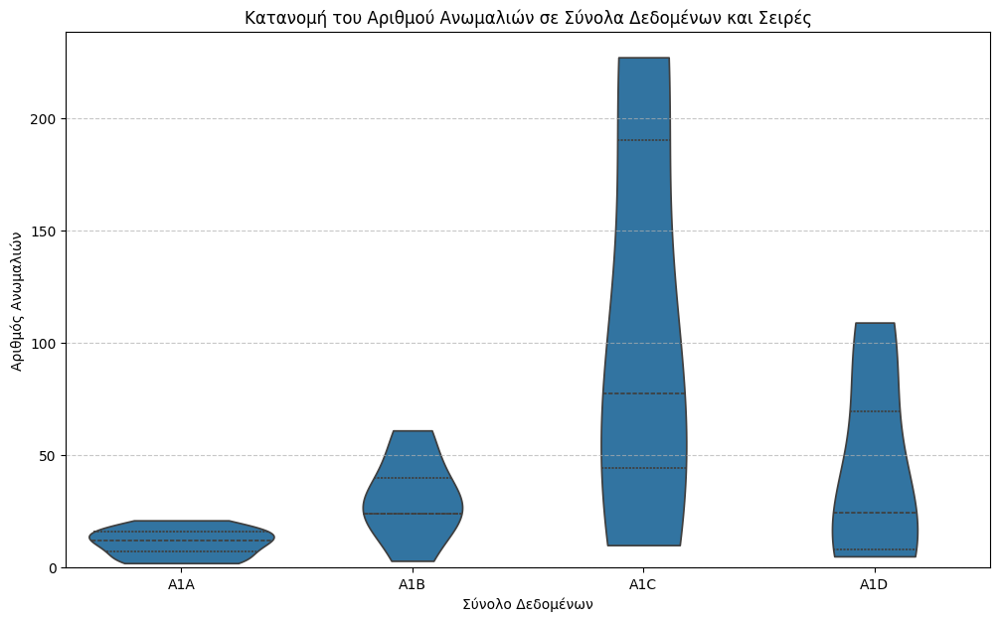

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Define the specific series for each dataset
series_map = {
    'A1A': [1,2,3,8,9,10,13,23,24,27,34,41,66],
    'A1B': [7,20,31,32,48,57,61],
    'A1C': [17, 19, 26, 37, 40, 47],
    'A1D': [28,43,46,55,56,65],
}

# Collect anomaly counts for each dataset
all_anomaly_data = []

for group_name, series_indices in series_map.items():
    for i in series_indices:
        df = dfsA1[i]  # Get the corresponding dataframe from dfsA1
        # Count the number of anomalies (label == 1)
        count = df[df['label'] == 1].shape[0]
        all_anomaly_data.append({'Dataset': group_name, 'Anomaly Count': max(count, 0)})  # Ensure no negative values

# Convert to DataFrame for visualization
anomaly_data = pd.DataFrame(all_anomaly_data)

# Create violin plot
plt.figure(figsize=(12, 7))
sns.violinplot(data=anomaly_data, x="Dataset", y="Anomaly Count", scale="count", inner="quartile", cut=0)

plt.title("Κατανομή του Αριθμού Ανωμαλιών σε Σύνολα Δεδομένων και Σειρές")
plt.xlabel("Σύνολο Δεδομένων")
plt.ylabel("Αριθμός Ανωμαλιών")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.ylim(bottom=0)  # Ensure y-axis starts at 0 to prevent negatives
plt.show()
